In [1]:
import copy
import socket
import os
import pickle 
# import ssm #need to/ keep 
import sys
import glob
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap


sys.path.append("/Users/friederikebuck/Desktop/MBL/project/WholeBrainImagingAnalysis/collab/")
sys.path.append('/Users/bennetsakelaris/Documents/Obsidian Vault/Worms/wormcode/Code+Notes 09-24-24/collab/')

from scipy.ndimage import gaussian_filter1d
from get_data.read_neuro_beh_data import get_exp_features, load_json
from get_data.process_neural_data import get_derivative_of_neural_activity, get_neural_activity_from_labels, get_neural_activity_and_labels
from beh_classification.behavior_features import get_behavior_features
from beh_classification.get_behavior_classifications import get_behavior_classification
# from beh_classification.beh_classification_utils import get_start_end_is_of_ones_in_binary_array
from sklearn.decomposition import PCA

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import balanced_accuracy_score

from sklearn import svm
from sklearn.svm import LinearSVC
from sklearn.neighbors import NearestNeighbors

from load_data_fncs import load_all_data, get_exp_dates
from analyse_rslds_utils import make_behavior_decoder, input_slds

In [2]:

from matplotlib.colors import LinearSegmentedColormap

#color palette for plotting, colors as in make_behavior_ethogram
palette = ["coral",     # forward
           "lightblue", # reverse
           "darkgreen", # turn
           "purple","red", "yellow", "black", "pink"]    # pause
cmap = LinearSegmentedColormap.from_list("behavior", palette, N=len(palette))


# Load data, model, behavior decoder

In [3]:


T = 1599
full_traces, full_neural_labels, full_beh_classification, full_beh_data = load_all_data()

velocity_og = np.array([full_beh_data[i]["velocity"][0:1599] for i in range(len(full_beh_data))])
acceleration_og = np.array([full_beh_data[i]["acceleration"][1:1600] for i in range(len(full_beh_data))])
head_curvature_og = np.array([full_beh_data[i]["head_angle"][0:1599] for i in range(len(full_beh_data))])
worm_curvature_og = np.array([full_beh_data[i]["worm_curvature"][0:1599] for i in range(len(full_beh_data))])
pumping_og = np.array([full_beh_data[i]["pumping"][0:1599] for i in range(len(full_beh_data))])
body_angle_mag_og = np.array([full_beh_data[i]["body_angle_mag"][0:1599] for i in range(len(full_beh_data))])
midlines_og =  np.array([full_beh_data[i]["midlines"][0:1599] for i in range(len(full_beh_data))])
body_angles_og =  np.array([full_beh_data[i]["body_angles"][0:1599] for i in range(len(full_beh_data))])

velocity = copy.deepcopy(velocity_og)
acceleration = copy.deepcopy(acceleration_og)
head_curvature = copy.deepcopy(head_curvature_og)
worm_curvature = copy.deepcopy(worm_curvature_og)
pumping = copy.deepcopy(pumping_og)
body_angle_mag =copy.deepcopy(body_angle_mag_og)
midlines =copy.deepcopy( midlines_og)
body_angles = copy.deepcopy(body_angles_og)


np.random.seed(0)

foldername = "/Users/friederikebuck/Downloads/worm notes/processed_checkpts/test_rslds_QM_run_061325/model_selection/top_2_combined/"
items = np.array(os.listdir(foldername))
folders = np.array(["." not in directory for directory in items], dtype=bool)
folders = items[folders]

folder = folders[0]

with open(foldername+"/Y.npy", 'rb') as handle:  
    Y = pickle.load(handle)


with open(foldername+folder+"/saved_data/prior.npy", 'rb') as handle:
    global_worm = pickle.load(handle)
    global_worm.D = int(global_worm.D)

with open(foldername+folder+"/saved_data/prior_q.npy", 'rb') as handle:
    q = pickle.load(handle)
    

slds = global_worm

neural_labels = np.load(foldername+"/neurons.npy", allow_pickle=True)

# set up a single behavioral state array ("z" in the language of scott): 
z = [beh_classification["is_fwd"][0:1599]+ 2*beh_classification["is_rev"][0:1599]+ 4*beh_classification["is_pause"][0:1599]+3*beh_classification["is_turn"][0:1599]-1 for beh_classification in full_beh_classification]

# get estimated latents, states
q_x = q.mean_continuous_states
q_z = [slds.most_likely_states(q_x[w], Y[w]) for w in range(len(q_x))]

# traces, neural_labels, behavior_classification, mask = load_all_data_but_pretend_its_all_one_worm()

# velocity = np.array([full_beh_data[i]["velocity"][0:1599] for i in range(len(full_beh_data))])
# # velocity_all = 
# acceleration = np.array([full_beh_data[i]["acceleration"][1:1600] for i in range(len(full_beh_data))])
# head_curvature = np.array([full_beh_data[i]["head_angle"][0:1599] for i in range(len(full_beh_data))])
# worm_curvature = np.array([full_beh_data[i]["worm_curvature"][0:1599] for i in range(len(full_beh_data))])
# pumping = np.array([full_beh_data[i]["pumping"][0:1599] for i in range(len(full_beh_data))])

q_z_all = np.concatenate(q_z)
z_all = np.concatenate(z)

# Input rSLDS
input_list = ["AVA", "RIB", "RIM", "AIB"]
new_slds, input_dict = input_slds(slds,neural_labels, input_list, input_list)
new_slds.D = int(new_slds.D)
input_dict

beh_decoder = make_behavior_decoder(q_x, z)



Worm 0, date: 2022-06-14-01
Worm 1, date: 2023-01-23-08
Worm 2, date: 2022-06-28-07
Worm 3, date: 2022-07-15-12
Worm 4, date: 2023-01-19-01
Worm 5, date: 2022-08-02-01
Worm 6, date: 2022-06-14-07
Worm 7, date: 2022-06-28-01
Worm 8, date: 2023-01-23-15
Worm 9, date: 2022-07-26-01
Worm 10, date: 2023-01-19-15
Worm 11, date: 2023-03-07-01
Worm 12, date: 2022-06-14-13
Worm 13, date: 2023-01-23-21
Worm 14, date: 2023-01-19-22
Worm 15, date: 2023-01-23-01
Worm 16, date: 2023-01-17-01
Worm 17, date: 2022-07-20-01
Worm 18, date: 2023-01-09-28
Worm 19, date: 2023-01-19-08
Worm 20, date: 2022-07-15-06


/Users/friederikebuck/Desktop/MBL/project/WholeBrainImagingAnalysis/collab/beh_classification/behavior_features.py:11: RuntimeWarning: Mean of empty slice
  body_angles = body_angles-np.nanmean(body_angles, axis = 1)[:, None]
/Users/friederikebuck/Desktop/MBL/project/WholeBrainImagingAnalysis/collab/beh_classification/behavior_features.py:15: RuntimeWarning: Mean of empty slice
  centroids = np.nanmean(midlines, axis = 1)


In [4]:

from rslds_visualization_utils import plot_states_and_neurons
from matplotlib.backends.backend_pdf import PdfPages
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from compute_donut_utils import fix_signs, compute_phase,compute_radius, extract_rotation_angle, set_seed

import sys 

sys.path.append("/Users/friederikebuck/")
sys.path.append("/Users/friederikebuck/Desktop/MBL/project/WholeBrainImagingAnalysis/collab/")
sys.path.append('/Users/bennetsakelaris/Documents/Obsidian Vault/Worms/wormcode/Code+Notes 09-24-24/collab/')
sys.path.append("/Users/friederikebuck/Downloads/worm notes/worm_code/fit_hierarchical/")

emissions_dim = max(traces.shape[1] for traces in full_traces)
model = slds

exp_dates = get_exp_dates() 




y = np.array(q_x)
pca = PCA(n_components=9, svd_solver="full")
pca.fit(np.concatenate(q_x[:-2])) #leave out two worms to test generalization
pca.components_ = fix_signs(pca.components_)
pca_x = pca.transform(np.concatenate(q_x))

#instead of training on phase, we'll train on sin and cosine to avoid the jumping between 2pi and 0
thetas = np.array([compute_phase(q_x[i], pca) for i in range(21)])
y_sin = [np.sin(y_i) for y_i in thetas]
y_cos = [np.cos(y_i) for y_i in thetas]

y = np.zeros((21, 1599, 3))
y[:,:,0] = y_sin
y[:,:,1] = y_cos
y[:,:,2] = [compute_radius(q_x[i], pca) for i in range(21)]

rotated_data = extract_rotation_angle(pca_x, n_neighbors=5)

rotated_data2d = rotated_data[:, 1:3]  # Project onto the principal plane
angles = np.arctan2(rotated_data2d[:, 1], rotated_data2d[:, 0])  

n_worms, timepoints = [21, 1599]
# angles = np.radians((270-np.degrees(angles+ np.pi))%360-180)

angles = angles.reshape(n_worms, timepoints)
rotated_data2d = rotated_data2d.reshape(n_worms, timepoints, 2)

y_sin = np.sin(angles)
y_cos = np.cos(angles)
radii = np.sqrt(rotated_data2d[..., 0]**2 + rotated_data2d[..., 1]**2)

y = np.stack([y_sin, y_cos, radii], axis=-1)
y.shape
z_norm = np.array(z, np.float64)

# Train model

### This block is the main new thing compared to angles.ipynb

In [5]:
velocity -= velocity.mean()
velocity /= velocity.std()
acceleration -= acceleration.mean()
acceleration /= acceleration.std()
worm_curvature -= worm_curvature.mean()
worm_curvature /= worm_curvature.std()
z_norm -= z_norm.mean()
z_norm /= z_norm.std()
z_flat = np.array(z).flatten()

In [6]:
from angle.preprocess import prepare_data, split_and_normalize
from angle.train import train_model
from angle.plot_funcs_1 import plot_prediction, plot_held_out_worm

set_seed(42)
normalize=False
T = 5
X_all, y_all = prepare_data([velocity, acceleration, worm_curvature, z_norm], y, T=T, holdout_idxs=[20])
X_train, X_test, y_train, y_test, input_stats = split_and_normalize(X_all, y_all, normalize=normalize) # test here is held-out timepoints of held-in worms

input_dim = X_train.shape[2]
output_dim = y_train.shape[1]

model_type = 'lstm'  # or 'ff'

model, train_losses, test_losses = train_model(
    X_train, y_train,
    X_test, y_test,
    input_dim=input_dim,
    output_dim=output_dim,
    model_type=model_type,
    hidden_dim=64,
    num_layers=3,
    dropout=0.5,
    learning_rate=0.001,
    num_epochs=500
)


Epoch 0, Train Loss: 1.0179, Test Loss: 0.9792
Epoch 50, Train Loss: 0.2710, Test Loss: 0.2384
Epoch 100, Train Loss: 0.2386, Test Loss: 0.2137
Epoch 150, Train Loss: 0.2239, Test Loss: 0.2028
Epoch 200, Train Loss: 0.2122, Test Loss: 0.1918
Epoch 250, Train Loss: 0.2030, Test Loss: 0.1831
Epoch 300, Train Loss: 0.1981, Test Loss: 0.1782
Epoch 350, Train Loss: 0.1948, Test Loss: 0.1747
Epoch 400, Train Loss: 0.1911, Test Loss: 0.1717
Epoch 450, Train Loss: 0.1880, Test Loss: 0.1688
Final Training Loss: 0.1850
Final Test Loss: 0.1662


# Plot all worms -- LSTM

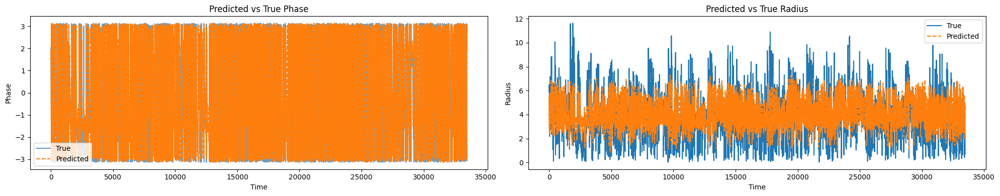

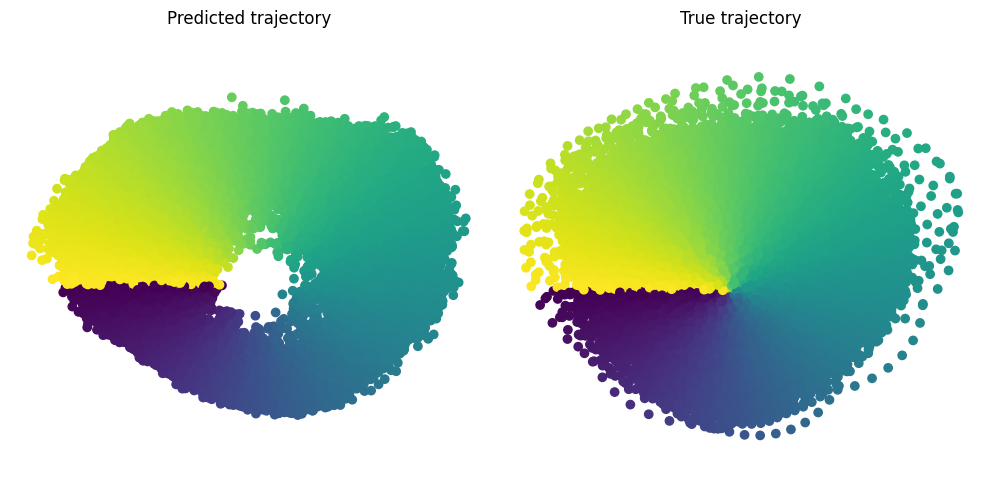

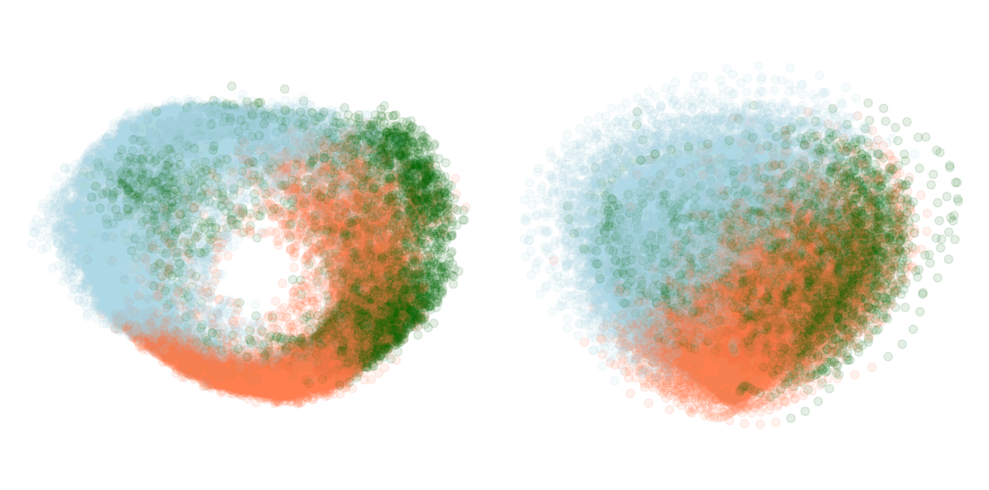

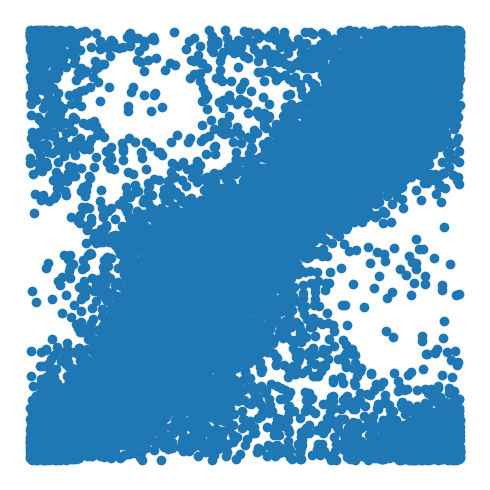

In [7]:

worm_angles, worm_radii = plot_prediction(
    model=model,
    inputs=[velocity, acceleration, worm_curvature, z_norm],
    y=y,
    T=T,
    y_train_mean=input_stats["y_mean"],
    y_train_std=input_stats["y_std"],
    z = z,
    cmap=cmap, normalize=normalize
)

worm_angles = [worm_angles[i*1594:(1+i)*1594] for i in range(20)]
worm_radii = [worm_radii[i*1594:(1+i)*1594] for i in range(20)]


# plot a worm

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


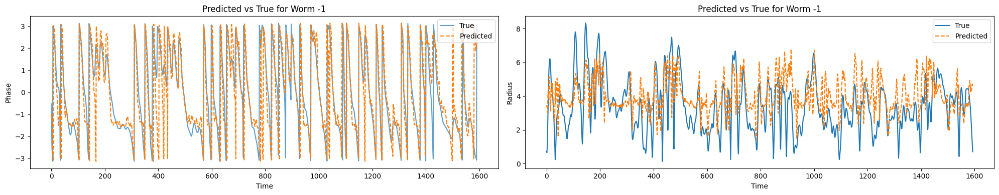

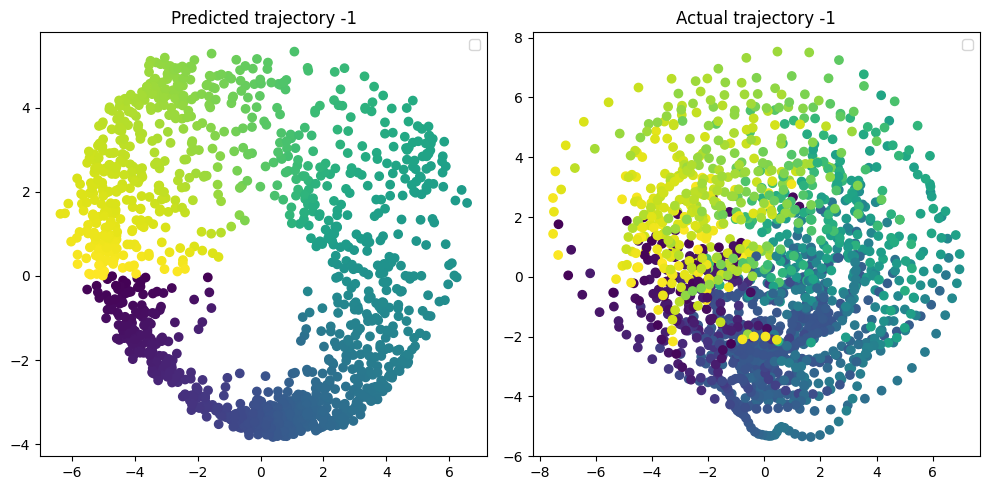

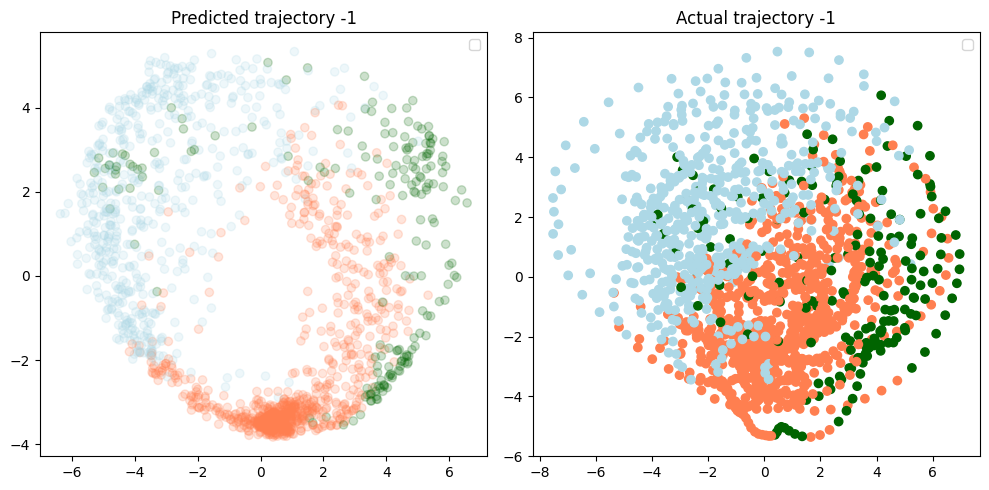

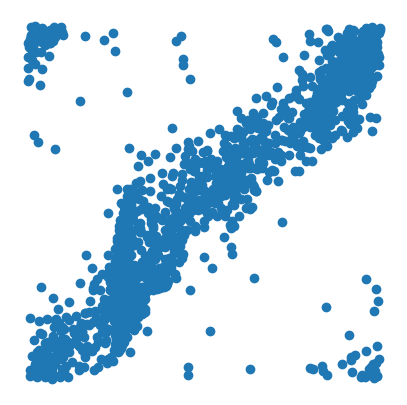

In [8]:

pred_test_angles, pred_test_radii = plot_held_out_worm(model, [velocity, acceleration, worm_curvature, z_norm], y, T, input_stats, new_worm_idx=-1,z=z, cmap=cmap, normalize=normalize)


# Store as new ground truth

In [9]:
T = 5
y = np.array((np.cos(np.concatenate(worm_angles)), np.sin(np.concatenate(worm_angles)), np.concatenate(worm_radii)))
y_new = np.array((np.cos(pred_test_angles), np.sin(pred_test_angles), pred_test_radii))
y = np.hstack((y, y_new))
y = np.array([y[:,i*1594:1594*(i+1)].T for i in range(21)])


In [10]:
print(y.shape)

(21, 1594, 3)


# Activity-directed network

Epoch 0, Train Loss: 1.0847, Test Loss: 0.9536
Epoch 50, Train Loss: 0.2171, Test Loss: 0.1715
Epoch 100, Train Loss: 0.1660, Test Loss: 0.1375
Epoch 150, Train Loss: 0.1381, Test Loss: 0.1125
Epoch 200, Train Loss: 0.1186, Test Loss: 0.0870
Epoch 250, Train Loss: 0.1072, Test Loss: 0.0713
Epoch 300, Train Loss: 0.1008, Test Loss: 0.0639
Epoch 350, Train Loss: 0.0969, Test Loss: 0.0600
Epoch 400, Train Loss: 0.0929, Test Loss: 0.0567
Epoch 450, Train Loss: 0.0894, Test Loss: 0.0553
Final Training Loss: 0.0874
Final Test Loss: 0.0537


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


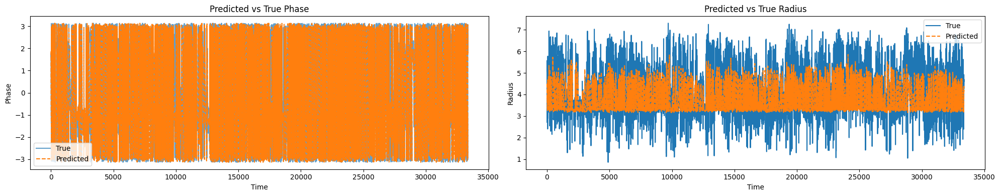

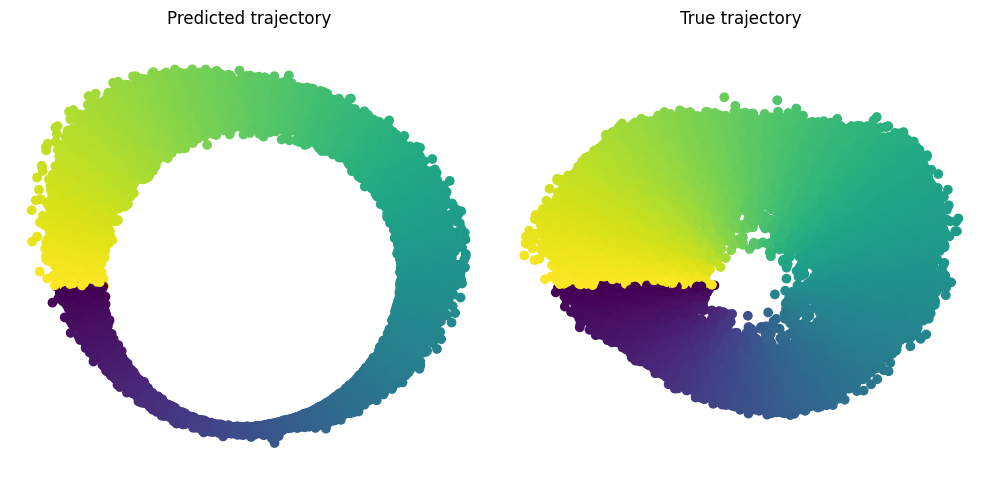

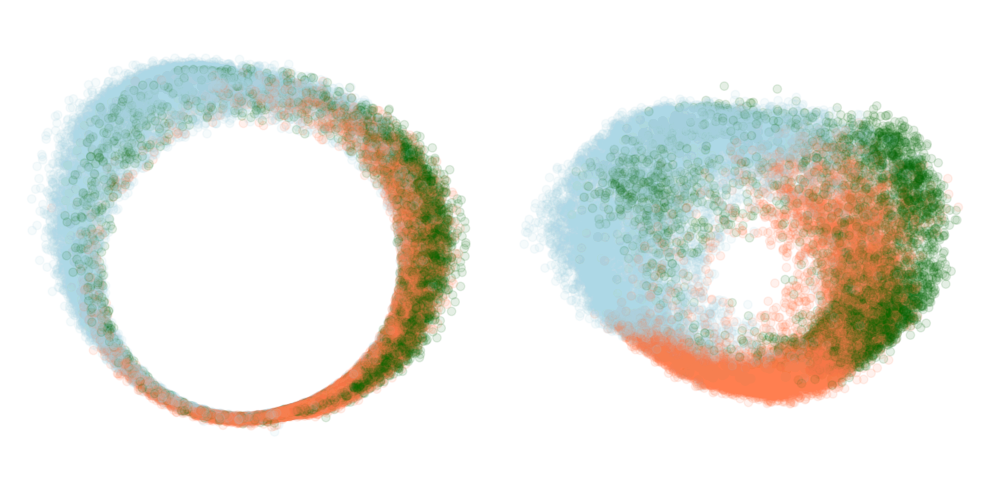

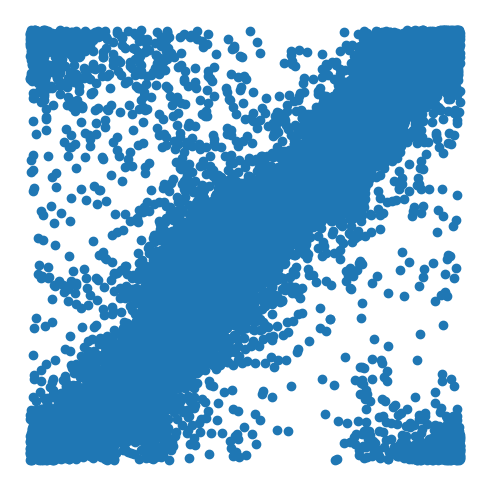

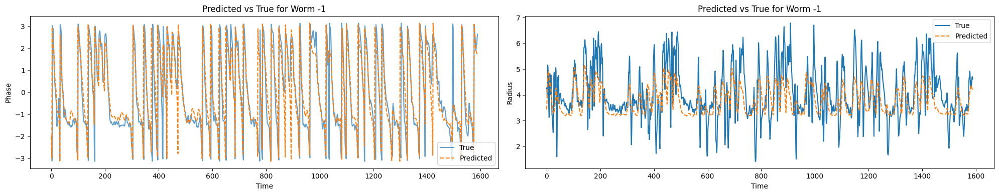

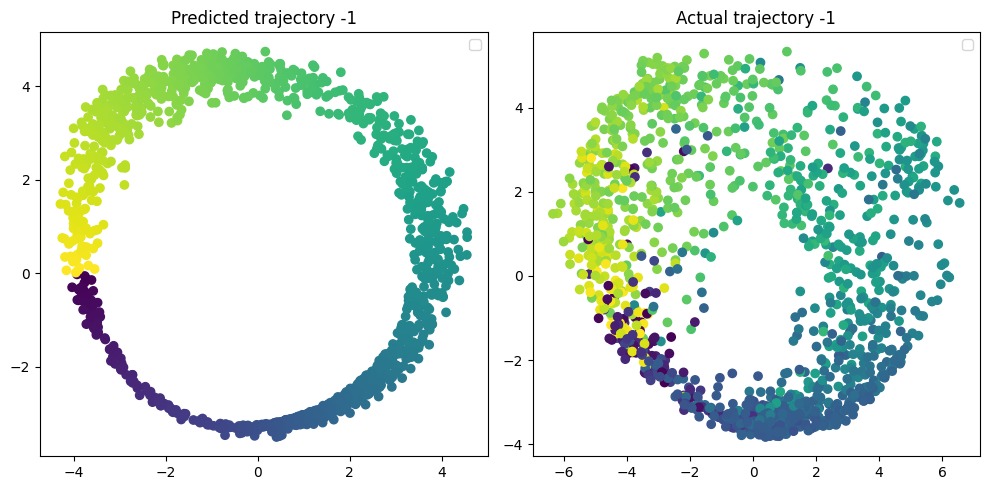

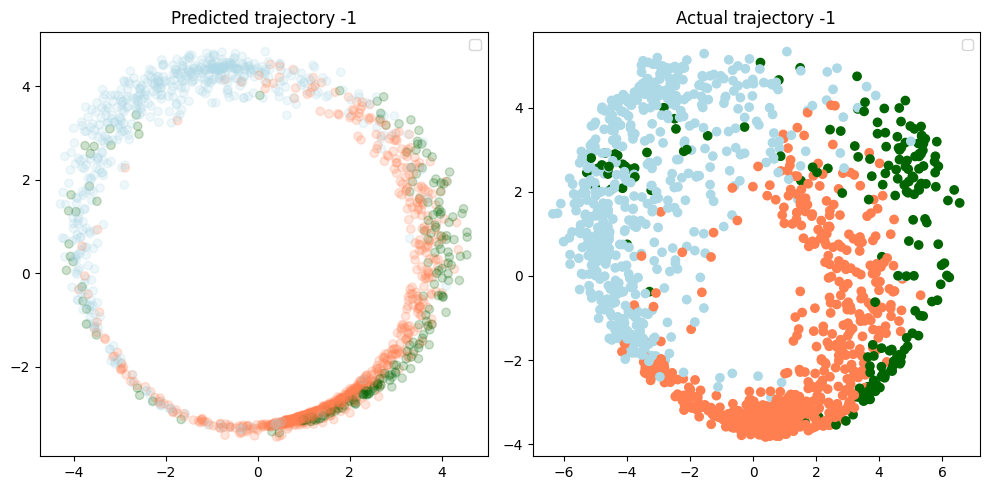

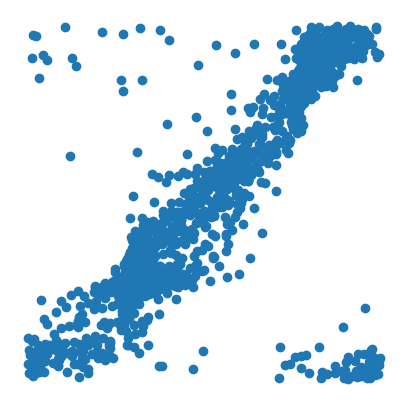

In [11]:
from visualize_donut_time_series_and_states import plot_donut_behs_trained
input_features = np.transpose(np.array(q_x)[:,5:], [2,0,1] )
X_all, y_all = prepare_data(input_features, y, T=T, holdout_idxs=[20])
X_train, X_test, y_train, y_test, input_stats = split_and_normalize(X_all, y_all, normalize=normalize)
model_type = 'ff'  # or 'ff'


input_dim = X_train.shape[-1]* X_train.shape[-2]
output_dim = y_train.shape[1]

model, train_losses, test_losses = train_model(
    X_train, y_train,
    X_test, y_test,
    input_dim=input_dim,
    output_dim=output_dim,
    model_type=model_type,
    hidden_dim=64,
    num_layers=3,
    dropout=0.5,
    learning_rate=0.001,
    num_epochs=500,
)

worm_angles_concat_neural, worm_radii_concat_neural = plot_prediction(
    model=model,
    inputs=input_features,
    y=y,
    T=T,
    y_train_mean=input_stats["y_mean"],
    y_train_std=input_stats["y_std"],
    z=np.array(z)[:,5:],
    cmap=cmap,
    normalize=normalize
)

pred_worm_angles_concat_neural, pred_worm_radii_neural = plot_held_out_worm(model, input_features, y, T, input_stats, new_worm_idx=-1,z=np.array(z)[:,5:], cmap=cmap, normalize=normalize)




In [12]:
model_neural_directed = copy.deepcopy(model)
import pickle 
pickle_fname = "/Users/friederikebuck/Downloads/worm notes/processed_checkpts/worm_angles_concat_neural.pickle"
with open(pickle_fname, "wb") as handle:
    pickle.dump([worm_angles_concat_neural, worm_radii_concat_neural, model_neural_directed], handle) 

In [13]:
# plot_donut_behs_trained(worm_angles_concat_neural, worm_radii_concat_neural,
#                     #  model, inputs, y, 
#                         T,
#                     #  stats,
#                         np.array(z)[:,5:],
#                         cmap,
#                         len_list = 1594,
#                     window = 3)

In [14]:
# from plot_single_neuron_activity_vs_phase import plot_neuron_heatmap_1d
    
# # neuron = "RIB"
# # figs = plot_neuron_heatmap_1d(worm_angles_concat_neural, Y, neuron,neural_labels, np.array(z)[:,5:], ax = None, num_bins = 40)
# pdf_save_dir = "/Users/friederikebuck/Downloads/worm notes/neuron_activity_vs_phase/"
# # os.makedirs(pdf_save_dir, exist_ok=True)
# # # with PdfPages(os.path.join(pdf_save_dir,f"{neuron}_combined_plots.pdf")) as pdf:
# # #     for fig in figs: 
# # #         pdf.savefig(fig)
        
# pdf_save_dir = "/Users/friederikebuck/Downloads/worm notes/neuron_activity_vs_phase1/"

# # with PdfPages(os.path.join(pdf_save_dir,f"all_nuerons_combined_plots.pdf")) as pdf:
# #     for fig in all_figs: 
# #         pdf.savefig(fig)
# donut_neurons_save_dir = "/Users/friederikebuck/Downloads/worm notes/worm_code/fit_hierarchical/rslds_utils"
# with open(os.path.join(donut_neurons_save_dir, "sorted_donut_neurons.txt"), "r") as f:
#     sorted_neurons = [line.strip() for line in f]
# all_figs = []
# for neuron in ["RIB"]:#sorted_neurons:
#     if neuron == "":
#         continue
#     figs = plot_neuron_heatmap_1d(worm_angles_concat_neural, Y, neuron,neural_labels, np.array(z)[:,5:],T,  ax = None, num_bins = 40)
#     all_figs.extend(figs)
#     break
# # with PdfPages(os.path.join(pdf_save_dir,f"all_nuerons_combined_plots.pdf")) as pdf:
# #     for fig in all_figs: 
# #         pdf.savefig(fig)
        
        
# # for i, neuron in enumerate(sorted_neurons):
# #     if neuron == "":
# #         continue
# #     figs = plot_neuron_heatmap_1d(worm_angles_concat_neural, Y, neuron,neural_labels, np.array(z)[:,5:], ax = None, num_bins = 40)
# #     all_figs.extend(figs)
# #     with PdfPages(os.path.join(pdf_save_dir,f"{i}_{neuron}_combined_plots.pdf")) as pdf:
# #         for fig in all_figs: 
# #             pdf.savefig(fig)
# # with PdfPages(os.path.join(pdf_save_dir,f"all_nuerons_combined_plots.pdf")) as pdf:
# #     for fig in all_figs: 
# #         pdf.savefig(fig)
            
        
# #### OPTION 1: donut neurons
# # to_keep = ["RIM", "AVA","AVE", "RIB", "AVB", "AIB", "RID", "RME", "ASG", "SIB", "RIV", "VB02", "BAG", "AUA", "AVL", "URY", "AQR", "AIA", "AIM", "IL1"] # top 20 donuty neurons

# # donut_neurons_ranked = sorted_neurons

In [15]:
# from visualize_donut_time_series_and_states import plot_donut_behs_1
# all_figs = plot_donut_behs_1(worm_angles_concat_neural, worm_radii_concat_neural,
#                     #  model, inputs, y, 
#                         T,
#                     #  stats,
#                         np.array(z)[:,5:],
#                         cmap,
#                         len_list = 1594,
#                     window = 3)


        
# pdf_save_dir = "/Users/friederikebuck/Downloads/worm notes/neuron_activity_vs_phase/"
# os.makedirs(pdf_save_dir, exist_ok = True)
# print("all_figs", all_figs)
# with PdfPages(os.path.join(pdf_save_dir,f"phase_neural_beh_types.pdf")) as pdf:
#     for fig in all_figs: 
#         pdf.savefig(fig)

compare post rev turn vs post pure rev fwds: 

In [16]:
# from visualize_donut_time_series_and_features import plot_feature_heat_maps_given_phase_1, plot_feature_1d_hist_given_phase_1, plot_feature_heat_maps_given_phase_post_pure_rev
# # plot_feature_heat_maps_given_phase_post_pure_rev(worm_angles_concat_neural, 
# #                                      [ acceleration[:,5:], velocity[:,5:], worm_curvature[:, 5:]],#, body_angle_mag[:, 5:]], 
# #                                      ["acceleration", "velocity", "worm_curvature"],#, "body_angle_mag"], 
# #                                      np.array(z)[:,5:],
# #                                      ax = None, n_bins=10, len_list = 1594)


# # plot_feature_heat_maps_given_phase_1(worm_angles_concat_neural, 
# #                                       [ velocity[:,5:], worm_curvature[:, 5:]],
# #                                       [ "velocity", "worm_curvature"], 
# #                                       np.array(z)[:,5:],  
# #                                       ax = None, n_bins=10, len_list = 1594,  window = 11, subplot_fig_size = (28,2.5))



    
# plot_feature_1d_hist_given_phase_1(worm_angles_concat_neural, 
#                                     [ acceleration_og[:,5:], velocity_og[:,5:], worm_curvature_og[:, 5:]],
#                                    [ "acceleration", "velocity", "worm_curvature"], 
#                                    np.array(z)[:,5:], 
#                                   n_bins=10, len_list = 1594,  window = 5, T=5, subplot_fig_size = (16,10))
    


# # plot_feature_heat_maps_given_phase_1(worm_angles_concat_neural, 
# #                                       [ acceleration[:,5:], worm_curvature[:, 5:]],
# #                                       [ "acceleration", "worm_curvature"], 
# #                                       np.array(z)[:,5:],  
# #                                       ax = None, n_bins=10, len_list = 1594,  window = 11, subplot_fig_size = (28,2.5))


# # plot_feature_heat_maps_given_phase_1(worm_angles_concat_neural, 
# #                                       [ acceleration[:,5:], velocity[:, 5:]],
# #                                       [ "acceleration", "velocity"], 
# #                                       np.array(z)[:,5:],  
# #                                       ax = None, n_bins=10, len_list = 1594,  window = 11, subplot_fig_size = (28,2.5))



In [17]:
###uncomment if want to t plto 2d feature but not super informative compared to 1d featres above
# plot_feature_heat_maps_given_phase_1(worm_angles_concat_neural, 
#                                       [ acceleration_og[:,5:], worm_curvature_og[:, 5:]],
#                                       [ "acceleration", "velocity"], 
#                                       np.array(z)[:,5:],  
#                                       ax = None, n_bins=10, len_list = 1594,  window = 11, subplot_fig_size = (28,2.5))

# plot_feature_heat_maps_given_phase_post_pure_rev(worm_angles_concat_neural, 
#                                      [ acceleration_og[:,5:], velocity_og[:,5:], worm_curvature_og[:, 5:], body_angle_mag_og[:, 5:]], 
#                                      ["acceleration", "velocity", "worm_curvature", "body_angle_mag"], 
#                                      np.array(z)[:,5:],
#                                      ax = None, n_bins=10, len_list = 1594)


# plot_feature_heat_maps_given_phase_1(worm_angles_concat_neural, 
#                                       [ velocity_og[:,5:], worm_curvature_og[:, 5:]],
#                                       [ "velocity", "worm_curvature"], 
#                                       np.array(z)[:,5:],  
#                                       ax = None, n_bins=10, len_list = 1594,  window = 11, subplot_fig_size = (28,2.5))

# plot_feature_heat_maps_given_phase_1(worm_angles_concat_neural, 
#                                       [ acceleration_og[:,5:], worm_curvature_og[:, 5:]],
#                                       [ "acceleration", "worm_curvature"], 
#                                       np.array(z)[:,5:],  
#                                       ax = None, n_bins=10, len_list = 1594,  window = 11, subplot_fig_size = (28,2.5))




# behaviorally-directed network

Epoch 0, Train Loss: 1.1372, Test Loss: 1.0508
Epoch 50, Train Loss: 0.2216, Test Loss: 0.1178
Epoch 100, Train Loss: 0.1558, Test Loss: 0.0845
Epoch 150, Train Loss: 0.1289, Test Loss: 0.0719
Epoch 200, Train Loss: 0.1117, Test Loss: 0.0611
Epoch 250, Train Loss: 0.1009, Test Loss: 0.0521
Epoch 300, Train Loss: 0.0908, Test Loss: 0.0463
Epoch 350, Train Loss: 0.0843, Test Loss: 0.0415
Epoch 400, Train Loss: 0.0802, Test Loss: 0.0373
Epoch 450, Train Loss: 0.0764, Test Loss: 0.0344
Final Training Loss: 0.0742
Final Test Loss: 0.0323


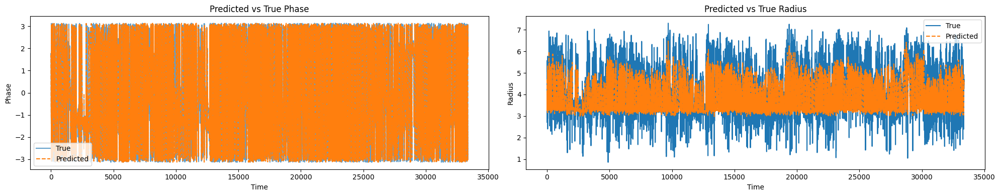

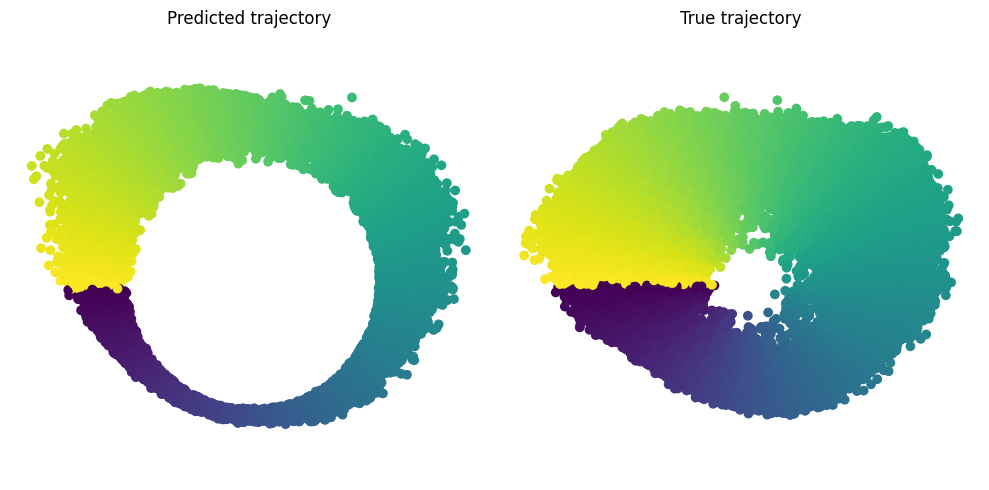

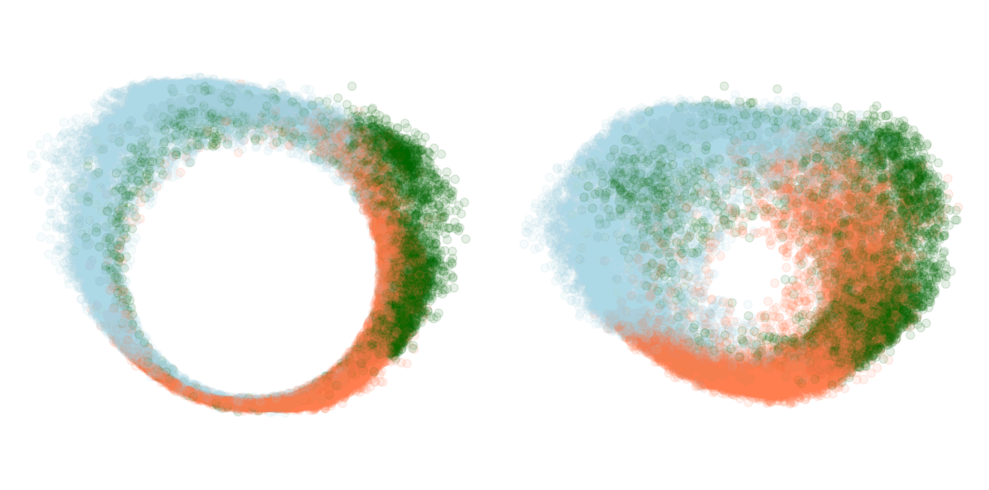

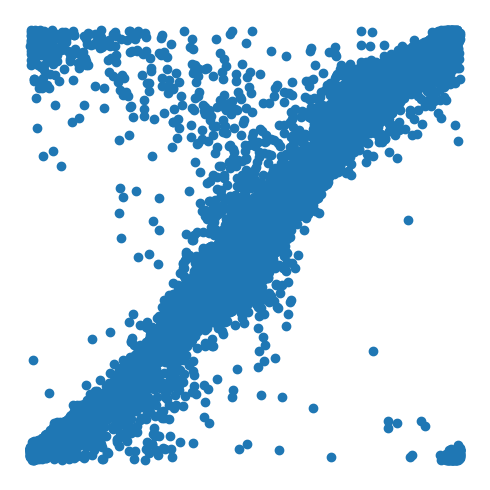

In [18]:
X_all, y_all = prepare_data(np.array([velocity, acceleration, worm_curvature, z_norm])[:,:,5:], y, T=T, holdout_idxs=[20])
X_train, X_test, y_train, y_test, input_stats = split_and_normalize(X_all, y_all, normalize=normalize)

input_dim = X_train.shape[-1]* X_train.shape[-2]
output_dim = y_train.shape[1]

model_type = 'ff'  # or 'ff'

model, train_losses, test_losses = train_model(
    X_train, y_train,
    X_test, y_test,
    input_dim=input_dim,
    output_dim=output_dim,
    model_type=model_type,
    hidden_dim=64,
    num_layers=3,
    dropout=0.5,
    learning_rate=0.001,
    num_epochs=500
)

worm_angles, worm_radii = plot_prediction(
    model=model,
    inputs=np.array([velocity, acceleration, worm_curvature, z_norm])[:,:,5:],
    y=y,
    T=T,
    y_train_mean=input_stats["y_mean"],
    y_train_std=input_stats["y_std"],
    z=np.array(z)[:,5:],
    cmap=cmap,
    normalize=normalize
)




 
worm_angles = [worm_angles[i*(1594-T):(1+i)*(1594-T)] for i in range(20)]
worm_radii = [worm_radii[i*(1594-T):(1+i)*(1594-T)] for i in range(20)]
model_beh_directed = copy.deepcopy(model)
pickle_fname = "/Users/friederikebuck/Downloads/worm notes/processed_checkpts/worm_angles_concat_beh.pickle"
with open(pickle_fname, "wb") as handle:
    pickle.dump([worm_angles, worm_radii, model_beh_directed], handle) 
    


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


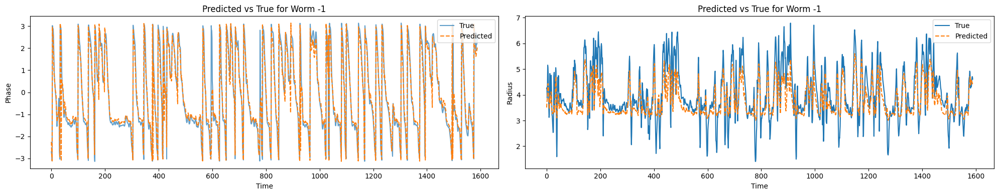

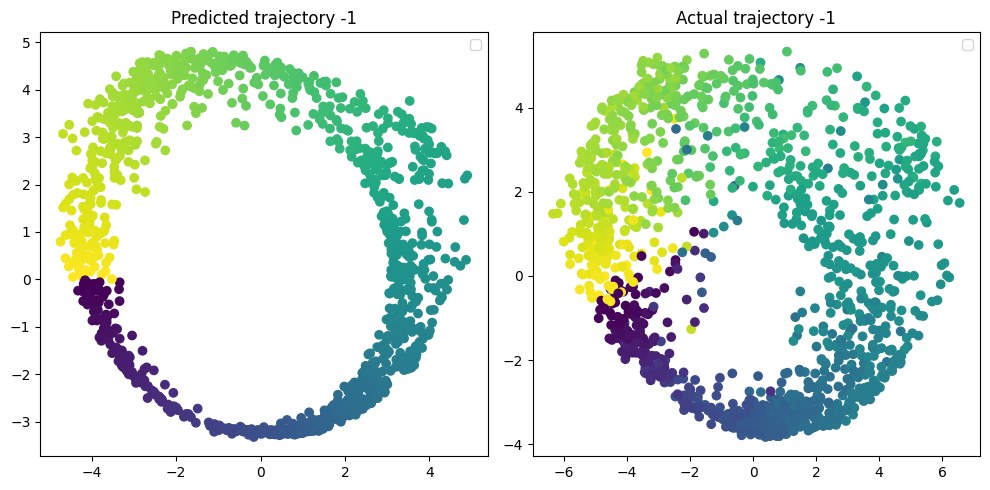

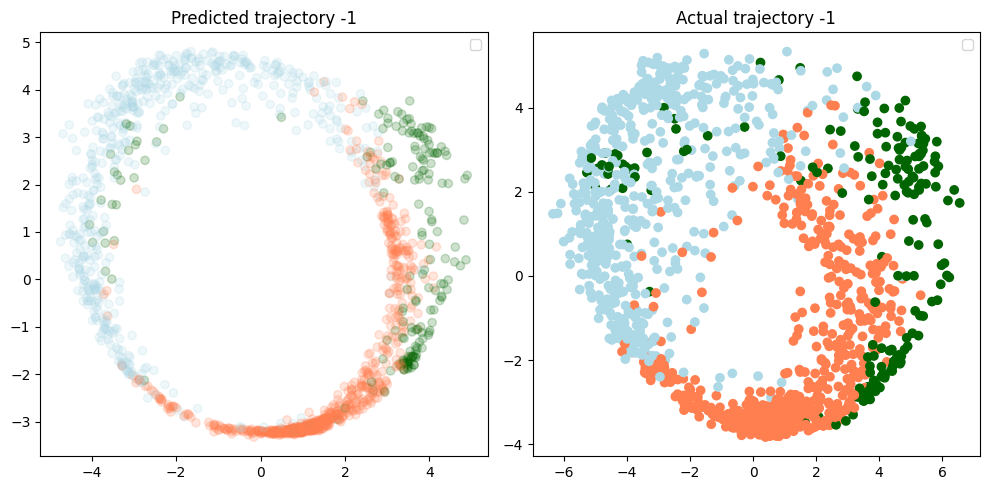

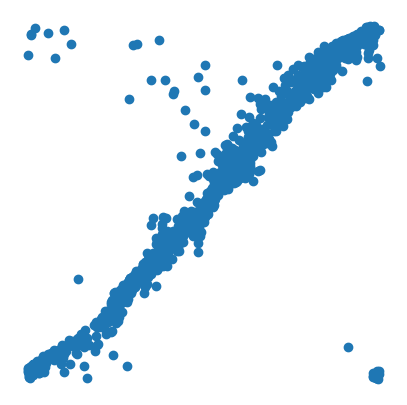

In [19]:
    
# Assuming your data, model, and other relevant variables are loaded
pred_test_angles, pred_test_radii = plot_held_out_worm(model, np.array([velocity, acceleration, worm_curvature, z_norm])[:,:,5:], y, T, input_stats, new_worm_idx=-1,z=np.array(z)[:,5:],cmap=cmap, normalize=normalize)


# Phase respomse plot

/Users/friederikebuck/Downloads/worm notes/worm_code/donut_vs_rslds_perturbation_vids.py:229: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_val, _ = mode(bin_data)
/Users/friederikebuck/Downloads/worm notes/worm_code/donut_vs_rslds_perturbation_vids.py:229: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

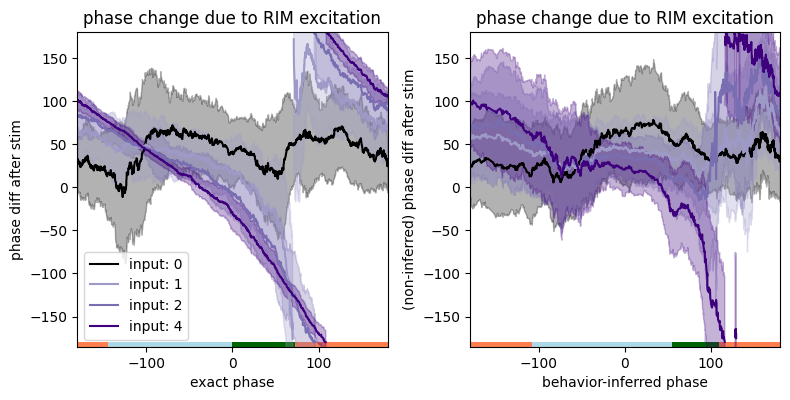

In [20]:
from donut_vs_rslds_perturbation_vids import phase_response_curve, plot_phase_resp, plot_rev_prob
t=10
inputs = np.zeros((t,new_slds.M))
input_id = input_dict["RIM"]
input_str = 1
inputs[:,input_id] = input_str


fig,ax = plt.subplots(1,2, figsize=(8,4))
colors = [plt.get_cmap("Purples")(i) for i in np.linspace(0, 1, 7)][2:]
colors[0] = (0,0,0,1)

for input_str in [0,1,2,4]:
    phase, response, final, final_beh  = phase_response_curve(new_slds, q_x[-1], input_str*inputs, pca, beh_decoder)
    plot_phase_resp(phase, response, q_z[-1], ax=ax[0], label=f"input: {input_str}", color=colors[input_str])

    plot_phase_resp((270-np.degrees(pred_test_angles))%360-180, response[5:], q_z[-1][5:], ax=ax[1], label=f"input: {input_str}", color=colors[input_str])

ax[0].set_xlabel("exact phase")
ax[0].set_ylabel("phase diff after stim")
ax[0].set_title("phase change due to RIM excitation")

ax[1].set_xlabel("behavior-inferred phase")
ax[1].set_ylabel("(non-inferred) phase diff after stim")
ax[1].set_title("phase change due to RIM excitation")

ax[0].legend()
fig.tight_layout()




# Phase reversal prob plot

/Users/friederikebuck/Downloads/worm notes/worm_code/donut_vs_rslds_perturbation_vids.py:229: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_val, _ = mode(bin_data)
/Users/friederikebuck/Downloads/worm notes/worm_code/donut_vs_rslds_perturbation_vids.py:229: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

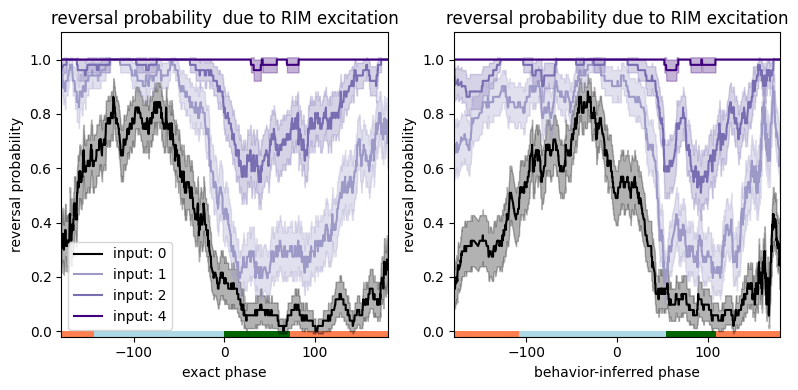

In [21]:
from donut_vs_rslds_perturbation_vids import plot_rev_prob, plot_phase_resp


fig,ax = plt.subplots(1,2, figsize=(8,4))
colors = [plt.get_cmap("Purples")(i) for i in np.linspace(0, 1, 7)][2:]
colors[0] = (0,0,0,1)

for input_str in [0,1,2,4]:
    phase, response, final, final_beh  = phase_response_curve(new_slds, q_x[-1], input_str*inputs, pca, beh_decoder)
    plot_rev_prob(phase, final_beh, q_z[-1], ax=ax[0],  label=f"input: {input_str}", color=colors[input_str])

    plot_rev_prob((270-np.degrees(pred_test_angles))%360-180, final_beh[5:], q_z[-1][5:], ax=ax[1], label=f"input: {input_str}", color=colors[input_str])

ax[0].set_xlabel("exact phase")
ax[0].set_ylabel("reversal probability")
ax[0].set_title("reversal probability  due to RIM excitation")

ax[1].set_xlabel("behavior-inferred phase")
ax[1].set_ylabel("reversal probability")
ax[1].set_title("reversal probability due to RIM excitation")

ax[0].legend()
fig.tight_layout()


worm_angles = np.array([np.radians((270-np.degrees(worm_angles[i]+np.pi))%360-180) for i in range(len(worm_angles))])
pred_test_angles = np.radians((270-np.degrees(pred_test_angles+np.pi))%360-180)

# Kernel regression funcs

In [22]:
from kernel_regression_fncs import fit_and_evaluate_kernel_regression
from donut_vs_rslds_perturbation_vids import simulate_exp, plot_results
# q_y = [slds.smooth(q_x[w], Y[w]) for w in range(21)]
q_y = [Y[w] for w in range(21)]
angles_cat = np.concatenate(worm_angles)
radii_cat = np.concatenate(worm_radii)
neurons_cat = np.concatenate(np.array(q_y[:20])[:,10:])
z_cat = np.concatenate(np.array(z[:20])[:,10:])


y_est2s = []
for neuron_name in ["AVA", "RIM", "AIB"]:


    neuron_act = neurons_cat[:, neural_labels == f"F - {neuron_name}"][:,0]
    x0,x1 = angles_cat,radii_cat
    y = neuron_act

    x = np.stack((x0, x1)).T
    x = x[y!=0]
    y = y[y!=0]

    y_est2 = fit_and_evaluate_kernel_regression(x, y, method="kernel", bandwidths=(1,0.3), plot=False, kernel_type=("uniform", "gaussian"), alpha = 0.1 + 0.2*(2%5), return_est=True)
    y_est2s.append(y_est2)


# Load and adjust data

In [ ]:
from load_and_process_FB_data_fncs_1 import load_data, reformat_data,plot_data,  analyze_data, replace_outliers_exp
# experiment = "duty_cycle"
# condition = "exp"
# neuron = "AVA"
# path = "/Users/friederikebuck/beh_analysis_results/csv/_Aim1_AVA_duty_cycle/"


# experiment = "duty_cycle"
# condition = "exp"
# neuron = "AIB"
# path = "/Users/friederikebuck/beh_analysis_results/csv/_AIBC-3_Aim1_AIB_duty_cycle/"


experiment = "duty_cycle"
condition = "exp"
neuron = "RIM"
path = "/Users/friederikebuck/beh_analysis_results/csv/_Aim1_RIM_duty_cycle/"
###using body angle mag;
# outlier speepraeted determien for neg and pos
#exp curve 0 is nan and interpolating between 

exp_data = load_data(experiment, condition, neuron, path = path)


exp_vel, exp_acc, exp_curve, exp_rev, exp_pause, exp_turn, exp_body_angle_mag  = replace_outliers_exp(exp_data, exp_data[0].shape)

exp_onsets = plot_data(exp_vel, exp_acc, exp_curve, exp_rev, exp_turn, experiment, fps=6)
# plot_data(exp_vel, exp_acc, exp_curve, exp_rev, exp_turn, experiment, fps=6)
# resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn = reformat_data(exp_vel, exp_acc, exp_curve, exp_behaviors, turns, pauses, plot=True, sep_pos_neg_resample = False)
resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn = reformat_data(exp_vel, 
                                                                                             exp_acc,
                                                                                             exp_curve,
                                                                                             exp_rev,
                                                                                             exp_turn, 
                                                                                             exp_pause,
                                                                                             z_flat,
                                                                                             velocity, 
                                                                                             acceleration, 
                                                                                             worm_curvature,
                                                                                            #  X_all,  
                                                                                             plot=True, 
                                                                                             sep_pos_neg_resample = True)


onsets = plot_data(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, experiment, fps=1.6, orig = False)

times = onsets
inferred_phases, final_behaviors, final_behaviors_all, inferred_phases_all, inferred_rad_all, behaviors_all, inferred_rad, initial_behaviors, initial_cts_beh, X_all_LSTM = analyze_data(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, times, model_beh_directed, z_norm,input_stats,  z, lag=16, inclusion_thresh = 2, model_type="ff",normalize=False, remove_revs=False)


fig,ax = plt.subplots(figsize=(4,4))
donut_x = inferred_rad_all*np.cos(inferred_phases_all)
donut_y = inferred_rad_all*np.sin(inferred_phases_all)

ax.scatter(donut_x[::10], donut_y[::10], c=behaviors_all[::10], cmap=cmap, vmin=-1, vmax=7, alpha = 0.1)


pickle_fname = f"/Users/friederikebuck/Downloads/worm notes/processed_checkpts/aim1_FB_beh_{neuron}_{condition}_{experiment}_phase_features_exp.pickle"
with open(pickle_fname, "wb") as handle:
    pickle.dump([resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,behaviors_all,  inferred_phases_all, inferred_rad_all], handle) 


[]
NOT using body angle mag for curvature


In [ ]:


from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression, Lasso, TweedieRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn import tree
import warnings
from predict_latency_prob_from_features_donut_6 import prep_FB_inputs, fit_visualize_model_classifiction, prep_FB_inputs_donut_only, prep_FB_inputs_features_only, fit_visualize_model_regression, latency_to_reversal
from predict_latency_prob_from_features_donut_6 import prep_FB_inputs_select_features_only, prep_FB_inputs_features_only, feature_all_to_resampled, resample_2d
# # from predict_latency_prob_from_features_donut_6 import visualize_model_classification, combine_FB_features_across_stim, prep_FB_inputs_select_features_only, latency_to_reversal, fit_visualize_model_regression
from predict_latency_prob_from_features_donut_6 import prep_FB_inputs_select_features_only, prep_FB_inputs_features_only

from predict_latency_prob_from_features_donut_6 import prep_FB_inputs_select_features_only, prep_FB_inputs_features_only
from predict_latency_prob_from_features_donut_6 import prep_FB_inputs_select_features_only, prep_FB_inputs_features_only
from predict_latency_prob_from_features_donut_6 import visualize_model_classification, combine_FB_features_across_stim
from predict_latency_prob_from_features_donut_6 import prep_FB_inputs_feature_and_donut, prep_FB_inputs_features_only
# from predict_latency_prob_from_features_donut import visualize_model_classification, combine_FB_features_across_stim


from predict_latency_prob_from_features_donut_6 import prep_FB_inputs_select_features_only, prep_FB_inputs_features_only, feature_all_to_resampled

from predict_latency_prob_from_features_donut_6 import resample_2d, fit_visualize_model_regression, feature_all_to_resampled

from predict_latency_prob_from_features_donut_6 import visualize_model_regression


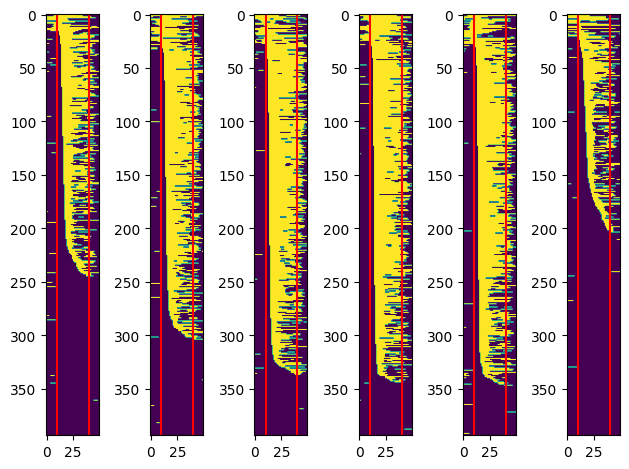

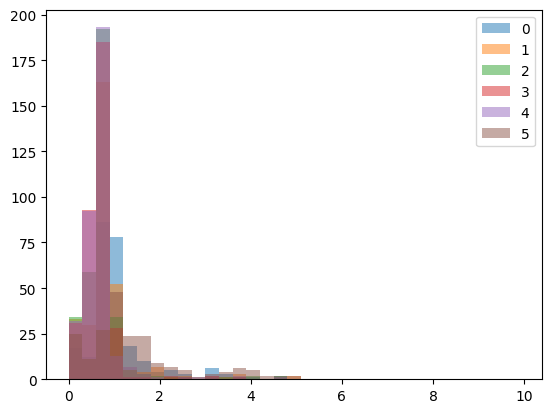

In [ ]:
if experiment == "time_titration":
    durations = [1,3,5,10]
else:
    durations = [5,5,5,5,5,5]
    if experiment == "hiscl":
        durations = [5,5]

exp_offsets = np.array([exp_onsets[i] + 6*durations[i] for i in range(len(durations))])


fig,ax = plt.subplots(1,len(durations))
fig2,ax2 = plt.subplots()

latencies = []
for i in range(len(durations)):
    latency = latency_to_reversal(exp_rev, exp_onsets[i], max_latency = 6*durations[i]+1)
    idx = np.argsort(latency)
    ax[i].imshow(exp_rev[idx, -10+exp_onsets[i]:exp_offsets[i]+10], aspect="auto")
    ax[i].axvline(10, c='r')
    ax[i].axvline(10+6*durations[i], c='r')
    ax2.hist(latency/6, bins = np.arange(0,10,.3), alpha = 0.5, label=i)
    # latency[np.isnan(latency)] = np.nanmax(latency)+1
    latencies.append(latency)
fig.tight_layout()
latencies = np.array(latencies)/6
ax2.legend()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


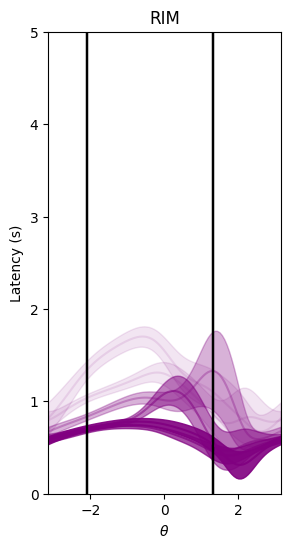

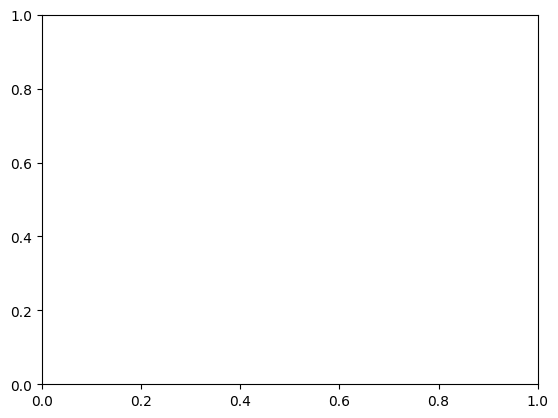

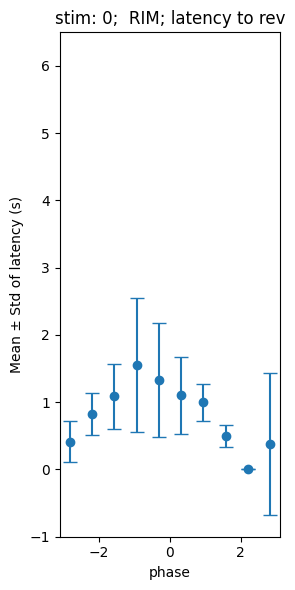

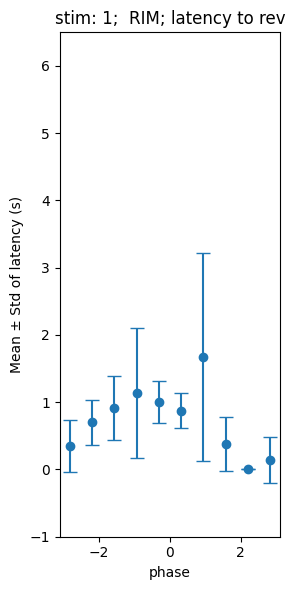

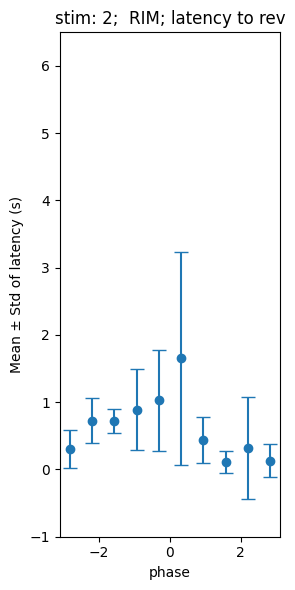

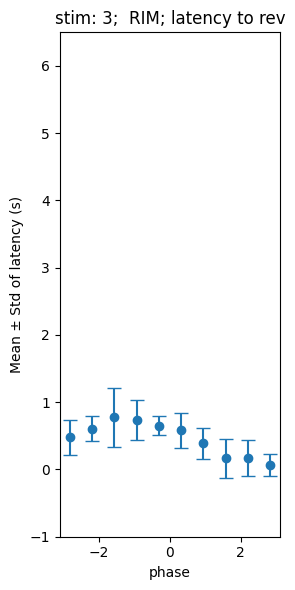

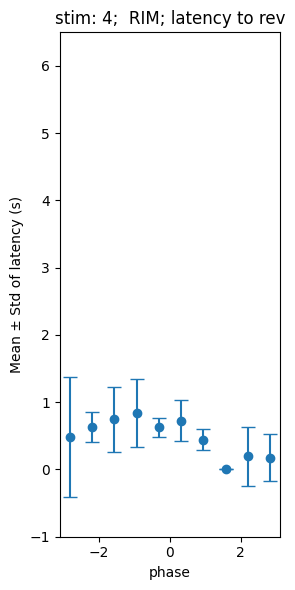

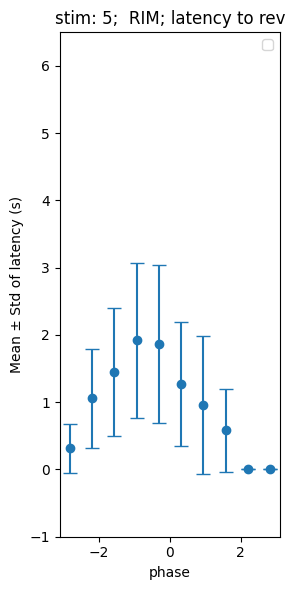

In [ ]:
# Plot

def plot_binned_counts(x,y,title_supp="",  fig = None, ax = None, n_bins = 10):
    # Define bin edges
    bin_edges = np.linspace(-1*np.pi, np.pi, n_bins + 1)

    # Digitize x values to bin indices
    bin_indices = np.digitize(x, bin_edges) - 1

    # Preallocate arrays
    means = np.zeros(n_bins)
    stds = np.zeros(n_bins)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

    # Compute mean and std per bin
    for i in range(n_bins):
        mask = bin_indices == i
        if np.any(mask):
            means[i] = np.mean(y[mask])
            stds[i] = np.std(y[mask])
        else:
            means[i] = np.nan
            stds[i] = np.nan

    ax.errorbar(bin_centers, means, yerr=stds, fmt='o', capsize=5)
    ax.set_xlabel('phase')
    ax.set_ylabel('Mean ± Std of latency (s)')
    ax.set_ylim([-1,6.5])
    ax.set_title(f'{title_supp} {neuron}; latency to rev')
    # plt.show()


fig,ax = plt.subplots(figsize=(3,6))

idxs = [[0],[1],[2],[3],[4],[5]]

cdf_fig, cdf_ax  = plt.subplots()
for i in range(len(idxs)):

    x0,x1 = np.concatenate(inferred_phases[idxs[i]]), np.concatenate(inferred_rad[idxs[i]])
    y = np.concatenate(latencies[idxs[i]])
    non_nan_ys = np.logical_not(np.isnan(y))
    x = np.stack((x0, x1)).T
    x = x[~np.isnan(y)]
    y = y[~np.isnan(y)]
    
    fig1,ax1 = plt.subplots(figsize=(3,6))
    # ax1.scatter(x0[non_nan_ys], y, label = i)
    plot_binned_counts(x0[non_nan_ys],y,title_supp = f"stim: {i}; ",fig = fig1, ax = ax1, n_bins = 10)
    
    
    y_est = fit_and_evaluate_kernel_regression(x, y, method="kernel", bandwidths=(0.3,0.3), plot=True, kernel_type=("vonmises", "gaussian"), ax=ax, alpha = 0.1 + 0.2*(i%5), return_est=True)
    ax.set_xlabel(r"$\theta$")
    ax.set_ylabel("Latency (s)")
    ax.set_ylim(0,5)
    ax.set_title(neuron)
    ax.axvline(-2.1, color='k')
    ax.axvline(1.3, color='k')
    ax.set_xlim(-np.pi, np.pi)
    
    # plot_cdf(latencies, ax )

ax1.legend()





Processing i=0, n_timesteps=1


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


n_timesteps 459
n_timesteps 459
[[-1.4078275  -1.5143106   0.30588162 -1.23391354 -1.38602066 -2.18727851
  -1.75387275 -1.84632301 -1.38312292 -1.63861966 -0.90943468 -1.39856768
  -1.19813132 -1.46015584 -1.47934759 -2.13368249 -1.43250513 -1.45702708
  -1.50638413 -1.22987175 -2.43109298 -1.72678924 -1.46542811 -1.74367261
  -0.63423705 -0.26052624 -1.33279634 -1.63683867 -2.98865986 -2.68590117
  -2.50137854 -0.66141969 -0.80212438  0.22763732 -1.49111938 -1.74018443
  -1.37138665  0.08299123  2.51891923 -1.35413396 -0.6286121  -0.68603039
   2.78339863 -2.38291836 -2.1840477  -1.77437818 -0.85084885  0.04224337
  -2.8446908  -1.32232106 -1.44199812 -1.50943255 -2.21894336 -1.23362315
  -2.78232503 -1.29580581 -3.07022262 -1.0594908  -1.28614473 -1.61513245
  -1.53090429 -1.62627137 -1.44252574 -1.15463758 -0.22258523 -1.38602531
  -1.19449568 -1.35046506  0.14090566 -1.14903903 -1.89981925 -1.57658136
  -1.46526134 -1.33420813 -0.94415683 -2.71738267 -2.11417675 -1.18752229
  -1.1

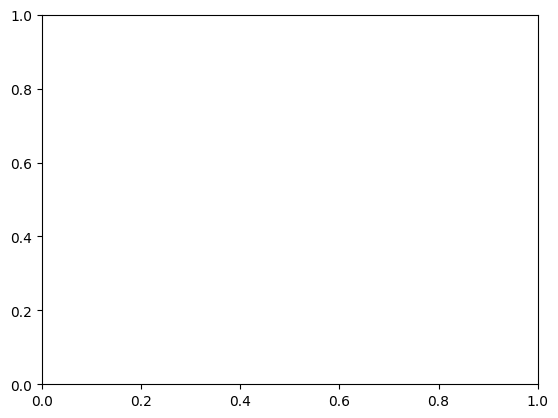

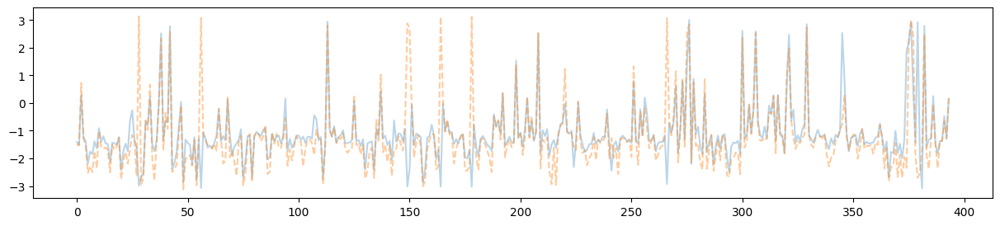

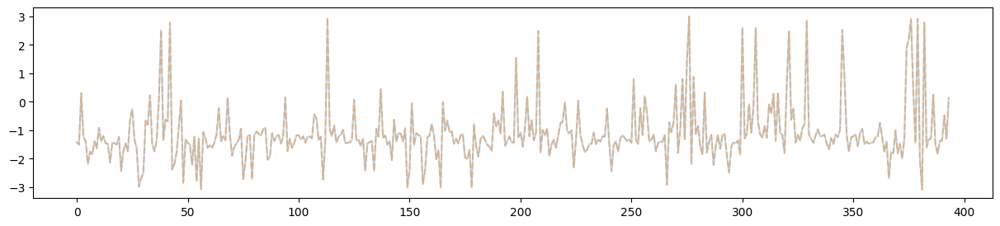

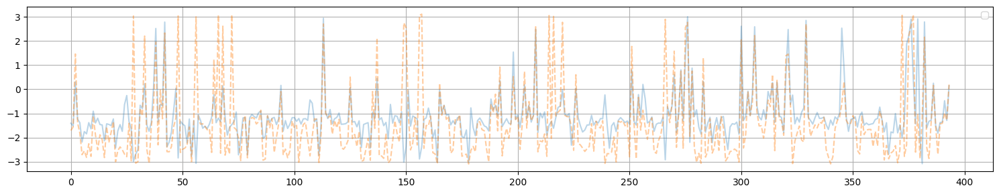

In [ ]:
###############
###############checkk get donut stim works** 
###get inputs into lstm 
###############
beh_map = [z_norm.min(), z_norm.min()/2 + z_norm.max()/2, z_norm.max()]


import warnings
    



from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import balanced_accuracy_score
from sklearn.linear_model import Lasso
from sklearn.metrics import r2_score
import matplotlib.pyplot as plt
import numpy as np
import copy
import pickle
import matplotlib.cm as cm
n_tracks = resampled_rev.shape[0]
n_splits = 10
results_dict = {}  # Store mean/std r² per i and n_timesteps
best_models = {}   # Store best model per (i, n_timesteps)
T = 5
idxs = [[0],[1],[2],[3],[4],[5]]
fig, ax = plt.subplots()
for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
    score_means = []
    score_stds = []
    # all_r2_means = []
    all_scores_per_i = {}
    n_timesteps_list = []
    

    # for n_timesteps in range(5, 10, 2):
    for n_timesteps in range(1, 15, 3):
        print(f"\nProcessing i={i}, n_timesteps={n_timesteps}")
        # feature_names = np.array([[f"vel_t-{n_timesteps - t - 1}", f"accel_t-{n_timesteps - t - 1}",
        #                            f"curv_t-{n_timesteps - t - 1}", f"beh_t-{n_timesteps - t - 1}"]
        #                           for t in range(n_timesteps)]).flatten()

        # X_stim = prep_FB_inputs(resampled_vel, resampled_acc, resampled_curve, resampled_rev,
        #                         resampled_turn, T=n_timesteps)  # shape (n_tracks, n_frames, n_features)
        # X_stim_all, feature_names = prep_FB_inputs_features(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,   T = T
        #         #    times, beh_map, 
        #         #    lag=16, inclusion_thresh =3, 
        #         #    remove_revs=False, 
                  
                  
                  
        #            )
        

        X_stim_features, feature_names = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,resampled_onset, n_timesteps, z)#shape (n_tracks, n_frames, n_features)
        X_donut_stim, donut_names = prep_FB_inputs_donut_only( inferred_phases_all, inferred_rad_all, resampled_onset, n_tracks)
        # X_donut_stim = np.concatenate([inferred_phases[i][:, None], inferred_rad[i][:, None]], axis =1)

        X_stim_all =  np.concatenate([X_stim_features ,  X_donut_stim], axis = 1)
        feature_names_all = np.array(feature_names.tolist()+donut_names)
        print(inferred_phases[idxs[i]])
        fig, ax = plt.subplots(figsize = (15,3))
        ax.plot(inferred_phases[idxs[i]].flatten(), alpha = 0.3)
        ax.plot(X_donut_stim[:,0], linestyle='dashed', alpha = 0.4)
        
        
        
        
        X_donut_stim, donut_names = prep_FB_inputs_donut_only( inferred_phases_all, inferred_rad_all, resampled_onset-1, n_tracks) ##is there an off by one error??
        # X_donut_stim = np.concatenate([inferred_phases[idxs[i]], inferred_rad[idxs[i]]])

        X_stim_all =  np.concatenate([X_stim_features ,  X_donut_stim], axis = 1)
        feature_names_all = np.array(feature_names.tolist()+donut_names)
        print(inferred_phases[idxs[i]])
        fig, ax = plt.subplots(figsize = (15,3))
        ax.plot(inferred_phases[idxs[i]].flatten(), alpha = 0.3)
        ax.plot(X_donut_stim[:,0], linestyle='dashed', alpha = 0.4)
        
        X_donut_stim, donut_names = prep_FB_inputs_donut_only( inferred_phases_all, inferred_rad_all, resampled_onset+1, n_tracks)
        # X_donut_stim = np.concatenate([inferred_phases[idxs[i]], inferred_rad[idxs[i]]])

        X_stim_all =  np.concatenate([X_stim_features ,  X_donut_stim], axis = 1)
        feature_names_all = np.array(feature_names.tolist()+donut_names)
        print(inferred_phases[idxs[i]])
        fig, ax = plt.subplots(figsize = (15,3))
        ax.plot(inferred_phases[idxs[i]].flatten(), alpha = 0.3)
        ax.plot(X_donut_stim[:,0], linestyle='dashed', alpha = 0.4)
        
        
        break
    break

ax.legend()
plt.grid(True)
plt.tight_layout()
# plt.savefig(f"r2_plot_i{i}.png")
# plt.close()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import copy

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import balanced_accuracy_score
from sklearn.linear_model import Lasso
from sklearn.metrics import r2_score
import matplotlib.pyplot as plt

import copy
import pickle
import matplotlib.cm as cm

import warnings
    
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression, Lasso, TweedieRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn import tree


from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import balanced_accuracy_score
from sklearn.linear_model import Lasso
from sklearn.metrics import r2_score
import copy
import pickle

import pandas as pd 

from plot_donut_vs_phase import create_X_sequences


def feature_all_to_resampled(inferred_phases_all, n_tracks):
   
    inferred_phases_all = inferred_phases_all.reshape(n_tracks, -1)
   
    n_timesteps = inferred_phases_all.shape[1]
    print("n_timesteps", n_timesteps)
    # inferred_phases_all_shifted = np.zeros((n_tracks,n_timesteps+5+8))+np.nan #ask Bennet about the 8 extra time steps missing
    # inferred_phases_all_shifted[:, 5:-8] = inferred_phases_all
    
    inferred_phases_all_shifted = np.zeros((n_tracks,n_timesteps+5+8+8))+np.nan #ask Bennet about the 8 extra time steps missing
    inferred_phases_all_shifted[:, 5:-16] = inferred_phases_all
    return inferred_phases_all_shifted

def flatten_and_remove_nans(resampled_features):
    return resampled_features.flatten()

def prep_FB_inputs(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, z,   T = 5
                #    times, beh_map, 
                #    lag=16, inclusion_thresh =3, 
                #    remove_revs=False, 
                  
                   ): 

    behavior_input = np.array(resampled_rev+2*resampled_turn, dtype=np.float64)
    behavior_input -= np.array(z).mean()
    behavior_input /= np.array(z).std()

    X_all_LSTM = []
    for new_worm_idx in range(len(resampled_vel)):
       
        X_new_worm = np.stack([resampled_vel[new_worm_idx], resampled_acc[new_worm_idx], resampled_curve[new_worm_idx], behavior_input[new_worm_idx]], axis=1)  
        # X_new_worm = np.stack([resampled_vel[new_worm_idx], resampled_acc[new_worm_idx], behavior_input[new_worm_idx]], axis=1)  
        X_new_tensor = torch.tensor(X_new_worm, dtype=torch.float32)
        
        if T > 0:
            X_new_seq1 = create_X_sequences(X_new_tensor, T).numpy() #torch.Size([475, 5, 4]), = n_frames, time delay, 4 is the feature  #
        else: 
            X_new_seq1 = X_new_tensor.numpy()
        
        n_frames, delay, n_features = X_new_seq1.shape
        X_new_seq1 = X_new_seq1.reshape((n_frames,  delay*n_features)) # check how this is shaped it will be f1_t-T, f2_t-T, f3_t-T, f4_t-T, ; f1_t-T+1, f2_T+1, f3_T+1 f4_T+1
        
            
        X_all_LSTM.append(X_new_seq1)
    # X_all_LSTM = np.concatenate(X_all_LSTM, axis = 1 ) # i guess should check if reshape how it reshapes.. ie if feautres are all together or not 
    X_all_LSTM = np.array(X_all_LSTM)#shape (n_tracks, n_frames, n_features)
    # feature_names = np.array([[f"vel_t-{T - t - 1}", f"accel_t-{T - t - 1}",
    #                                f"curv_t-{T - t - 1}", f"beh_t-{T - t - 1}"]
    #                               for t in range(T)]).flatten()

    return X_all_LSTM


    
    
def plot_coeffs(model, feature_names, model_label,  n_time_steps, feature_names_ordered = None, xlim = None, coeffs = None):
    if coeffs is None: 
            
        try: 
            
            coeffs = model.coef_
        except: 
            # print(model.coef_.shape)
            coeffs = model.coef_[0]
            # coeffs = pd.Series(model.coef_[0], index=feature_names)
            
        if feature_names_ordered : 
            coeffs = coeffs.reshape(n_time_steps,-1 ).reshape((len(feature_names), -1), order='F').flatten()
            feature_names = feature_names.reshape( n_time_steps, -1).reshape((len(feature_names), -1), order='F').flatten()
    # if coeffs is None: 
    try: 
        coeffs = pd.Series(model.coef_, index=feature_names)
    except:
        coeffs = pd.Series(model.coef_[0], index=feature_names)
        # sort_indices = np.argsort(np.argsort(feature_names_ordered)[np.argsort(feature_names)])
        # coeffs = coeffs[sort_indices]
        # feature_names = feature_names[sort_indices]

    # Filter non-zero coefficients and sort
    # nonzero_coeffs = coeffs[coeffs != 0].sort_values()
    nonzero_coeffs = coeffs

    # Plot
    fig_height = max(2, 0.3 * len(nonzero_coeffs))
    fig, ax = plt.subplots(figsize=(8, fig_height))

    # Plot on ax
    nonzero_coeffs.plot(kind='barh', ax=ax)

    # Labels and formatting
    ax.set_xlabel("Coefficient Value")
    if xlim is not None: 
        
        ax.set_xlim(xlim)
    ax.set_title(f"{model_label} coefficients")
    ax.grid(True, axis='x')

    fig.tight_layout()
    return fig, ax 
    # plt.show()
    
def fit_visualize_model_classifiction(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_time_steps, get_coeff = True,  feature_names_ordered = None,  xlim = None, coeffs = None):
    
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    # model_label = f"{i}; logistic"
    print(f"{model_label}Accuracy:", accuracy_score(y_test, y_pred))
    print(f"{model_label}Precision:", precision_score(y_test, y_pred, average='weighted'))
    print(f"{model_label}Recall:", recall_score(y_test, y_pred, average='weighted'))
    print(f"{model_label}F1 Score:", f1_score(y_test, y_pred, average='weighted'))
    disp = ConfusionMatrixDisplay.from_estimator(model, X_train,  y_train, cmap='Blues')
    disp.ax_.set_title(f"{model_label}train")
    disp = ConfusionMatrixDisplay.from_estimator(model, X_test,  y_test, cmap='Blues')
    disp.ax_.set_title(f"{model_label}test")
    if get_coeff:
        fig, ax = plot_coeffs(model, feature_names, model_label, n_time_steps, feature_names_ordered = feature_names_ordered, xlim = xlim, coeffs = coeffs)
        ax.set_title(f"{model_label}")
    return model, y_pred

def fit_visualize_model_regression(model, model_label, feature_names, X_train, X_test, y_train, y_test,n_time_steps, feature_names_ordered = None, coeffs = None):
    # model_real = copy.deepcopy(model)
    # model_real.fit(X_train, y_train)
    # print(f"{model_label} Linear Regression R²:", model.score(X_test, y_test))
    # # print("Coefficients:", model.coef_)
    # # model_label= f"{i};lin"
    # plot_results(model_label, feature_names, X_train, X_test, y_train, y_test, n_time_steps, feature_names_ordered = feature_names_ordered)
    fit_visualize_model_regression_vs_shuffle(model, model_label, feature_names, X_train, X_test, y_train, y_test,n_time_steps, feature_names_ordered = feature_names_ordered, coeffs = coeffs)


def latency_to_reversal(reshaped_rev, start_time, max_latency=None):
    n_worms, T = reshaped_rev.shape
    latencies = np.full(n_worms, np.nan)

    for i in range(n_worms):
        end_time = T if max_latency is None else min(T, start_time + max_latency)
        future = reshaped_rev[i, start_time:end_time]
        reversal_indices = np.where(future)[0]
        if reversal_indices.size > 0:
            latencies[i] = reversal_indices[0]
    
    return latencies

    
def fit_visualize_model_regression_vs_shuffle(model, model_label, feature_names, X_train, X_test, y_train, y_test,n_time_steps, feature_names_ordered = None, coeffs = None):
    model_real = copy.deepcopy(model)
    model_real.fit(X_train, y_train)
    # print(f"{model_label} Linear Regression R²:", model_real.score(X_test, y_test))
    # plot_results(model_real, model_label, feature_names, X_train, X_test, y_train, y_test, n_time_steps, feature_names_ordered = feature_names_ordered, compare_to_suffle = compare_to_suffle  )
    # print("Coefficients:", model.coef_)
    # model_label= f"{i};lin"
    model_shuffle = copy.deepcopy(model)
    model_shuffle.fit(X_train, np.random.permutation(y_train))
    # plot_results(model_shuffle, model_label, feature_names, X_train, X_test, y_train, y_test, n_time_steps, feature_names_ordered = feature_names_ordered, compare_to_suffle = compare_to_suffle  )
    
    
    y_pred_real = model_real.predict(X_test)
    fig, axs = plt.subplots(1,2)
    ax = axs[0]
    ax.scatter(y_test, y_pred_real, alpha=0.7)
    ax.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
    ax.set_xlabel("Test Actual Latency")
    ax.set_ylabel("Test Predicted Latency")
    ax.set_title( f"{model_label}; R²:{np.round(model_real.score(X_test, y_test),2)}")
    
    y_pred_shuffled = model_shuffle.predict(X_test)
    ax = axs[1]
    ax.scatter(y_test, y_pred_shuffled, alpha=0.7)
    ax.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
    ax.set_xlabel("Test Actual Latency")
    ax.set_ylabel("Test Predicted Latency")
    ax.set_title( f"{model_label}; shuffled; R²:{np.round(model_shuffle.score(X_test, y_test),2)}")
    # plt.tight_layout()
    y_pred_real = model_real.predict(X_train)
    fig, axs = plt.subplots(1,2)
    ax = axs[0]
    ax.scatter(y_train, y_pred_real, alpha=0.7)
    ax.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2)
    ax.set_xlabel("Train Actual Latency")
    ax.set_ylabel("Train Predicted Latency")
    ax.set_title( f"{model_label}; R²:{np.round(model_real.score(X_train, y_train),2)}")
    
    y_pred_shuffled = model_shuffle.predict(X_train)
    ax = axs[1]
    ax.scatter(y_train, y_pred_shuffled, alpha=0.7)
    ax.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2)
    ax.set_xlabel("Train Actual Latency")
    ax.set_ylabel("Train Predicted Latency")
    ax.set_title( f"{model_label}; shuffled; R²:{np.round(model_shuffle.score(X_train, y_train),2)}")
    # plt.tight_layout()
    
    plot_coeffs(model_real, feature_names,model_label,n_time_steps,   feature_names_ordered = feature_names_ordered, coeffs = coeffs)


def visualize_model_regression(model, model_label, feature_names, X_train, X_test, y_train, y_test,n_time_steps, feature_names_ordered = None, xlim = None, coeffs = None):
    model_real = copy.deepcopy(model)
    # model_real.fit(X_train, y_train)
    # # print(f"{model_label} Linear Regression R²:", model_real.score(X_test, y_test))
    # # plot_results(model_real, model_label, feature_names, X_train, X_test, y_train, y_test, n_time_steps, feature_names_ordered = feature_names_ordered, compare_to_suffle = compare_to_suffle  )
    # # print("Coefficients:", model.coef_)
    # # model_label= f"{i};lin"
    # model_shuffle = copy.deepcopy(model)
    # model_shuffle.fit(X_train, np.random.permutation(y_train))
    # # plot_results(model_shuffle, model_label, feature_names, X_train, X_test, y_train, y_test, n_time_steps, feature_names_ordered = feature_names_ordered, compare_to_suffle = compare_to_suffle  )
    
    
    y_pred_real = model_real.predict(X_test)
    fig, axs = plt.subplots(1,2)
    ax = axs[0]
    ax.scatter(y_test, y_pred_real, alpha=0.7)
    ax.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
    ax.set_xlabel("Test Actual Latency")
    ax.set_ylabel("Test Predicted Latency")
    ax.set_title( f"{model_label}; R²:{np.round(model_real.score(X_test, y_test),2)}")
    
    # y_pred_shuffled = model_shuffle.predict(X_test)
    # ax = axs[1]
    # ax.scatter(y_test, y_pred_shuffled, alpha=0.7)
    ax.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
    ax.set_xlabel("Test Actual Latency")
    ax.set_ylabel("Test Predicted Latency")
    # test_r2 = model_shuffle.score(X_test, y_test)
    
    # ax.set_title( f"{model_label}; shuffled; R²:{np.round(test_r2,2)}")
    plt.tight_layout()
    y_pred_real = model_real.predict(X_train)
    # fig, ax = plt.subplots()
    ax = axs[1]
    ax.scatter(y_train, y_pred_real, alpha=0.7)
    ax.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2)
    ax.set_xlabel("Train Actual Latency")
    ax.set_ylabel("Train Predicted Latency")
    test_r2 = model_real.score(X_train, y_train)
    ax.set_title( f"{model_label}; R²:{np.round(test_r2,2)}")
    
    # y_pred_shuffled = model_shuffle.predict(X_train)
    # ax = axs[1]
    # ax.scatter(y_train, y_pred_shuffled, alpha=0.7)
    # ax.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2)
    ax.set_xlabel("Train Actual Latency")
    ax.set_ylabel("Train Predicted Latency")
    # ax.set_title( f"{model_label}; shuffled; R²:{np.round(model_shuffle.score(X_train, y_train),2)}")
    plt.tight_layout()
    
    fig, ax = plot_coeffs(model, feature_names, model_label, n_time_steps, feature_names_ordered = feature_names_ordered, xlim = xlim, coeffs = coeffs)
    

############
##############

def prep_FB_inputs_donut_only( inferred_phases_all, inferred_rad_all, resampled_onset, n_tracks):
    phase_resampled = feature_all_to_resampled(inferred_phases_all, n_tracks)
    radii_resampled = feature_all_to_resampled(inferred_rad_all, n_tracks) 
    
    X_donut_stim = np.concatenate([phase_resampled[:, resampled_onset, None] ,  radii_resampled[:, resampled_onset, None] ], axis = 1)
    # X_donut_stim = X_donut[:, resampled_onset,:]
    
    feature_names = ["phase", "radius"]
    return X_donut_stim, feature_names

    
def prep_FB_inputs_feature_and_donut(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, inferred_phases_all, inferred_rad_all,resampled_onset, n_tracks,   n_timesteps, z,lstm_lag = 5, include_beh = False):
    # print("n_timesteps", n_timesteps)
    X_stim_features, feature_names = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, resampled_onset,   n_timesteps,z, lstm_lag = lstm_lag, include_beh = include_beh)#shape (n_tracks, n_frames, n_features)

    X_donut_stim, donut_names = prep_FB_inputs_donut_only( inferred_phases_all, inferred_rad_all, resampled_onset, n_tracks)

    X_stim_all =  np.concatenate([X_stim_features ,  X_donut_stim], axis = 1)
    feature_names_all = np.array(feature_names.tolist()+donut_names)
    return X_stim_all, feature_names_all


    
def visualize_model_classification(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_time_steps, get_coeff = True,  feature_names_ordered = None,  xlim = None, coeffs = None):
    
    # model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    print(f"{model_label}Accuracy:", accuracy_score(y_test, y_pred))
    print(f"{model_label}Precision:", precision_score(y_test, y_pred, average='weighted'))
    print(f"{model_label}Recall:", recall_score(y_test, y_pred, average='weighted'))
    print(f"{model_label}F1 Score:", f1_score(y_test, y_pred, average='weighted'))
    # disp = ConfusionMatrixDisplay.from_estimator(model, X_train,  y_train, cmap='Blues')
    # disp.ax_.set_title(f"{model_label}train")
    disp = ConfusionMatrixDisplay.from_estimator(model, X_test,  y_test, cmap='Blues')
    disp.ax_.set_title(f"{model_label}test")
    if get_coeff:
        fig, ax = plot_coeffs(model, feature_names, model_label, n_time_steps, feature_names_ordered = feature_names_ordered, xlim = xlim, coeffs = coeffs)
        ax.set_title(f"{model_label}")
    return model, y_pred

def resample_fps(feature_arr, target_fps,  original_fps):
    # Resample using linear interpolation
    indices = np.arange(len(feature_arr))
    new_indices = np.linspace(0, len(feature_arr) - 1, int(len(feature_arr) * (target_fps / original_fps)))
    resampled_values = np.interp(new_indices, indices, feature_arr)
    return resampled_values

def resample_2d(inferred_phases_all_shifted, target_fps,  original_fps):
    n_tracks = inferred_phases_all_shifted.shape[0]
    resampled_tracks = []
    for track_i in range(n_tracks):
        resampled = resample_fps(inferred_phases_all_shifted[track_i, :], target_fps,  original_fps)
        resampled_tracks.append(resampled[None,:])

    inferred_phases_all_shifted_high_fps = np.concatenate(resampled_tracks, axis= 0 )
    return inferred_phases_all_shifted_high_fps



def plot_results_prediction(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_time_steps, feature_names_ordered = None):
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    fig, ax = plt.subplots()
    ax.scatter(y_test, y_pred, alpha=0.7)
    ax.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
    ax.set_xlabel("Test Actual Latency (s) ")
    ax.set_ylabel("Test Predicted Latency (s) ")
    ax.set_title( f"{model_label}; R²:{model.score(X_test, y_test)}")
    ax.set_ylim([0,6])
    ax.set_xlim([0,6])
    
    
    
    y_pred = model.predict(X_train)
    fig, ax = plt.subplots()
    ax.scatter(y_train, y_pred, alpha=0.7)
    ax.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2)
    ax.set_xlabel("Train Actual Latency (s) ")
    ax.set_ylabel("Train Predicted Latency (s) ")
    ax.set_title( f"{model_label}; R²:{model.score(X_train, y_train)}")
    ax.set_ylim([0,6])
    ax.set_xlim([0,6])
    
    plot_coeffs(model, feature_names,model_label,n_time_steps,   feature_names_ordered = feature_names_ordered)
  
  
def prep_FB_inputs_select_features_only(
    # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
    features_list, feature_labels, resampled_onset,  n_timesteps, z, lstm_lag = 5, stim_onset = None, fps = None
   
                   ): 
    if fps is None: 
        fps = 1


    # behavior_input = np.array(resampled_rev+2*resampled_turn, dtype=np.float64)
    # behavior_input -= np.array(z).mean()
    # behavior_input /= np.array(z).std()

    X_all_LSTM = []
    for new_worm_idx in range(len(features_list[0])):
        X_new_worm = np.stack([feature[new_worm_idx] for feature in features_list
                                ], axis=1)  
        feature_names = np.array([[f"{lbl}_t-{(n_timesteps - t - 1)/fps}" for lbl in feature_labels] for t in range(n_timesteps)]).flatten()
                                
                                # f"beh_t-{n_timesteps - t - 1}"
               
            # feature_names = np.array([[f"vel_t-{n_timesteps - t - 1}", f"accel_t-{n_timesteps - t - 1}",
            #                     f"curv_t-{n_timesteps - t - 1}", 
                                
            #                     # f"beh_t-{n_timesteps - t - 1}"
            #                     ]
            #                     for t in range(n_timesteps)]).flatten()
        # X_new_worm = np.stack([resampled_vel[new_worm_idx], resampled_acc[new_worm_idx], behavior_input[new_worm_idx]], axis=1)  
        X_new_tensor = torch.tensor(X_new_worm, dtype=torch.float32)
        
        if n_timesteps> 0:
            X_new_seq1 = create_X_sequences(X_new_tensor, n_timesteps).numpy() #torch.Size([475, 5, 4]), = n_frames, time delay, 4 is the feature  #
        else: 
            X_new_seq1 = X_new_tensor.numpy()
        
        n_frames, delay, n_features = X_new_seq1.shape
        X_new_seq1 = X_new_seq1.reshape((n_frames,  delay*n_features)) # check how this is shaped it will be f1_t-T, f2_t-T, f3_t-T, f4_t-T, ; f1_t-T+1, f2_T+1, f3_T+1 f4_T+1

        
        X_all_LSTM.append(X_new_seq1)
    # X_all_LSTM = np.concatenate(X_all_LSTM, axis = 1 ) # i guess should check if reshape how it reshapes.. ie if feautres are all together or not 
    X_all_LSTM = np.array(X_all_LSTM)#shape (n_tracks, n_frames, n_features)

    if stim_onset is None: 
        stim_onset = resampled_onset - lstm_lag
    X_stim_features = X_all_LSTM[:, stim_onset, :]
    # X_stim_features = X_all_LSTM[:, resampled_onset - lstm_lag, :]

    return X_stim_features, feature_names

def prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, resampled_onset,  n_timesteps, z, lstm_lag = 5, stim_onset = None, 

                  include_beh = False, fps = None
                   ): 
    # print("n_timesteps", n_timesteps)
    behavior_input = np.array(resampled_rev+2*resampled_turn, dtype=np.float64)
    behavior_input -= np.array(z).mean()
    behavior_input /= np.array(z).std()
    if fps is None: 
        fps = 1

    X_all_LSTM = []
    for new_worm_idx in range(len(resampled_vel)):
        if include_beh:
            X_new_worm = np.stack([resampled_vel[new_worm_idx], resampled_acc[new_worm_idx], resampled_curve[new_worm_idx], behavior_input[new_worm_idx]], axis=1)  

            feature_names = np.array([[f"vel_t-{np.round((n_timesteps - t - 1)/fps, 2)}", f"accel_t-{np.round((n_timesteps - t - 1)/fps, 2)}",
                                f"curv_t-{np.round((n_timesteps - t - 1)/fps, 2)}", f"beh_t-{np.round((n_timesteps - t - 1)/fps, 2)}"]
                                for t in range(n_timesteps)]).flatten()
        else: 
            # print("n_timesteps", n_timesteps)
            # print(n_timesteps) 
            X_new_worm = np.stack([resampled_vel[new_worm_idx], resampled_acc[new_worm_idx], resampled_curve[new_worm_idx], 
                                   
                                #    behavior_input[new_worm_idx]
                                   
                                   ], axis=1)  
            feature_names = np.array([[f"vel_t-{np.round((n_timesteps - t - 1)/fps, 2)}", f"accel_t-{np.round((n_timesteps - t - 1)/fps, 2)}",
                                f"curv_t-{np.round((n_timesteps - t - 1)/fps, 2)}"]
                                for t in range(n_timesteps)]).flatten()
        # X_new_worm = np.stack([resampled_vel[new_worm_idx], resampled_acc[new_worm_idx], behavior_input[new_worm_idx]], axis=1)  
        X_new_tensor = torch.tensor(X_new_worm, dtype=torch.float32)
        
        if n_timesteps> 0:
            X_new_seq1 = create_X_sequences(X_new_tensor, n_timesteps).numpy() #torch.Size([475, 5, 4]), = n_frames, time delay, 4 is the feature  #
        else: 
            X_new_seq1 = X_new_tensor.numpy()
        
        n_frames, delay, n_features = X_new_seq1.shape
        X_new_seq1 = X_new_seq1.reshape((n_frames,  delay*n_features)) # check how this is shaped it will be f1_t-T, f2_t-T, f3_t-T, f4_t-T, ; f1_t-T+1, f2_T+1, f3_T+1 f4_T+1

        
        X_all_LSTM.append(X_new_seq1)
    # X_all_LSTM = np.concatenate(X_all_LSTM, axis = 1 ) # i guess should check if reshape how it reshapes.. ie if feautres are all together or not 
    X_all_LSTM = np.array(X_all_LSTM)#shape (n_tracks, n_frames, n_features)

    if stim_onset is None: 
        stim_onset = resampled_onset - lstm_lag
    X_stim_features = X_all_LSTM[:, stim_onset, :]
    # X_stim_features = X_all_LSTM[:, resampled_onset - lstm_lag, :]

    return X_stim_features, feature_names

# from scipy import stats


# def replace_outliers(values, threshold=9):
        
#     # Compute Z-scores
#     z_scores = np.abs(stats.zscore(values, nan_policy='omit'))
    
#     # Identify outliers
#     outliers = z_scores > threshold
#     outliers = np.logical_or(z_scores > threshold, np.isnan(values))
    
#     # Interpolate over outliers
#     indices = np.arange(len(values))
#     clean_values = values.copy()
#     clean_values[outliers] = np.interp(indices[outliers], indices[~outliers], values[~outliers])
    
#     return clean_values
# def replace_outliers_neg_post_seperate(values, threshold=9):
        
#     # Compute Z-scores
#     neg_is = np.argwhere(values<0).flatten()
#     z_scores_neg = np.abs(stats.zscore(values[neg_is], nan_policy='omit'))
#     outliers_neg = z_scores_neg > threshold
     
#     pos_is = np.argwhere(values>=0).flatten()
#     z_scores_pos = np.abs(stats.zscore(values[pos_is], nan_policy='omit'))
#     outliers_pos = z_scores_pos > threshold
    
#     # Identify outliers
   
#     outliers =  np.isnan(values)
#     outliers[neg_is] = np.logical_or(outliers_neg, outliers[neg_is])
#     outliers[pos_is]= np.logical_or(outliers_pos, outliers[pos_is])
    
    
    
#     # outliers_neg = np.logical_or(z_scores_neg > threshold, np.isnan(values))
    
    
    
#     # Interpolate over outliers
#     indices = np.arange(len(values))
#     clean_values = values.copy()
#     clean_values[outliers] = np.interp(indices[outliers], indices[~outliers], values[~outliers])
    
#     return clean_values


def combine_FB_features_across_stim(
    stim_i_to_features,stim_i_to_Ys,  feature_names, 
  
                   ): 
    feature_names_all = np.array(feature_names.tolist()+[f"stim_{stim_i}" for stim_i in stim_i_to_features.keys()])
    
    all_stim_X_stim_features  = []
    all_stim_Y = []
    n_stim = len(stim_i_to_features.keys())
    for i, (stim_i, X_stim_features) in enumerate(stim_i_to_features.items()):
        n_frames, n_features = X_stim_features.shape
        stim_bin_features = np.zeros((n_frames,n_stim ))
        stim_bin_features[:, i] = 1
        all_stim_X_stim_features.append(np.concatenate([X_stim_features, stim_bin_features], axis =1))
        all_stim_Y.append(stim_i_to_Ys[stim_i])
    all_stim_X_stim_features = np.concatenate(all_stim_X_stim_features, axis =0)
    all_stim_Y = np.concatenate(all_stim_Y, axis = 0 )
        
    
    return all_stim_X_stim_features, all_stim_Y, feature_names_all


In [ ]:

# def prep_data_latency(X_stim_all, Y_latency):
#     valid_indices = np.argwhere((~np.isnan(Y_latency)) & (Y_latency != 0)).flatten() 
#     X_stim_all_latency = X_stim_all[valid_indices]
#     Y_latency_valid = Y_latency[valid_indices]
#     return Y_latency_valid, X_stim_all_latency


# def prep_data_rev_prob(X_stim_all, Y_latency):
#     no_rev_at_onset = Y_latency!=0
#     Y_prob = np.logical_not(np.isnan(Y_latency[no_rev_at_onset]))# classfy y/n did rev happen
#     X_prob = copy.deepcopy(X_stim_all[no_rev_at_onset])
#     return X_prob, Y_prob

# def fit_eval_lasso(X_train, X_test, y_train, y_test):
#     alphas = np.logspace(-4, 2, 20)
#     lasso = Lasso(max_iter=10000)
#     grid_search = GridSearchCV(lasso, {'alpha': alphas}, cv=5, scoring='r2')
#     grid_search.fit(X_train, y_train)

#     best_model = grid_search.best_estimator_
#     y_pred = best_model.predict(X_test)
#     score = score_fnc(y_test, y_pred)
#     return best_model, y_pred, score
# def fit_eval_linearSVC(X_train, X_test, y_train, y_test):
    
#     param_grid = {
#         'C': [0.001, 0.01, 0.1, 1, 10, 100]
#     }

#     model = LinearSVC(penalty='l1', dual=False, max_iter=10000)
#     # Grid search
#     grid = GridSearchCV(model, param_grid, cv=5, scoring='balanced_accuracy')
#     grid.fit(X_train, y_train)
#     c = grid.best_params_['C']
#     best_model = grid.best_estimator_
    
#     y_pred = best_model.predict(X_test)
#     score = balanced_accuracy_score(y_test, y_pred)  


#     return best_model, y_pred, score

# def train_model_feature_list(data_prep_fnc,
#                                model_fit_fnc, 
#                                result_visualization_fnc, 
#                                feature_list, 
#                                feature_labels,
#                                z, 
#                                data_onsets,
#                                exp_onsets, 
#                                exp_rev, 
#                                durations,
#                                fps,
                           
#                                title_label,
#                                test_size = 0.3, 
#                                n_splits = 10, 
#                                lstm_lag = 5, 
#                                single_feature = False, 
#                                rev_bin = None
#                             ):
#     fig, ax = plt.subplots()
#     best_models = {} 
#     all_scores_per_i = {}
#     results_dict = {}
#     for i, (data_onset, exp_onset) in enumerate(zip(data_onsets, exp_onsets)):
#         onset = data_onset-1
#         score_means = []
#         score_stds = []
#         n_timesteps_list = []
        
        

#         for n_timesteps in range(1, 15, 3):
#             scores = []
#             models = []

        

#             X_stim_all, feature_names_all = prep_FB_inputs_select_features_only(
#                 # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
#                 feature_list, feature_labels, onset,  n_timesteps, z, lstm_lag = lstm_lag, fps = fps
#                             )

#             Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
#             X,Y = data_prep_fnc(X_stim_all, Y_latency)



#             for split_idx in range(n_splits):
#                 X_train, X_test, y_train, y_test = train_test_split(
#                     X, Y, test_size=test_size, random_state=split_idx)
#                 best_model, y_pred, score = model_fit_fnc(X_train, X_test, y_train, y_test)
#                 scores.append(score)
#                 models.append((best_model,X_train, X_test, y_train, y_test))

#             scores_mean = np.mean(scores)
#             scores_std = np.std(scores)
#             best_model_idx = np.argmax(scores)
#             best_model_overall = models[best_model_idx]

#             # Save results
#             n_timesteps_list.append(n_timesteps)
#             # all_r2_means.append(r2s)
#             all_scores_per_i[(i, n_timesteps)] = scores
#             score_means.append(scores_mean)
#             score_stds.append(scores_std)
#             results_dict[(i, n_timesteps)] = (scores_mean, scores_std)
#             best_models[(i, n_timesteps)] = best_model_overall
            

#         # cmap1 = cm.get_cmap('tab10', len(resampled_onsets))
#         ax.errorbar(np.array(n_timesteps_list)/fps, score_means, yerr=score_stds, #color=cmap1(i),
#                     fmt='-o', capsize=5, label = f"stim {i}")

#         ax.set_title(title_label)
#         ax.set_xlabel("max time delay (sec)")
#         ax.set_ylabel("balanced accuracy")
#         ax.legend()
#         plt.grid(True)
#         plt.tight_layout()


#     n_timesteps = list(range(1, 15, 3))[-2]
#     for i in range(len(exp_onsets)):
#         model,X_train, X_test, y_train, y_test = best_models[(i, n_timesteps)] 

#         model_label= f"{title_label}; stim{i}"#; lasso_a{np.round(alpha,2)}"
#         if single_feature: 
#             feature_lbl = feature_labels[0]
#             feature_names = np.array([[f"{feature_lbl}_t-{np.round((n_timesteps - t - 1)/fps, 2)}"]
#                                 for t in range(n_timesteps)]).flatten()
#             result_visualization_fnc(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False, coeffs = model.coef_[0])#, xlim = [-2,1])
            
#         else: 
#             _,  feature_names_all = prep_FB_inputs_select_features_only(
#                 # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
#                 feature_list, feature_labels, onset,  n_timesteps, z, lstm_lag = lstm_lag,  fps = fps
#                             )
#             print("feature_names_all",feature_names_all)
#             result_visualization_fnc(model, model_label, feature_names_all, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False)#, xlim = [-2,1])
    
# def train_model_single_feature(data_prep_fnc,
#                                model_fit_fnc, 
#                                result_visualization_fnc, 
#                                feature_list, 
#                                feature_labels,
#                                z, 
#                                data_onsets,
#                                exp_onsets, 
#                                exp_rev, 
#                                durations,
#                                fps,
                           
#                                title_label,
#                                test_size = 0.3, 
#                                n_splits = 10, 
#                                lstm_lag = 5
#                                ):
    
    
#     for feature, feature_lbl in zip(feature_list, feature_labels
#                                                     ):
        
#           # Store mean/std r² per i and n_timesteps
#           # Store best model per (i, n_timesteps)
        
#         single_feature_list = [feature]
#         single_feature_labels = [feature_lbl]
#         train_model_feature_list(data_prep_fnc,
#                                model_fit_fnc, 
#                                result_visualization_fnc, 
#                                single_feature_list, 
#                                single_feature_labels,
#                                z, 
#                                data_onsets,
#                                exp_onsets, 
#                                exp_rev, 
#                                durations,
#                                fps,
                           
#                                title_label,
#                                test_size =test_size, 
#                                n_splits = n_splits, 
#                                lstm_lag = lstm_lag, 
#                                single_feature = True
#                             )
        

#     plt.show()

def train_model_feature_list(data_prep_fnc,
                               model_fit_fnc, 
                               result_visualization_fnc, 
                               feature_list, 
                               feature_labels,
                               z, 
                               data_onsets,
                               exp_onsets, 
                               exp_rev, 
                               durations,
                               fps,
                           
                               title_label,
                               test_size = 0.3, 
                               n_splits = 10, 
                               lstm_lag = 5, 
                               single_feature = False, 
                               rev_bin = None
                            ):
    fig, ax = plt.subplots()
    best_models = {} 
    all_scores_per_i = {}
    results_dict = {}
    for i, (data_onset, exp_onset) in enumerate(zip(data_onsets, exp_onsets)):
        onset = data_onset-1
        score_means = []
        score_stds = []
        n_timesteps_list = []
        
        

        for n_timesteps in range(1, 15, 3):
            scores = []
            models = []

        

            X_stim_all, feature_names_all = prep_FB_inputs_select_features_only(
                # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
                feature_list, feature_labels, onset,  n_timesteps, z, lstm_lag = lstm_lag, fps = fps
                            )
            
            if rev_bin is not None: 
                fig, ax = plt.subplots()
                ax.imshow(rev_bin)
                ax.set_title(f"n_timesteps: {n_timesteps}")
                ax.axvline(onset - lstm_lag, color = "red")

            Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
            X,Y = data_prep_fnc(X_stim_all, Y_latency)



            for split_idx in range(n_splits):
                X_train, X_test, y_train, y_test = train_test_split(
                    X, Y, test_size=test_size, random_state=split_idx)
                best_model, y_pred, score = model_fit_fnc(X_train, X_test, y_train, y_test)
                scores.append(score)
                models.append((best_model,X_train, X_test, y_train, y_test))

            scores_mean = np.mean(scores)
            scores_std = np.std(scores)
            best_model_idx = np.argmax(scores)
            best_model_overall = models[best_model_idx]

            # Save results
            n_timesteps_list.append(n_timesteps)
            # all_r2_means.append(r2s)
            all_scores_per_i[(i, n_timesteps)] = scores
            score_means.append(scores_mean)
            score_stds.append(scores_std)
            results_dict[(i, n_timesteps)] = (scores_mean, scores_std)
            best_models[(i, n_timesteps)] = best_model_overall
            

        # cmap1 = cm.get_cmap('tab10', len(resampled_onsets))
        ax.errorbar(np.array(n_timesteps_list)/fps, score_means, yerr=score_stds, #color=cmap1(i),
                    fmt='-o', capsize=5, label = f"stim {i}")

        ax.set_title(title_label)
        ax.set_xlabel("max time delay (sec)")
        ax.set_ylabel("balanced accuracy")
        ax.legend()
        plt.grid(True)
        plt.tight_layout()


    n_timesteps = list(range(1, 15, 3))[-2]
    for i in range(len(exp_onsets)):
        model,X_train, X_test, y_train, y_test = best_models[(i, n_timesteps)] 

        model_label= f"{title_label}; stim{i}"#; lasso_a{np.round(alpha,2)}"
        if single_feature: 
            feature_lbl = feature_labels[0]
            feature_names = np.array([[f"{feature_lbl}_t-{np.round((n_timesteps - t - 1)/fps, 2)}"]
                                for t in range(n_timesteps)]).flatten()
            result_visualization_fnc(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False, coeffs = model.coef_[0])#, xlim = [-2,1])
            
        else: 
            _,  feature_names_all = prep_FB_inputs_select_features_only(
                # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
                feature_list, feature_labels, onset,  n_timesteps, z, lstm_lag = lstm_lag,  fps = fps
                            )
            print("feature_names_all",feature_names_all)
            result_visualization_fnc(model, model_label, feature_names_all, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False)#, xlim = [-2,1])
    
def train_model_single_feature(data_prep_fnc,
                               model_fit_fnc, 
                               result_visualization_fnc, 
                               feature_list, 
                               feature_labels,
                               z, 
                               data_onsets,
                               exp_onsets, 
                               exp_rev, 
                               durations,
                               fps,
                           
                               title_label,
                               test_size = 0.3, 
                               n_splits = 10, 
                               lstm_lag = 5, 
                               rev_bin = None
                               ):
    
    
    for feature, feature_lbl in zip(feature_list, feature_labels
                                                    ):
        
          # Store mean/std r² per i and n_timesteps
          # Store best model per (i, n_timesteps)
        
        single_feature_list = [feature]
        single_feature_labels = [feature_lbl]
        train_model_feature_list(data_prep_fnc,
                               model_fit_fnc, 
                               result_visualization_fnc, 
                               single_feature_list, 
                               single_feature_labels,
                               z, 
                               data_onsets,
                               exp_onsets, 
                               exp_rev, 
                               durations,
                               fps,
                           
                               title_label,
                               test_size =test_size, 
                               n_splits = n_splits, 
                               lstm_lag = lstm_lag, 
                               single_feature = True, 
                               rev_bin = rev_bin
                            )
        

    plt.show()


feature_names_all ['vel_t-5.625' 'accel_t-5.625' 'curv_t-5.625' 'vel_t-5.0' 'accel_t-5.0'
 'curv_t-5.0' 'vel_t-4.375' 'accel_t-4.375' 'curv_t-4.375' 'vel_t-3.75'
 'accel_t-3.75' 'curv_t-3.75' 'vel_t-3.125' 'accel_t-3.125' 'curv_t-3.125'
 'vel_t-2.5' 'accel_t-2.5' 'curv_t-2.5' 'vel_t-1.875' 'accel_t-1.875'
 'curv_t-1.875' 'vel_t-1.25' 'accel_t-1.25' 'curv_t-1.25' 'vel_t-0.625'
 'accel_t-0.625' 'curv_t-0.625' 'vel_t-0.0' 'accel_t-0.0' 'curv_t-0.0']
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim0Accuracy: 0.9736842105263158
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim0Precision: 0.973980089111668
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim0Recall: 0.9736842105263158
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim0F1 Score: 0.9737519952769336
feature_names_all ['vel_t-5.625' 'accel_t-5.625' 'curv_t-5.625' 'vel_t-5.0' 'accel_t-5.0'
 'curv_t-5.0' 'vel_t-4.375' 'accel_t-4.375' 'curv_t-4.375' 'vel_t-3.75'
 'accel_t-3.75' 'curv_t-3

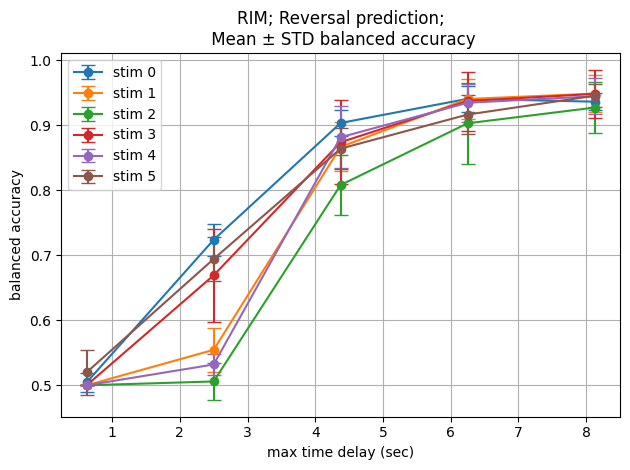

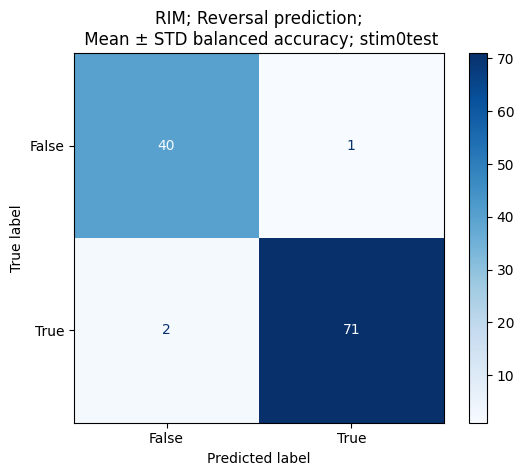

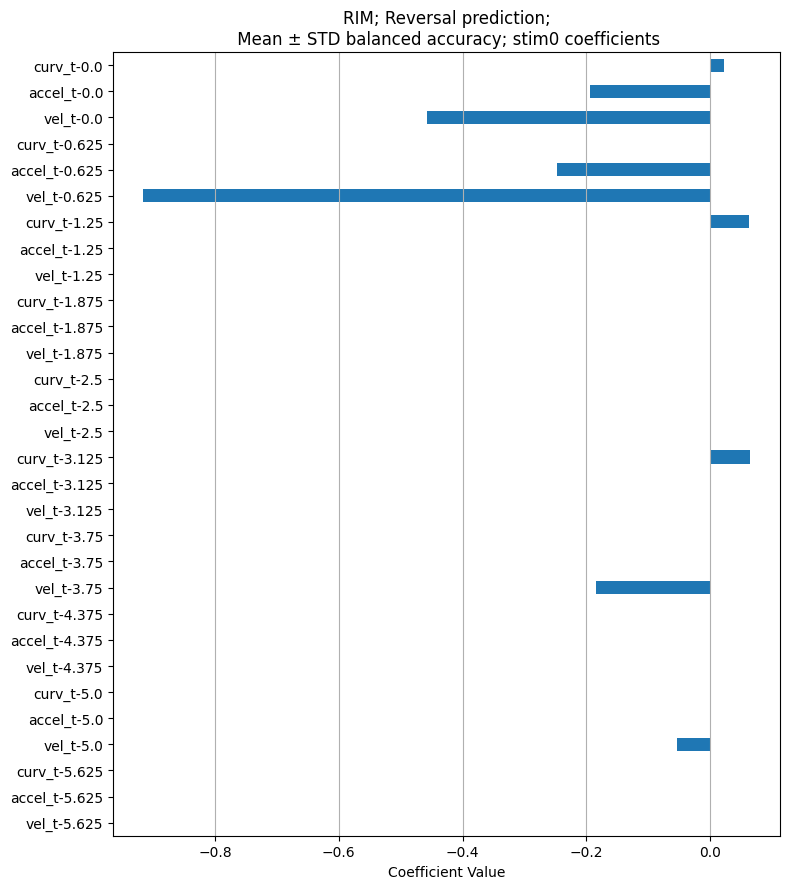

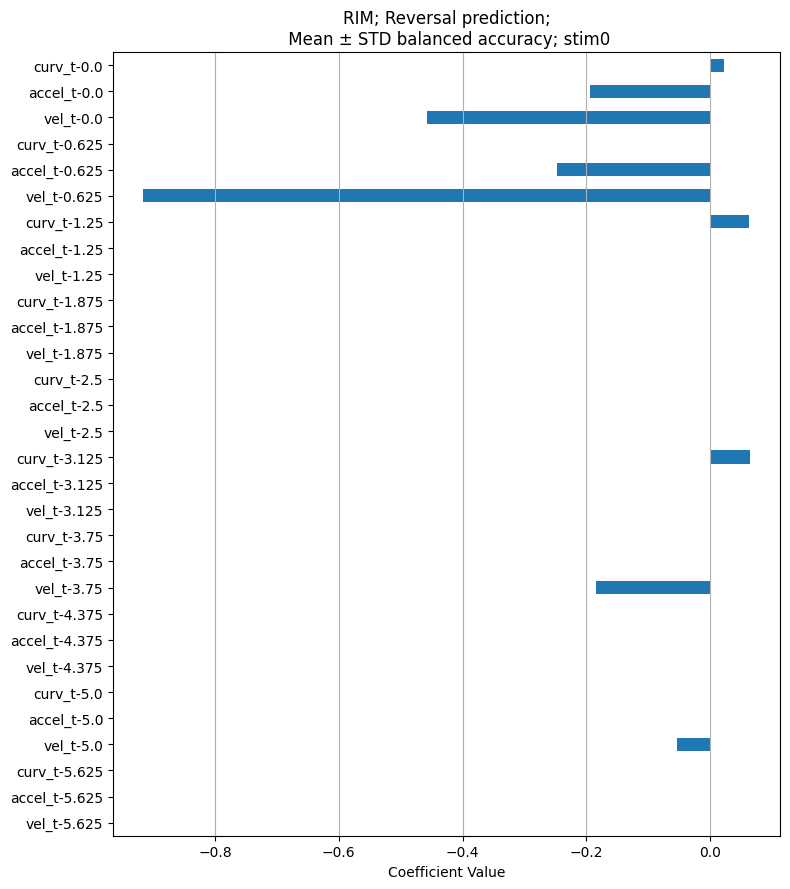

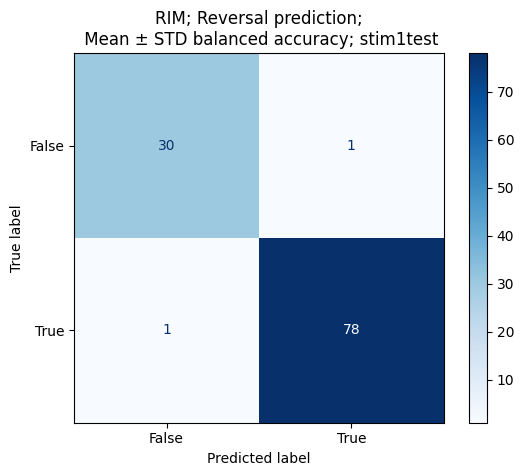

...

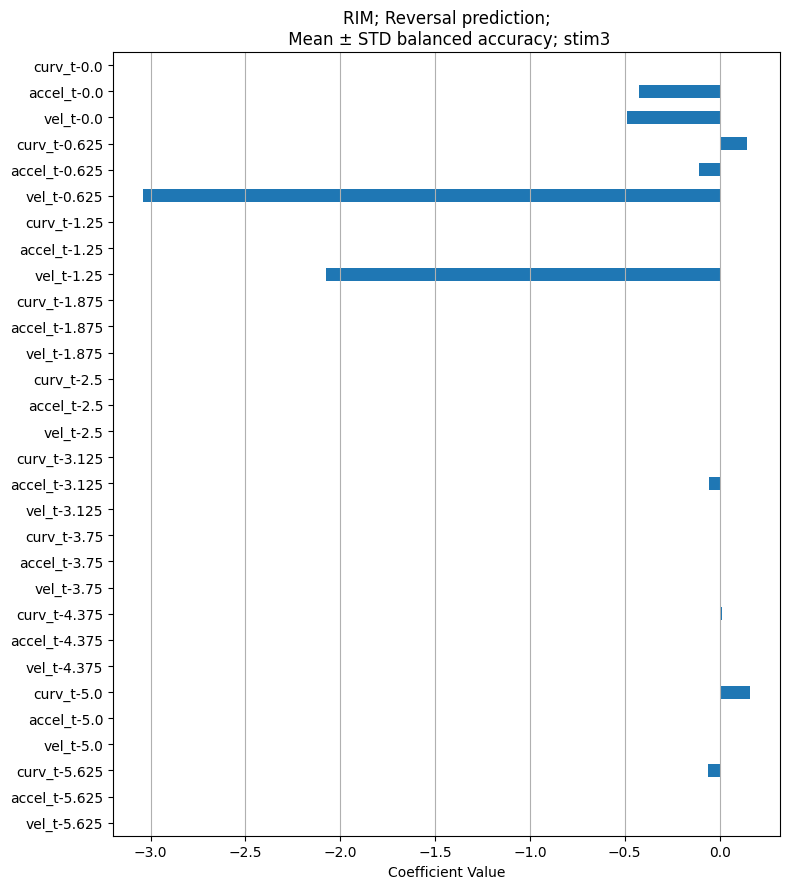

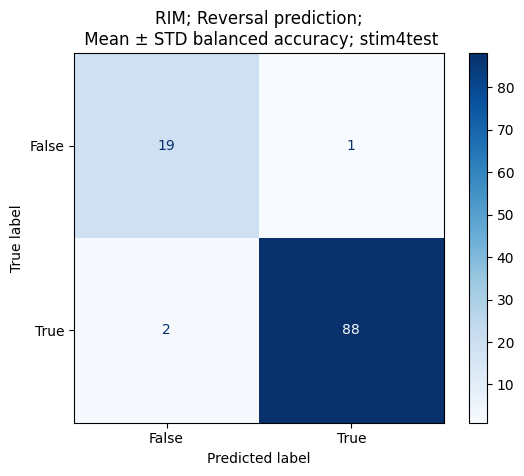

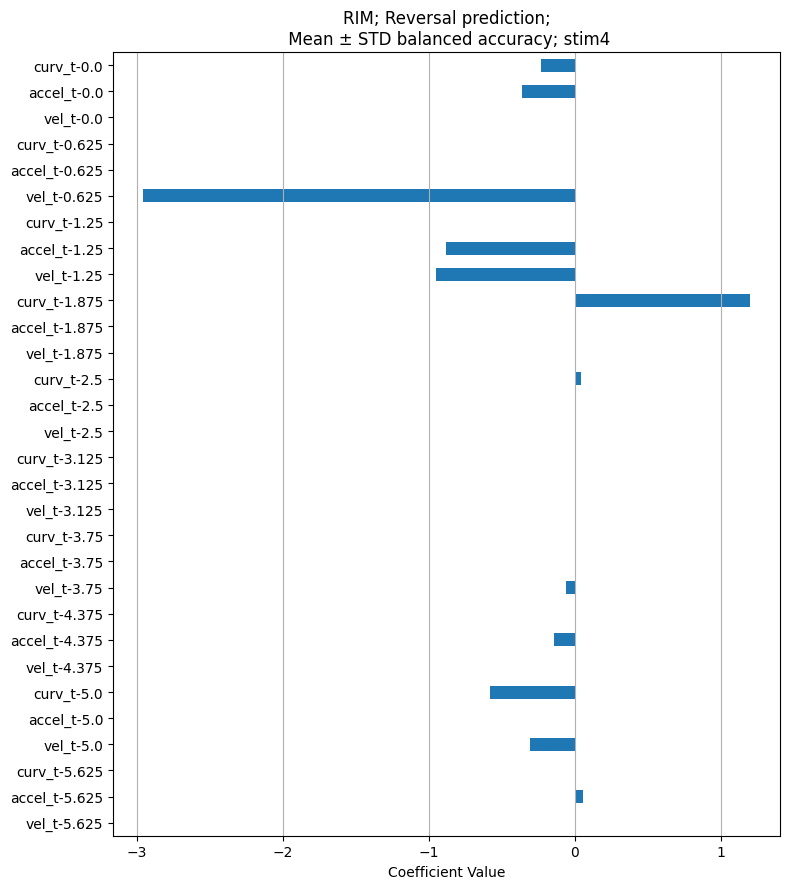

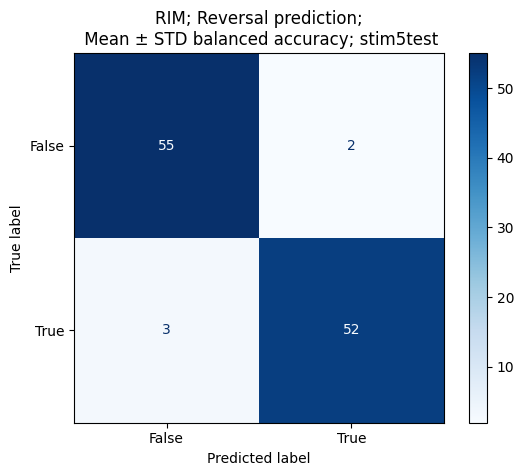

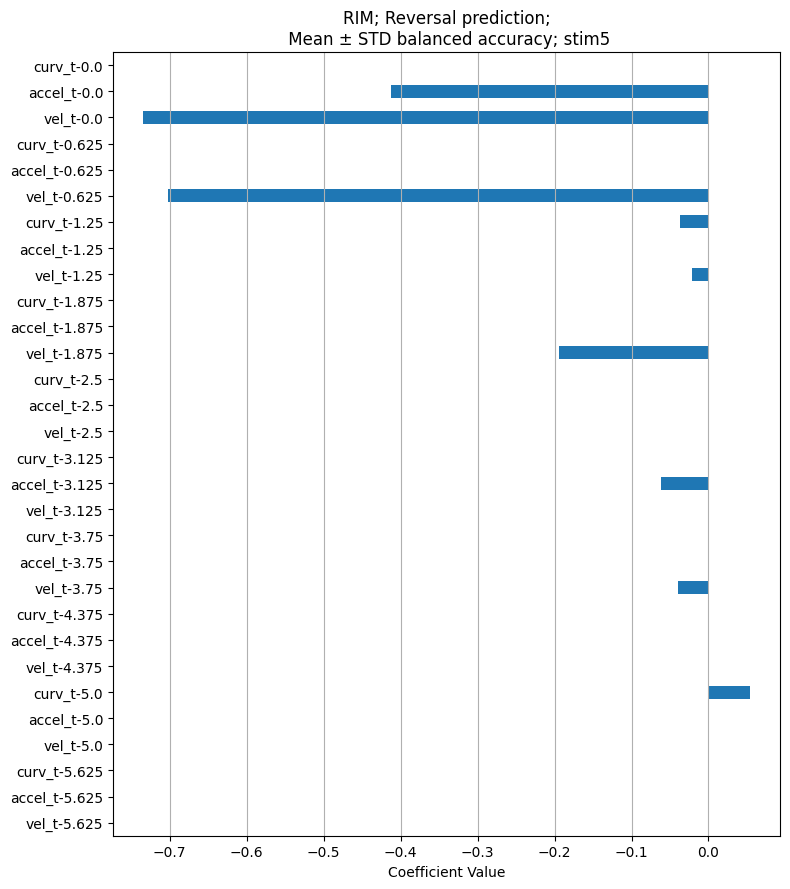

In [ ]:
feature_list = [resampled_vel, resampled_acc, resampled_curve]
feature_labels = ["vel", "accel", "curv"]
data_prep_fnc = prep_data_rev_prob
model_fit_fnc = fit_eval_linearSVC
result_visualization_fnc = visualize_model_classification
data_onsets = resampled_onsets
title_label = f"{neuron}; Reversal prediction;\n Mean ± STD balanced accuracy"
fps = 1.6
train_model_feature_list(data_prep_fnc,
                               model_fit_fnc, 
                               result_visualization_fnc, 
                               feature_list, 
                               feature_labels,
                               z, 
                               data_onsets,
                               exp_onsets, 
                               exp_rev, 
                               durations,
                               fps,
                           
                               title_label,
                               test_size = 0.3, 
                               n_splits = 10, 
                               lstm_lag = 5, 
                               single_feature = False
                            )
   

RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim0Accuracy: 0.9649122807017544
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim0Precision: 0.9656907894736843
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim0Recall: 0.9649122807017544
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim0F1 Score: 0.9650004131207138
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim1Accuracy: 0.9545454545454546
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim1Precision: 0.9629629629629629
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim1Recall: 0.9545454545454546
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim1F1 Score: 0.9562000238691968
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim2Accuracy: 0.9454545454545454
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim2Precision: 0.9590909090909091
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim2Recall: 0.9454545454545454
RI

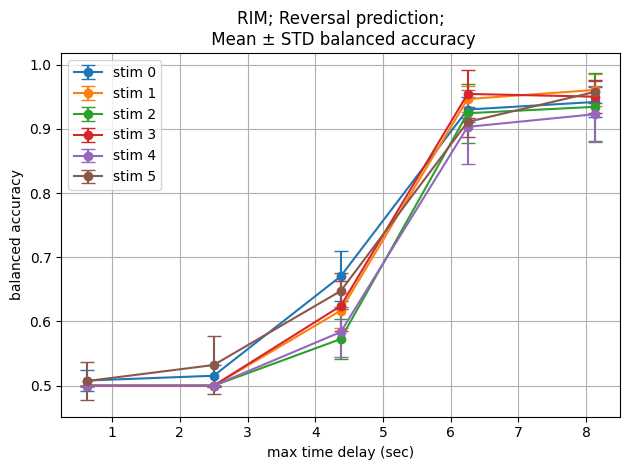

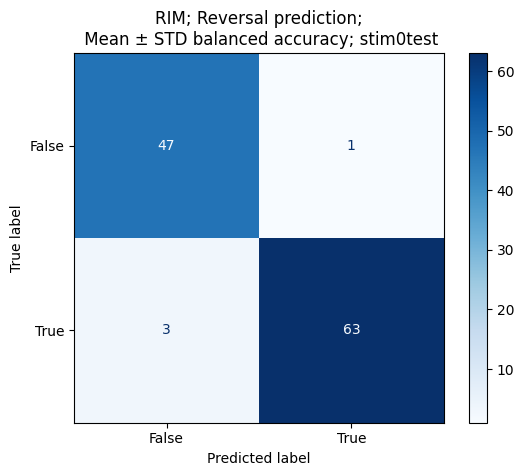

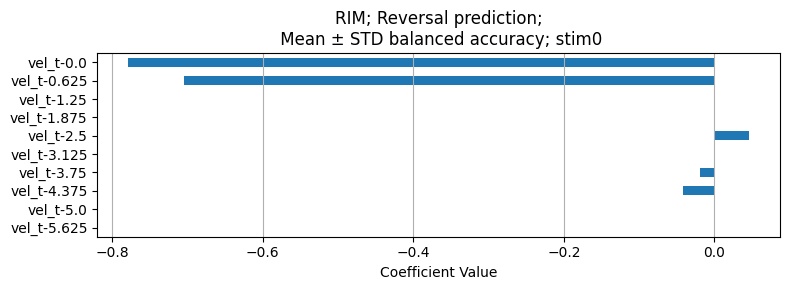

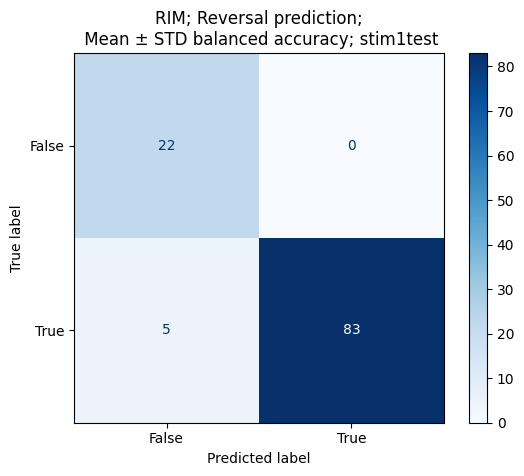

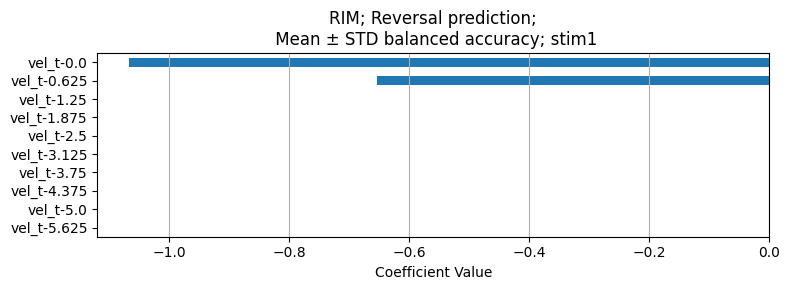

...

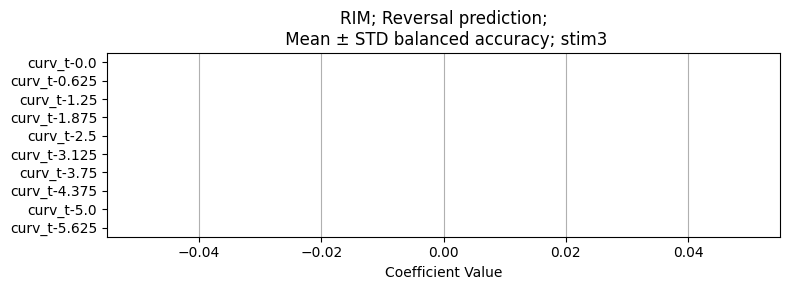

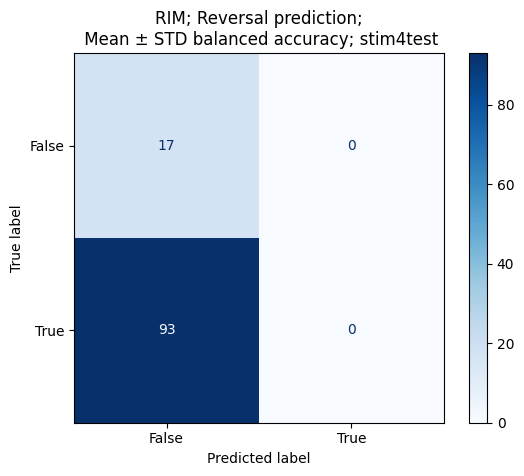

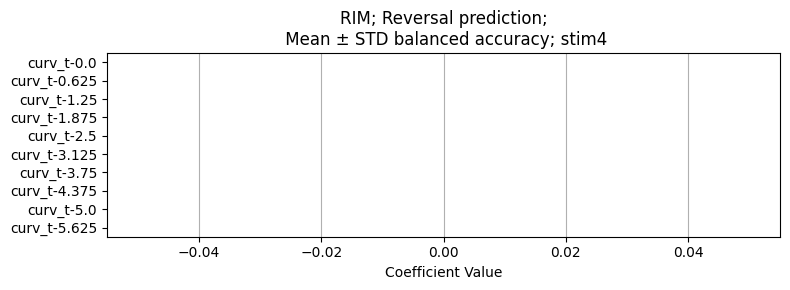

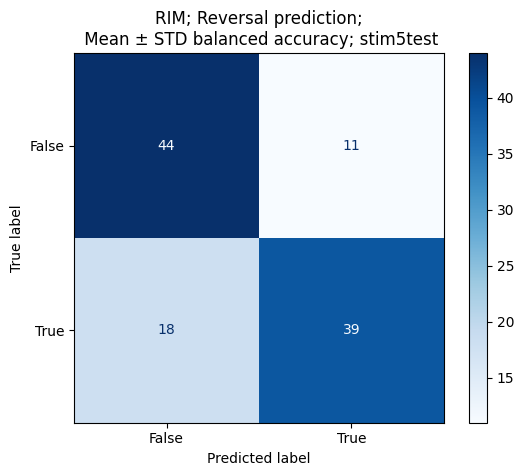

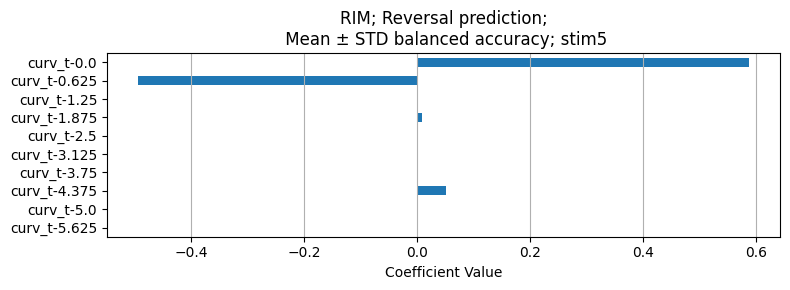

In [ ]:
feature_list = [resampled_vel, resampled_acc, resampled_curve]
feature_labels = ["vel", "accel", "curv"]
data_prep_fnc = prep_data_rev_prob
model_fit_fnc = fit_eval_linearSVC
result_visualization_fnc = visualize_model_classification
data_onsets = resampled_onsets
title_label = f"{neuron}; Reversal prediction;\n Mean ± STD balanced accuracy"
fps = 1.6

train_model_single_feature(data_prep_fnc,
                               model_fit_fnc, 
                               result_visualization_fnc, 
                               feature_list, 
                               feature_labels,
                               z, 
                               data_onsets,
                               exp_onsets, 
                               exp_rev, 
                               durations,
                               fps,
                               title_label,
                               test_size = 0.3, 
                               n_splits = 10, 
                               lstm_lag = 5
                           )


feature_names_all ['vel_t-1.5' 'accel_t-1.5' 'curv_t-1.5' 'vel_t-1.3333333333333333'
 'accel_t-1.3333333333333333' 'curv_t-1.3333333333333333'
 'vel_t-1.1666666666666667' 'accel_t-1.1666666666666667'
 'curv_t-1.1666666666666667' 'vel_t-1.0' 'accel_t-1.0' 'curv_t-1.0'
 'vel_t-0.8333333333333334' 'accel_t-0.8333333333333334'
 'curv_t-0.8333333333333334' 'vel_t-0.6666666666666666'
 'accel_t-0.6666666666666666' 'curv_t-0.6666666666666666' 'vel_t-0.5'
 'accel_t-0.5' 'curv_t-0.5' 'vel_t-0.3333333333333333'
 'accel_t-0.3333333333333333' 'curv_t-0.3333333333333333'
 'vel_t-0.16666666666666666' 'accel_t-0.16666666666666666'
 'curv_t-0.16666666666666666' 'vel_t-0.0' 'accel_t-0.0' 'curv_t-0.0']
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim0Accuracy: 0.8070175438596491
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim0Precision: 0.8313840155945419
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim0Recall: 0.8070175438596491
RIM; Reversal prediction;
 Mean ± S

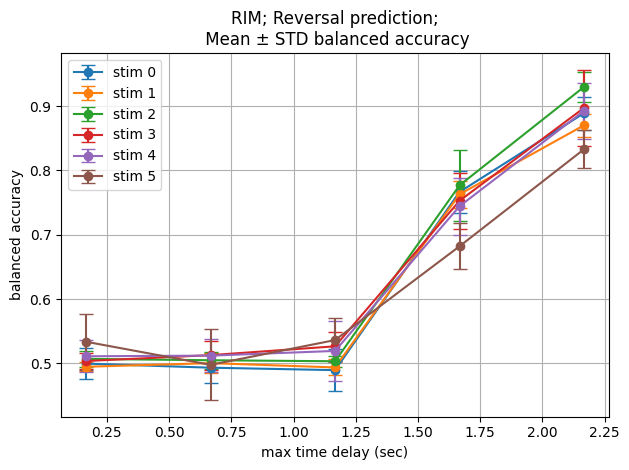

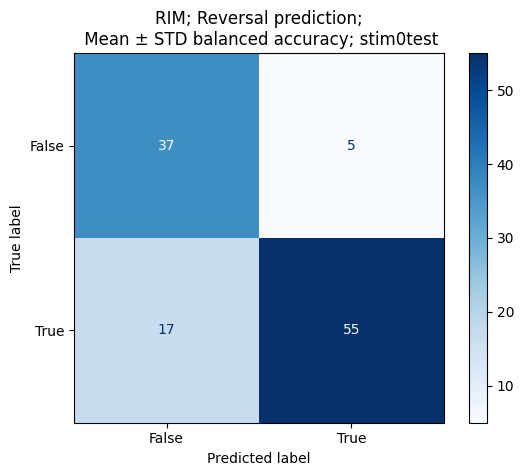

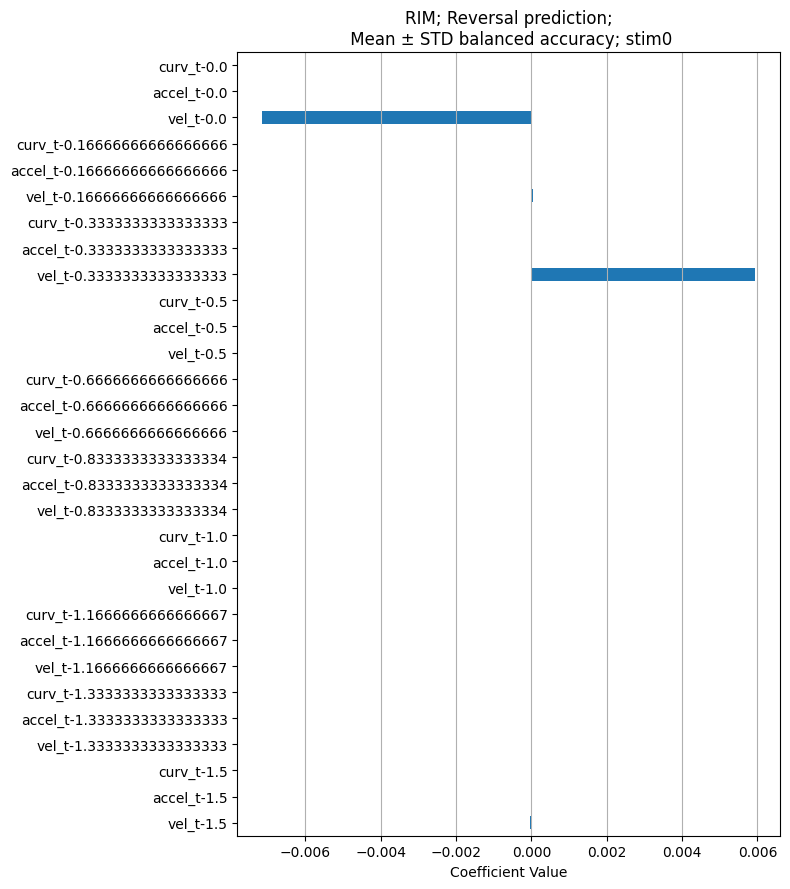

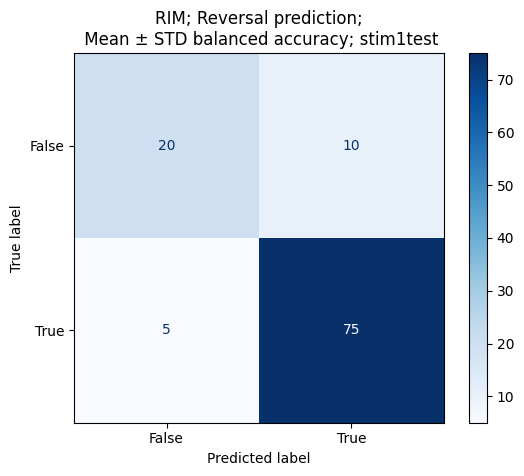

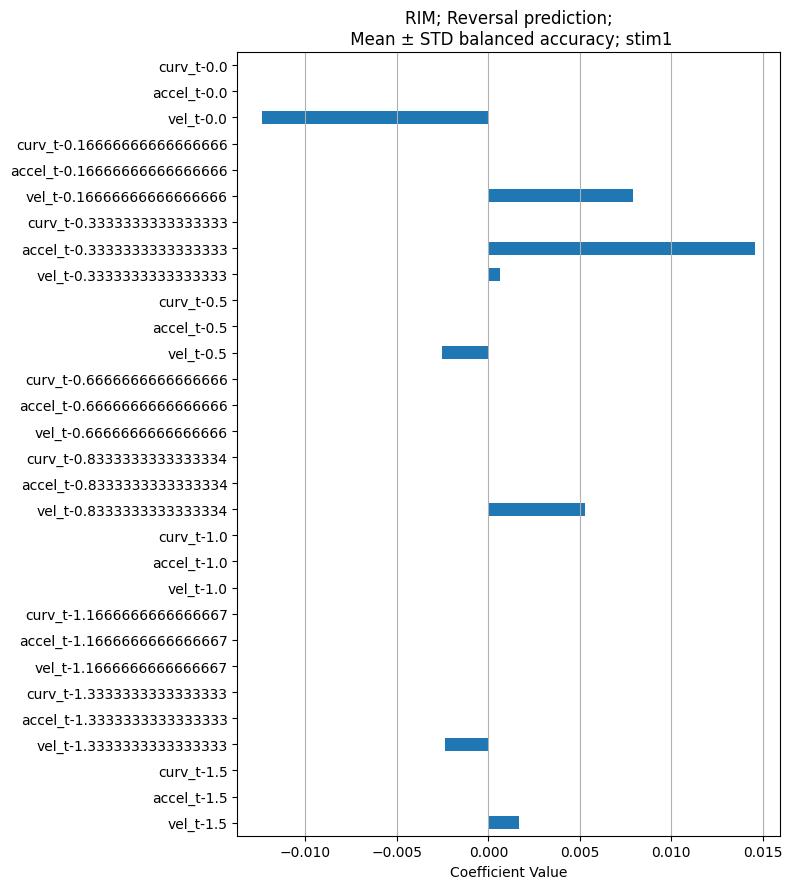

...

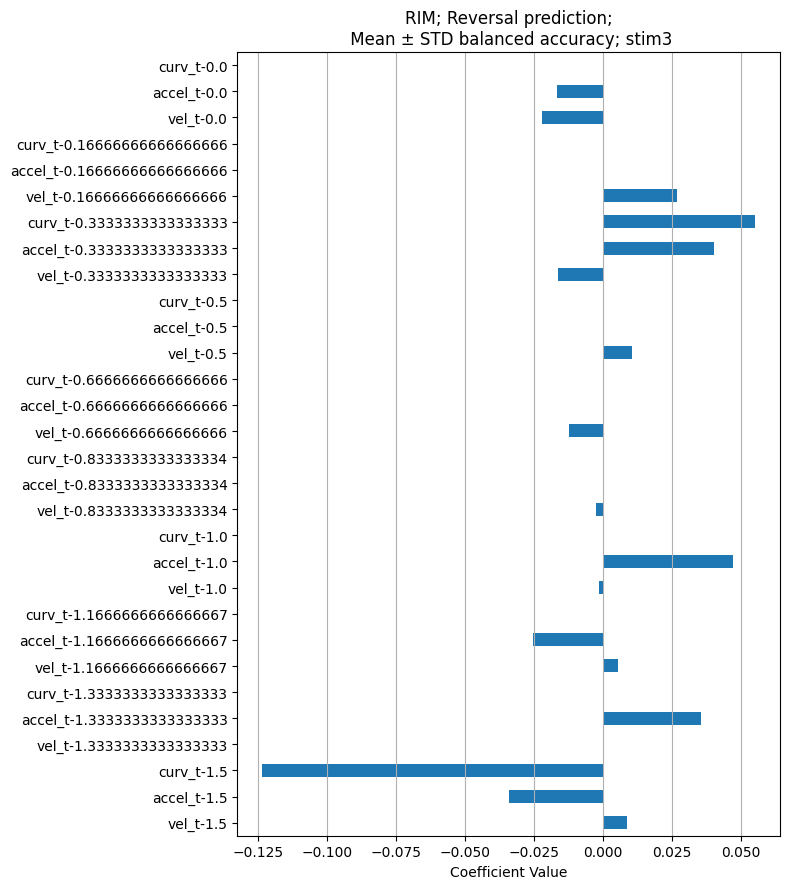

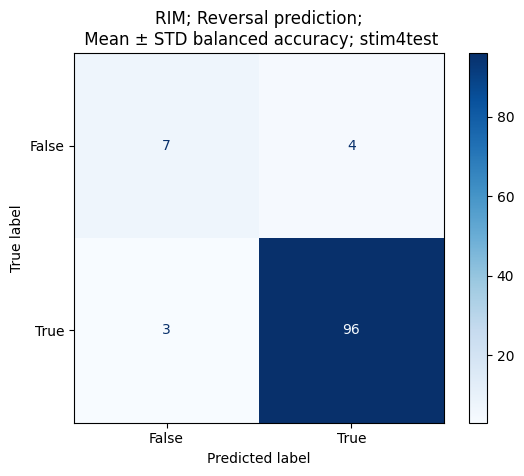

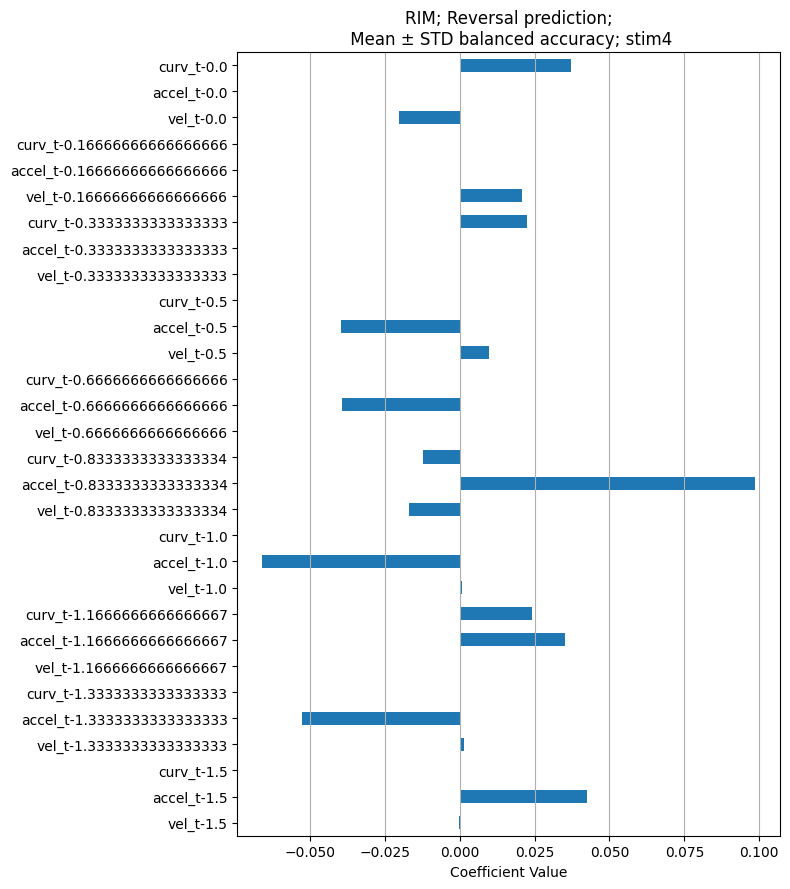

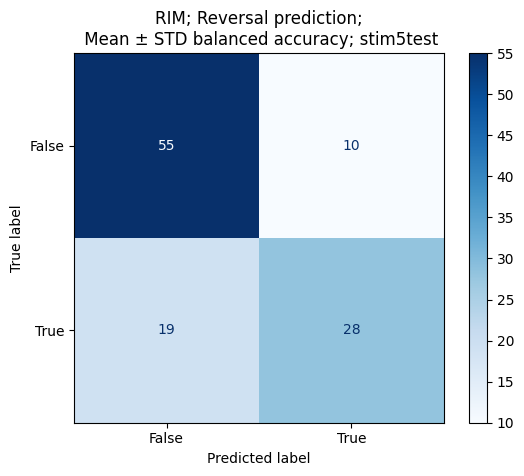

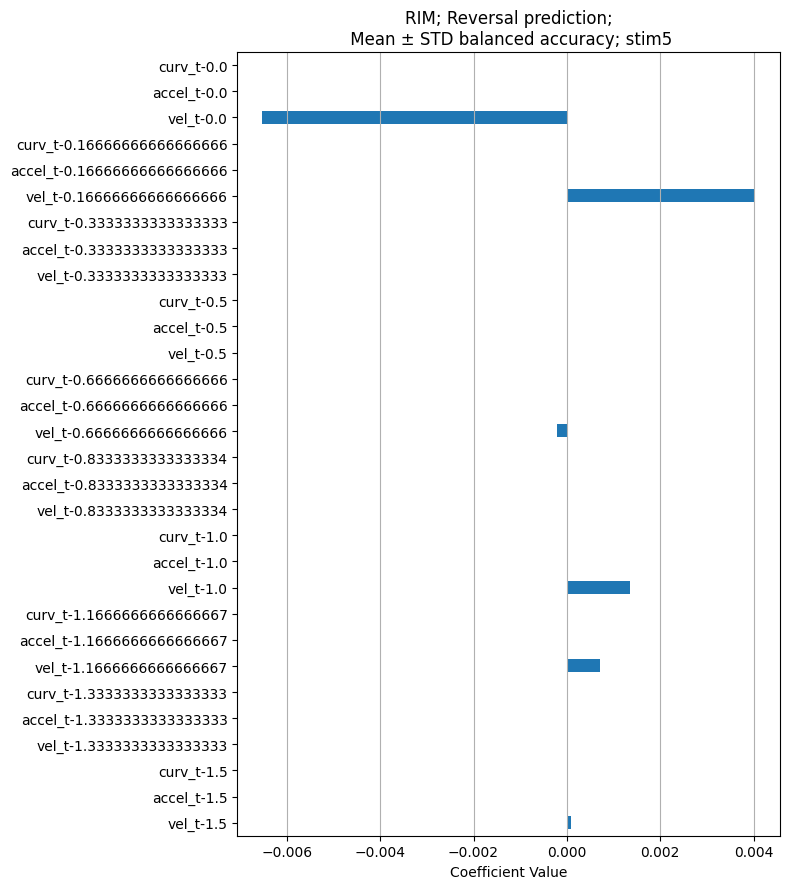

In [ ]:
feature_list = [exp_vel,exp_acc, exp_curve]
feature_labels = ["vel", "accel", "curv"]
data_prep_fnc = prep_data_rev_prob
model_fit_fnc = fit_eval_linearSVC
result_visualization_fnc = visualize_model_classification
data_onsets = exp_onsets
fps = 6
train_model_feature_list(data_prep_fnc,
                               model_fit_fnc, 
                               result_visualization_fnc, 
                               feature_list, 
                               feature_labels,
                               z, 
                               data_onsets,
                               exp_onsets, 
                               exp_rev, 
                               durations,
                               fps,
                               title_label,
                               test_size = 0.3, 
                               n_splits = 10, 
                               lstm_lag = 5, 
                               single_feature = False, 
                               rev_bin = exp_rev
                            )
   

RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim0Accuracy: 0.8070175438596491
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim0Precision: 0.8313840155945419
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim0Recall: 0.8070175438596491
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim0F1 Score: 0.8103070175438597
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim1Accuracy: 0.8727272727272727
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim1Precision: 0.8684663650955785
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim1Recall: 0.8727272727272727
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim1F1 Score: 0.866992600422833
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim2Accuracy: 0.9454545454545454
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim2Precision: 0.94409752170663
RIM; Reversal prediction;
 Mean ± STD balanced accuracy; stim2Recall: 0.9454545454545454
RIM; 

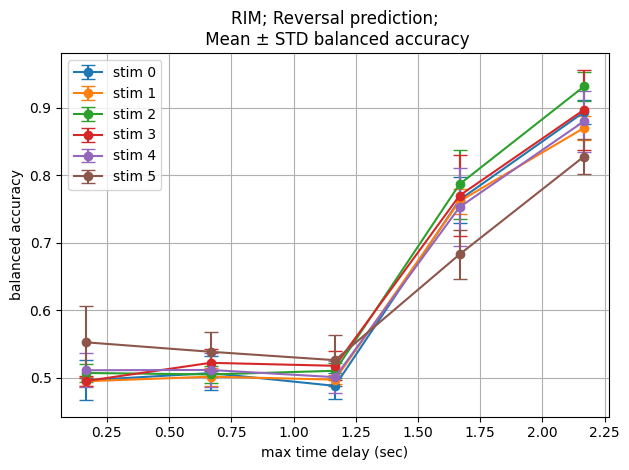

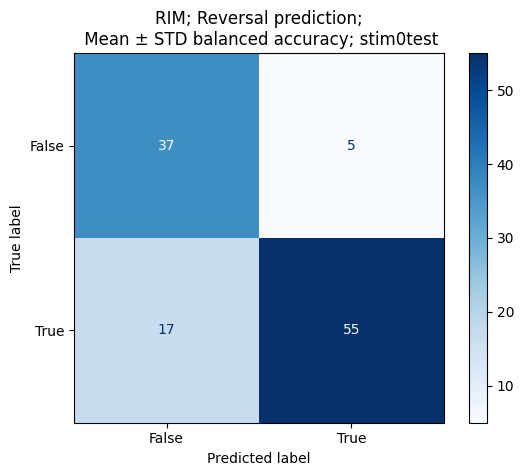

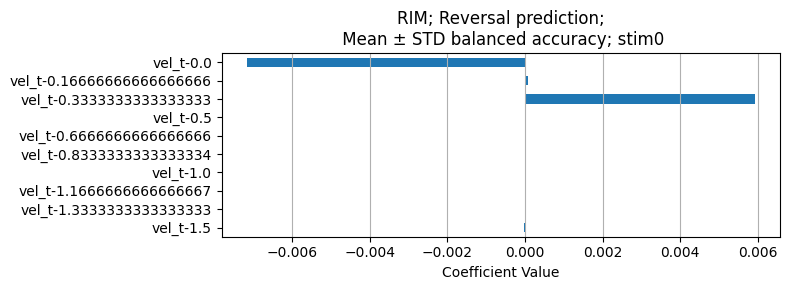

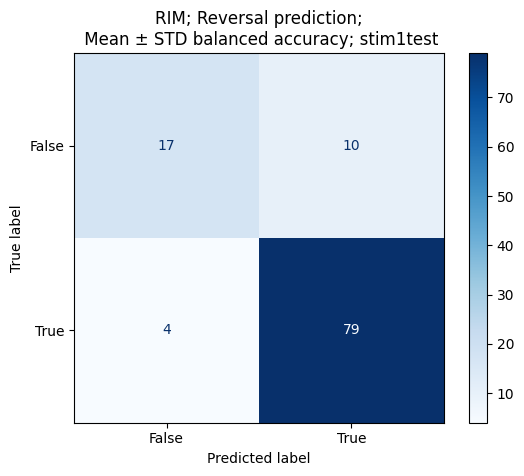

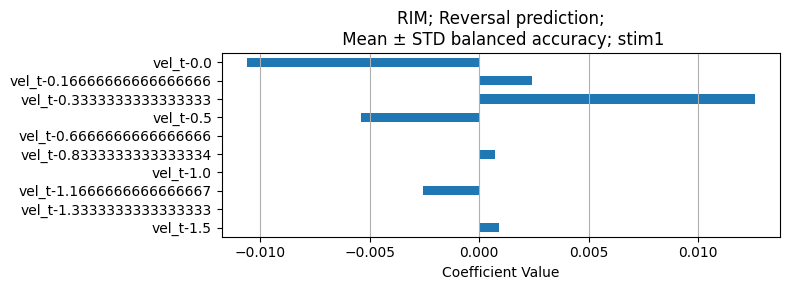

...

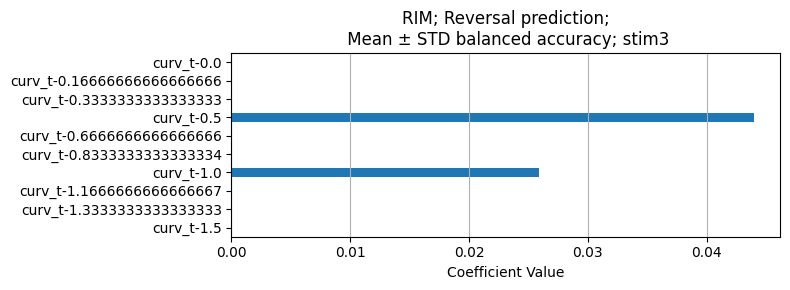

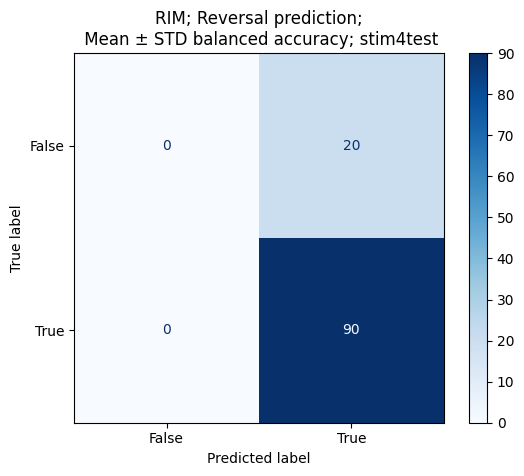

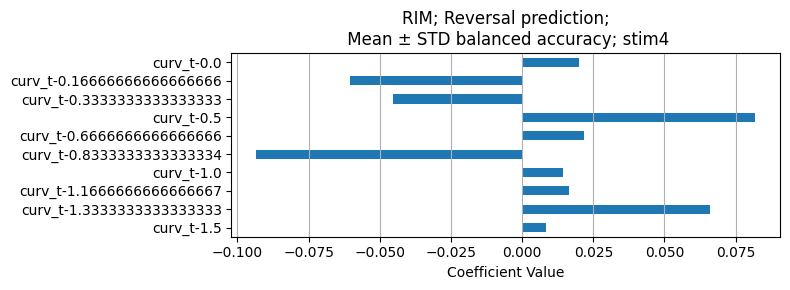

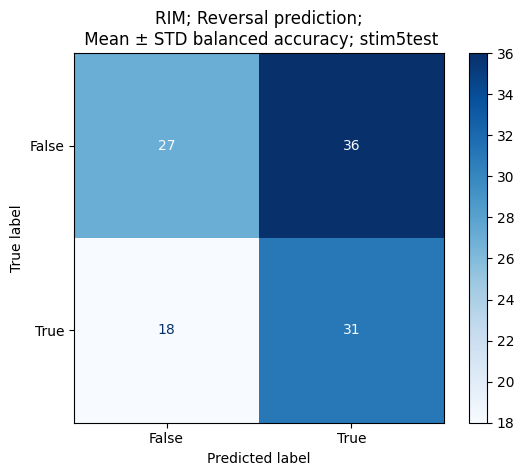

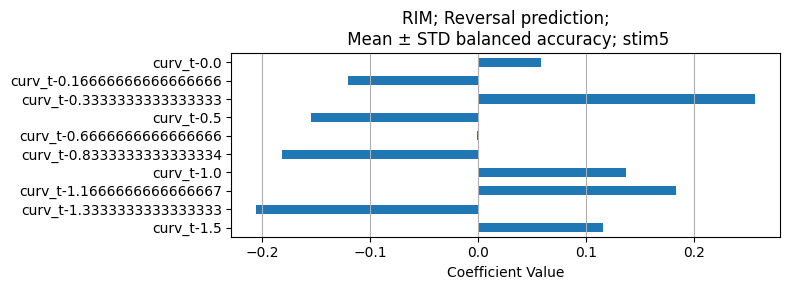

In [ ]:
feature_list = [exp_vel,exp_acc, exp_curve]
feature_labels = ["vel", "accel", "curv"]
data_prep_fnc = prep_data_rev_prob
model_fit_fnc = fit_eval_linearSVC
result_visualization_fnc = visualize_model_classification
itle_label = f"{neuron}; Reversal prediction;\n Mean ± STD balanced accuracy; exp fps"

data_onsets = exp_onsets
fps = 6
train_model_single_feature(data_prep_fnc,
                               model_fit_fnc, 
                               result_visualization_fnc, 
                               feature_list, 
                               feature_labels,
                               z, 
                               data_onsets,
                               exp_onsets, 
                               exp_rev, 
                               durations,
                               fps,
                               title_label,
                               test_size = 0.3, 
                               n_splits = 10, 
                               lstm_lag = 5,
                               rev_bin = exp_rev
                           )


In [ ]:
# feature_list = [exp_vel,exp_acc, exp_curve]
# feature_labels = ["vel", "accel", "curv"]
feature_list = [exp_rev, exp_vel,exp_acc, exp_curve]
feature_labels = ["rev", "vel", "accel", "curv"]
data_prep_fnc = prep_data_rev_prob
model_fit_fnc = fit_eval_linearSVC
result_visualization_fnc = visualize_model_classification
itle_label = f"{neuron}; Reversal prediction;\n Mean ± STD balanced accuracy; exp fps"

data_onsets = exp_onsets
fps = 6
###TODO print exp_rev vals around onset for both resampled and exp features 
train_model_feature_list(data_prep_fnc,
                               model_fit_fnc, 
                               result_visualization_fnc, 
                               feature_list, 
                               feature_labels,
                               z, 
                               data_onsets,
                               exp_onsets, 
                               exp_rev, 
                               durations,
                               fps,
                               title_label,
                               test_size = 0.3, 
                               n_splits = 10, 
                               lstm_lag = 5, 
                               single_feature = False
                            )


feature_list = [resampled_rev, resampled_vel, resampled_acc, resampled_curve]
feature_labels = ["rev", "vel", "accel", "curv"]
data_prep_fnc = prep_data_rev_prob
model_fit_fnc = fit_eval_linearSVC
result_visualization_fnc = visualize_model_classification
itle_label = f"{neuron}; Reversal prediction;\n Mean ± STD balanced accuracy; exp fps"

data_onsets = resampled_onsets
fps = 1.6

train_model_feature_list(data_prep_fnc,
                               model_fit_fnc, 
                               result_visualization_fnc, 
                               feature_list, 
                               feature_labels,
                               z, 
                               data_onsets,
                               exp_onsets, 
                               exp_rev, 
                               durations,
                               fps,
                               title_label,
                               test_size = 0.3, 
                               n_splits = 10, 
                               lstm_lag = 5, 
                               single_feature = False
                            )



feature_lbl vel

Processing i=0, n_timesteps=1

Processing i=0, n_timesteps=4

Processing i=0, n_timesteps=7

Processing i=0, n_timesteps=10

Processing i=0, n_timesteps=13

Processing i=1, n_timesteps=1

Processing i=1, n_timesteps=4

Processing i=1, n_timesteps=7

Processing i=1, n_timesteps=10

Processing i=1, n_timesteps=13

Processing i=2, n_timesteps=1

Processing i=2, n_timesteps=4

Processing i=2, n_timesteps=7

Processing i=2, n_timesteps=10

Processing i=2, n_timesteps=13

Processing i=3, n_timesteps=1

Processing i=3, n_timesteps=4

Processing i=3, n_timesteps=7

Processing i=3, n_timesteps=10

Processing i=3, n_timesteps=13

Processing i=4, n_timesteps=1

Processing i=4, n_timesteps=4

Processing i=4, n_timesteps=7

Processing i=4, n_timesteps=10

Processing i=4, n_timesteps=13

Processing i=5, n_timesteps=1

Processing i=5, n_timesteps=4

Processing i=5, n_timesteps=7

Processing i=5, n_timesteps=10

Processing i=5, n_timesteps=13
RIM stim: 0; linear SVC; vel] only Accurac

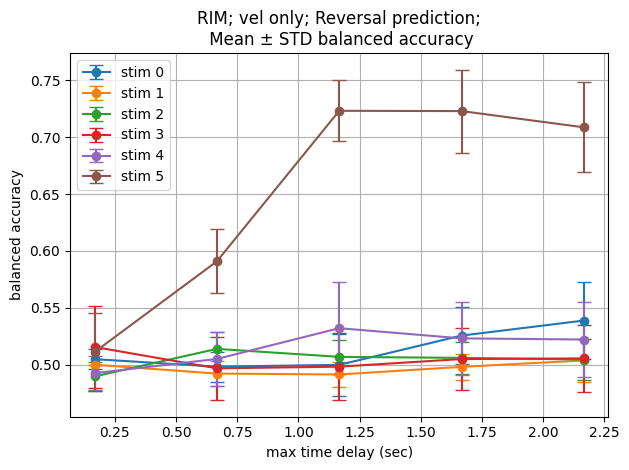

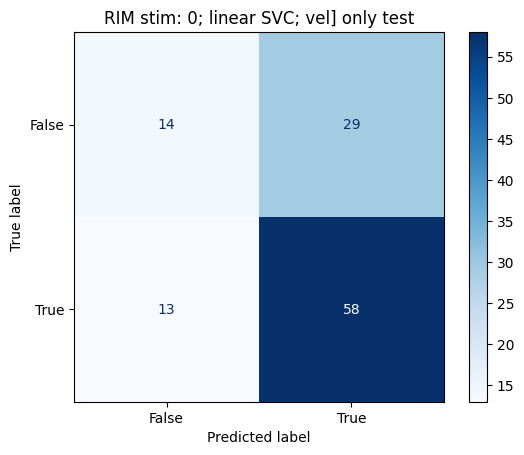

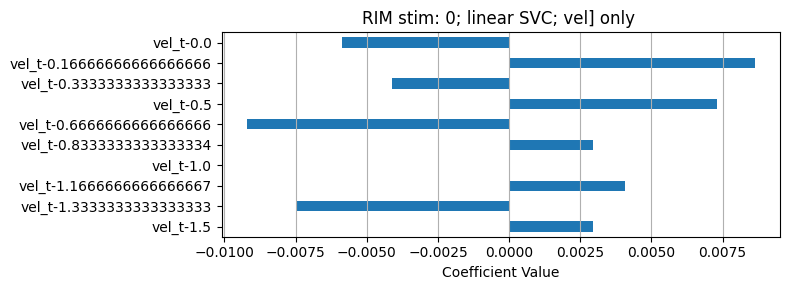

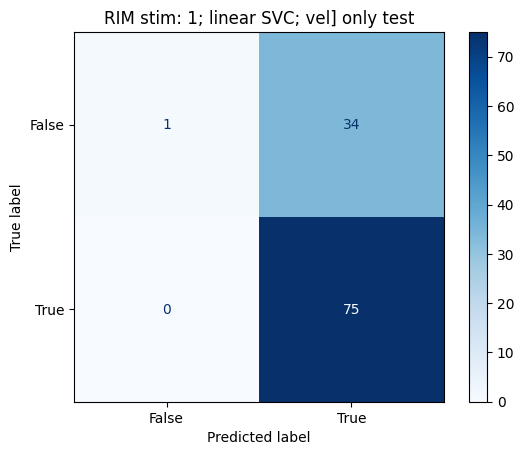

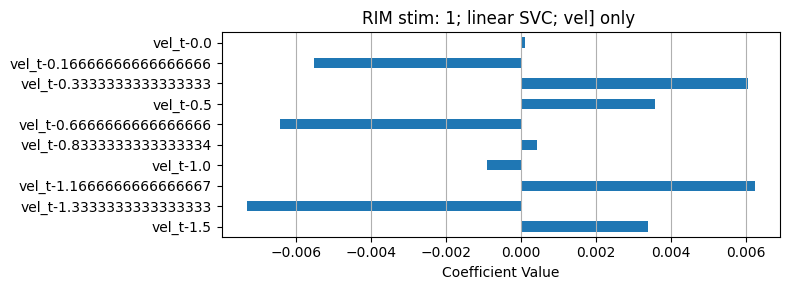

...

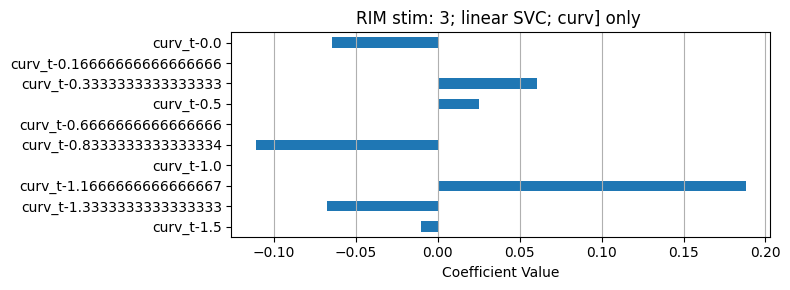

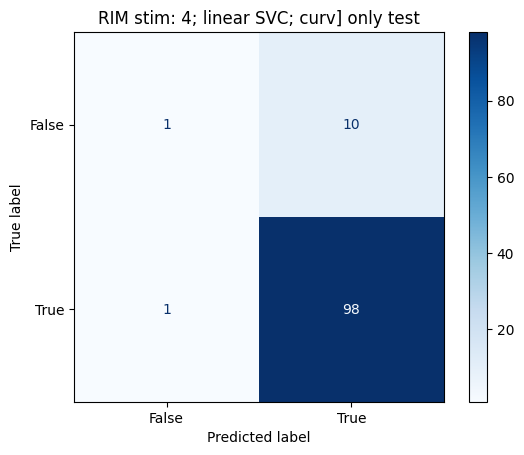

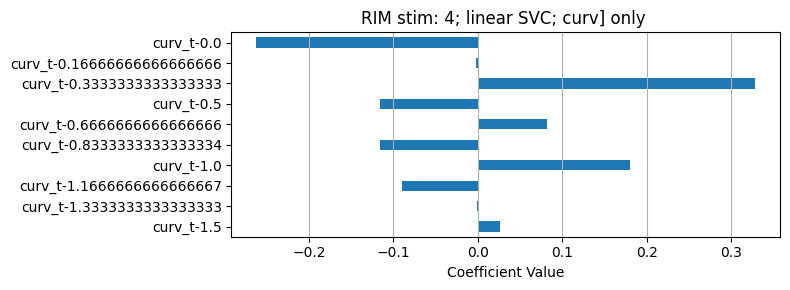

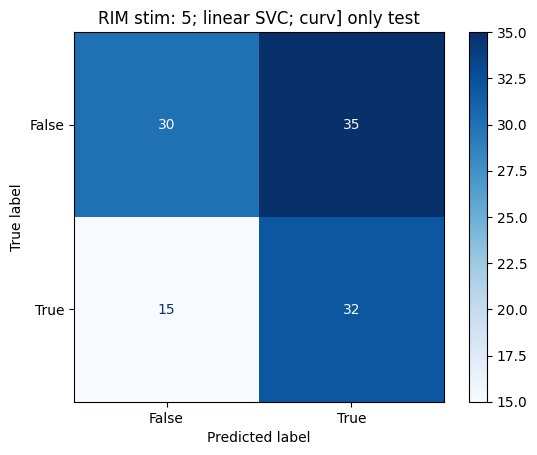

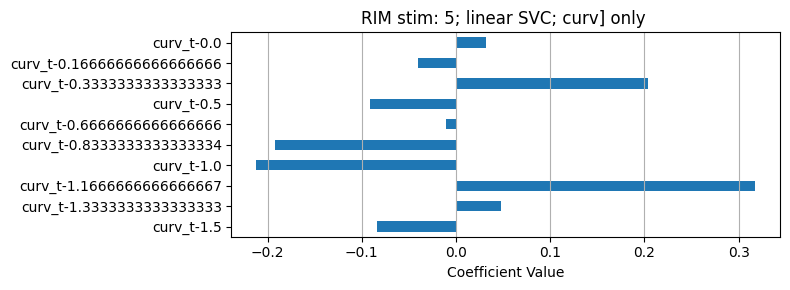

In [ ]:
##########Test single feature precdcition - exp frame rate ###figuer wout why this is different ahtn above 



with warnings.catch_warnings():


    warnings.simplefilter("ignore")
    fps = 6
    
    for feature, feature_lbl in zip([exp_vel, exp_acc, exp_curve], ["vel", "accel", "curv"]):
        print("feature_lbl", feature_lbl)
        include_beh = False
        n_tracks = resampled_rev.shape[0]
        n_splits = 10
        results_dict = {}  # Store mean/std r² per i and n_timesteps
        best_models = {}   # Store best model per (i, n_timesteps)
        lstm_lag = 5
        idxs = [[0],[1],[2],[3],[4],[5]]
        fig, ax = plt.subplots()
        for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
            score_means = []
            score_stds = []
            # all_r2_means = []
            all_scores_per_i = {}
            n_timesteps_list = []
            onset = resampled_onset-1

            for n_timesteps in range(1, 15, 3):
            # for n_timesteps in range(1, 15, 1):
                print(f"\nProcessing i={i}, n_timesteps={n_timesteps}")

                # X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps,   lstm_lag = lstm_lag)#shape (n_tracks, n_frames, n_features)
                # X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps, z,  lstm_lag = lstm_lag, include_beh = include_beh)#shape (n_tracks, n_frames, n_features)
                # X_stim_all1, _ = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps, z,  lstm_lag = lstm_lag, include_beh = include_beh)#shape (n_tracks, n_frames, n_features)
                features_list = [feature]
                feature_labels = [feature_lbl]
                X_stim_all, feature_names_all = prep_FB_inputs_select_features_only(
                    # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
                    features_list, feature_labels, onset,  n_timesteps, z, lstm_lag = lstm_lag, 
                
                                )
                # print(np.all(X_stim_all1==X_stim_all))
                Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
                no_rev_at_onset = Y_latency!=0
                Y_prob = np.logical_not(np.isnan(Y_latency[no_rev_at_onset]))# classfy y/n did rev happen
                X_prob = copy.deepcopy(X_stim_all[no_rev_at_onset])
                
                ###    
                # X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=random_state)
                balanced_accuracy_scores = []
                models = []

                for split_idx in range(n_splits):
                    # X_train, X_test, y_train, y_test = train_test_split(
                    #     X_stim_all_latency, Y_latency_valid, test_size=test_size, random_state=split_idx)
                    
                    X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=split_idx)
                    
                    param_grid = {
                        'C': [0.001, 0.01, 0.1, 1, 10, 100]
                    }

                    model = LinearSVC(penalty='l1', dual=False, max_iter=10000)
                    # Grid search
                    grid = GridSearchCV(model, param_grid, cv=5, scoring='balanced_accuracy')
                    grid.fit(X_train, y_train)
                    c = grid.best_params_['C']
                    best_model = grid.best_estimator_
                    
                    y_pred = best_model.predict(X_test)
                    score =balanced_accuracy_score(y_test, y_pred)  

                    balanced_accuracy_scores.append(score)
                    # models.append(best_model)
                    models.append((best_model,X_train, X_test, y_train, y_test, c))

                accuracy_mean = np.mean(balanced_accuracy_scores)
                accuracy_std = np.std(balanced_accuracy_scores)
                best_model_idx = np.argmax(balanced_accuracy_scores)
                best_model_overall = models[best_model_idx]

                # Save results
                n_timesteps_list.append(n_timesteps)
                # all_r2_means.append(r2s)
                all_scores_per_i[(i, n_timesteps)] = balanced_accuracy_scores
                score_means.append(accuracy_mean)
                score_stds.append(accuracy_std)
                results_dict[(i, n_timesteps)] = (accuracy_mean, accuracy_std)
                best_models[(i, n_timesteps)] = best_model_overall


            # cmap1 = cm.get_cmap('tab10', len(resampled_onsets))
            ax.errorbar(np.array(n_timesteps_list)/fps, score_means, yerr=score_stds, #color=cmap1(i),
                        fmt='-o', capsize=5, label = f"stim {i}")

            ax.set_title(f"{neuron}; {feature_lbl} only; Reversal prediction;\n Mean ± STD balanced accuracy")
            ax.set_xlabel("max time delay (sec)")
            ax.set_ylabel("balanced accuracy")
        ax.legend()
        plt.grid(True)
        plt.tight_layout()
        # plt.savefig(f"r2_plot_i{i}.png")
        # plt.close()

        n_timesteps = 10
        include_beh = False
        
        feature_names = np.array([[f"{feature_lbl}_t-{(n_timesteps - t - 1)/fps}"]
                                    for t in range(n_timesteps)]).flatten()

        for i in range(len(resampled_onsets)):
            model,X_train, X_test, y_train, y_test, c  = best_models[(i, n_timesteps)] 

            model_label= f"{neuron} stim: {i}; linear SVC; {feature_lbl}] only "#; lasso_a{np.round(alpha,2)}"
            visualize_model_classification(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False, get_coeff = True, coeffs = model.coef_[0])#, xlim = [-1,1])
            
plt.show()


feature_lbl vel

Processing i=0, n_timesteps=1

Processing i=0, n_timesteps=4

Processing i=0, n_timesteps=7

Processing i=0, n_timesteps=10

Processing i=0, n_timesteps=13

Processing i=1, n_timesteps=1

Processing i=1, n_timesteps=4

Processing i=1, n_timesteps=7

Processing i=1, n_timesteps=10

Processing i=1, n_timesteps=13

Processing i=2, n_timesteps=1

Processing i=2, n_timesteps=4

Processing i=2, n_timesteps=7

Processing i=2, n_timesteps=10

Processing i=2, n_timesteps=13

Processing i=3, n_timesteps=1

Processing i=3, n_timesteps=4

Processing i=3, n_timesteps=7

Processing i=3, n_timesteps=10

Processing i=3, n_timesteps=13

Processing i=4, n_timesteps=1

Processing i=4, n_timesteps=4

Processing i=4, n_timesteps=7

Processing i=4, n_timesteps=10

Processing i=4, n_timesteps=13

Processing i=5, n_timesteps=1

Processing i=5, n_timesteps=4

Processing i=5, n_timesteps=7

Processing i=5, n_timesteps=10

Processing i=5, n_timesteps=13
RIM stim: 0; linear SVC; vel] only Accurac

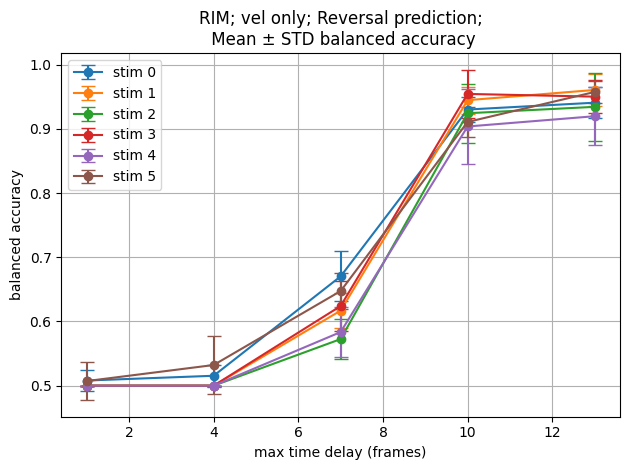

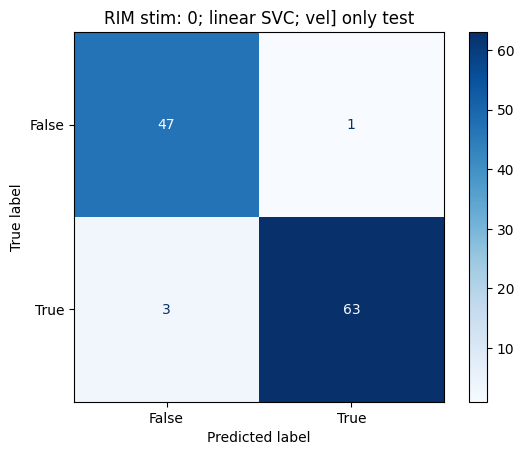

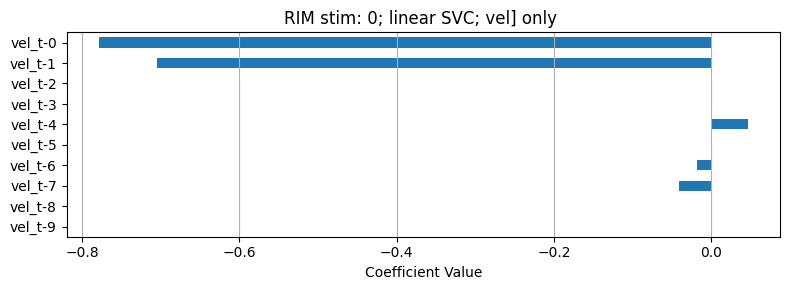

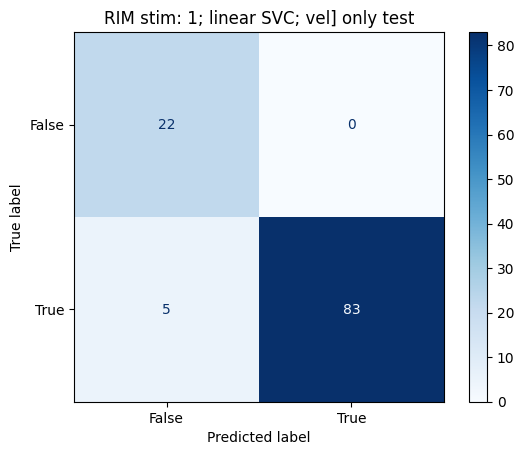

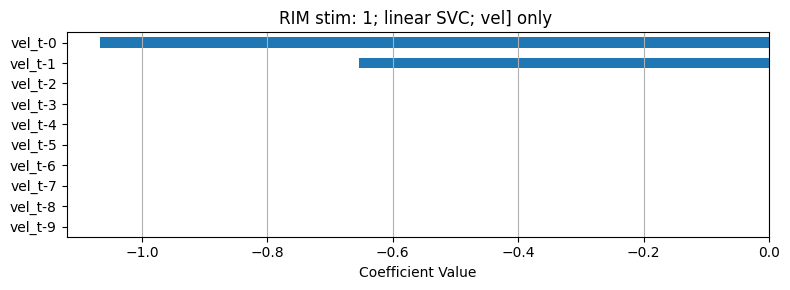

...

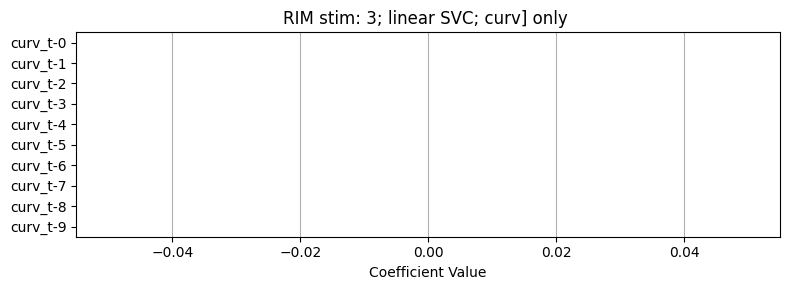

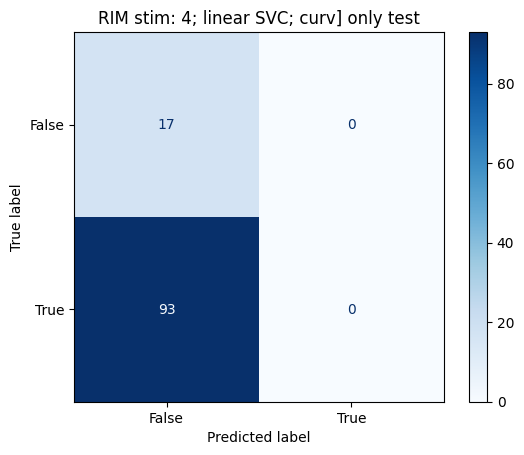

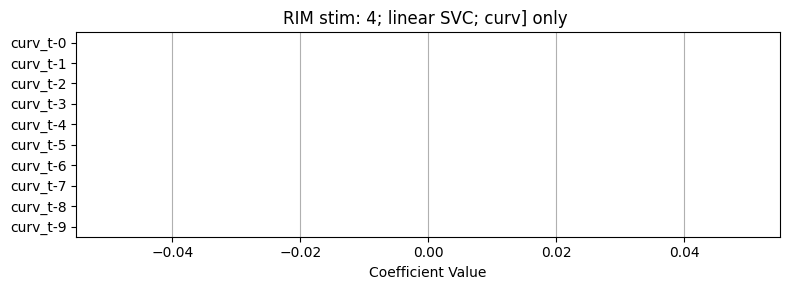

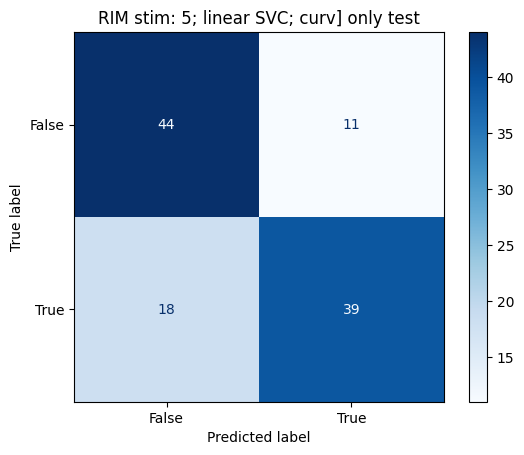

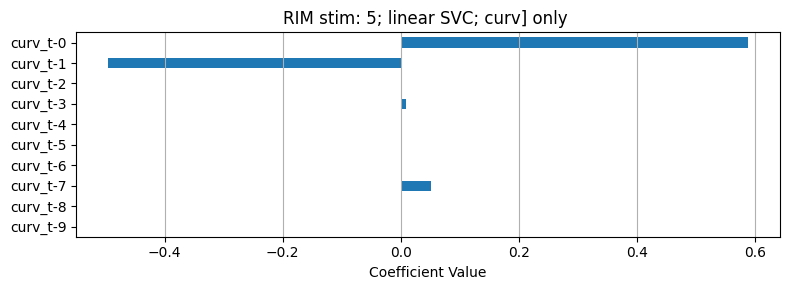

In [ ]:


###############look at single feature contribution - resmapled fps 
with warnings.catch_warnings():
        
    # ##get inputs into lstm 
    # beh_map = [z_norm.min(), z_norm.min()/2 + z_norm.max()/2, z_norm.max()]

    warnings.simplefilter("ignore")
    fps = 1.6
    
    for feature, feature_lbl in zip([resampled_vel, resampled_acc, resampled_curve], ["vel", "accel", "curv"]):
        print("feature_lbl", feature_lbl)
        include_beh = False
        n_tracks = resampled_rev.shape[0]
        n_splits = 10
        results_dict = {}  # Store mean/std r² per i and n_timesteps
        best_models = {}   # Store best model per (i, n_timesteps)
        lstm_lag = 5
        idxs = [[0],[1],[2],[3],[4],[5]]
        fig, ax = plt.subplots()
        for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
            score_means = []
            score_stds = []
            # all_r2_means = []
            all_scores_per_i = {}
            n_timesteps_list = []
            onset = resampled_onset-1

            for n_timesteps in range(1, 15, 3):
            # for n_timesteps in range(1, 15, 1):
                print(f"\nProcessing i={i}, n_timesteps={n_timesteps}")

                # X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps,   lstm_lag = lstm_lag)#shape (n_tracks, n_frames, n_features)
                # X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps, z,  lstm_lag = lstm_lag, include_beh = include_beh)#shape (n_tracks, n_frames, n_features)
                # X_stim_all1, _ = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps, z,  lstm_lag = lstm_lag, include_beh = include_beh)#shape (n_tracks, n_frames, n_features)
                features_list = [feature]
                feature_labels = [feature_lbl]
                X_stim_all, feature_names_all = prep_FB_inputs_select_features_only(
                    # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
                    features_list, feature_labels, onset,  n_timesteps, z, lstm_lag = lstm_lag, 
                
                                )
                
                fig, ax = plt.subplots()
                ax.imshow(resampled_rev)
                ax.set_title(f"n_timesteps: {n_timesteps}")
                ax.axvline(onset - lstm_lag, color = "red")
                
                # print(np.all(X_stim_all1==X_stim_all))
                Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
                no_rev_at_onset = Y_latency!=0
                Y_prob = np.logical_not(np.isnan(Y_latency[no_rev_at_onset]))# classfy y/n did rev happen
                X_prob = copy.deepcopy(X_stim_all[no_rev_at_onset])
                
                ###    
                # X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=random_state)
                balanced_accuracy_scores = []
                models = []

                for split_idx in range(n_splits):
                    # X_train, X_test, y_train, y_test = train_test_split(
                    #     X_stim_all_latency, Y_latency_valid, test_size=test_size, random_state=split_idx)
                    
                    X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=split_idx)
                    
                    param_grid = {
                        'C': [0.001, 0.01, 0.1, 1, 10, 100]
                    }

                    model = LinearSVC(penalty='l1', dual=False, max_iter=10000)
                    # Grid search
                    grid = GridSearchCV(model, param_grid, cv=5, scoring='balanced_accuracy')
                    grid.fit(X_train, y_train)
                    c = grid.best_params_['C']
                    best_model = grid.best_estimator_
                    
                    y_pred = best_model.predict(X_test)
                    score =balanced_accuracy_score(y_test, y_pred)  

                    balanced_accuracy_scores.append(score)
                    # models.append(best_model)
                    models.append((best_model,X_train, X_test, y_train, y_test, c))

                accuracy_mean = np.mean(balanced_accuracy_scores)
                accuracy_std = np.std(balanced_accuracy_scores)
                best_model_idx = np.argmax(balanced_accuracy_scores)
                best_model_overall = models[best_model_idx]

                # Save results
                n_timesteps_list.append(n_timesteps)
                # all_r2_means.append(r2s)
                all_scores_per_i[(i, n_timesteps)] = balanced_accuracy_scores
                score_means.append(accuracy_mean)
                score_stds.append(accuracy_std)
                results_dict[(i, n_timesteps)] = (accuracy_mean, accuracy_std)
                best_models[(i, n_timesteps)] = best_model_overall


            # cmap1 = cm.get_cmap('tab10', len(resampled_onsets))
            ax.errorbar(np.array(n_timesteps_list)/fps, score_means, yerr=score_stds, #color=cmap1(i),
                        fmt='-o', capsize=5, label = f"stim {i}")

            ax.set_title(f"{neuron}; {feature_lbl} only; Reversal prediction;\n Mean ± STD balanced accuracy")
            ax.set_xlabel("max time delay (frames)")
            ax.set_ylabel("balanced accuracy")
        ax.legend()
        plt.grid(True)
        plt.tight_layout()
        # plt.savefig(f"r2_plot_i{i}.png")
        # plt.close()

        n_timesteps = 10
        feature_names = np.array([[f"{feature_lbl}_t-{(n_timesteps - t - 1)/fps}"]
                                    for t in range(n_timesteps)]).flatten()

        for i in range(len(resampled_onsets)):
            model,X_train, X_test, y_train, y_test, c  = best_models[(i, n_timesteps)] 

            model_label= f"{neuron} stim: {i}; linear SVC; {feature_lbl}] only "#; lasso_a{np.round(alpha,2)}"
            visualize_model_classification(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False, get_coeff = True, coeffs = model.coef_[0])#, xlim = [-1,1])
            
plt.show()


feature_lbl vel

Processing i=0, n_timesteps=1
['vel_t-0']
['vel_t-0']

Processing i=1, n_timesteps=1
['vel_t-0']
['vel_t-0']

Processing i=2, n_timesteps=1
['vel_t-0']
['vel_t-0']

Processing i=3, n_timesteps=1
['vel_t-0']
['vel_t-0']

Processing i=4, n_timesteps=1
['vel_t-0']
['vel_t-0']

Processing i=5, n_timesteps=1
['vel_t-0']
['vel_t-0']
feature_lbl accel

Processing i=0, n_timesteps=1
['accel_t-0']
['accel_t-0']

Processing i=1, n_timesteps=1
['accel_t-0']
['accel_t-0']

Processing i=2, n_timesteps=1
['accel_t-0']
['accel_t-0']

Processing i=3, n_timesteps=1
['accel_t-0']
['accel_t-0']

Processing i=4, n_timesteps=1
['accel_t-0']
['accel_t-0']

Processing i=5, n_timesteps=1
['accel_t-0']
['accel_t-0']
feature_lbl curv

Processing i=0, n_timesteps=1
['curv_t-0']
['curv_t-0']

Processing i=1, n_timesteps=1
['curv_t-0']
['curv_t-0']

Processing i=2, n_timesteps=1
['curv_t-0']
['curv_t-0']

Processing i=3, n_timesteps=1
['curv_t-0']
['curv_t-0']

Processing i=4, n_timesteps=1
['curv

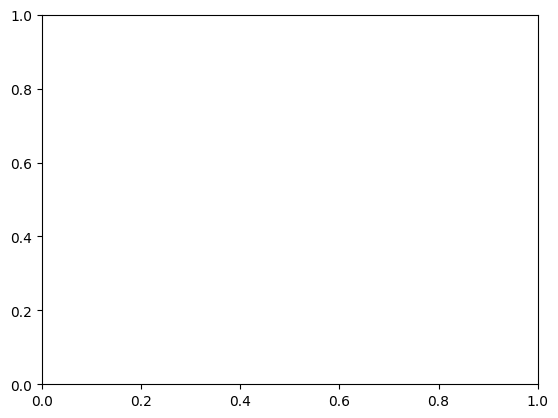

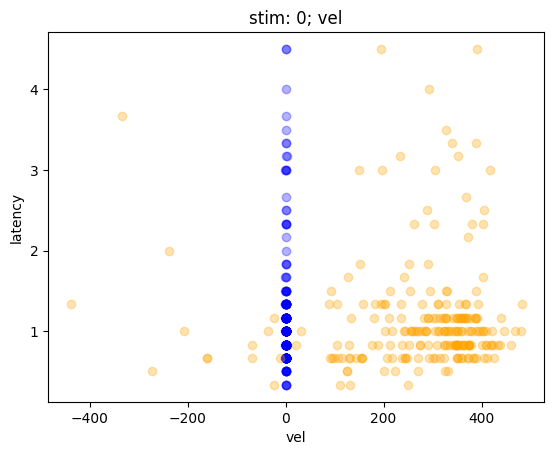

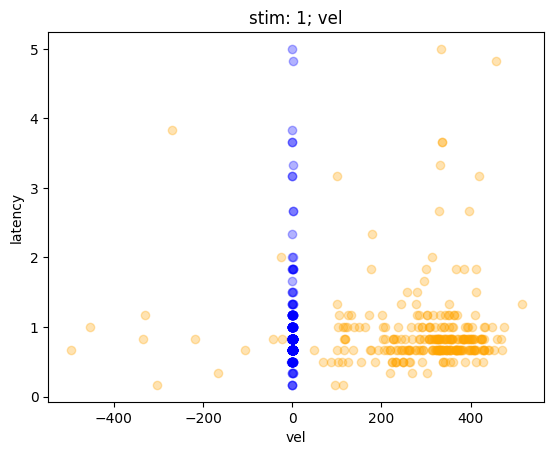

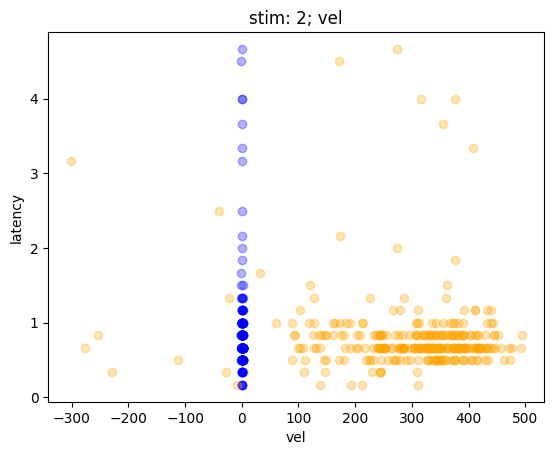

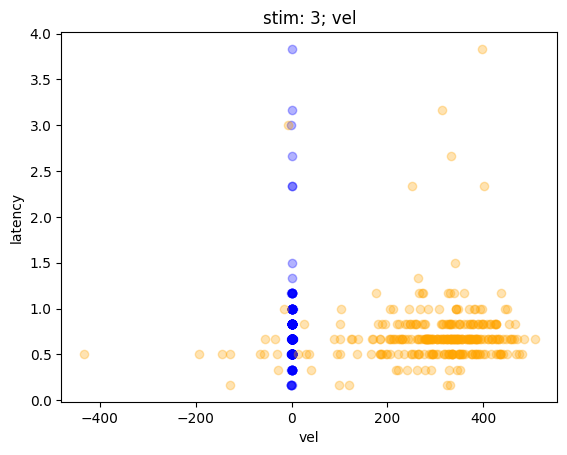

...

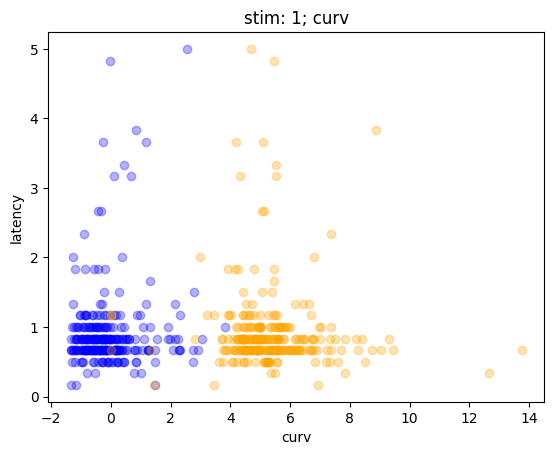

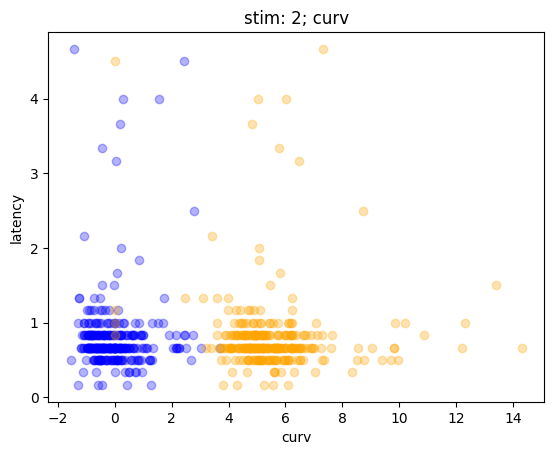

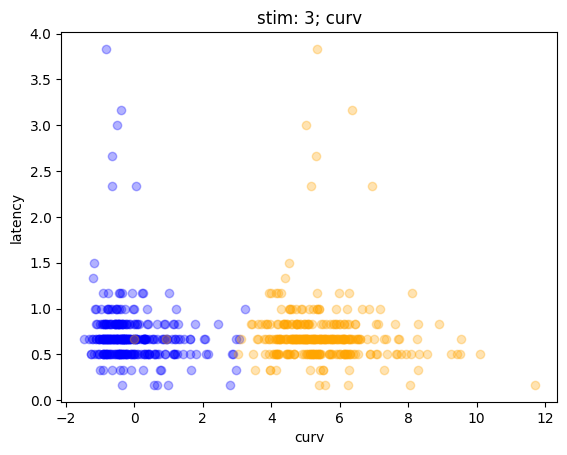

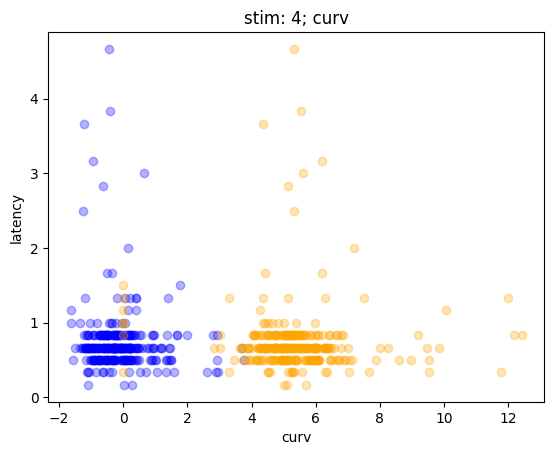

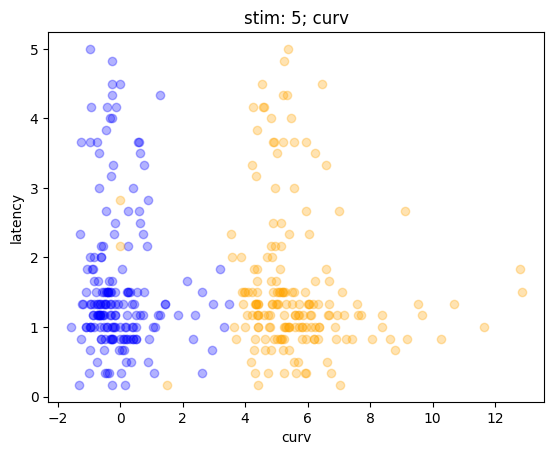

In [ ]:


with warnings.catch_warnings():
        
    # ##get inputs into lstm 
    # beh_map = [z_norm.min(), z_norm.min()/2 + z_norm.max()/2, z_norm.max()]

    warnings.simplefilter("ignore")
    
    for feature, exp_feature, feature_lbl in zip([resampled_vel, resampled_acc, resampled_curve],
                                                 [exp_vel, exp_acc, exp_curve], 
                                                 ["vel", "accel", "curv"]):
        print("feature_lbl", feature_lbl)
        include_beh = False
        n_tracks = resampled_rev.shape[0]
        n_splits = 10
        results_dict = {}  # Store mean/std r² per i and n_timesteps
        best_models = {}   # Store best model per (i, n_timesteps)
        lstm_lag = 5
        idxs = [[0],[1],[2],[3],[4],[5]]
        fig, ax = plt.subplots()
        for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
            score_means = []
            score_stds = []
            # all_r2_means = []
            all_scores_per_i = {}
            n_timesteps_list = []
            onset = resampled_onset-1
            n_timesteps = 1
            # for n_timesteps in range(1, 15, 3):
            # for n_timesteps in range(1, 15, 1):
            print(f"\nProcessing i={i}, n_timesteps={n_timesteps}")

            # X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps,   lstm_lag = lstm_lag)#shape (n_tracks, n_frames, n_features)
            # X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps, z,  lstm_lag = lstm_lag, include_beh = include_beh)#shape (n_tracks, n_frames, n_features)
            # X_stim_all1, _ = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps, z,  lstm_lag = lstm_lag, include_beh = include_beh)#shape (n_tracks, n_frames, n_features)
            features_list = [feature]
            feature_labels = [feature_lbl]
            X_stim_all, feature_names_all = prep_FB_inputs_select_features_only(
                # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
                features_list, feature_labels, onset,  n_timesteps, z, lstm_lag = lstm_lag, 
            
                            )
            
            # X_stim_features = X_all_LSTM[:, stim_onset, :]

            
            Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
            no_rev_at_onset = Y_latency!=0
            Y_prob = np.logical_not(np.isnan(Y_latency[no_rev_at_onset]))# classfy y/n did rev happen
            X_prob = copy.deepcopy(X_stim_all[no_rev_at_onset])
            Y_latency1 = Y_latency[no_rev_at_onset]
            print(feature_names_all)
            fig, ax = plt.subplots()
            ax.scatter(X_prob.flatten(), Y_latency1, color = "blue", alpha = 0.3)
            
            
            
            
            features_list = [exp_feature]
            feature_labels = [feature_lbl]
            X_stim_all, feature_names_all = prep_FB_inputs_select_features_only(
                # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
                features_list, feature_labels, exp_onset-1,  n_timesteps, z, lstm_lag = lstm_lag, 
            
                            )
            
                        
            Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
            no_rev_at_onset = Y_latency!=0
            Y_prob = np.logical_not(np.isnan(Y_latency[no_rev_at_onset]))# classfy y/n did rev happen
            X_prob = copy.deepcopy(X_stim_all[no_rev_at_onset])
            Y_latency1 = Y_latency[no_rev_at_onset]
            print(feature_names_all)
            # fig, ax = plt.subplots()
            
            ax.scatter(X_prob.flatten(), Y_latency1, color = "orange", alpha = 0.3)
            
            
            
            ax.set_title(f"stim: {i}; {feature_lbl}")
            ax.set_xlabel(f"{feature_lbl}")
            ax.set_ylabel(f"latency")
            
        ##plot smoothed phase vss curvature 



In [ ]:

# with warnings.catch_warnings():
        
#     # ##get inputs into lstm 
#     # beh_map = [z_norm.min(), z_norm.min()/2 + z_norm.max()/2, z_norm.max()]

#     warnings.simplefilter("ignore")
#     include_beh = False
#     fps = 1.6
#     n_tracks = resampled_rev.shape[0]
#     n_splits = 10
#     results_dict = {}  # Store mean/std r² per i and n_timesteps
#     best_models = {}   # Store best model per (i, n_timesteps)
#     lstm_lag = 5
#     idxs = [[0],[1],[2],[3],[4],[5]]
#     fig, ax = plt.subplots()
#     for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
#         score_means = []
#         score_stds = []
#         # all_r2_means = []
#         all_scores_per_i = {}
#         n_timesteps_list = []
#         onset = resampled_onset-1

#         for n_timesteps in range(1, 15, 3):
#         # for n_timesteps in range(1, 15, 1):
#             print(f"\nProcessing i={i}, n_timesteps={n_timesteps}")

#             # X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps,   lstm_lag = lstm_lag)#shape (n_tracks, n_frames, n_features)
#             X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps, z,  lstm_lag = lstm_lag, include_beh = include_beh)#shape (n_tracks, n_frames, n_features)

            
#             Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
#             no_rev_at_onset = Y_latency!=0
#             Y_prob = np.logical_not(np.isnan(Y_latency[no_rev_at_onset]))# classfy y/n did rev happen
#             X_prob = copy.deepcopy(X_stim_all[no_rev_at_onset])
            
#             ###    
#             # X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=random_state)
#             balanced_accuracy_scores = []
#             models = []

#             for split_idx in range(n_splits):
#                 # X_train, X_test, y_train, y_test = train_test_split(
#                 #     X_stim_all_latency, Y_latency_valid, test_size=test_size, random_state=split_idx)
                
#                 X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=split_idx)
                
#                 param_grid = {
#                     'C': [0.001, 0.01, 0.1, 1, 10, 100]
#                 }

#                 model = LinearSVC(penalty='l1', dual=False, max_iter=10000)
#                 # Grid search
#                 grid = GridSearchCV(model, param_grid, cv=5, scoring='balanced_accuracy')
#                 grid.fit(X_train, y_train)
#                 c = grid.best_params_['C']
#                 best_model = grid.best_estimator_
                
#                 y_pred = best_model.predict(X_test)
#                 score =balanced_accuracy_score(y_test, y_pred)  

#                 balanced_accuracy_scores.append(score)
#                 # models.append(best_model)
#                 models.append((best_model,X_train, X_test, y_train, y_test, c))

#             accuracy_mean = np.mean(balanced_accuracy_scores)
#             accuracy_std = np.std(balanced_accuracy_scores)
#             best_model_idx = np.argmax(balanced_accuracy_scores)
#             best_model_overall = models[best_model_idx]

#             # Save results
#             n_timesteps_list.append(n_timesteps)
#             # all_r2_means.append(r2s)
#             all_scores_per_i[(i, n_timesteps)] = balanced_accuracy_scores
#             score_means.append(accuracy_mean)
#             score_stds.append(accuracy_std)
#             results_dict[(i, n_timesteps)] = (accuracy_mean, accuracy_std)
#             best_models[(i, n_timesteps)] = best_model_overall


#         # cmap1 = cm.get_cmap('tab10', len(resampled_onsets))
#         ax.errorbar(np.array(n_timesteps_list)/fps, score_means, yerr=score_stds, #color=cmap1(i),
#                     fmt='-o', capsize=5, label = f"stim {i}")

#         ax.set_title(f"{neuron}; features only; Reversal prediction;\n Mean ± STD balanced accuracy")
#         ax.set_xlabel("max time delay (seconds)")
#         ax.set_ylabel("balanced accuracy")
#     ax.legend()
#     plt.grid(True)
#     plt.tight_layout()
#     # plt.savefig(f"r2_plot_i{i}.png")
#     # plt.close()

# n_timesteps = 10
# include_beh = False


# feature_names = np.array([[f"vel_t-{(n_timesteps - t - 1)/fps}", f"accel_t-{(n_timesteps - t - 1)/fps}",
#                         f"curv_t-{(n_timesteps - t - 1)/fps}"]
#                         for t in range(n_timesteps)]).flatten()
# for i in range(len(resampled_onsets)):
#     model,X_train, X_test, y_train, y_test, c  = best_models[(i, n_timesteps)] 

#     model_label= f"{neuron} stim: {i}; linear SVC; Features only "#; lasso_a{np.round(alpha,2)}"
#     visualize_model_classification(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False, coeffs = model.coef_[0])#, xlim = [-1,1])
    
# plt.show()

    




Processing i=0, n_timesteps=1

Processing i=0, n_timesteps=4

Processing i=0, n_timesteps=7

Processing i=0, n_timesteps=10

Processing i=0, n_timesteps=13

Processing i=1, n_timesteps=1

Processing i=1, n_timesteps=4

Processing i=1, n_timesteps=7

Processing i=1, n_timesteps=10

Processing i=1, n_timesteps=13

Processing i=2, n_timesteps=1

Processing i=2, n_timesteps=4

Processing i=2, n_timesteps=7

Processing i=2, n_timesteps=10

Processing i=2, n_timesteps=13

Processing i=3, n_timesteps=1

Processing i=3, n_timesteps=4

Processing i=3, n_timesteps=7

Processing i=3, n_timesteps=10

Processing i=3, n_timesteps=13

Processing i=4, n_timesteps=1

Processing i=4, n_timesteps=4

Processing i=4, n_timesteps=7

Processing i=4, n_timesteps=10

Processing i=4, n_timesteps=13

Processing i=5, n_timesteps=1

Processing i=5, n_timesteps=4

Processing i=5, n_timesteps=7

Processing i=5, n_timesteps=10

Processing i=5, n_timesteps=13
RIM stim: 0; linear SVC; Features only Accuracy: 0.9736842

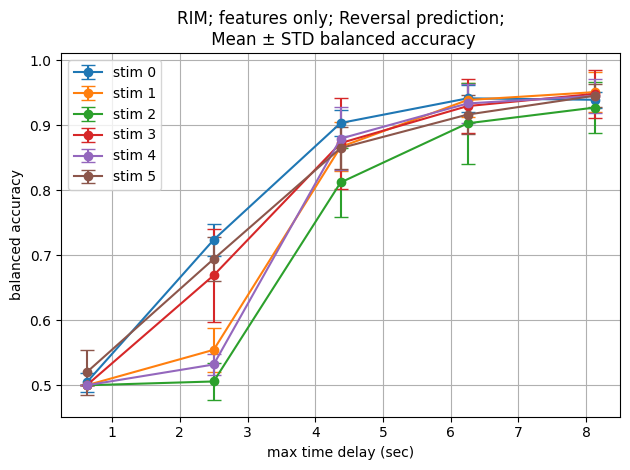

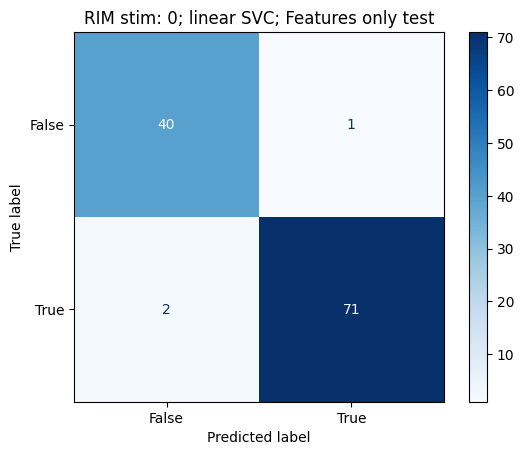

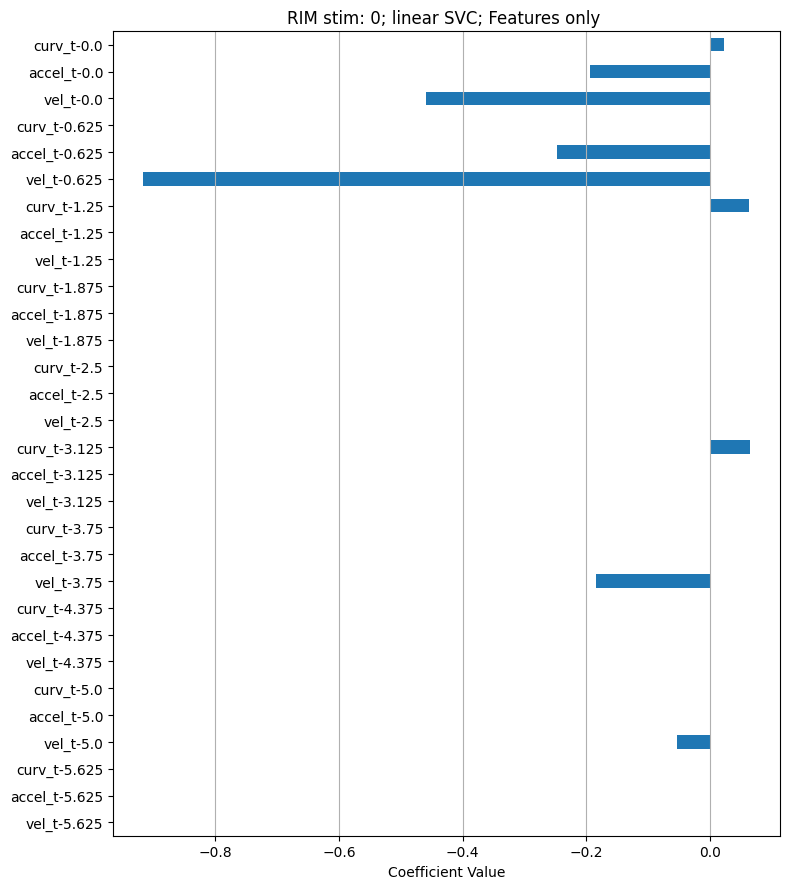

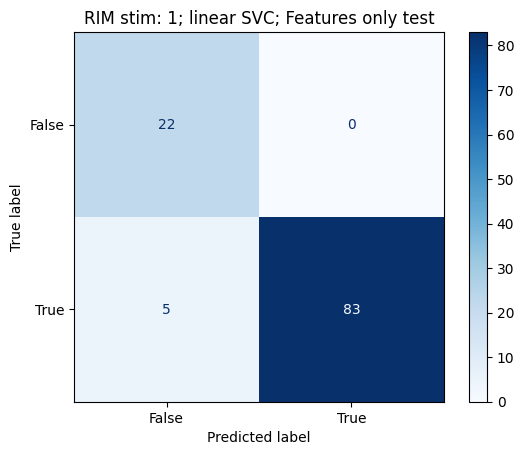

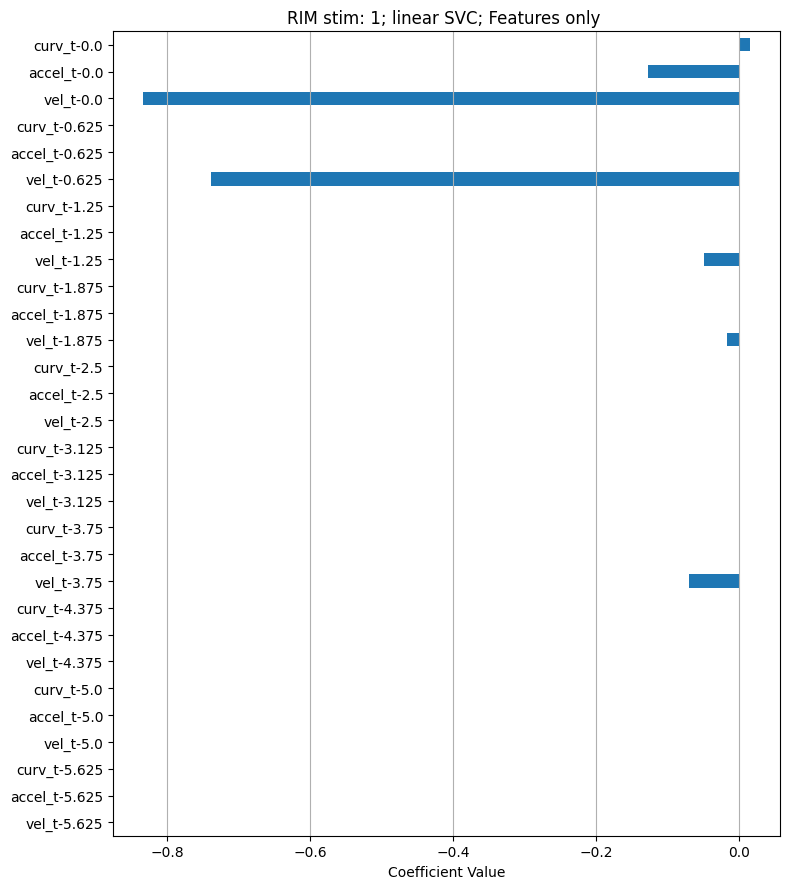

...

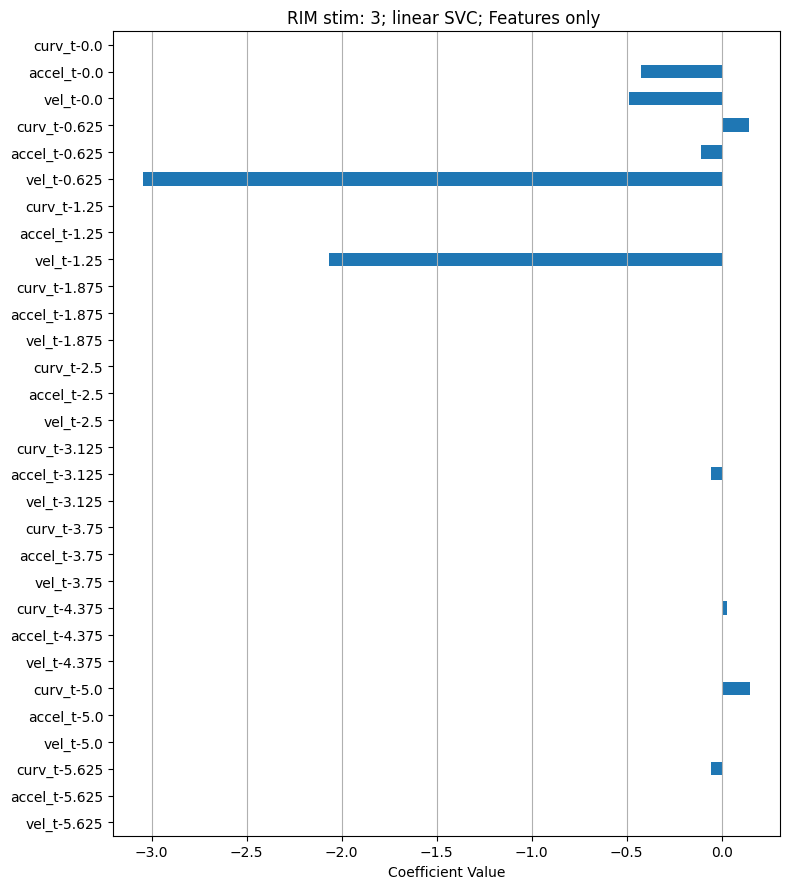

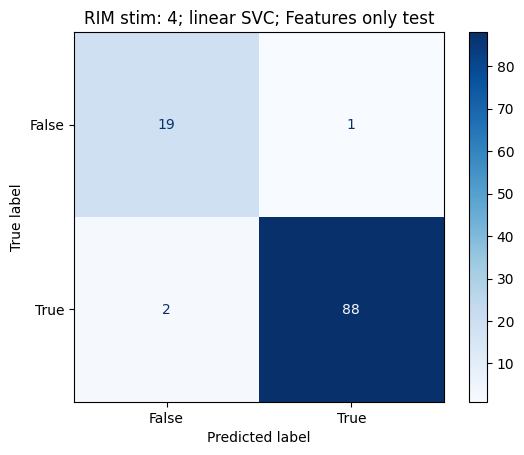

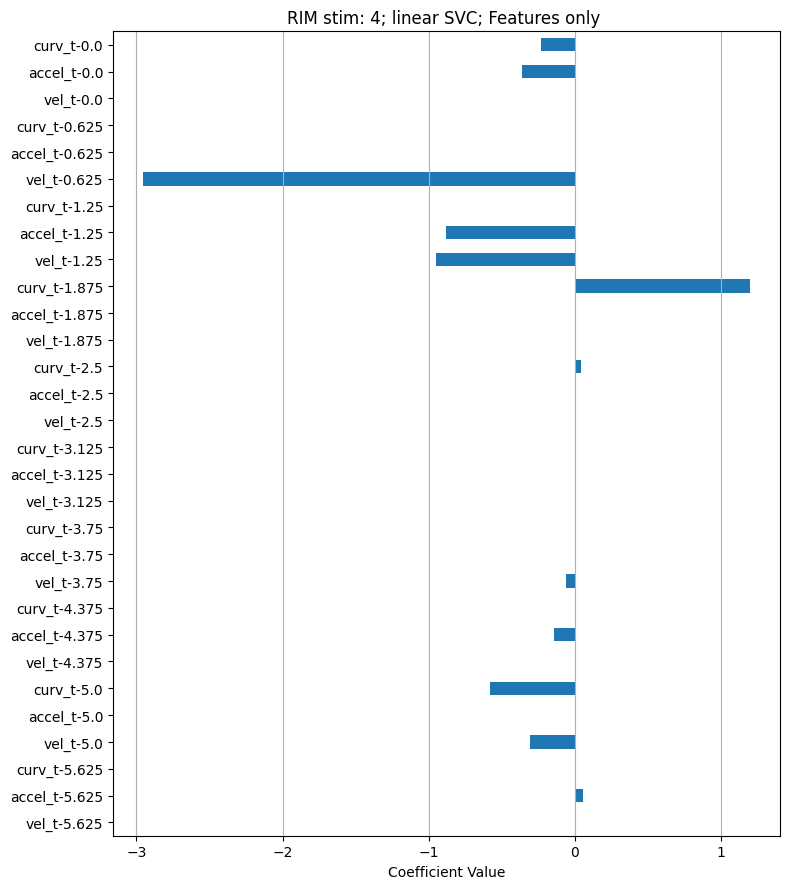

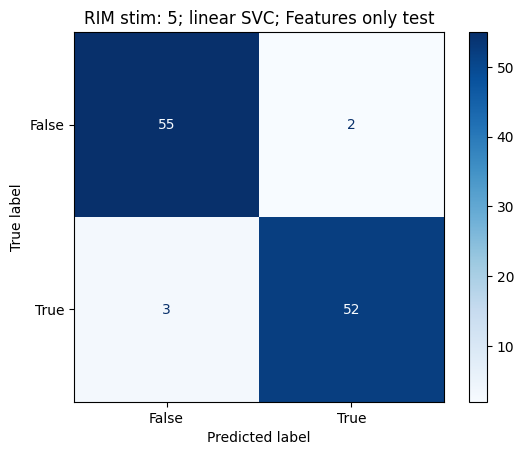

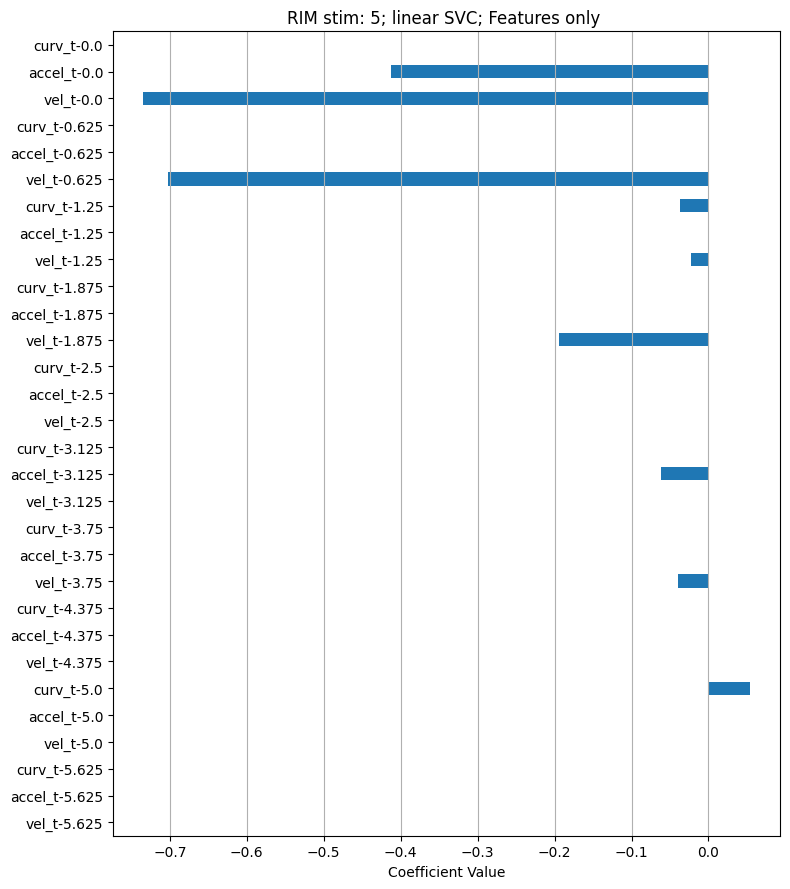

In [ ]:


with warnings.catch_warnings():
        
    # ##get inputs into lstm 
    # beh_map = [z_norm.min(), z_norm.min()/2 + z_norm.max()/2, z_norm.max()]

    warnings.simplefilter("ignore")
    include_beh = False
    n_tracks = resampled_rev.shape[0]
    n_splits = 10
    results_dict = {}  # Store mean/std r² per i and n_timesteps
    best_models = {}   # Store best model per (i, n_timesteps)
    lstm_lag = 5
    idxs = [[0],[1],[2],[3],[4],[5]]
    fig, ax = plt.subplots()
    fps = 1.6
    for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
        score_means = []
        score_stds = []
        # all_r2_means = []
        all_scores_per_i = {}
        n_timesteps_list = []
        onset = resampled_onset-1

        for n_timesteps in range(1, 15, 3):
        # for n_timesteps in range(1, 15, 1):
            print(f"\nProcessing i={i}, n_timesteps={n_timesteps}")

            X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps, z,  lstm_lag = lstm_lag, include_beh = include_beh)#shape (n_tracks, n_frames, n_features)
            Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
            no_rev_at_onset = Y_latency!=0
            Y_prob = np.logical_not(np.isnan(Y_latency[no_rev_at_onset]))# classfy y/n did rev happen
            X_prob = copy.deepcopy(X_stim_all[no_rev_at_onset])
            
            ###    
            # X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=random_state)
            balanced_accuracy_scores = []
            models = []

            for split_idx in range(n_splits):
                # X_train, X_test, y_train, y_test = train_test_split(
                #     X_stim_all_latency, Y_latency_valid, test_size=test_size, random_state=split_idx)
                
                X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=split_idx)
                
                param_grid = {
                    'C': [0.001, 0.01, 0.1, 1, 10, 100]
                }

                model = LinearSVC(penalty='l1', dual=False, max_iter=10000)
                # Grid search
                grid = GridSearchCV(model, param_grid, cv=5, scoring='balanced_accuracy')
                grid.fit(X_train, y_train)
                c = grid.best_params_['C']
                best_model = grid.best_estimator_
                
                y_pred = best_model.predict(X_test)
                score =balanced_accuracy_score(y_test, y_pred)  

                balanced_accuracy_scores.append(score)
                # models.append(best_model)
                models.append((best_model,X_train, X_test, y_train, y_test, c))

            accuracy_mean = np.mean(balanced_accuracy_scores)
            accuracy_std = np.std(balanced_accuracy_scores)
            best_model_idx = np.argmax(balanced_accuracy_scores)
            best_model_overall = models[best_model_idx]

            # Save results
            n_timesteps_list.append(n_timesteps)
            # all_r2_means.append(r2s)
            all_scores_per_i[(i, n_timesteps)] = balanced_accuracy_scores
            score_means.append(accuracy_mean)
            score_stds.append(accuracy_std)
            results_dict[(i, n_timesteps)] = (accuracy_mean, accuracy_std)
            best_models[(i, n_timesteps)] = best_model_overall


        # cmap1 = cm.get_cmap('tab10', len(resampled_onsets))
        ax.errorbar(np.array(n_timesteps_list)/fps, score_means, yerr=score_stds, #color=cmap1(i),
                    fmt='-o', capsize=5, label = f"stim {i}")

        ax.set_title(f"{neuron}; features only; Reversal prediction;\n Mean ± STD balanced accuracy")
        ax.set_xlabel("max time delay (sec)")
        ax.set_ylabel("balanced accuracy")
    ax.legend()
    plt.grid(True)
    plt.tight_layout()
    # plt.savefig(f"r2_plot_i{i}.png")
    # plt.close()

n_timesteps = 10


feature_names = np.array([[f"vel_t-{(n_timesteps - t - 1)/fps}", f"accel_t-{(n_timesteps - t - 1)/fps}",
                        f"curv_t-{(n_timesteps - t - 1)/fps}"]
                        for t in range(n_timesteps)]).flatten()
for i in range(len(resampled_onsets)):
    model,X_train, X_test, y_train, y_test, c  = best_models[(i, n_timesteps)] 

    model_label= f"{neuron} stim: {i}; linear SVC; Features only "#; lasso_a{np.round(alpha,2)}"
    visualize_model_classification(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False, coeffs = model.coef_[0])#, xlim = [-1,1])
    
plt.show()

    




Processing i=0, n_timesteps=1

Processing i=0, n_timesteps=4

Processing i=0, n_timesteps=7

Processing i=0, n_timesteps=10

Processing i=0, n_timesteps=13

Processing i=1, n_timesteps=1

Processing i=1, n_timesteps=4

Processing i=1, n_timesteps=7

Processing i=1, n_timesteps=10

Processing i=1, n_timesteps=13

Processing i=2, n_timesteps=1

Processing i=2, n_timesteps=4

Processing i=2, n_timesteps=7

Processing i=2, n_timesteps=10

Processing i=2, n_timesteps=13

Processing i=3, n_timesteps=1

Processing i=3, n_timesteps=4

Processing i=3, n_timesteps=7

Processing i=3, n_timesteps=10

Processing i=3, n_timesteps=13

Processing i=4, n_timesteps=1

Processing i=4, n_timesteps=4

Processing i=4, n_timesteps=7

Processing i=4, n_timesteps=10

Processing i=4, n_timesteps=13

Processing i=5, n_timesteps=1

Processing i=5, n_timesteps=4

Processing i=5, n_timesteps=7

Processing i=5, n_timesteps=10

Processing i=5, n_timesteps=13
RIM stim: 0; linear SVC; Features only Accuracy: 0.9561403

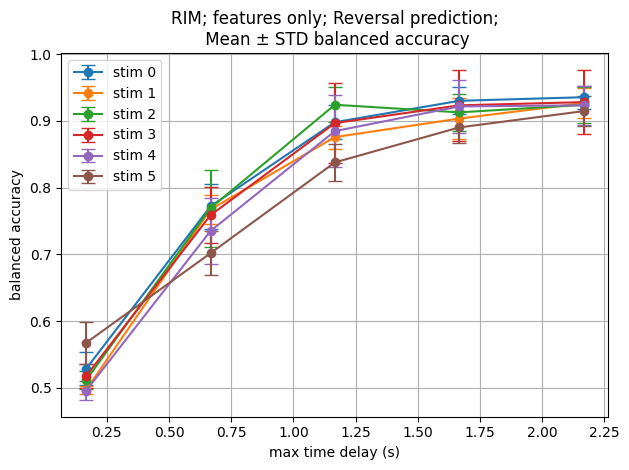

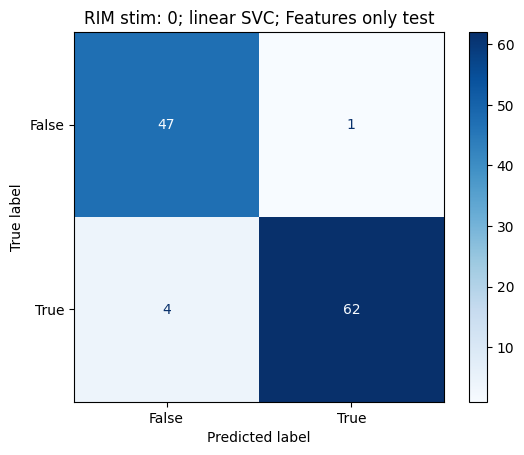

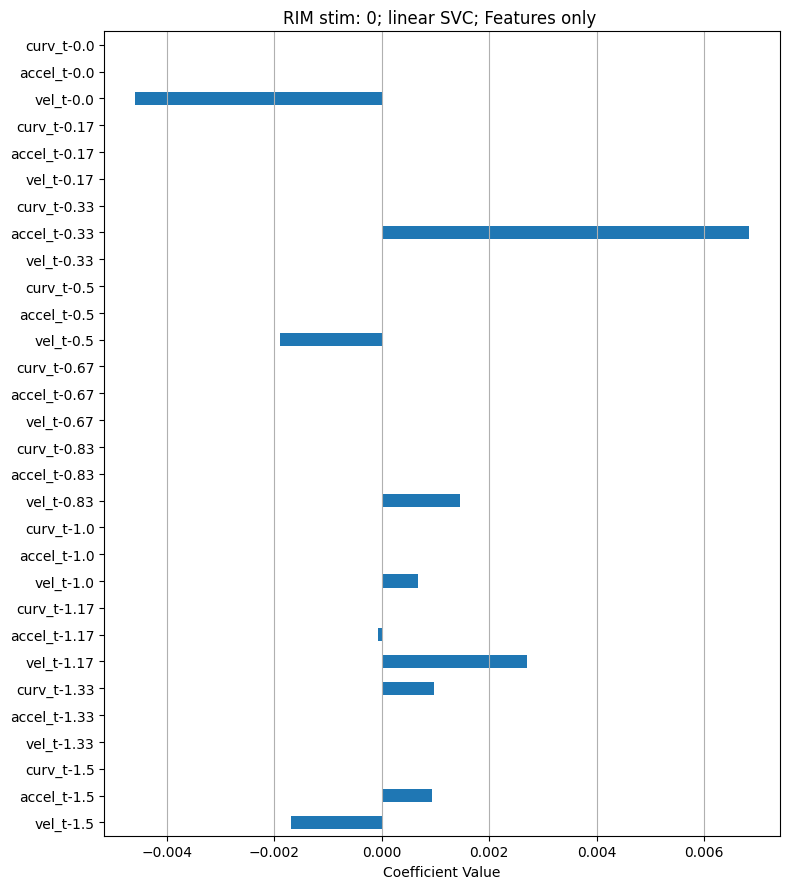

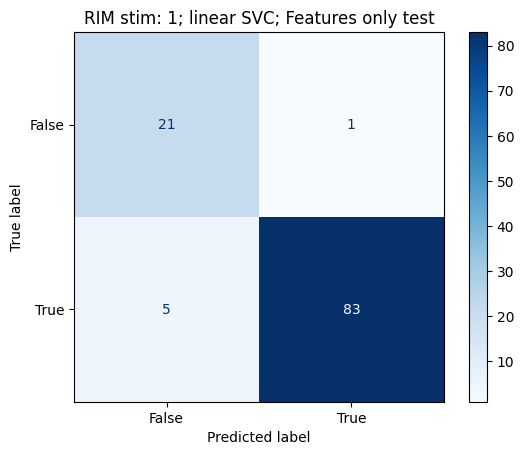

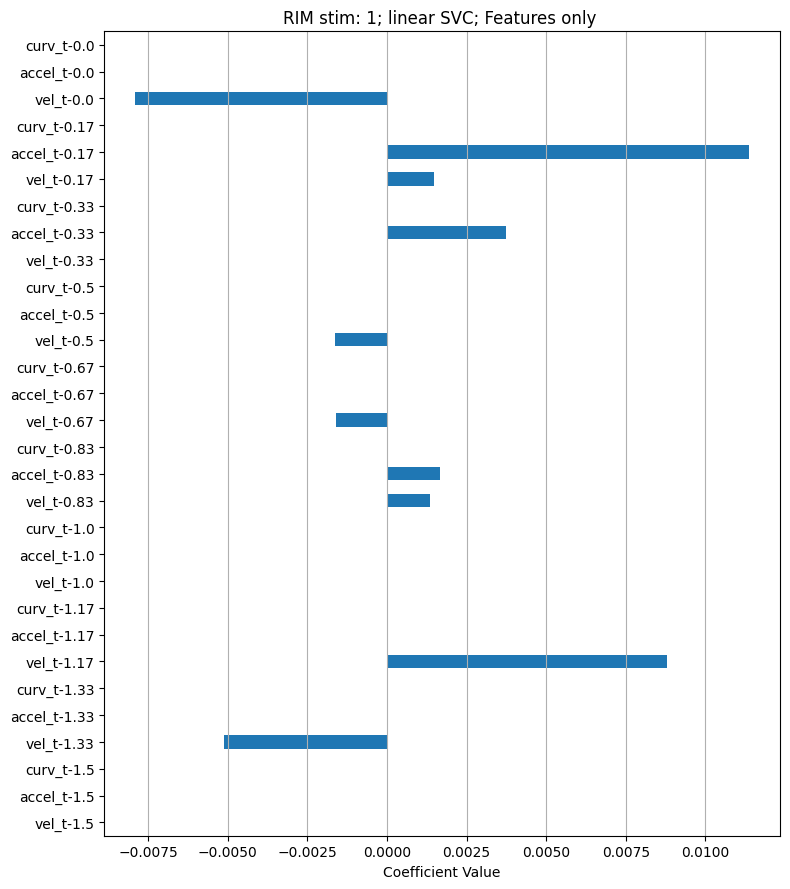

...

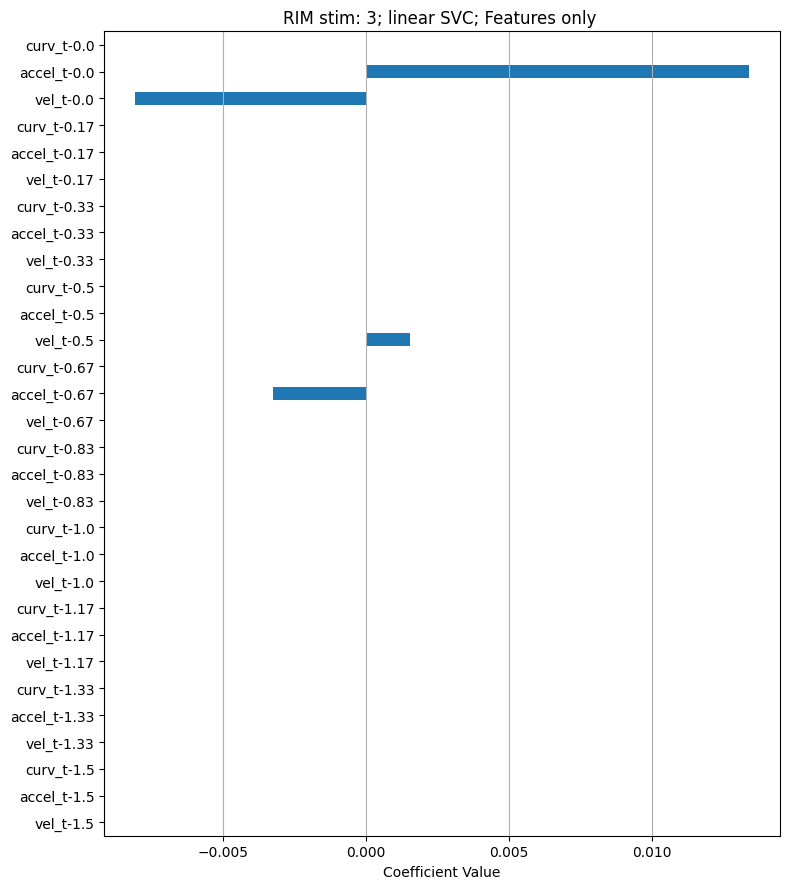

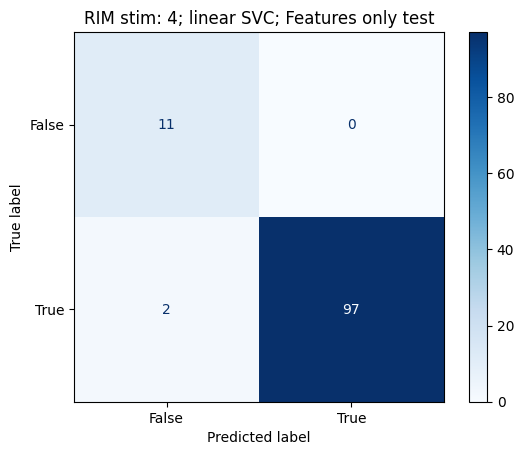

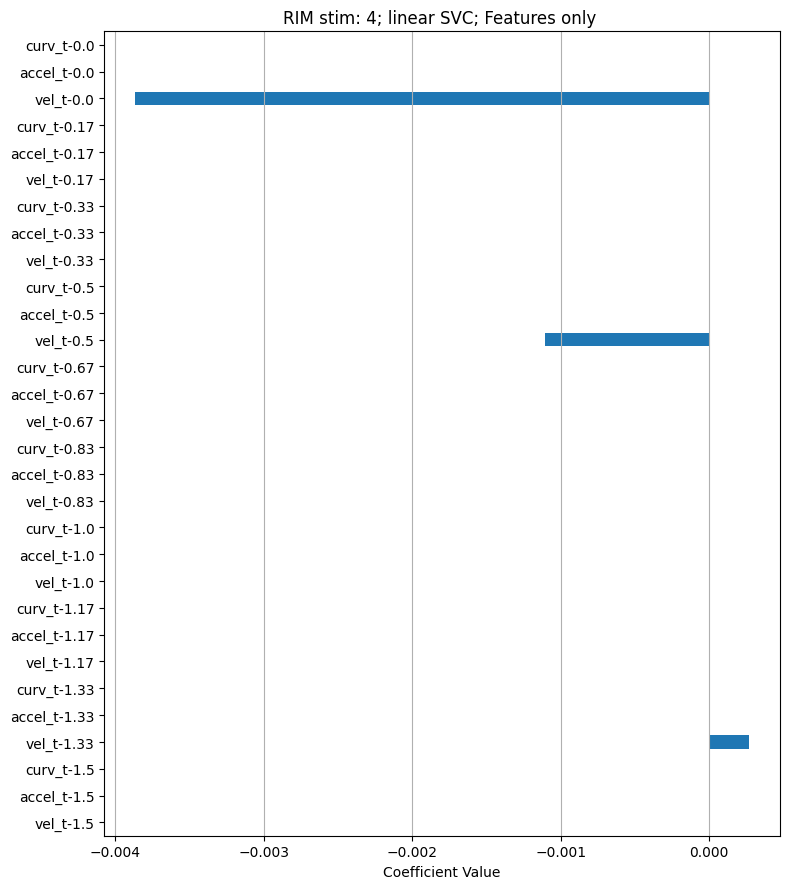

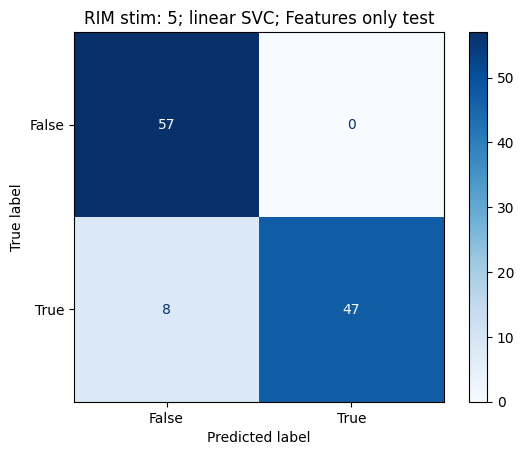

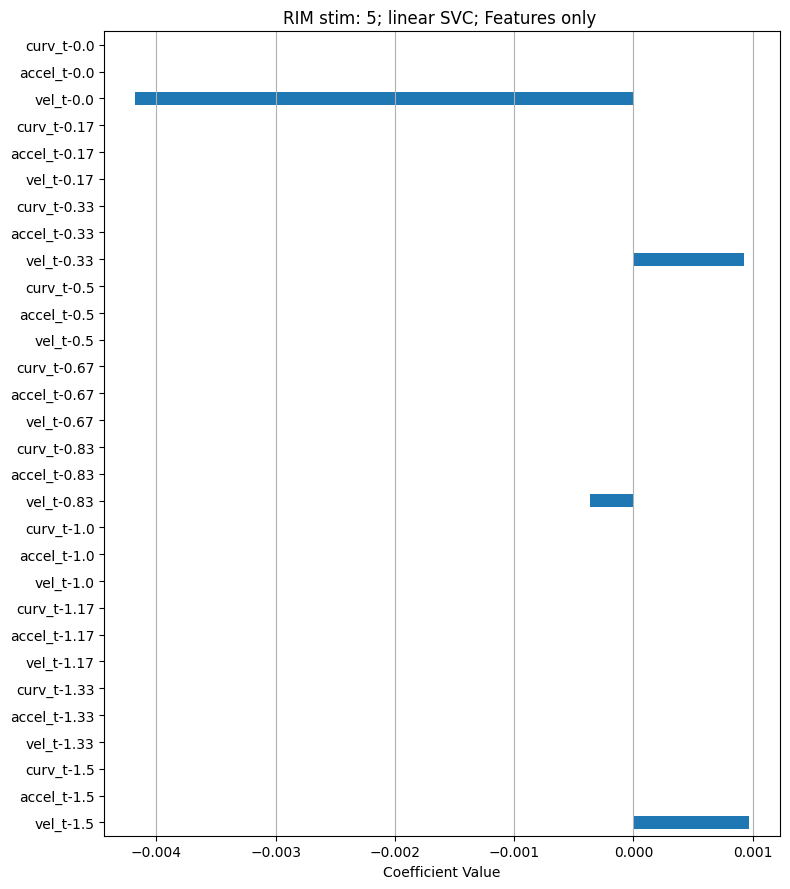

In [ ]:
##############
#######test prediction from features - exp fps 
################


with warnings.catch_warnings():

    fps = 6
    warnings.simplefilter("ignore")
    include_beh = False
    n_tracks = resampled_rev.shape[0]
    n_splits = 10
    results_dict = {}  # Store mean/std r² per i and n_timesteps
    best_models = {}   # Store best model per (i, n_timesteps)
    # exp_lstm_lag = 0
    idxs = [[0],[1],[2],[3],[4],[5]]
    fig, ax = plt.subplots()
    for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
        score_means = []
        score_stds = []
        # all_r2_means = []
        all_scores_per_i = {}
        n_timesteps_list = []
        onset = resampled_onset-1

        for n_timesteps in range(1, 15, 3):
        # for n_timesteps in range(1, 15, 1):
            print(f"\nProcessing i={i}, n_timesteps={n_timesteps}")

            # X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps,   lstm_lag = lstm_lag)#shape (n_tracks, n_frames, n_features)
            X_stim_all, feature_names_all = prep_FB_inputs_features_only(exp_vel, exp_acc, exp_curve, exp_rev, exp_turn, exp_onset, n_timesteps, z, 
                                                                         lstm_lag = 0, include_beh = include_beh)#shape (n_tracks, n_frames, n_features)

            
            Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
            no_rev_at_onset = Y_latency!=0
            Y_prob = np.logical_not(np.isnan(Y_latency[no_rev_at_onset]))# classfy y/n did rev happen
            X_prob = copy.deepcopy(X_stim_all[no_rev_at_onset])
            
            ###    
            # X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=random_state)
            balanced_accuracy_scores = []
            models = []

            for split_idx in range(n_splits):
                # X_train, X_test, y_train, y_test = train_test_split(
                #     X_stim_all_latency, Y_latency_valid, test_size=test_size, random_state=split_idx)
                
                X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=split_idx)
                
                param_grid = {
                    'C': [0.001, 0.01, 0.1, 1, 10, 100]
                }

                model = LinearSVC(penalty='l1', dual=False, max_iter=10000)
                # Grid search
                grid = GridSearchCV(model, param_grid, cv=5, scoring='balanced_accuracy')
                grid.fit(X_train, y_train)
                c = grid.best_params_['C']
                best_model = grid.best_estimator_
                
                y_pred = best_model.predict(X_test)
                score =balanced_accuracy_score(y_test, y_pred)  

                balanced_accuracy_scores.append(score)
                # models.append(best_model)
                models.append((best_model,X_train, X_test, y_train, y_test, c))

            accuracy_mean = np.mean(balanced_accuracy_scores)
            accuracy_std = np.std(balanced_accuracy_scores)
            best_model_idx = np.argmax(balanced_accuracy_scores)
            best_model_overall = models[best_model_idx]

            # Save results
            n_timesteps_list.append(n_timesteps)
            # all_r2_means.append(r2s)
            all_scores_per_i[(i, n_timesteps)] = balanced_accuracy_scores
            score_means.append(accuracy_mean)
            score_stds.append(accuracy_std)
            results_dict[(i, n_timesteps)] = (accuracy_mean, accuracy_std)
            best_models[(i, n_timesteps)] = best_model_overall


        # cmap1 = cm.get_cmap('tab10', len(resampled_onsets))
        ax.errorbar(np.array(n_timesteps_list)/fps, score_means, yerr=score_stds, #color=cmap1(i),
                    fmt='-o', capsize=5, label = f"stim {i}")

        ax.set_title(f"{neuron}; features only; Reversal prediction;\n Mean ± STD balanced accuracy")
        ax.set_xlabel("max time delay (s)")
        ax.set_ylabel("balanced accuracy")
    ax.legend()
    plt.grid(True)
    plt.tight_layout()

# plt.show()
n_timesteps = 10
include_beh = False

feature_names = np.array([[f"vel_t-{np.round((n_timesteps - t - 1)/fps, 2)}", f"accel_t-{np.round((n_timesteps - t - 1)/fps, 2)}",
                        f"curv_t-{np.round((n_timesteps - t - 1)/fps, 2)}"]
                        for t in range(n_timesteps)]).flatten()
for i in range(len(resampled_onsets)):
    model,X_train, X_test, y_train, y_test, c  = best_models[(i, n_timesteps)] 

    model_label= f"{neuron} stim: {i}; linear SVC; Features only "#; lasso_a{np.round(alpha,2)}"
    visualize_model_classification(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False, coeffs = model.coef_[0])#, xlim = [-1,1])
    
plt.show()

    


Processing i=5, n_timesteps=2

Processing i=5, n_timesteps=6

Processing i=5, n_timesteps=10

Processing i=5, n_timesteps=14


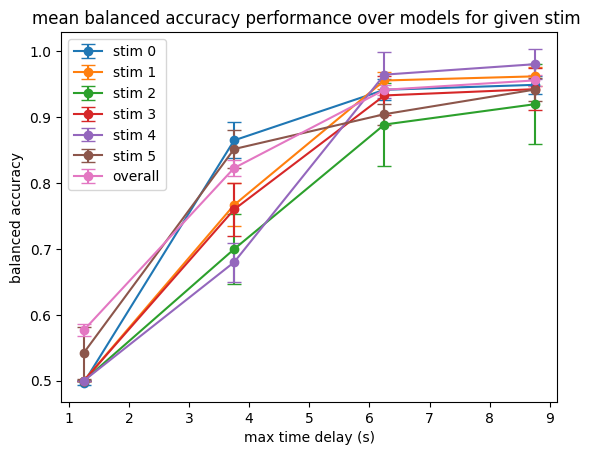

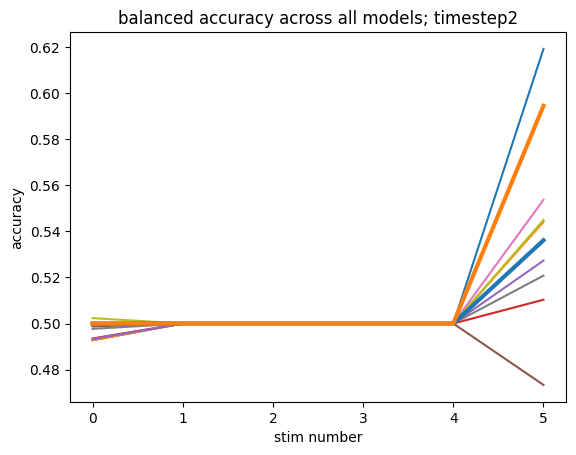

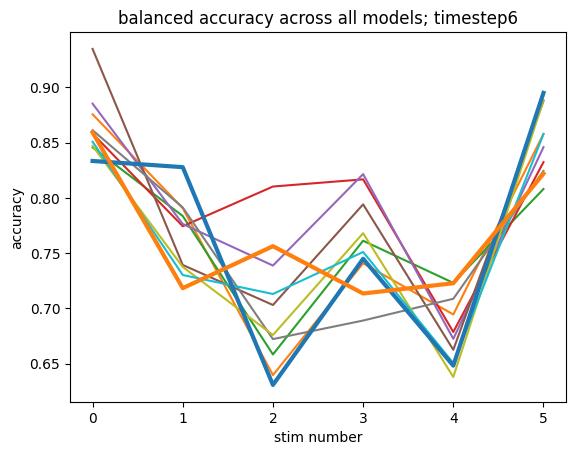

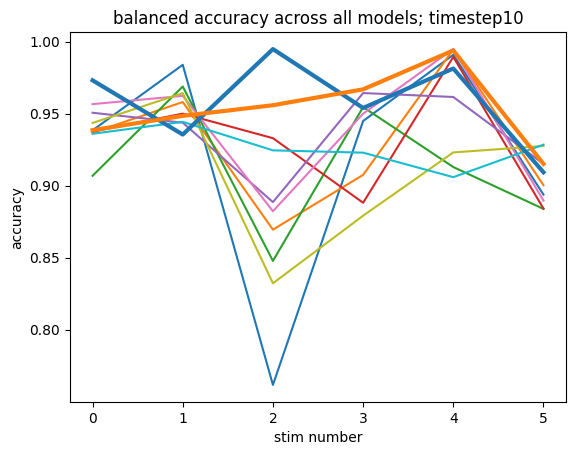

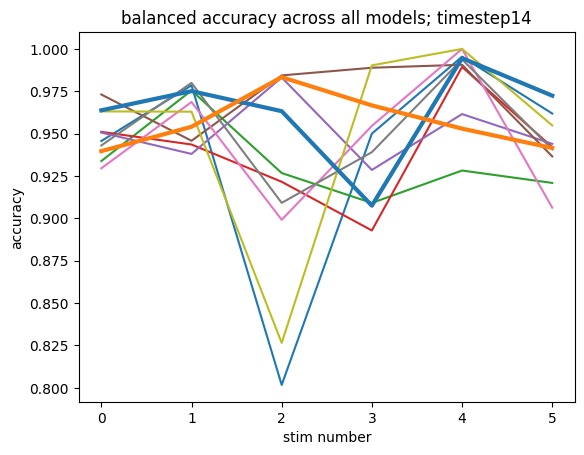

In [ ]:
import warnings
from sklearn import metrics


###########
###########test predicitons from features only compare models 
#############
with warnings.catch_warnings():
    fps = 1.6
    warnings.simplefilter("ignore")
    n_tracks = resampled_rev.shape[0]
    test_size = 0.3
    n_splits = 10
    results_dict = {}  # Store mean/std r² per i and n_timesteps
    best_models = {}   # Store best model per (i, n_timesteps)
    lstm_lag = 5
    idxs = [[0],[1],[2],[3],[4],[5]]


    results_dict_score_overall = {}
    best_models_score_overall ={}
    results_dict_auc_overall ={}
    best_models_auc_overall = {}
    
    results_dict_score_stim ={}
    best_models_score_stim = {}
    best_models_auc_stim = {}
    
    results_dict_auc_stim={}
    
    t_to_all_data = {}
    t_to_all_models = {}
    t_to_all_stim_scores ={}
    t_to_overall_aucs = {}
    t_to_best_model_using_min_idx_score ={}
    
    n_timesteps_list = []
    t_to_best_model_idx_auc = {}
    t_to_best_model_idx_score = {}
    for n_timesteps in range(2, 15, 4):#range(1, 15, 4):
        print(f"\nProcessing i={i}, n_timesteps={n_timesteps}")

        all_data = []
        n_stim = len(resampled_onsets)
        stim_i_to_score_means = {i:[] for i in range(n_stim)}
        stim_i_to_score_stds = {i:[] for i in range(n_stim)}
        
        stim_i_to_Xs = {}
        stim_i_to_Ys = {}
        
        ##########prep data 
        for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
            onset = resampled_onset-1
            X_stim_all, feature_names = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps, z,  lstm_lag = lstm_lag, include_beh = False)#shape (n_tracks, n_frames, n_features)
            Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
            no_rev_at_onset = Y_latency!=0
            Y_prob = np.logical_not(np.isnan(Y_latency[no_rev_at_onset]))# classfy y/n did rev happen
            X_prob = copy.deepcopy(X_stim_all[no_rev_at_onset])
            stim_i_to_Xs[i] = X_prob
            stim_i_to_Ys[i] = Y_prob
       
        all_stim_X_stim_features, all_stim_Y, feature_names_all = combine_FB_features_across_stim(stim_i_to_Xs, stim_i_to_Ys,  feature_names)
            
            
        ###    
        # X_train, X_test, y_train, y_test = train_test_split(all_stim_X_stim_features, all_stim_Y,  test_size=test_size, random_state=random_state)
        overall_scores = []
        overall_aucs = []
        all_stim_aucs = []
        all_stim_scores =[]# np.zeros((n_splits,n_stim))
        
        best_model_idx = []
        models = [] # n_splits
        ######split data and fit model on split 
        for split_idx in range(n_splits):
            X_train, X_test, y_train, y_test = train_test_split(all_stim_X_stim_features, all_stim_Y,  test_size=test_size, random_state=split_idx)
            all_data.append((X_train, X_test, y_train, y_test))
            
            param_grid = {
                'C': [0.001, 0.01, 0.1, 1, 10, 100]
            }

            model = LinearSVC(penalty='l1', dual=False, max_iter=10000)
            # Grid search
            grid = GridSearchCV(model, param_grid, cv=5, scoring='balanced_accuracy')
            grid.fit(X_train, y_train)
            c = grid.best_params_['C']
            best_model = grid.best_estimator_

            #get stim_i for each row in test data
            stim_bin_test = X_test[:, -1*n_stim:]
            stim_i_test = np.argmax(stim_bin_test, axis = 1)
            # print(np.all(np.sum(stim_bin_test, axis = 1)==1))
            stim_scores = [] #model specfic for each stim 
            stim_aucs = []
            for j in range(n_stim):
                
                X_test_stim = X_test[stim_i_test == j, :]
                y_test_stim = y_test[stim_i_test == j]
                
                y_pred = best_model.predict(X_test_stim)
                
                
                fpr, tpr, thresholds = metrics.roc_curve(y_test_stim, y_pred, pos_label=2)
                stim_auc = metrics.auc(fpr, tpr)
                stim_score = balanced_accuracy_score(y_test_stim, y_pred)  
                stim_scores.append(stim_score)
                stim_aucs.append(stim_auc)
            all_stim_scores.append(stim_scores)
            all_stim_aucs.append(stim_aucs)
            
            y_pred = best_model.predict(X_test)
             
            
            fpr, tpr, thresholds = metrics.roc_curve(y_test, y_pred, pos_label=2)
            overall_auc = metrics.auc(fpr, tpr)
            overall_score = balanced_accuracy_score(y_test, y_pred) 
            
            overall_scores.append(overall_score)
            overall_aucs.append(overall_auc)
            models.append((best_model, c))
            
            
            # overall_balanced_accuracy_scores.append(tuple(all_scores))
            # overall_aucs.append(tuple(all_aucs))
            # balanced_accuracy_scores.append(all_scores)
            # aucs.append(all_aucs)
            
                
        all_stim_scores = np.array(all_stim_scores)#n_splits,n_stim
        all_stim_aucs = np.array(all_stim_aucs)
        
        
        ###overall scores
        accuracy_mean_overall = np.mean(overall_scores)
        accuracy_std_overall= np.std(overall_scores)
        
        best_model_idx_score_overall = np.argmax(overall_scores)
        # np.argmin(overall_scores)
        best_model_score_overall, _ = models[best_model_idx_score_overall]
        t_to_best_model_idx_score[n_timesteps] = best_model_idx_score_overall
        
        results_dict_score_overall[n_timesteps] = (accuracy_mean_overall, accuracy_std_overall)
        best_models_score_overall[ n_timesteps] = best_model_score_overall

        
        ###overall aucs 
        auc_mean_overall = np.mean(overall_aucs)
        auc_std_overall = np.std(overall_aucs)
        
        best_model_idx_auc_overall = np.argmax(overall_aucs)
        best_model_auc_overall, _ = models[best_model_idx_auc_overall]
        t_to_best_model_idx_auc[n_timesteps] = best_model_idx_auc_overall
        
        results_dict_auc_overall[n_timesteps] = (accuracy_mean_overall, accuracy_std_overall)
        best_models_auc_overall[ n_timesteps] = best_model_score_overall
        t_to_all_models[ n_timesteps] = models

        #####stim scores
        accuracy_mean_stim_specific = np.mean(all_stim_scores, axis =0)
        accuracy_std_stim_specific = np.std(all_stim_scores, axis =0)

        
        best_model_idx_score_stim_min = np.argmax(np.min(all_stim_scores, axis = 1)) # has lowest min on all stim 
        best_model_score_stim_min, _ = models[best_model_idx_score_stim_min]
        t_to_best_model_using_min_idx_score[n_timesteps] = best_model_idx_score_stim_min
        

        results_dict_score_stim[n_timesteps] = (accuracy_mean_stim_specific, accuracy_std_stim_specific)
        best_models_score_stim[ n_timesteps] = best_model_score_stim_min
        
        #####stim aucs
        auc_mean_stim_specific = np.mean(all_stim_aucs, axis = 0)
        auc_std_stim_specific = np.std(all_stim_aucs, axis = 0)
        
        
        best_model_idx_auc_stim_min = np.argmax(np.min(all_stim_aucs, axis = 1)) # has lowest min on all stim 
        best_model_auc_stim_min, _ = models[best_model_idx_auc_stim_min]
        
        
        t_to_all_stim_scores[n_timesteps] = all_stim_scores
        t_to_overall_aucs[n_timesteps] = all_stim_aucs
        
        results_dict_auc_stim[n_timesteps] = (auc_mean_stim_specific, auc_std_stim_specific)
        best_models_auc_stim[ n_timesteps] = best_model_auc_stim_min
        t_to_all_data[n_timesteps] = all_data
        

        n_timesteps_list.append(n_timesteps)

    ####plot overall mean and std overall and for each stim  
    fig, ax = plt.subplots()
    accuracy_mean_overall_over_t =[]
    accuracy_std_overall_over_t = []
    stim_acc_mean_over_t = []
    stim_acc_std_over_t = []
    for n_timesteps in n_timesteps_list:

        accuracy_mean_overall, accuracy_std_overall = results_dict_score_overall[n_timesteps]
        accuracy_mean_overall_over_t.append(accuracy_mean_overall)
        accuracy_std_overall_over_t.append(accuracy_std_overall)
        accuracy_mean_stim_specific, accuracy_std_stim_specific = results_dict_score_stim[n_timesteps]
        stim_acc_mean_over_t.append(accuracy_mean_stim_specific)
        stim_acc_std_over_t.append(accuracy_std_stim_specific)
    stim_acc_mean_over_t = np.array(stim_acc_mean_over_t)
    stim_acc_std_over_t = np.array(stim_acc_std_over_t)
    for j in range(n_stim):
        ax.errorbar(np.array(n_timesteps_list)/fps, stim_acc_mean_over_t[:,j], yerr=stim_acc_std_over_t[:,j], fmt='-o', capsize=5, label = f"stim {j}")#color=cmap1(i),
        
    ax.errorbar(np.array(n_timesteps_list)/fps, accuracy_mean_overall_over_t, yerr=accuracy_std_overall_over_t, #color=cmap1(i),
                fmt='-o', capsize=5, label = f"overall")
    ax.set_title('mean balanced accuracy performance over models for given stim ')
    ax.set_ylabel("balanced accuracy")
    ax.set_xlabel("max time delay (s)")
    ax.legend()
        
    #  ####for best overall mdoel plto how it did overall and on each stim 
    # fig, ax = plt.subplots()
    
    # for j in range(n_stim):
    #     all_scores = []
    #     for n_timesteps in n_timesteps_list:
    #         all_data = t_to_all_data[n_timesteps]
            
    #         best_model_score_overall = best_models_score_overall[ n_timesteps]
       
    #         for X_train, X_test, y_train, y_test in all_data:
    #             stim_bin_test = X_test[:, -1*n_stim:]
    #             stim_i_test = np.argmax(stim_bin_test, axis = 1)
    #             X_test_stim = X_test[stim_i_test == j, :]
    #             y_test_stim = y_test[stim_i_test == j, :]

    #             y_pred = best_model_score_overall.predict(X_test)
    #             score = balanced_accuracy_score(y_test, y_pred) 
    #             all_scores.append(score)
    #     ax.plot(n_timesteps_list, all_scores, label = f"stim {j}")
    # ax.set_xlabel("timestep")
    # ax.set_ylabel("acc")

    # # all_scores = []
    # # for n_timesteps in n_timesteps_list:
    # #     X_train, X_test, y_train, y_test = t_to_all_data[n_timesteps]
            

    # #     best_model_score_overall = best_models_score_overall[ n_timesteps]
    # #     y_pred = best_model_score_overall.predict(X_test)
    # #     score = balanced_accuracy_score(y_test, y_pred) 
    # #     all_scores.append(score)
    # #     ax.plot(n_timesteps_list, all_scores, label = "overall")
    # ax.legend()
    
    ####plot best over stim how it does overall - score for each T overall 
    # fig, ax = plt.subplots()
    
    # for j in range(n_stim):
    #     all_scores = []
    #     for n_timesteps in n_timesteps_list:
    #         X_train, X_test, y_train, y_test = t_to_all_data[n_timesteps]
    #         best_model_score_overall = best_model_score_stim_min[ n_timesteps]
       
        
    #         X_test_stim = X_test[stim_i_test == j, :]
    #         y_test_stim = y_test[stim_i_test == j, :]
            
    #         y_pred = best_model_score_overall.predict(X_test)
    #         score = balanced_accuracy_score(y_test, y_pred) 
    #         all_scores.append(score)
    #     ax.plot(n_timesteps_list, all_scores, label = f"stim {j}")
    # all_scores = []
    # for n_timesteps in n_timesteps_list:
    #     X_train, X_test, y_train, y_test = t_to_all_data[n_timesteps]
            

    #     best_model_score_overall = best_model_score_stim_min[ n_timesteps]
    #     y_pred = best_model_score_overall.predict(X_test)
    #     score = balanced_accuracy_score(y_test, y_pred) 
    #     all_scores.append(score)
    #     ax.plot(n_timesteps_list, all_scores, label = "overall")
    # ax.legend()
    
    ####plot score overall score on each stim (each line a model)
    for n_timesteps in n_timesteps_list:
        all_stim_scores = t_to_all_stim_scores[n_timesteps]
        
        fig, ax = plt.subplots()
        for k in range(n_splits): 
            ax.plot(np.arange(n_stim), all_stim_scores[k])
        ax.set_title(f"balanced accuracy across all models; timestep{n_timesteps}")
        ax.set_xlabel("stim number")
        ax.set_ylabel("accuracy")
        idx = t_to_best_model_idx_score[n_timesteps]
        ax.plot(np.arange(n_stim), all_stim_scores[idx], linewidth = 3, label = "best")
        
        idx = t_to_best_model_using_min_idx_score[n_timesteps]
        ax.plot(np.arange(n_stim), all_stim_scores[idx], linewidth = 3, label = "best using min")

            
    

    



Processing i=0, n_timesteps=1
n_timesteps 1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=4
n_timesteps 4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4


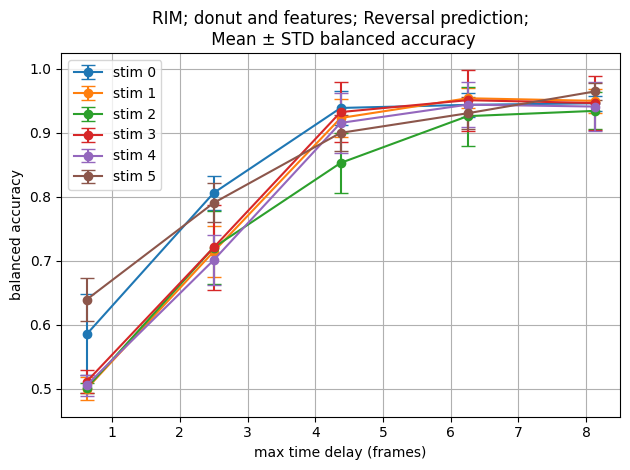

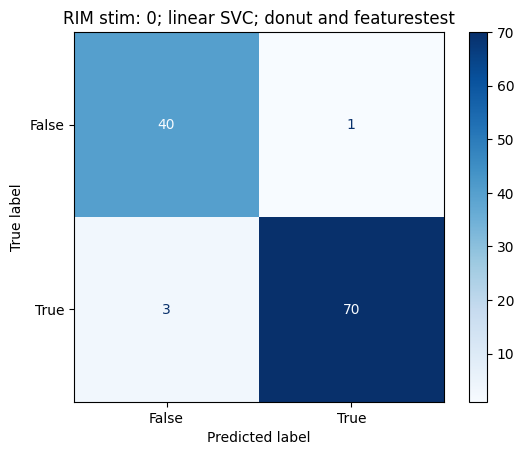

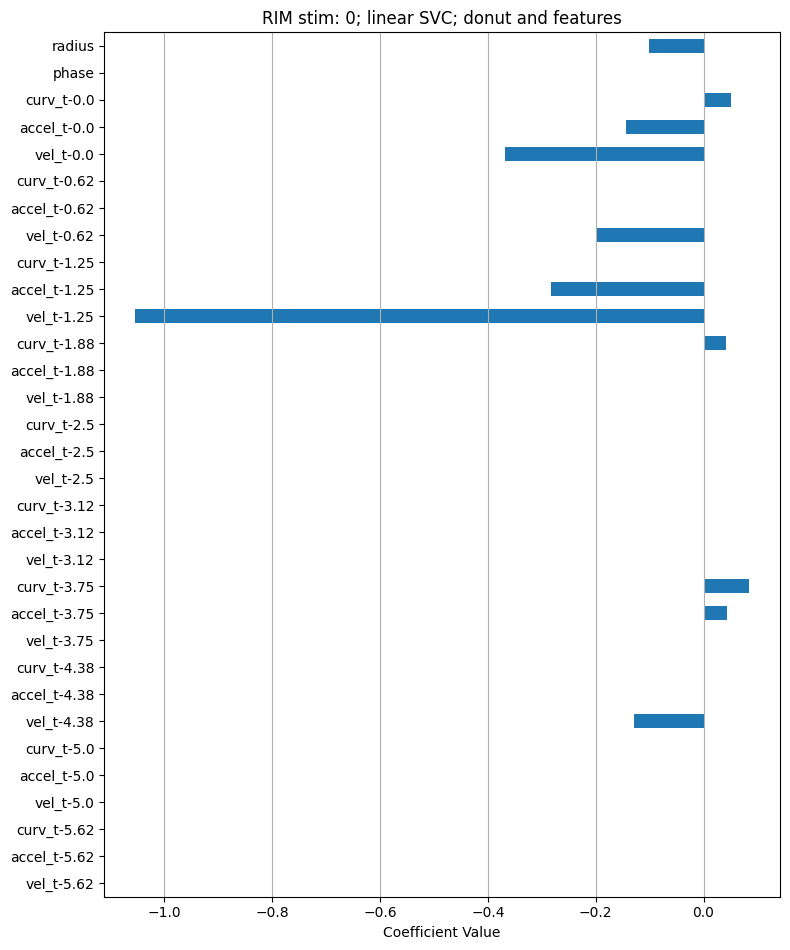

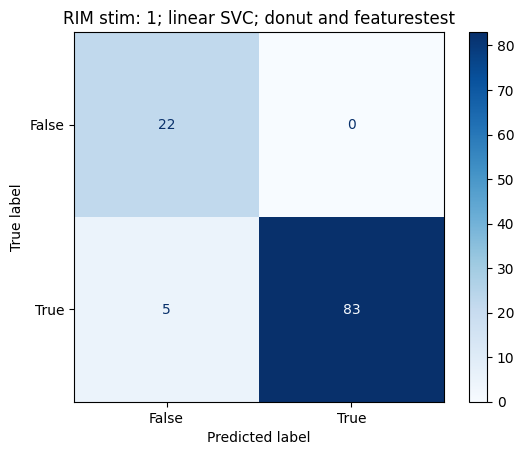

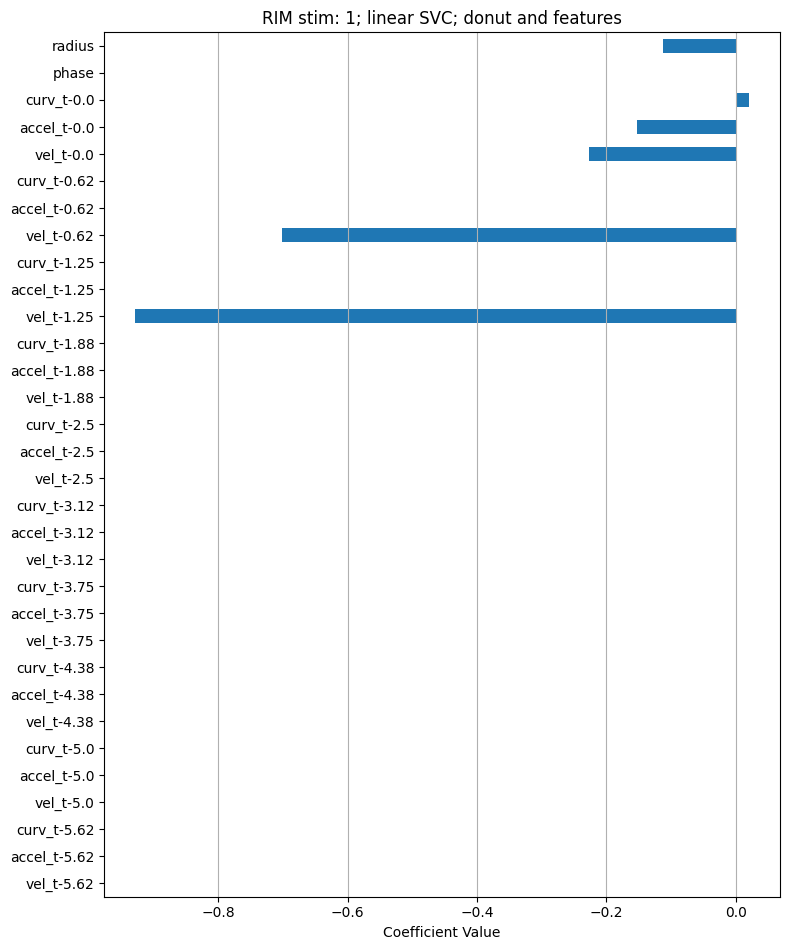

...

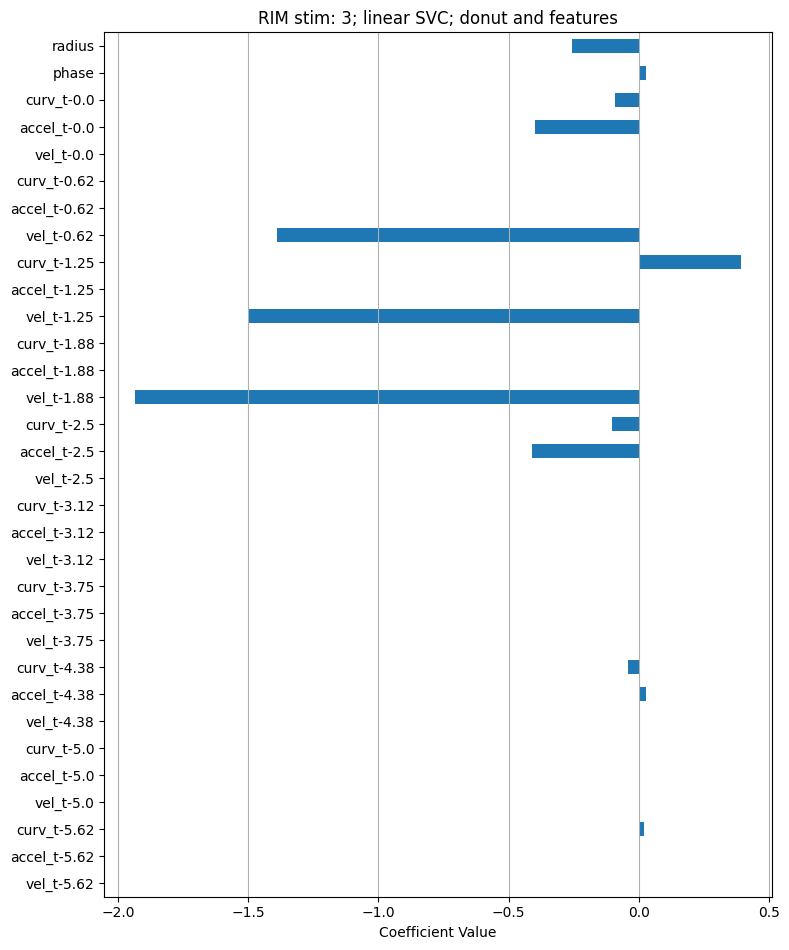

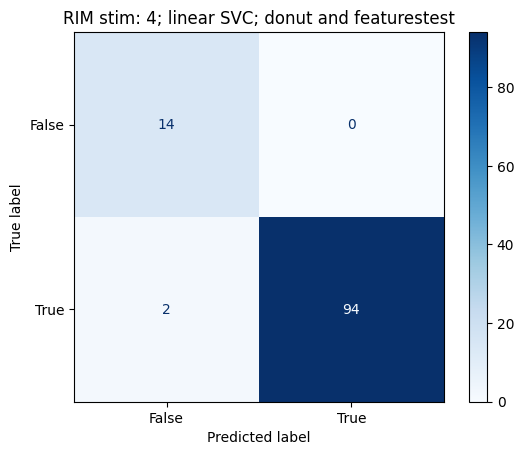

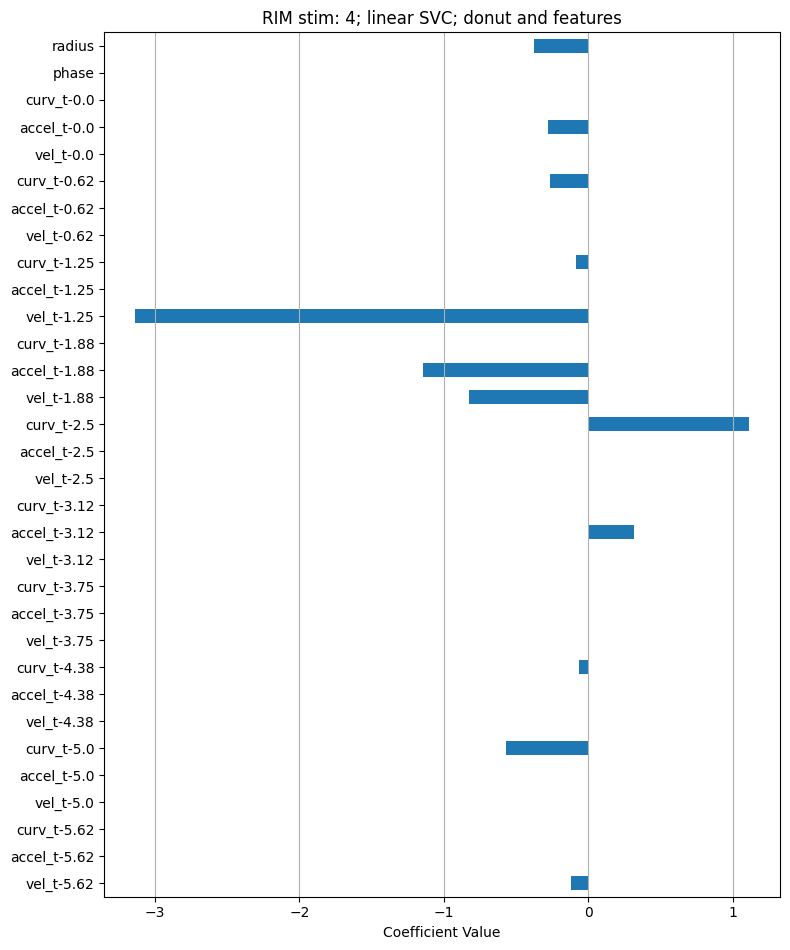

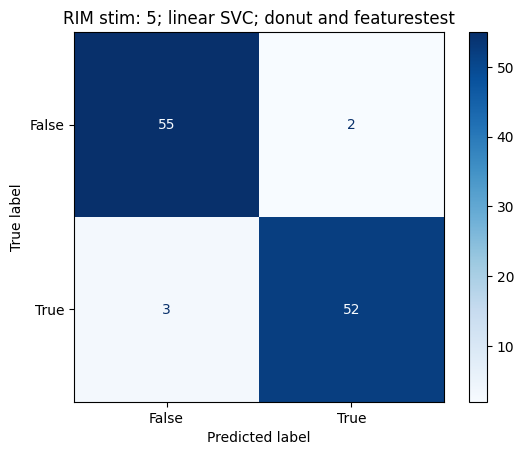

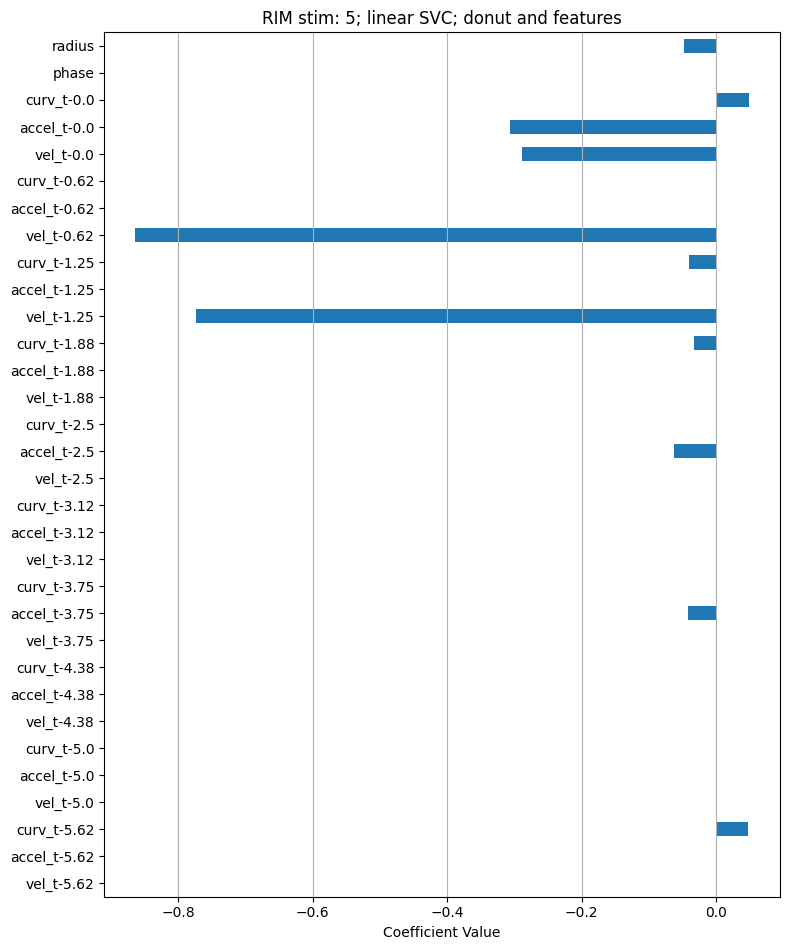

In [ ]:
###########predict prob from features and donut
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import balanced_accuracy_score
from sklearn.linear_model import Lasso
from sklearn.metrics import r2_score
import matplotlib.pyplot as plt
import numpy as np
import copy
import pickle
import matplotlib.cm as cm


import warnings

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    n_tracks = resampled_rev.shape[0]
    n_splits = 10
    results_dict = {}  # Store mean/std r² per i and n_timesteps
    best_models = {}   # Store best model per (i, n_timesteps)
    lstm_lag = 5
    idxs = [[0],[1],[2],[3],[4],[5]]
    fig, ax = plt.subplots()
    for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
        score_means = []
        score_stds = []
        # all_r2_means = []
        all_scores_per_i = {}
        n_timesteps_list = []
        onset = resampled_onset-1

        for n_timesteps in range(1, 15, 3):
        # for n_timesteps in range(1, 15, 1):
            print(f"\nProcessing i={i}, n_timesteps={n_timesteps}")
            print("n_timesteps",n_timesteps)
            # t(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, inferred_phases_all, inferred_rad_all,resampled_onset, n_tracks, z,n_timestepslstm_lag = 5, include_beh = False)
            X_stim_all, feature_names_all =  prep_FB_inputs_feature_and_donut(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, inferred_phases_all, inferred_rad_all,resampled_onset, n_tracks,n_timesteps, z,   lstm_lag = 5)
            Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
            no_rev_at_onset = Y_latency!=0
            Y_prob = np.logical_not(np.isnan(Y_latency[no_rev_at_onset]))# classfy y/n did rev happen
            X_prob = copy.deepcopy(X_stim_all[no_rev_at_onset])
            
            ###    
            # X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=random_state)
            balanced_accuracy_scores = []
            models = []

            for split_idx in range(n_splits):
                # X_train, X_test, y_train, y_test = train_test_split(
                #     X_stim_all_latency, Y_latency_valid, test_size=test_size, random_state=split_idx)
                
                X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=split_idx)
                
                param_grid = {
                    'C': [0.001, 0.01, 0.1, 1, 10, 100]
                }

                model = LinearSVC(penalty='l1', dual=False, max_iter=10000)
                # Grid search
                grid = GridSearchCV(model, param_grid, cv=5, scoring='balanced_accuracy')
                grid.fit(X_train, y_train)
                c = grid.best_params_['C']
                best_model = grid.best_estimator_
                
                y_pred = best_model.predict(X_test)
                score =balanced_accuracy_score(y_test, y_pred)  

                balanced_accuracy_scores.append(score)
                # models.append(best_model)
                models.append((best_model,X_train, X_test, y_train, y_test, c))

            accuracy_mean = np.mean(balanced_accuracy_scores)
            accuracy_std = np.std(balanced_accuracy_scores)
            best_model_idx = np.argmax(balanced_accuracy_scores)
            best_model_overall = models[best_model_idx]

            # Save results
            n_timesteps_list.append(n_timesteps)
            # all_r2_means.append(r2s)
            all_scores_per_i[(i, n_timesteps)] = balanced_accuracy_scores
            score_means.append(accuracy_mean)
            score_stds.append(accuracy_std)
            results_dict[(i, n_timesteps)] = (accuracy_mean, accuracy_std)
            best_models[(i, n_timesteps)] = best_model_overall


        # cmap1 = cm.get_cmap('tab10', len(resampled_onsets))
        ax.errorbar(np.array(n_timesteps_list)/fps, score_means, yerr=score_stds, #color=cmap1(i),
                    fmt='-o', capsize=5, label = f"stim {i}")

        ax.set_title(f"{neuron}; donut and features; Reversal prediction;\n Mean ± STD balanced accuracy")
        ax.set_xlabel("max time delay (frames)")
        ax.set_ylabel("balanced accuracy")
    ax.legend()
    plt.grid(True)
    plt.tight_layout()#
    # plt.savefig(f"r2_plot_i{i}.png")
    # plt.close()
n_timesteps = 10


for i in range(len(resampled_onsets)):
    model,X_train, X_test, y_train, y_test, c  = best_models[(i, n_timesteps)] 
    
    
    X_stim_features, feature_names = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, resampled_onset,   n_timesteps,z, lstm_lag = lstm_lag, include_beh = False, fps = fps)#shape (n_tracks, n_frames, n_features)
    X_donut_stim, donut_names = prep_FB_inputs_donut_only( inferred_phases_all, inferred_rad_all, resampled_onset, n_tracks)
    X_stim_all =  np.concatenate([X_stim_features ,  X_donut_stim], axis = 1)
    feature_names_all = np.array(feature_names.tolist()+donut_names)

    model_label= f"{neuron} stim: {i}; linear SVC; donut and features"#; lasso_a{np.round(alpha,2)}"
    visualize_model_classification(model, model_label, feature_names_all, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False, coeffs = model.coef_[0])#, xlim = [-1,1])
    
plt.show()
    


Processing i=0, n_timesteps=1
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=4
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=7
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=10
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=13
n_timesteps 459
n_timesteps 459

Processing i=1, n_timesteps=1
n_timesteps 459
n_timesteps 459

Processing i=1, n_timesteps=4
n_timesteps 459
n_timesteps 459

Processing i=1, n_timesteps=7
n_timesteps 459
n_timesteps 459

Processing i=1, n_timesteps=10
n_timesteps 459
n_timesteps 459

Processing i=1, n_timesteps=13
n_timesteps 459
n_timesteps 459

Processing i=2, n_timesteps=1
n_timesteps 459
n_timesteps 459

Processing i=2, n_timesteps=4
n_timesteps 459
n_timesteps 459

Processing i=2, n_timesteps=7
n_timesteps 459
n_timesteps 459

Processing i=2, n_timesteps=10
n_timesteps 459
n_timesteps 459

Processing i=2, n_timesteps=13
n_timesteps 459
n_timesteps 459

Processing i=3, n_timesteps=1
n_timesteps 459
n_

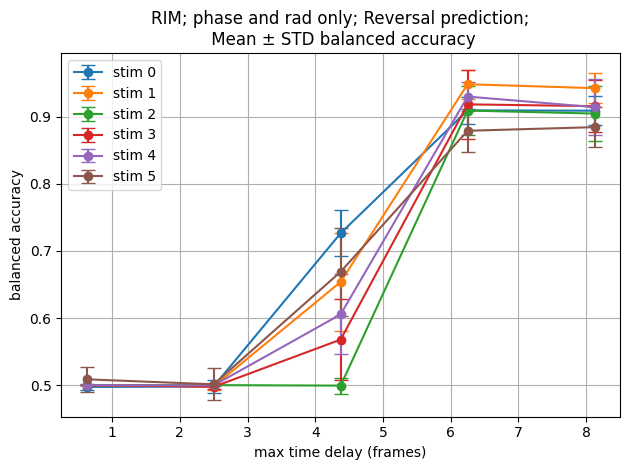

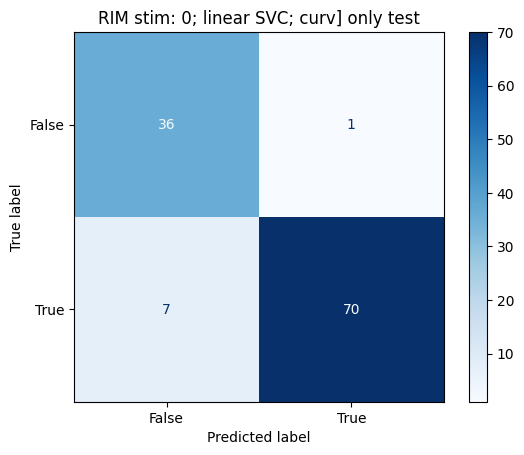

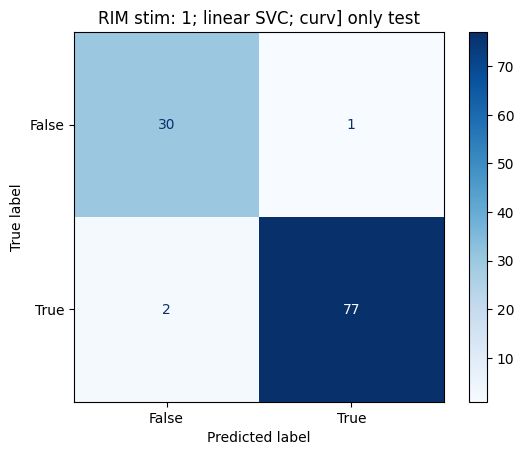

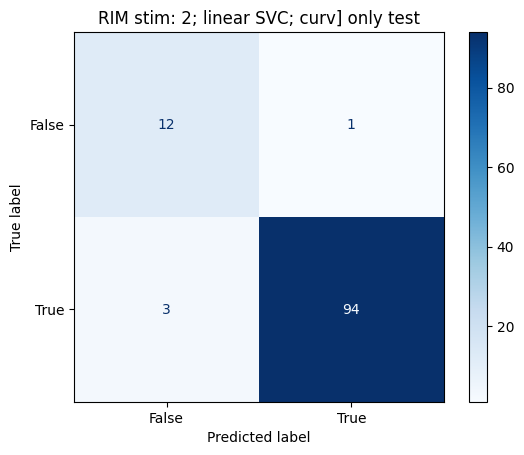

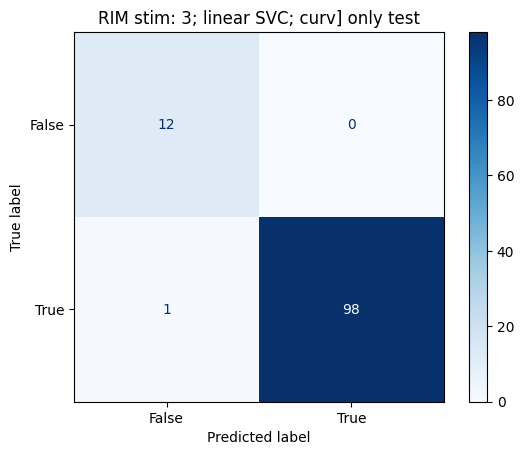

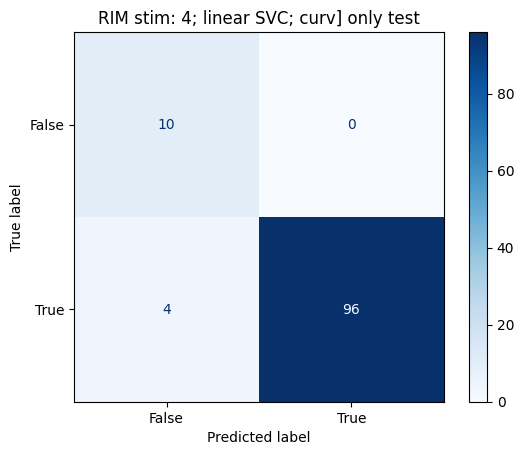

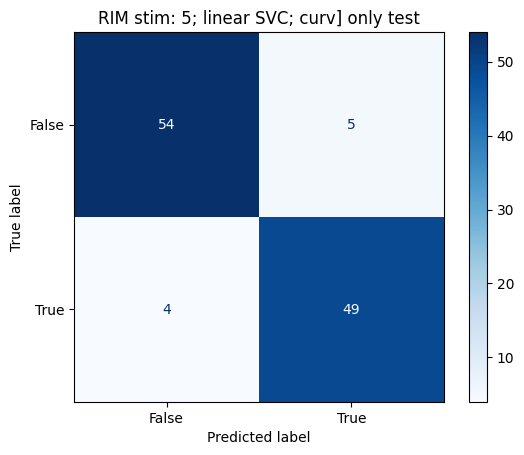

In [ ]:
###############
###############
###predict from time delayed phase resampeld frame rate
################


with warnings.catch_warnings():
        
    # ##get inputs into lstm 
    # beh_map = [z_norm.min(), z_norm.min()/2 + z_norm.max()/2, z_norm.max()]

    warnings.simplefilter("ignore")
    fps = 1.6

    include_beh = False
    n_tracks = resampled_rev.shape[0]
    n_splits = 10
    results_dict = {}  # Store mean/std r² per i and n_timesteps
    best_models = {}   # Store best model per (i, n_timesteps)
    lstm_lag = 5
    idxs = [[0],[1],[2],[3],[4],[5]]
    fig, ax = plt.subplots()
    for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
        score_means = []
        score_stds = []
        # all_r2_means = []
        all_scores_per_i = {}
        n_timesteps_list = []
        onset = resampled_onset-1

        for n_timesteps in range(1, 15, 3):
        # for n_timesteps in range(1, 15, 1):
            print(f"\nProcessing i={i}, n_timesteps={n_timesteps}")

            phase_resampled = feature_all_to_resampled(inferred_phases_all, n_tracks)
            radii_resampled =  feature_all_to_resampled(inferred_rad_all, n_tracks)
            features_list = [phase_resampled, radii_resampled]
            feature_labels = ["phase", "radii"]
            X_stim_all, feature_names_all = prep_FB_inputs_select_features_only(
                # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
                features_list, feature_labels, onset,  n_timesteps, z, lstm_lag = lstm_lag, 
            
                            )
            # print(np.all(X_stim_all1==X_stim_all))
            Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
            no_rev_at_onset = Y_latency!=0
            Y_prob = np.logical_not(np.isnan(Y_latency[no_rev_at_onset]))# classfy y/n did rev happen
            X_prob = copy.deepcopy(X_stim_all[no_rev_at_onset])
            
            ###    
            # X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=random_state)
            balanced_accuracy_scores = []
            models = []

            for split_idx in range(n_splits):
                # X_train, X_test, y_train, y_test = train_test_split(
                #     X_stim_all_latency, Y_latency_valid, test_size=test_size, random_state=split_idx)
                
                X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=split_idx)
                
                param_grid = {
                    'C': [0.001, 0.01, 0.1, 1, 10, 100]
                }

                model = LinearSVC(penalty='l1', dual=False, max_iter=10000)
                # Grid search
                grid = GridSearchCV(model, param_grid, cv=5, scoring='balanced_accuracy')
                grid.fit(X_train, y_train)
                c = grid.best_params_['C']
                best_model = grid.best_estimator_
                
                y_pred = best_model.predict(X_test)
                score =balanced_accuracy_score(y_test, y_pred)  

                balanced_accuracy_scores.append(score)
                # models.append(best_model)
                models.append((best_model,X_train, X_test, y_train, y_test, c))

            accuracy_mean = np.mean(balanced_accuracy_scores)
            accuracy_std = np.std(balanced_accuracy_scores)
            best_model_idx = np.argmax(balanced_accuracy_scores)
            best_model_overall = models[best_model_idx]

            # Save results
            n_timesteps_list.append(n_timesteps)
            # all_r2_means.append(r2s)
            all_scores_per_i[(i, n_timesteps)] = balanced_accuracy_scores
            score_means.append(accuracy_mean)
            score_stds.append(accuracy_std)
            results_dict[(i, n_timesteps)] = (accuracy_mean, accuracy_std)
            best_models[(i, n_timesteps)] = best_model_overall


        # cmap1 = cm.get_cmap('tab10', len(resampled_onsets))
        ax.errorbar(np.array(n_timesteps_list)/fps, score_means, yerr=score_stds, #color=cmap1(i),
                    fmt='-o', capsize=5, label = f"stim {i}")

        ax.set_title(f"{neuron}; phase and rad only; Reversal prediction;\n Mean ± STD balanced accuracy")
        ax.set_xlabel("max time delay (frames)")
        ax.set_ylabel("balanced accuracy")
    ax.legend()
    plt.grid(True)
    plt.tight_layout()
    # plt.savefig(f"r2_plot_i{i}.png")
    # plt.close()

    n_timesteps = 10
    include_beh = False

    feature_names = np.array([[f"phase_t-{np.round((n_timesteps - t - 1)/fps, 2) }", f"rad_t-{np.round((n_timesteps - t - 1)/fps, 2) }"
                       ]
                            for t in range(n_timesteps)]).flatten()
    for i in range(len(resampled_onsets)):
        model,X_train, X_test, y_train, y_test, c  = best_models[(i, n_timesteps)] 

        model_label= f"{neuron} stim: {i}; linear SVC; {feature_lbl}] only "#; lasso_a{np.round(alpha,2)}"
        visualize_model_classification(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False, get_coeff = False, coeffs = model.coef_[0])#, xlim = [-1,1])
        
plt.show()


Processing i=0, n_timesteps=1
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=4
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=7
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=10
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=13
n_timesteps 459
n_timesteps 459

Processing i=1, n_timesteps=1
n_timesteps 459
n_timesteps 459

Processing i=1, n_timesteps=4
n_timesteps 459
n_timesteps 459

Processing i=1, n_timesteps=7
n_timesteps 459
n_timesteps 459

Processing i=1, n_timesteps=10
n_timesteps 459
n_timesteps 459

Processing i=1, n_timesteps=13
n_timesteps 459
n_timesteps 459

Processing i=2, n_timesteps=1
n_timesteps 459
n_timesteps 459

Processing i=2, n_timesteps=4
n_timesteps 459
n_timesteps 459

Processing i=2, n_timesteps=7
n_timesteps 459
n_timesteps 459

Processing i=2, n_timesteps=10
n_timesteps 459
n_timesteps 459

Processing i=2, n_timesteps=13
n_timesteps 459
n_timesteps 459

Processing i=3, n_timesteps=1
n_timesteps 459
n_

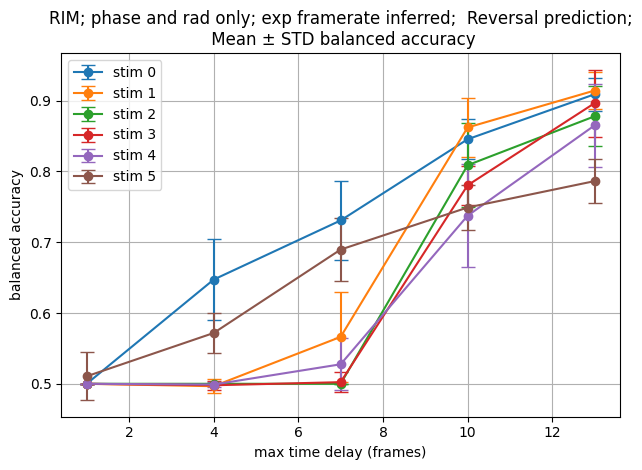

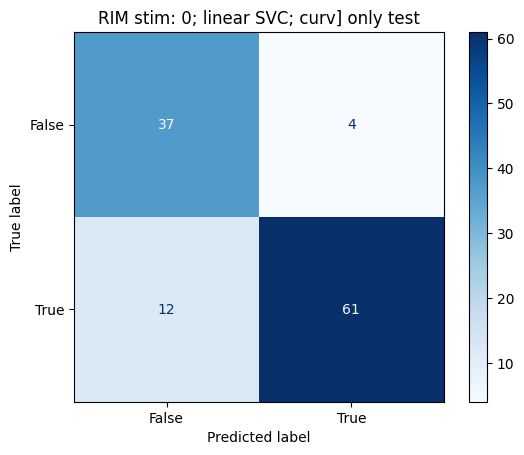

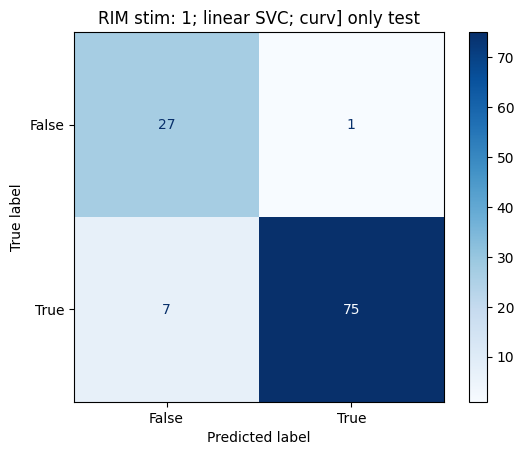

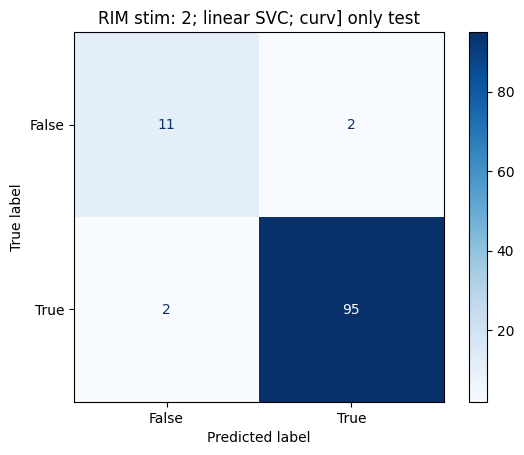

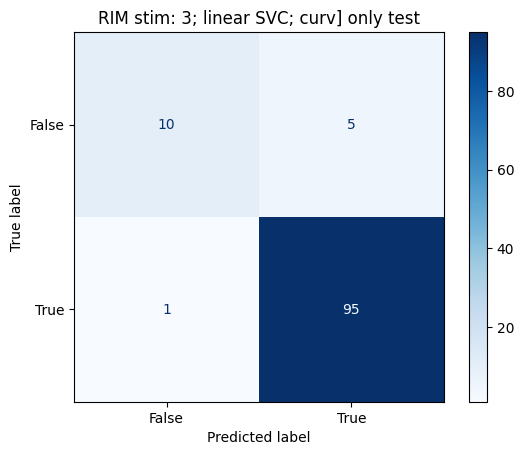

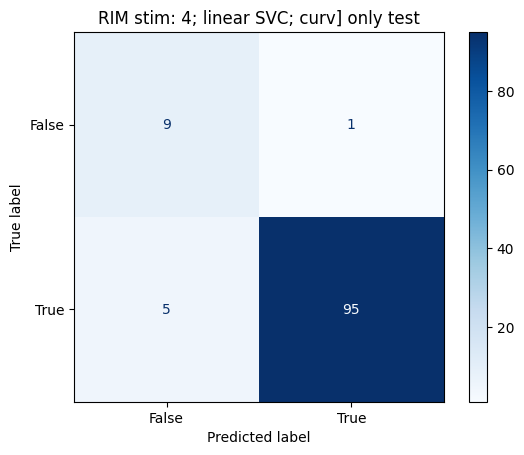

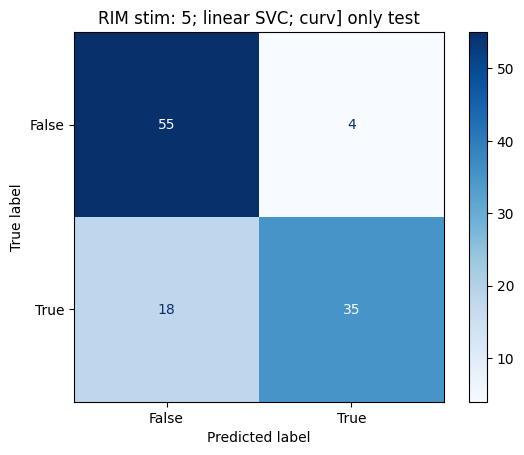

In [ ]:


with warnings.catch_warnings():
    ###############
    ###############
    ###predict from time delayed phase high frame rate
    ################
    fps = 6
    warnings.simplefilter("ignore")
    # print("feature_lbl", feature_lbl)
    include_beh = False
    n_tracks = resampled_rev.shape[0]
    n_splits = 10
    results_dict = {}  # Store mean/std r² per i and n_timesteps
    best_models = {}   # Store best model per (i, n_timesteps)
    lstm_lag = 5
    idxs = [[0],[1],[2],[3],[4],[5]]
    fig, ax = plt.subplots()
    for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
        score_means = []
        score_stds = []
        # all_r2_means = []
        all_scores_per_i = {}
        n_timesteps_list = []
        onset = exp_onset-1

        for n_timesteps in range(1, 15, 3):
        # for n_timesteps in range(1, 15, 1):
            print(f"\nProcessing i={i}, n_timesteps={n_timesteps}")
            phase_resampled = feature_all_to_resampled(inferred_phases_all, n_tracks)
            radii_resampled =  feature_all_to_resampled(inferred_rad_all, n_tracks)
            exp_phase_high_fps = resample_2d(phase_resampled, target_fps=6, original_fps=1.6)
            exp_rad_high_fps = resample_2d(radii_resampled, target_fps=6, original_fps=1.6)
            features_list = [exp_phase_high_fps, exp_rad_high_fps]
            feature_labels = ["phase", "radii"]
            X_stim_all, feature_names_all = prep_FB_inputs_select_features_only(
                # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
                features_list, feature_labels, onset,  n_timesteps, z, lstm_lag = lstm_lag, 
            
                            )
            # print(np.all(X_stim_all1==X_stim_all))
            Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
            no_rev_at_onset = Y_latency!=0
            Y_prob = np.logical_not(np.isnan(Y_latency[no_rev_at_onset]))# classfy y/n did rev happen
            X_prob = copy.deepcopy(X_stim_all[no_rev_at_onset])
            
            ###    
            # X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=random_state)
            balanced_accuracy_scores = []
            models = []

            for split_idx in range(n_splits):
                # X_train, X_test, y_train, y_test = train_test_split(
                #     X_stim_all_latency, Y_latency_valid, test_size=test_size, random_state=split_idx)
                
                X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=split_idx)
                
                param_grid = {
                    'C': [0.001, 0.01, 0.1, 1, 10, 100]
                }

                model = LinearSVC(penalty='l1', dual=False, max_iter=10000)
                # Grid search
                grid = GridSearchCV(model, param_grid, cv=5, scoring='balanced_accuracy')
                grid.fit(X_train, y_train)
                c = grid.best_params_['C']
                best_model = grid.best_estimator_
                
                y_pred = best_model.predict(X_test)
                score =balanced_accuracy_score(y_test, y_pred)  

                balanced_accuracy_scores.append(score)
                # models.append(best_model)
                models.append((best_model,X_train, X_test, y_train, y_test, c))

            accuracy_mean = np.mean(balanced_accuracy_scores)
            accuracy_std = np.std(balanced_accuracy_scores)
            best_model_idx = np.argmax(balanced_accuracy_scores)
            best_model_overall = models[best_model_idx]

            # Save results
            n_timesteps_list.append(n_timesteps)
            # all_r2_means.append(r2s)
            all_scores_per_i[(i, n_timesteps)] = balanced_accuracy_scores
            score_means.append(accuracy_mean)
            score_stds.append(accuracy_std)
            results_dict[(i, n_timesteps)] = (accuracy_mean, accuracy_std)
            best_models[(i, n_timesteps)] = best_model_overall


        # cmap1 = cm.get_cmap('tab10', len(resampled_onsets))
        ax.errorbar(np.array(n_timesteps_list)/fps, score_means, yerr=score_stds, #color=cmap1(i),
                    fmt='-o', capsize=5, label = f"stim {i}")

        ax.set_title(f"{neuron}; phase and rad only; exp framerate inferred;  Reversal prediction;\n Mean ± STD balanced accuracy")
        ax.set_xlabel("max time delay (sec)")
        ax.set_ylabel("balanced accuracy")
    ax.legend()
    plt.grid(True)
    plt.tight_layout()
    # plt.savefig(f"r2_plot_i{i}.png")
    # plt.close()

    n_timesteps = 10
    include_beh = False

    feature_names = np.array([[f"phase_t-{np.round((n_timesteps - t - 1)/fps,2)}", f"rad_t-{np.round((n_timesteps - t - 1)/fps,2)}"
                       ]
                            for t in range(n_timesteps)]).flatten()
    for i in range(len(resampled_onsets)):
        model,X_train, X_test, y_train, y_test, c  = best_models[(i, n_timesteps)] 

        model_label= f"{neuron} stim: {i}; linear SVC; {feature_lbl}] only "#; lasso_a{np.round(alpha,2)}"
        visualize_model_classification(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False, get_coeff = False, coeffs = model.coef_[0])#, xlim = [-1,1])
        
plt.show()

In [ ]:
#############
#####check if can infer phase from interpatlated tim ebetwen revs 
##########

import numpy as np
def event_interpolation_fraction(events):
    """
    Input: 1D np.array with 1 where event occurs, 0 elsewhere.
    Output: 
      - -1 at event indices
      - linearly interpolated fraction of time to next event for other positions
    """
    events = np.asarray(events)
    result = np.full_like(events, np.nan, dtype=float)
    event_idxs = np.where(events == 1)[0]

    if len(event_idxs) == 0:
        return result  # no events, return NaNs

    # # Set -1 where events occur
    # result[event_idxs] = -1.0

    # Loop over event pairs to fill in between
    for i in range(len(event_idxs) - 1):
        start = event_idxs[i]
        end = event_idxs[i + 1]
        gap = end - start
        for j in range(1, gap):
            frac = j / gap  # fraction toward the next event
            result[start + j] = frac

    return result

def get_interpolated_time_since_last_reversal(rev_bin):
    n_frames, n_tracks = rev_bin.shape
    interpolated_fwd_time = np.zeros_like(rev_bin)
    for track in range(n_tracks):
        interpolated_fwd_time[:,track] = event_interpolation_fraction(rev_bin[:,track])
        
    return interpolated_fwd_time

# from 
from sklearn.linear_model import LogisticRegression, Lasso, LinearRegression
from sklearn.model_selection import GridSearchCV, train_test_split
######see if can predict phase from time_since_last_rev 
###need to get phase interpolated or somte 
random_state = 30
test_size = 0.3
interpolated_fwds = get_interpolated_time_since_last_reversal(exp_rev)
n_tracks, n_frames_exp = exp_rev.shape


phase_resampled = feature_all_to_resampled(inferred_phases_all, n_tracks)
exp_phase_high_fps = resample_2d(phase_resampled, target_fps=6, original_fps=1.6)
Y = exp_phase_high_fps.flatten()
X = interpolated_fwds.flatten()

non_nan_is = np.argwhere(np.logical_and(np.logical_not(np.isnan(X)), np.logical_not(np.isnan(Y)))).flatten()
X = X[non_nan_is]
X = X.reshape(-1, 1)
Y = Y[non_nan_is]
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=test_size, random_state=random_state)


alphas = np.logspace(-4, 2, 20)
model_label= f"lasso"
# lasso = Lasso(max_iter=10000)
model = LinearRegression()
model.fit(X_train, y_train)
# grid_search = GridSearchCV(model, {'alpha': alphas}, cv=5, scoring='r2')
# grid_search.fit(X_train, y_train)

# best_model = grid_search.best_estimator_
# y_pred = best_model.predict(X_test)
# r2 = r2_score(y_test, y_pred)
# model = LinearRegression()

n_timesteps = 1
fit_visualize_model_regression(model, model_label, np.array(["interpol"]), X_train, X_test, y_train, y_test, n_timesteps, feature_names_ordered =  np.array(["interpol"]))




Processing i=0, n_timesteps=1
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=2
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=3
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=4
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=5
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=6
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=7
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=8
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=9
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=10
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=11
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=12
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=13
n_timesteps 459
n_timesteps 459

Processing i=0, n_timesteps=14
n_timesteps 459
n_timesteps 459


KeyError: (1, 14)

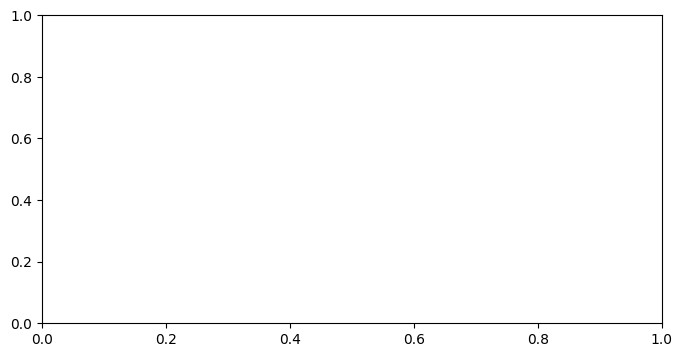

In [ ]:
##########
######get auc (shoudl add balanced accuarcy but wasnt goos)form phase and odontu from single time point
#########

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    n_tracks = resampled_rev.shape[0]
    n_splits = 10
    results_dict = {}  # Store mean/std r² per i and n_timesteps
    best_models = {}   # Store best model per (i, n_timesteps)
    all_scores_per_i = {}
    all_auc_per_i = {}
    lstm_lag = 5
    idxs = [[0],[1],[2],[3],[4],[5]]
    # fig, ax = plt.subplots()
    for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
        score_means = []
        score_stds = []
        # all_r2_means = []

        n_timesteps_list = []
        onset = resampled_onset-1

        
        for n_timesteps in range(1, 15, 4):
            # n_timesteps = 0
            print(f"\nProcessing i={i}, n_timesteps={n_timesteps}")

            # X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps,   lstm_lag = lstm_lag)#shape (n_tracks, n_frames, n_features)
            # X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps,   lstm_lag = lstm_lag)#shape (n_tracks, n_frames, n_features)
            X_stim_all, feature_names_all = prep_FB_inputs_donut_only( inferred_phases_all, inferred_rad_all, onset, n_tracks)
            
            Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
            no_rev_at_onset = Y_latency!=0
            Y_prob = np.logical_not(np.isnan(Y_latency[no_rev_at_onset]))# classfy y/n did rev happen
            X_prob = copy.deepcopy(X_stim_all[no_rev_at_onset])
            
            ###    
            # X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=random_state)
            balanced_accuracy_scores = []
            aucs = []
            models = []

            for split_idx in range(n_splits):
                # X_train, X_test, y_train, y_test = train_test_split(
                #     X_stim_all_latency, Y_latency_valid, test_size=test_size, random_state=split_idx)
                
                X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=split_idx)
                


                best_model = LogisticRegression(penalty='l2', solver='liblinear')
                best_model.fit(X_train, y_train)
                
                y_pred = best_model.predict(X_test)
                score = balanced_accuracy_score(y_test, y_pred)  
                # score = accuracy_score(y_test, y_pred)  

                balanced_accuracy_scores.append(score)
                y_proba = best_model.predict_proba(X_test)[:, 1]
                
                # y_proba = best_model.decision_function(X_test)
                aucs.append(roc_auc_score(y_test, y_proba)  )
                # print("balanced_accuracy_scores", balanced_accuracy_scores)
                # print(aucs)
                # models.append(best_model)
                models.append((best_model,X_train, X_test, y_train, y_test, c))

            accuracy_mean = np.mean(balanced_accuracy_scores)
            accuracy_std = np.std(balanced_accuracy_scores)
            best_model_idx = np.argmax(balanced_accuracy_scores)
            best_model_overall = models[best_model_idx]
            

            # Save results
            n_timesteps_list.append(n_timesteps)
            # all_r2_means.append(r2s)
            all_scores_per_i[(i, n_timesteps)] = balanced_accuracy_scores
            all_auc_per_i[(i, n_timesteps)] = aucs
            score_means.append(accuracy_mean)
            score_stds.append(accuracy_std)
            results_dict[(i, n_timesteps)] = (accuracy_mean, accuracy_std)
            best_models[(i, n_timesteps)] = best_model_overall


            # # cmap1 = cm.get_cmap('tab10', len(resampled_onsets))
            # ax.errorbar(n_timesteps_list, score_means, yerr=score_stds, #color=cmap1(i),
            #             fmt='-o', capsize=5, label = f"stim {i}")


            # ax.set_title(f"{neuron}; donut only; Reversal prediction;\n Mean ± STD balanced accuracy")
            # ax.set_xlabel("max time delay (frames)")
            # ax.set_ylabel("balanced accuracy")
        #
        # ax.legend()
        # n_timesteps = 0
        fig_bar, ax_bar = plt.subplots(figsize=(8, 4))
        x_vals = list(range(len(resampled_onsets)))  # i values
        for i in range(len(resampled_onsets)):
            # Collect bar plot data
            
            # bar_heights = [results_dict[(i, n_timesteps)][0] for i in x_vals]  # mean balanced accuracy
            # bar_errors = [results_dict[(i, n_timesteps)][1] for i in x_vals]  # std 
            bar_heights = [np.mean(all_scores_per_i[(i, n_timesteps)]) for i in x_vals]  # mean balanced accuracy
            bar_errors = [np.std(all_scores_per_i[(i, n_timesteps)]) for i in x_vals]  # std 

        # Create bar plot
            ax_bar.bar(x_vals, bar_heights, yerr=bar_errors, capsize=5, color='skyblue', edgecolor='k')
        ax_bar.set_xticks(x_vals)
        ax_bar.set_xticklabels([f"stim {i}" for i in x_vals])
        ax_bar.set_ylabel("Mean Balanced Accuracy")
        ax_bar.set_title(f"{neuron}; donut only; Reversal prediction\nBar plot of balanced accuracy ± STD")
        ax_bar.set_ylim(0, 1)
        ax_bar.grid(True, axis='y')

        
        
        fig_bar, ax_bar = plt.subplots(figsize=(8, 4))
        x_vals = list(range(len(resampled_onsets)))  # i values
        # Collect bar plot data
        for i in range(len(resampled_onsets)):
        
            bar_heights = [np.mean(all_auc_per_i[(i, n_timesteps)]) for i in x_vals]  # mean balanced accuracy
            bar_errors = [np.std(all_auc_per_i[(i, n_timesteps)]) for i in x_vals]  # std 

            # Create bar plot
            ax_bar.bar(x_vals, bar_heights, yerr=bar_errors, capsize=5, color='skyblue', edgecolor='k')
        ax_bar.set_xticks(x_vals)
        ax_bar.set_xticklabels([f"stim {i}" for i in x_vals])
        ax_bar.set_ylabel("Mean auc")
        ax_bar.set_title(f"{neuron}; {n_timesteps}; donut only; Reversal prediction\nBar plot of auc ± STD")
        ax_bar.set_ylim(0, 1)
        ax_bar.grid(True, axis='y')
        plt.grid(True)
        plt.tight_layout()
        # plt.savefig(f"r2_plot_i{i}.png")
        # plt.close()



# n_timesteps = 0
# # feature_names = np.array([[f"vel_t-{n_timesteps - t - 1}", f"accel_t-{n_timesteps - t - 1}",
# #                             f"curv_t-{n_timesteps - t - 1}", f"beh_t-{n_timesteps - t - 1}"]
# #                             for t in range(n_timesteps)]).flatten()
# for i in range(len(resampled_onsets)):
#     model,X_train, X_test, y_train, y_test, c  = best_models[(i, n_timesteps)] 

#     model_label= f"{neuron} stim: {i}; linear SVC;\ndonut only "#; lasso_a{np.round(alpha,2)}"
#     visualize_model_classification(model, model_label, feature_names_all, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False, coeffs = model.coef_[0])#, xlim = [-1,1])
    
# plt.show()


Processing i=0, n_timesteps=1
Best split R²: -0.000, Mean R²: -0.035 ± 0.040

Processing i=0, n_timesteps=4
Best split R²: 0.213, Mean R²: 0.007 ± 0.202

Processing i=0, n_timesteps=7
Best split R²: 0.690, Mean R²: 0.532 ± 0.105

Processing i=0, n_timesteps=10
Best split R²: 0.827, Mean R²: 0.733 ± 0.076

Processing i=0, n_timesteps=13
Best split R²: 0.828, Mean R²: 0.732 ± 0.075

Processing i=1, n_timesteps=1
Best split R²: -0.000, Mean R²: -0.027 ± 0.033

Processing i=1, n_timesteps=4
Best split R²: 0.193, Mean R²: 0.063 ± 0.082

Processing i=1, n_timesteps=7
Best split R²: 0.504, Mean R²: 0.341 ± 0.137

Processing i=1, n_timesteps=10
Best split R²: 0.590, Mean R²: 0.406 ± 0.156

Processing i=1, n_timesteps=13
Best split R²: 0.602, Mean R²: 0.423 ± 0.158

Processing i=2, n_timesteps=1
Best split R²: 0.030, Mean R²: -0.037 ± 0.067

Processing i=2, n_timesteps=4
Best split R²: 0.097, Mean R²: -0.023 ± 0.117

Processing i=2, n_timesteps=7
Best split R²: 0.525, Mean R²: 0.333 ± 0.094

P

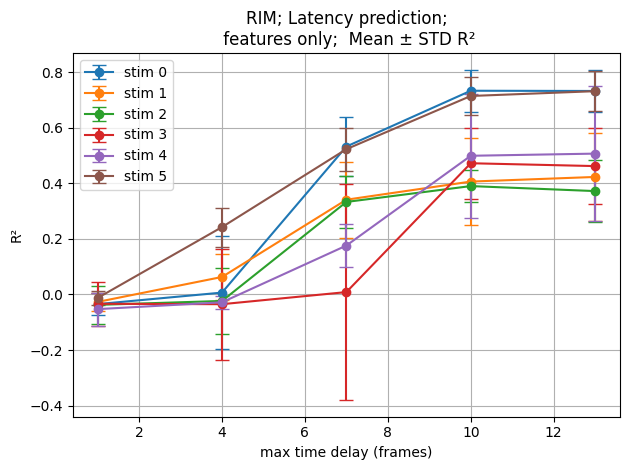

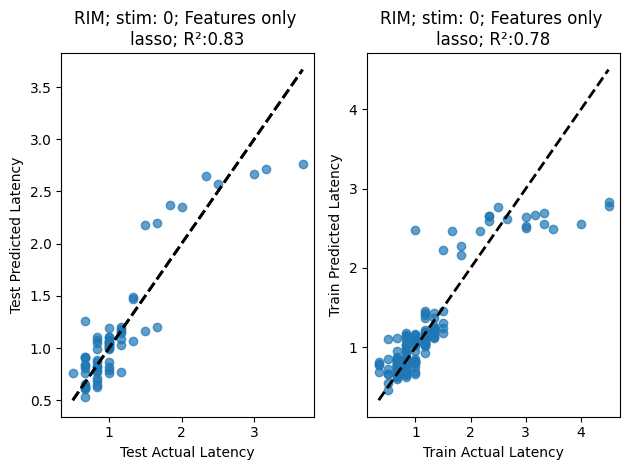

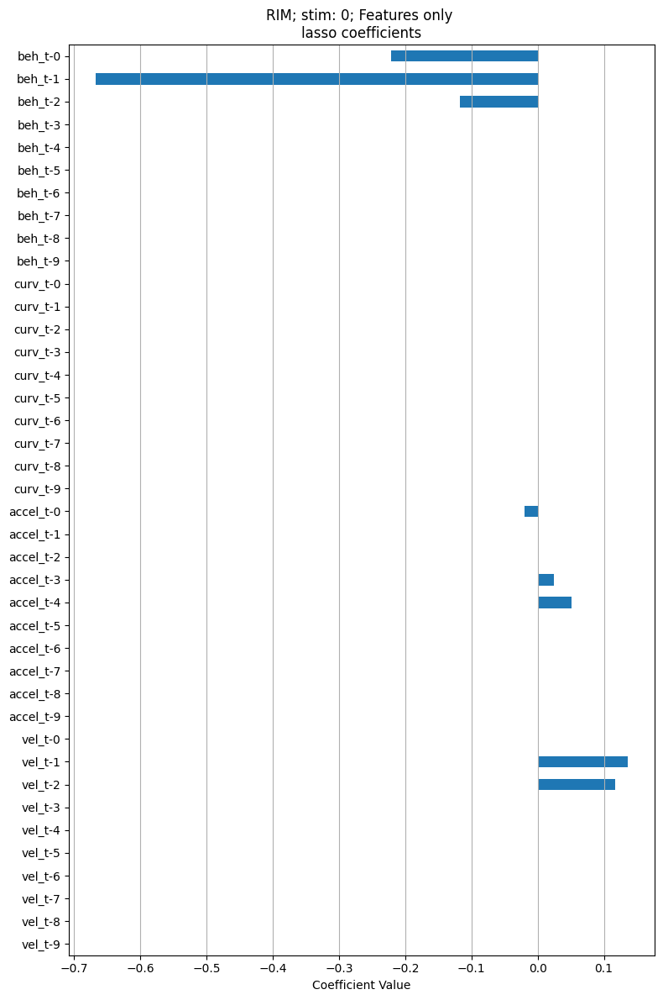

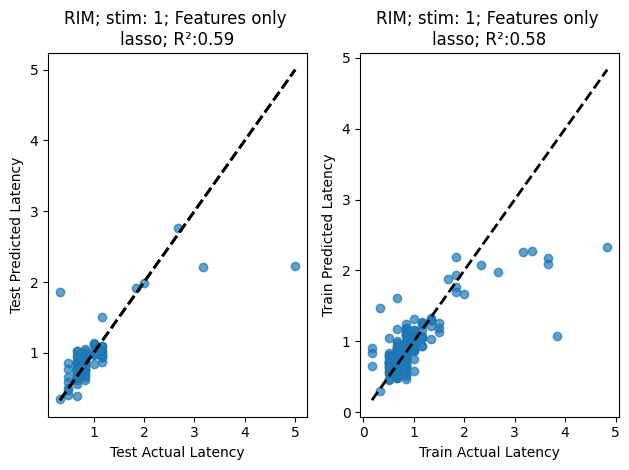

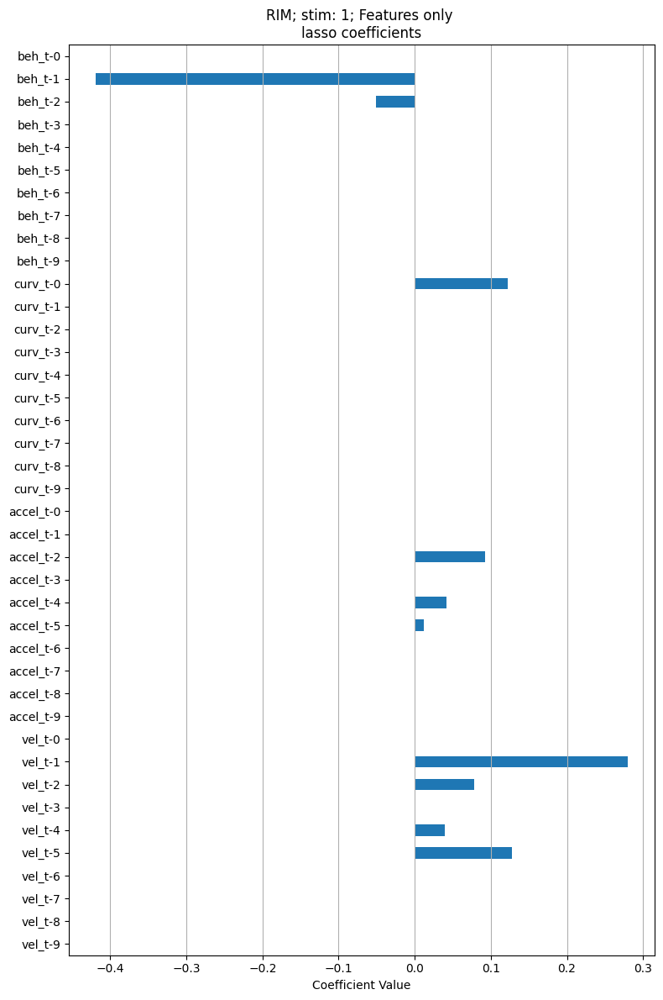

...

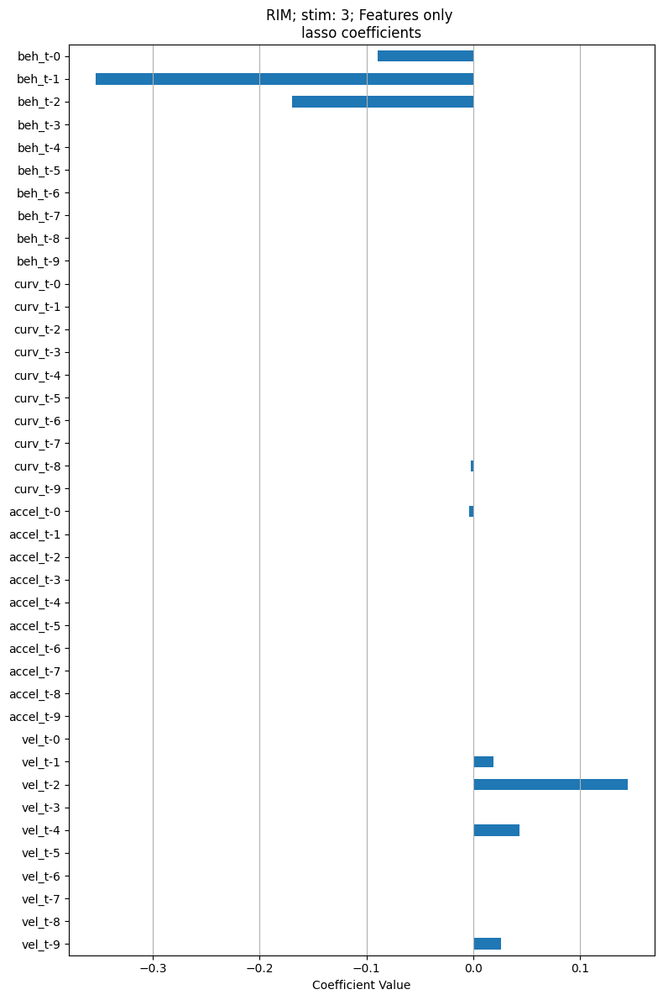

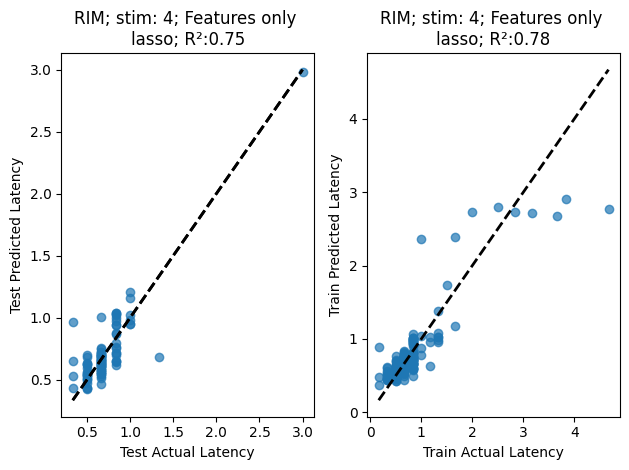

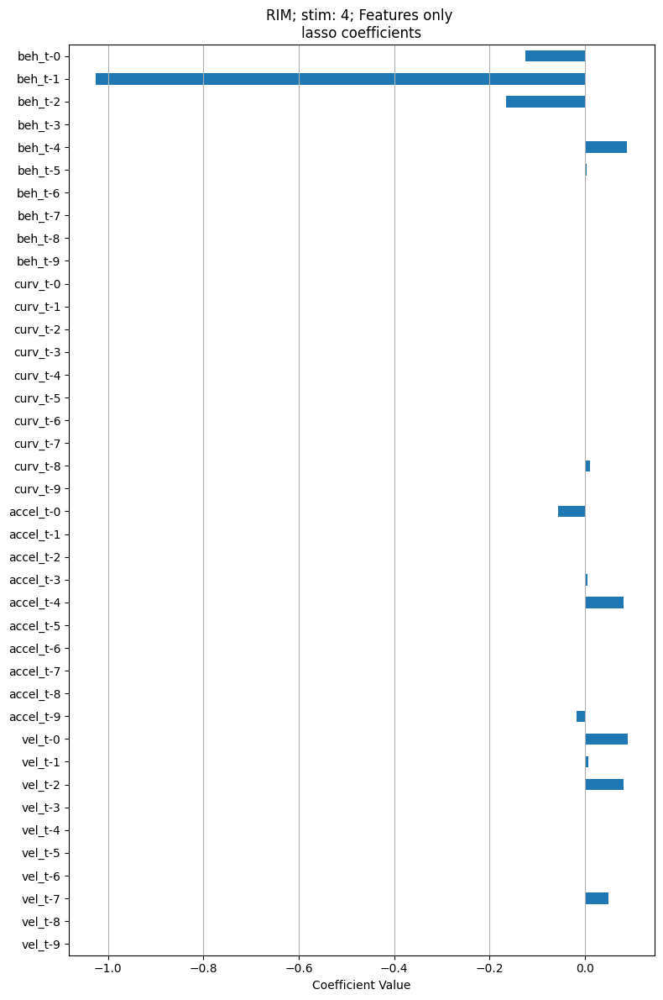

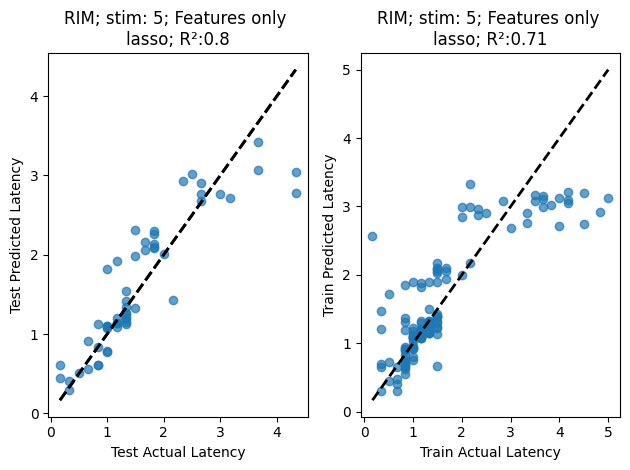

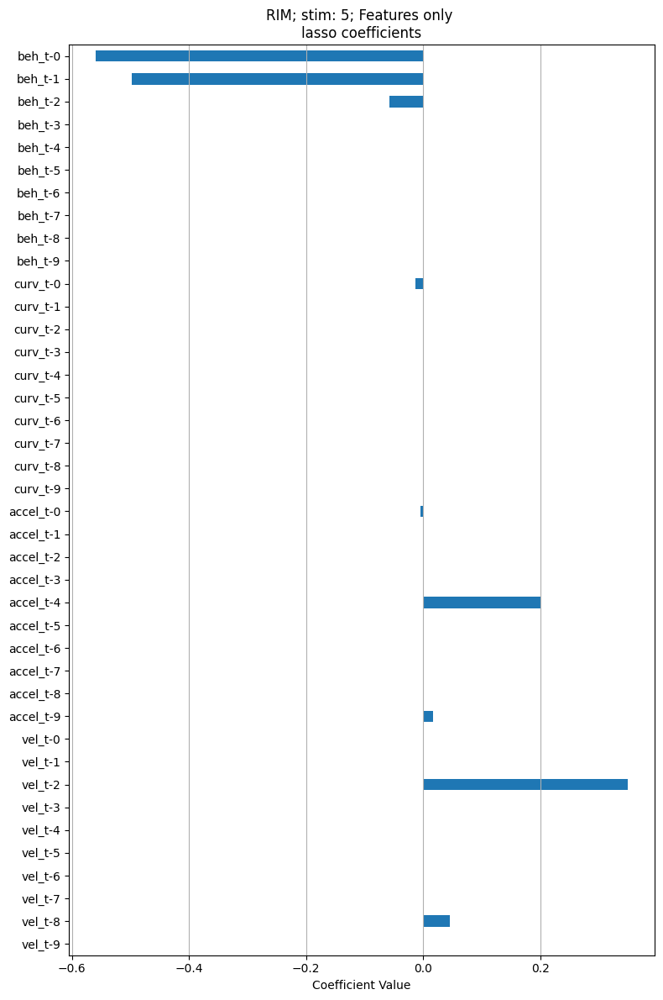

In [ ]:
#########
####predict latency from features only resmpale 
#############

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    n_tracks  = resampled_vel.shape[0]
    # phase_resampled = feature_all_to_resampled(inferred_phases_all)
    # radii_resampled = feature_all_to_resampled(inferred_rad_all) 


    n_splits = 10
    results_dict = {}  # Store mean/std r² per i and n_timesteps
    best_models = {}   # Store best model per (i, n_timesteps)
    T = 5
    lstm_lag = 5
    fps = 1.6
    fig, ax = plt.subplots()
    for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
        r2_means = []
        r2_stds = []
        # all_r2_means = []
        all_r2s_per_i = {}
        n_timesteps_list = []
        onset = resampled_onset-1

        # for n_timesteps in range(5, 10, 2):
        # for n_timesteps in range(1, 15, 1):
        for n_timesteps in range(1, 15, 3):
            print(f"\nProcessing i={i}, n_timesteps={n_timesteps}")
            feature_names = np.array([[f"vel_t-{n_timesteps - t - 1}", f"accel_t-{n_timesteps - t - 1}",
                                    f"curv_t-{n_timesteps - t - 1}", f"beh_t-{n_timesteps - t - 1}"]
                                    for t in range(n_timesteps)]).flatten()

            X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps,  z, lstm_lag = lstm_lag,  include_beh = False)#shape (n_tracks, n_frames, n_features)


            Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency=6 * durations[i] + 1) / 6
            valid_indices = np.argwhere((~np.isnan(Y_latency)) & (Y_latency != 0)).flatten() #non_nan_non_rev_is = np.argwhere(np.logical_and(np.logical_not(np.isnan(Y_latency)), Y_latency!=0)).flatten()
            X_stim_all_latency = X_stim_all[valid_indices]
            Y_latency_valid = Y_latency[valid_indices]

            r2s = []
            models = []

            for split_idx in range(n_splits):
                X_train, X_test, y_train, y_test = train_test_split(
                    X_stim_all_latency, Y_latency_valid, test_size=test_size, random_state=split_idx)

                alphas = np.logspace(-4, 2, 20)
                lasso = Lasso(max_iter=10000)
                grid_search = GridSearchCV(lasso, {'alpha': alphas}, cv=5, scoring='r2')
                grid_search.fit(X_train, y_train)

                best_model = grid_search.best_estimator_
                y_pred = best_model.predict(X_test)
                r2 = r2_score(y_test, y_pred)

                r2s.append(r2)
                # models.append(best_model)
                models.append((best_model,X_train, X_test, y_train, y_test))

            r2_mean = np.mean(r2s)
            r2_std = np.std(r2s)
            best_model_idx = np.argmax(r2s)
            best_model_overall = models[best_model_idx]

            # Save results
            n_timesteps_list.append(n_timesteps)
            # all_r2_means.append(r2s)
            all_r2s_per_i[(i, n_timesteps)] = r2s
            r2_means.append(r2_mean)
            r2_stds.append(r2_std)
            results_dict[(i, n_timesteps)] = (r2_mean, r2_std)
            best_models[(i, n_timesteps)] = best_model_overall

            # # Optional: Save model to disk
            # with open(f"best_model_i{i}_T{n_timesteps}.pkl", "wb") as f:
            #     pickle.dump(best_model_overall, f)

            print(f"Best split R²: {r2s[best_model_idx]:.3f}, Mean R²: {r2_mean:.3f} ± {r2_std:.3f}")


        # cmap1 = cm.get_cmap('tab10', len(resampled_onsets))
        ax.errorbar(np.array(n_timesteps_list)/fps, r2_means, yerr=r2_stds, #color=cmap1(i),
                    fmt='-o', capsize=5, label = f"stim {i}")
        # for x, n_t in enumerate(n_timesteps_list):
        #     r2s = all_r2s_per_i[(i, n_t)]
        #     plt.scatter([n_t]*len(r2s), r2s, color='gray', alpha=0.6, s=30, label='Split R²' if x == 0 else None)
        # for x, n_t in enumerate(n_timesteps_list): # plot jsut max 
        #     r2s = all_r2s_per_i[(i, n_t)]
        #     ax.scatter(n_t, max(r2s), color=cmap1(i), alpha=0.6, s=30, marker='^', facecolors='none', edgecolors=color, label='Split R²' if x == 0 else None)
        ax.set_title(f"{neuron}; Latency prediction;\n features only;  Mean ± STD R²")
        ax.set_xlabel("max time delay (sec)")
        ax.set_ylabel("R²")
    ax.legend()
    plt.grid(True)
    plt.tight_layout()
    # plt.savefig(f"r2_plot_i{i}.png")
    # plt.close()



        
        
    n_timesteps = 10
    feature_names = np.array([[f"vel_t-{np.round((n_timesteps - t - 1)/fps,2)}", f"accel_t-{np.round((n_timesteps - t - 1)/fps,2)}",
                                f"curv_t-{np.round((n_timesteps - t - 1)/fps,2)}"]
                                for t in range(n_timesteps)]).flatten()
    for i in range(len(resampled_onsets)):
        model,X_train, X_test, y_train, y_test = best_models[(i, n_timesteps)] 
        
        # print("Best alpha lasso:", grid_search_lasso.best_params_['alpha'])
        # print("Best CV R²:", grid_search_lasso.best_score_)
        # alpha = grid_search_lasso.best_params_['alpha']
        # model = Lasso(alpha=alpha)  # You can tune alpha with CV
        model_label= f"{neuron}; stim: {i}; Features only \nlasso"#_a{np.round(alpha,2)}"#; lasso_a{np.round(alpha,2)}"
        visualize_model_regression(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = True)#, xlim = [-2,1])



Processing i=0, n_timesteps=1
n_timesteps 459
n_timesteps 459
Best split R²: 0.190, Mean R²: 0.034 ± 0.076

Processing i=0, n_timesteps=4
n_timesteps 459
n_timesteps 459
Best split R²: 0.433, Mean R²: 0.321 ± 0.087

Processing i=0, n_timesteps=7
n_timesteps 459
n_timesteps 459
Best split R²: 0.684, Mean R²: 0.557 ± 0.079

Processing i=0, n_timesteps=10
n_timesteps 459
n_timesteps 459
Best split R²: 0.828, Mean R²: 0.743 ± 0.068

Processing i=0, n_timesteps=13
n_timesteps 459
n_timesteps 459
Best split R²: 0.828, Mean R²: 0.740 ± 0.067

Processing i=1, n_timesteps=1
n_timesteps 459
n_timesteps 459
Best split R²: 0.189, Mean R²: 0.097 ± 0.045

Processing i=1, n_timesteps=4
n_timesteps 459
n_timesteps 459
Best split R²: 0.270, Mean R²: 0.197 ± 0.063

Processing i=1, n_timesteps=7
n_timesteps 459
n_timesteps 459
Best split R²: 0.469, Mean R²: 0.332 ± 0.068

Processing i=1, n_timesteps=10
n_timesteps 459
n_timesteps 459
Best split R²: 0.592, Mean R²: 0.396 ± 0.163

Processing i=1, n_timest

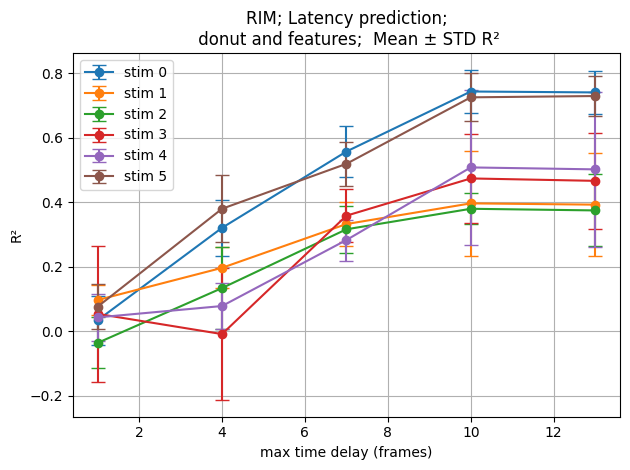

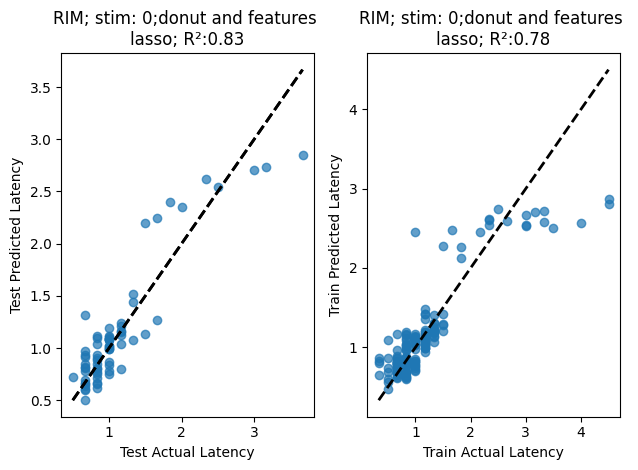

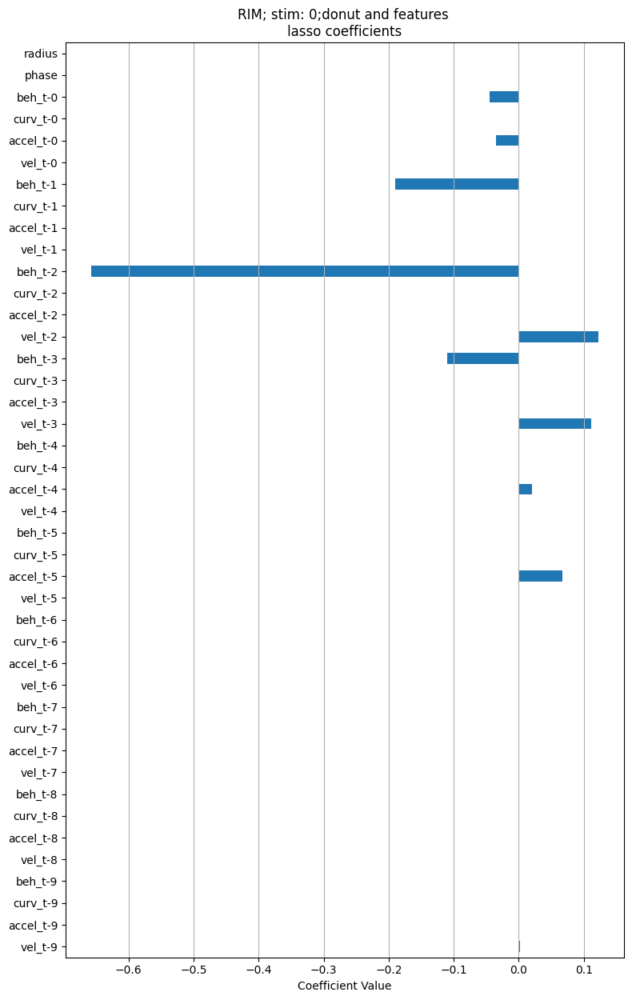

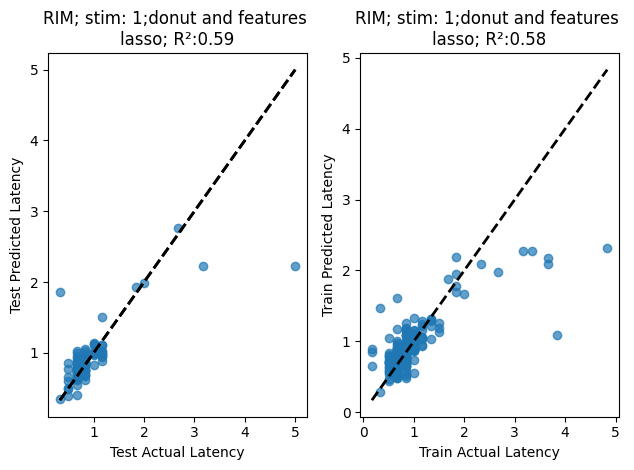

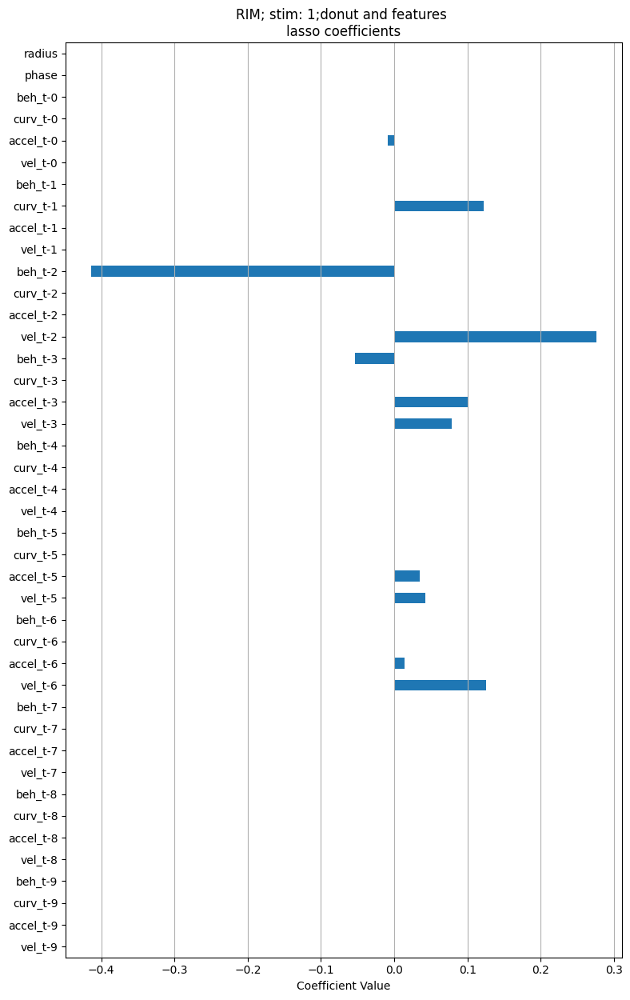

...

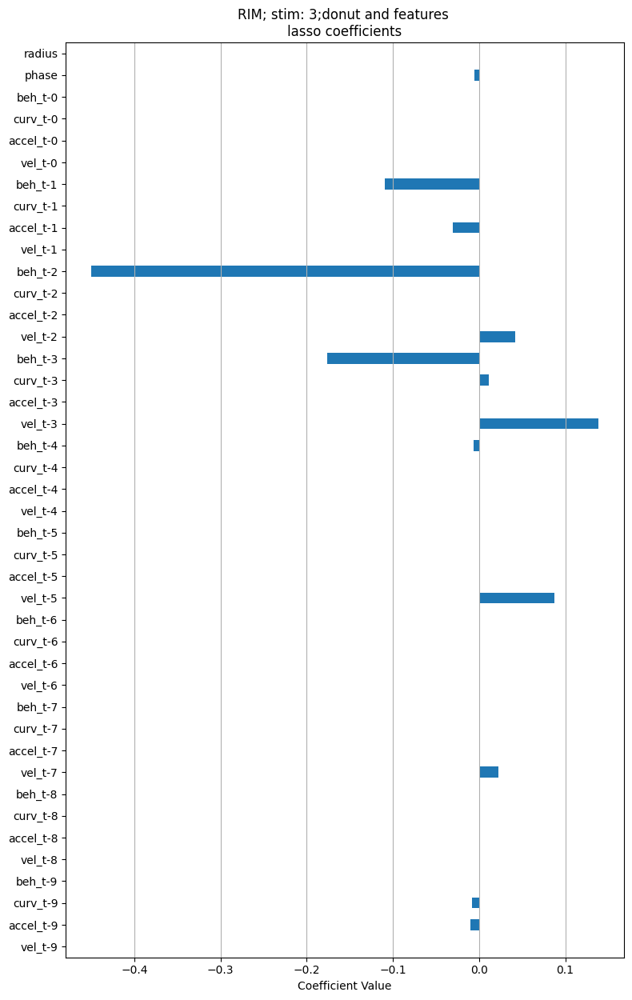

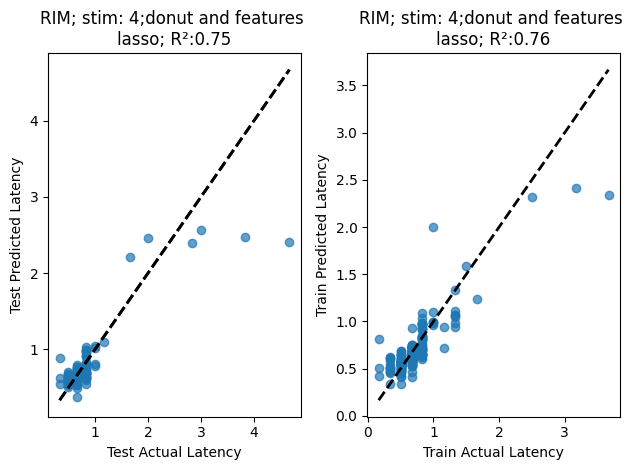

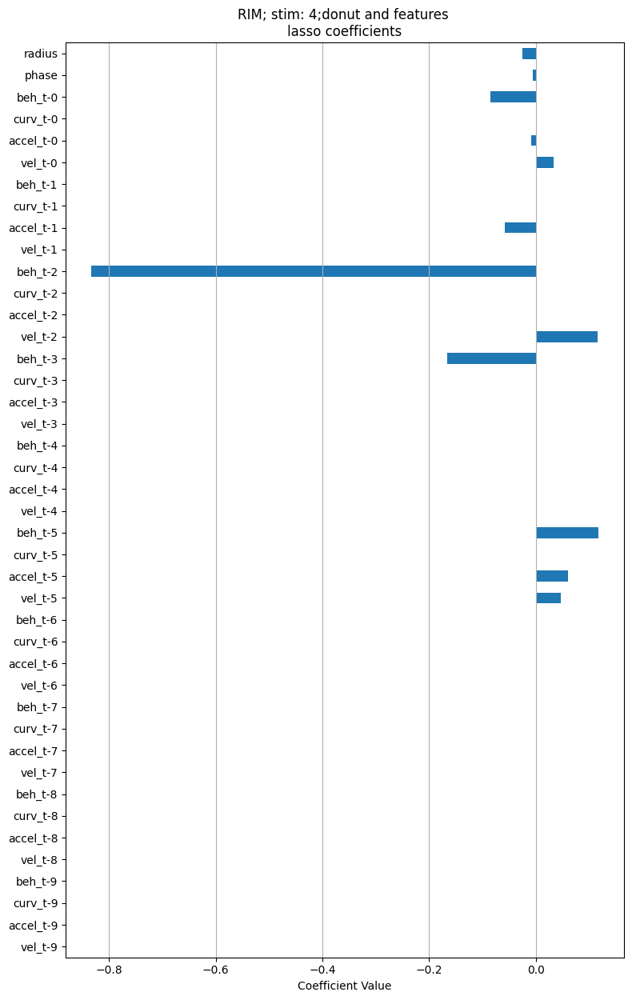

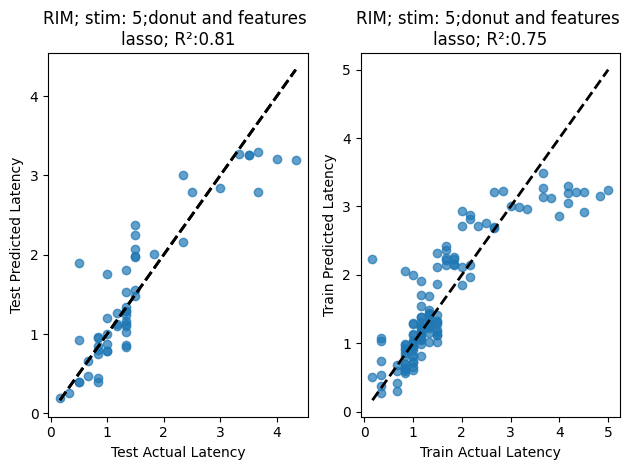

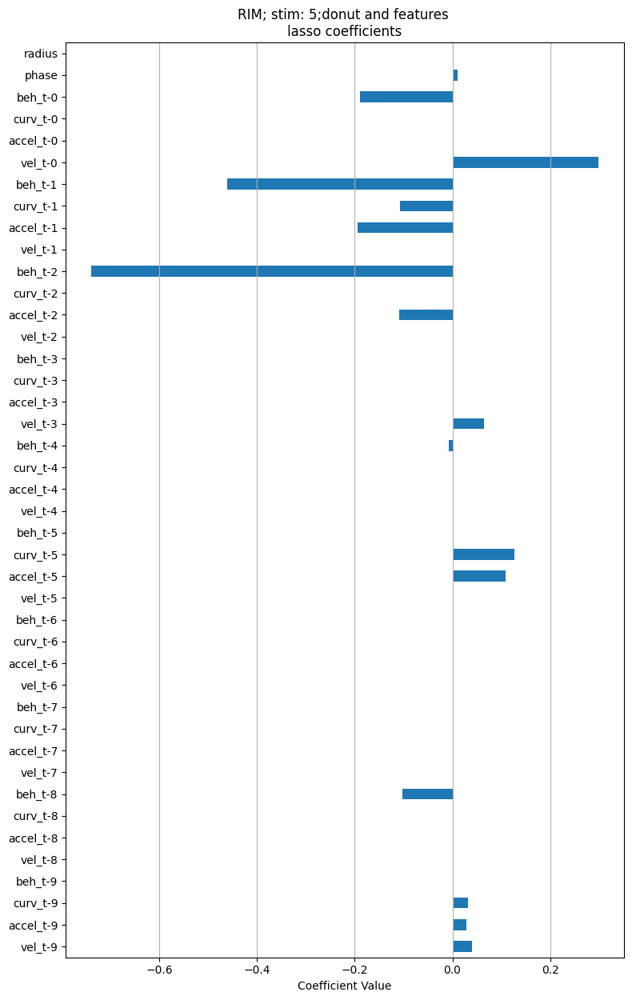

In [ ]:
############donut and features resampled fps 
from predict_latency_prob_from_features_donut_4 import prep_FB_inputs_features_only, prep_FB_inputs_feature_and_donut
with warnings.catch_warnings():
    fps = 1.6
    warnings.simplefilter("ignore")
    n_tracks  = resampled_vel.shape[0]
    # phase_resampled = feature_all_to_resampled(inferred_phases_all)
    # radii_resampled = feature_all_to_resampled(inferred_rad_all) 


    n_splits = 10
    results_dict = {}  # Store mean/std r² per i and n_timesteps
    best_models = {}   # Store best model per (i, n_timesteps)
    T = 5
    lstm_lag = 5
    fig, ax = plt.subplots()
    for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
        r2_means = []
        r2_stds = []
        # all_r2_means = []
        all_r2s_per_i = {}
        n_timesteps_list = []
        onset = resampled_onset-1

        # for n_timesteps in range(5, 10, 2):
        # for n_timesteps in range(1, 15, 1):
        for n_timesteps in range(1, 15, 3):
            print(f"\nProcessing i={i}, n_timesteps={n_timesteps}")
            feature_names = np.array([[f"vel_t-{n_timesteps - t - 1}", f"accel_t-{n_timesteps - t - 1}",
                                    f"curv_t-{n_timesteps - t - 1}", f"beh_t-{n_timesteps - t - 1}"]
                                    for t in range(n_timesteps)]).flatten()


            # X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps,   lstm_lag = lstm_lag)#shape (n_tracks, n_frames, n_features)
            X_stim_all, feature_names_all =  prep_FB_inputs_feature_and_donut(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, inferred_phases_all, inferred_rad_all,resampled_onset, n_tracks,   n_timesteps, z, lstm_lag = 5)

            Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency=6 * durations[i] + 1) / 6
            valid_indices = np.argwhere((~np.isnan(Y_latency)) & (Y_latency != 0)).flatten() #non_nan_non_rev_is = np.argwhere(np.logical_and(np.logical_not(np.isnan(Y_latency)), Y_latency!=0)).flatten()
            X_stim_all_latency = X_stim_all[valid_indices]
            Y_latency_valid = Y_latency[valid_indices]

            r2s = []
            models = []

            for split_idx in range(n_splits):
                X_train, X_test, y_train, y_test = train_test_split(
                    X_stim_all_latency, Y_latency_valid, test_size=test_size, random_state=split_idx)

                alphas = np.logspace(-4, 2, 20)
                lasso = Lasso(max_iter=10000)
                grid_search = GridSearchCV(lasso, {'alpha': alphas}, cv=5, scoring='r2')
                grid_search.fit(X_train, y_train)

                best_model = grid_search.best_estimator_
                y_pred = best_model.predict(X_test)
                r2 = r2_score(y_test, y_pred)

                r2s.append(r2)
                # models.append(best_model)
                models.append((best_model,X_train, X_test, y_train, y_test))

            r2_mean = np.mean(r2s)
            r2_std = np.std(r2s)
            best_model_idx = np.argmax(r2s)
            best_model_overall = models[best_model_idx]

            # Save results
            n_timesteps_list.append(n_timesteps)
            # all_r2_means.append(r2s)
            all_r2s_per_i[(i, n_timesteps)] = r2s
            r2_means.append(r2_mean)
            r2_stds.append(r2_std)
            results_dict[(i, n_timesteps)] = (r2_mean, r2_std)
            best_models[(i, n_timesteps)] = best_model_overall

            # # Optional: Save model to disk
            # with open(f"best_model_i{i}_T{n_timesteps}.pkl", "wb") as f:
            #     pickle.dump(best_model_overall, f)

            print(f"Best split R²: {r2s[best_model_idx]:.3f}, Mean R²: {r2_mean:.3f} ± {r2_std:.3f}")


        # cmap1 = cm.get_cmap('tab10', len(resampled_onsets))
        ax.errorbar(np.array(n_timesteps_list)/fps, r2_means, yerr=r2_stds, #color=cmap1(i),
                    fmt='-o', capsize=5, label = f"stim {i}")
        # for x, n_t in enumerate(n_timesteps_list):
        #     r2s = all_r2s_per_i[(i, n_t)]
        #     plt.scatter([n_t]*len(r2s), r2s, color='gray', alpha=0.6, s=30, label='Split R²' if x == 0 else None)
        # for x, n_t in enumerate(n_timesteps_list): # plot jsut max 
        #     r2s = all_r2s_per_i[(i, n_t)]
        #     ax.scatter(n_t, max(r2s), color=cmap1(i), alpha=0.6, s=30, marker='^', facecolors='none', edgecolors=color, label='Split R²' if x == 0 else None)
        ax.set_title(f"{neuron}; Latency prediction;\n donut and features;  Mean ± STD R²")
        ax.set_xlabel("max time delay (frames)")
        ax.set_ylabel("R²")
    ax.legend()
    plt.grid(True)
    plt.tight_layout()
    # plt.savefig(f"r2_plot_i{i}.png")
    # plt.close()



        
        
    n_timesteps = 10
    # feature_names = np.array([[f"vel_t-{n_timesteps - t - 1}", f"accel_t-{n_timesteps - t - 1}",
    #                             f"curv_t-{n_timesteps - t - 1}", f"beh_t-{n_timesteps - t - 1}"]
    #                             for t in range(n_timesteps)]).flatten()
    for i in range(len(resampled_onsets)):
        model,X_train, X_test, y_train, y_test = best_models[(i, n_timesteps)] 
        
        # print("Best alpha lasso:", grid_search_lasso.best_params_['alpha'])
        # print("Best CV R²:", grid_search_lasso.best_score_)
        # alpha = grid_search_lasso.best_params_['alpha']
        # model = Lasso(alpha=alpha)  # You can tune alpha with CV
        X_stim_features, feature_names = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, resampled_onset,   n_timesteps, z,  lstm_lag = lstm_lag, fps = fps)#shape (n_tracks, n_frames, n_features)
        X_donut_stim, donut_names = prep_FB_inputs_donut_only( inferred_phases_all, inferred_rad_all, resampled_onset, n_tracks)
        X_stim_all =  np.concatenate([X_stim_features ,  X_donut_stim], axis = 1)
        feature_names_all = np.array(feature_names.tolist()+donut_names)
        model_label= f"{neuron}; stim: {i};donut and features \nlasso"#_a{np.round(alpha,2)}"#; lasso_a{np.round(alpha,2)}"
        visualize_model_regression(model, model_label, feature_names_all, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False)#, xlim = [-2,1])



Processing i=0, n_timesteps=0
n_timesteps 459
n_timesteps 459
Best split R²: 0.138, Mean R²: 0.024 ± 0.057

Processing i=1, n_timesteps=0
n_timesteps 459
n_timesteps 459
Best split R²: 0.021, Mean R²: -0.020 ± 0.035

Processing i=2, n_timesteps=0
n_timesteps 459
n_timesteps 459
Best split R²: 0.038, Mean R²: -0.014 ± 0.044

Processing i=3, n_timesteps=0
n_timesteps 459
n_timesteps 459
Best split R²: 0.057, Mean R²: 0.023 ± 0.020

Processing i=4, n_timesteps=0
n_timesteps 459
n_timesteps 459
Best split R²: -0.001, Mean R²: -0.047 ± 0.060

Processing i=5, n_timesteps=0
n_timesteps 459
n_timesteps 459
Best split R²: 0.013, Mean R²: -0.015 ± 0.016


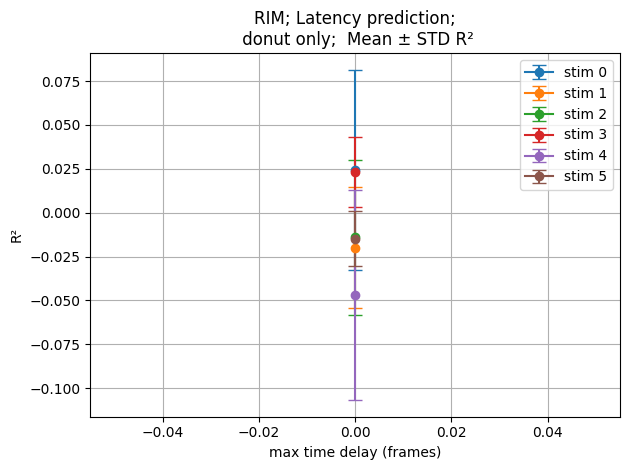

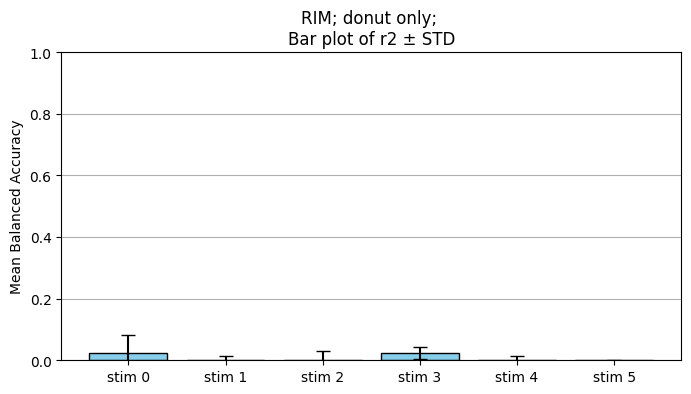

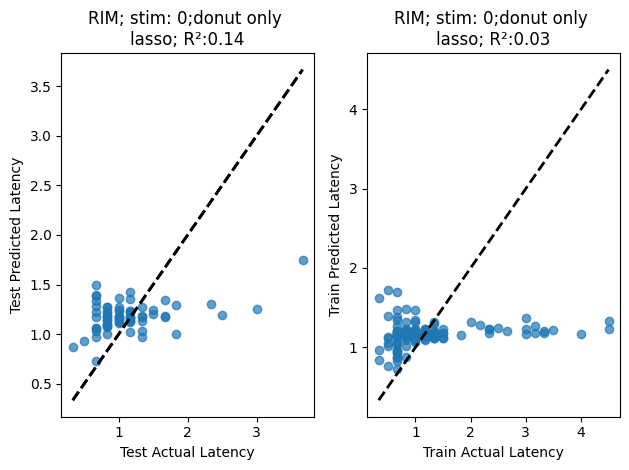

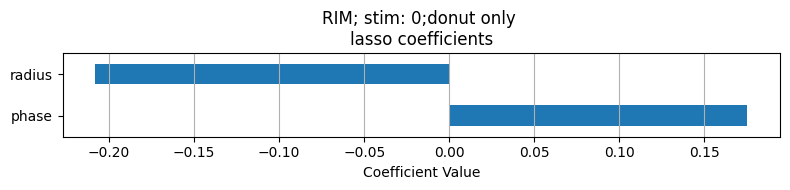

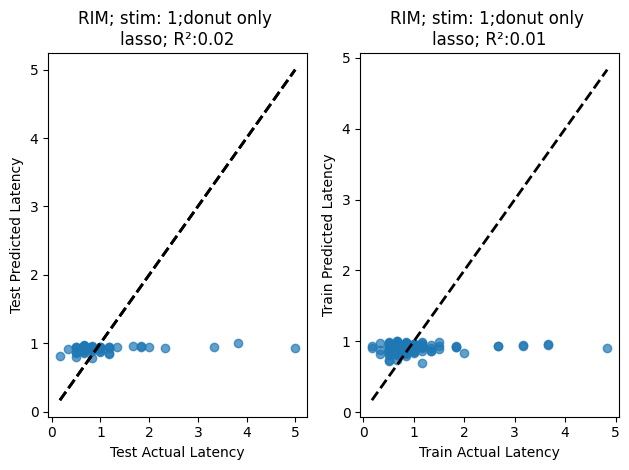

...

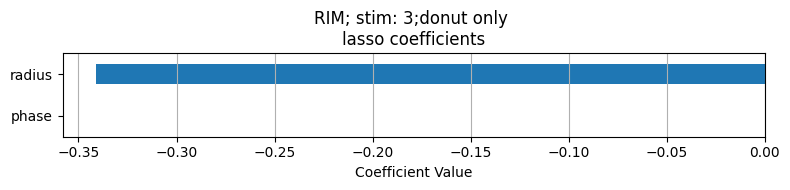

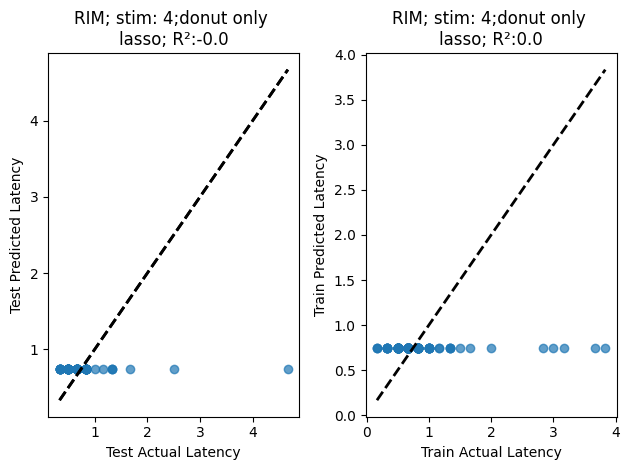

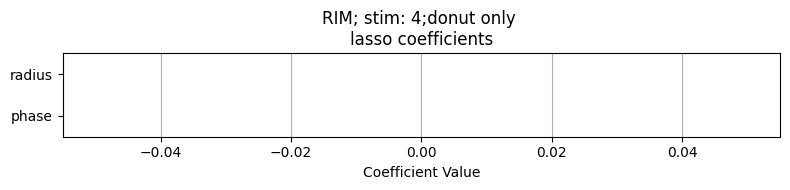

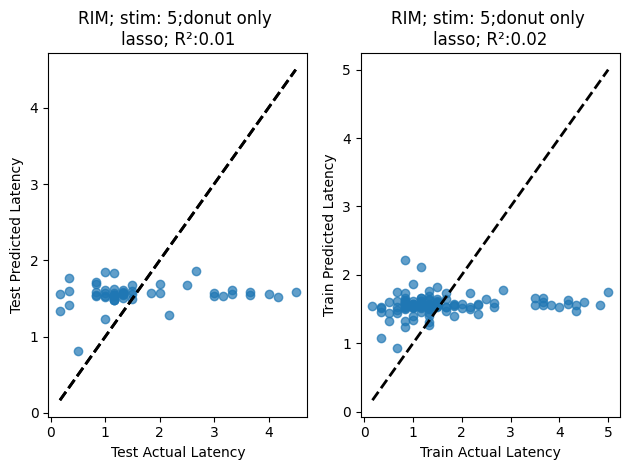

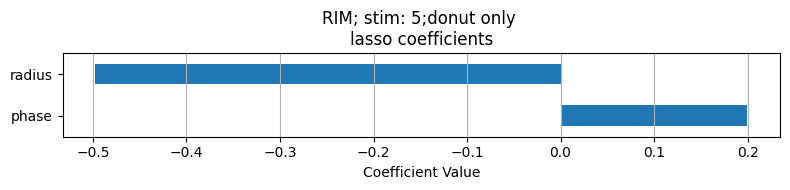

In [ ]:
#####get latency contribution donut only 
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    n_tracks  = resampled_vel.shape[0]
    n_splits = 10
    results_dict = {}  # Store mean/std r² per i and n_timesteps
    best_models = {}   # Store best model per (i, n_timesteps)
    T = 5
    lstm_lag = 5
    fig, ax = plt.subplots()
    for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
        r2_means = []
        r2_stds = []
        # all_r2_means = []
        all_r2s_per_i = {}
        n_timesteps_list = []
        onset = resampled_onset-1

        # for n_timesteps in range(5, 10, 2):
        # for n_timesteps in range(1, 15, 1):
        # for n_timesteps in range(1, 15, 3):
        n_timesteps = 0
        print(f"\nProcessing i={i}, n_timesteps={n_timesteps}")
        feature_names = np.array([[f"vel_t-{n_timesteps - t - 1}", f"accel_t-{n_timesteps - t - 1}",
                                f"curv_t-{n_timesteps - t - 1}", f"beh_t-{n_timesteps - t - 1}"]
                                for t in range(n_timesteps)]).flatten()


        # X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps,   lstm_lag = lstm_lag)#shape (n_tracks, n_frames, n_features)
        # X_stim_all, feature_names_all =  prep_FB_inputs_feature_and_donut(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, inferred_phases_all, inferred_rad_all,resampled_onset, n_tracks,   n_timesteps, lstm_lag = 5)
        X_stim_all, feature_names_all = prep_FB_inputs_donut_only( inferred_phases_all, inferred_rad_all, onset, n_tracks)

        Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency=6 * durations[i] + 1) / 6
        valid_indices = np.argwhere((~np.isnan(Y_latency)) & (Y_latency != 0)).flatten() #non_nan_non_rev_is = np.argwhere(np.logical_and(np.logical_not(np.isnan(Y_latency)), Y_latency!=0)).flatten()
        X_stim_all_latency = X_stim_all[valid_indices]
        Y_latency_valid = Y_latency[valid_indices]

        r2s = []
        models = []

        for split_idx in range(n_splits):
            X_train, X_test, y_train, y_test = train_test_split(
                X_stim_all_latency, Y_latency_valid, test_size=test_size, random_state=split_idx)

            alphas = np.logspace(-4, 2, 20)
            lasso = Lasso(max_iter=10000)
            grid_search = GridSearchCV(lasso, {'alpha': alphas}, cv=5, scoring='r2')
            grid_search.fit(X_train, y_train)

            best_model = grid_search.best_estimator_
            y_pred = best_model.predict(X_test)
            r2 = r2_score(y_test, y_pred)

            r2s.append(r2)
            # models.append(best_model)
            models.append((best_model,X_train, X_test, y_train, y_test))

        r2_mean = np.mean(r2s)
        r2_std = np.std(r2s)
        best_model_idx = np.argmax(r2s)
        best_model_overall = models[best_model_idx]

        # Save results
        n_timesteps_list.append(n_timesteps)
        # all_r2_means.append(r2s)
        all_r2s_per_i[(i, n_timesteps)] = r2s
        r2_means.append(r2_mean)
        r2_stds.append(r2_std)
        results_dict[(i, n_timesteps)] = (r2_mean, r2_std)
        best_models[(i, n_timesteps)] = best_model_overall

        # # Optional: Save model to disk
        # with open(f"best_model_i{i}_T{n_timesteps}.pkl", "wb") as f:
        #     pickle.dump(best_model_overall, f)

        print(f"Best split R²: {r2s[best_model_idx]:.3f}, Mean R²: {r2_mean:.3f} ± {r2_std:.3f}")


        # cmap1 = cm.get_cmap('tab10', len(resampled_onsets))
        ax.errorbar(n_timesteps_list, r2_means, yerr=r2_stds, #color=cmap1(i),
                    fmt='-o', capsize=5, label = f"stim {i}")
        # for x, n_t in enumerate(n_timesteps_list):
        #     r2s = all_r2s_per_i[(i, n_t)]
        #     plt.scatter([n_t]*len(r2s), r2s, color='gray', alpha=0.6, s=30, label='Split R²' if x == 0 else None)
        # for x, n_t in enumerate(n_timesteps_list): # plot jsut max 
        #     r2s = all_r2s_per_i[(i, n_t)]
        #     ax.scatter(n_t, max(r2s), color=cmap1(i), alpha=0.6, s=30, marker='^', facecolors='none', edgecolors=color, label='Split R²' if x == 0 else None)
        ax.set_title(f"{neuron}; Latency prediction;\n donut only;  Mean ± STD R²")
        ax.set_xlabel("max time delay (frames)")
        ax.set_ylabel("R²")
        
    ax.legend()
    plt.grid(True)
    plt.tight_layout()
    # plt.savefig(f"r2_plot_i{i}.png")
    # plt.close()
    
            
    fig_bar, ax_bar = plt.subplots(figsize=(8, 4))
    # Collect bar plot data
    x_vals = list(range(len(resampled_onsets)))  # i values
    bar_heights = [results_dict[(i, 0)][0] for i in x_vals]  # mean balanced accuracy
    bar_errors = [results_dict[(i, 0)][1] for i in x_vals]  # std 

    # Create bar plot
    ax_bar.bar(x_vals, bar_heights, yerr=bar_errors, capsize=5, color='skyblue', edgecolor='k')
    ax_bar.set_xticks(x_vals)
    ax_bar.set_xticklabels([f"stim {i}" for i in x_vals])
    ax_bar.set_ylabel("Mean Balanced Accuracy")
    ax_bar.set_title(f"{neuron}; donut only; \nBar plot of r2 ± STD")
    ax_bar.set_ylim(0, 1)
    ax_bar.grid(True, axis='y')




        
        
    n_timesteps = 0

    for i in range(len(resampled_onsets)):
        model,X_train, X_test, y_train, y_test = best_models[(i, n_timesteps)] 
        
        # print("Best alpha lasso:", grid_search_lasso.best_params_['alpha'])
        # print("Best CV R²:", grid_search_lasso.best_score_)
        # alpha = grid_search_lasso.best_params_['alpha']
        # model = Lasso(alpha=alpha)  # You can tune alpha with CV

        model_label= f"{neuron}; stim: {i};donut only \nlasso"#_a{np.round(alpha,2)}"#; lasso_a{np.round(alpha,2)}"
        visualize_model_regression(model, model_label, feature_names_all, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False)#, xlim = [-2,1])

In [ ]:
########compare latnecy prediciton singel feautre exp fps






# warnings.simplefilter("ignore")

# for feature, exp_feature, feature_lbl in zip([resampled_vel, resampled_acc, resampled_curve],
#                                                 [exp_vel, exp_acc, exp_curve], 
#                                                 ["vel", "accel", "curv"]):
#     print("feature_lbl", feature_lbl)
#     include_beh = False
#     n_tracks = resampled_rev.shape[0]
#     n_splits = 10
#     results_dict = {}  # Store mean/std r² per i and n_timesteps
#     best_models = {}   # Store best model per (i, n_timesteps)
#     lstm_lag = 5
#     idxs = [[0],[1],[2],[3],[4],[5]]
#     fig, ax = plt.subplots()
#     for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
#         score_means = []
#         score_stds = []
#         # all_r2_means = []
#         all_scores_per_i = {}
#         n_timesteps_list = []
#         onset = resampled_onset-1
        
        
        
#         for n_timesteps in range(1, 15, 3):
            
#             # phase_resampled = feature_all_to_resampled(inferred_phases_all, n_tracks)
#             # radii_resampled =  feature_all_to_resampled(inferred_rad_all, n_tracks)
#             # features_list = [phase_resampled, radii_resampled]
#             # feature_labels = ["phase", "radii"]
#             # X_stim_all, feature_names_all = prep_FB_inputs_select_features_only(
#             #     # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
#             #     features_list, feature_labels, onset,  n_timesteps, z, lstm_lag = lstm_lag, 
            
#             #                 )
            
            
                    
        
#             features_list = [exp_feature]
#             feature_labels = [feature_lbl]
#             X_stim_all, feature_names_all = prep_FB_inputs_select_features_only(
#                 # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
#                 features_list, feature_labels, exp_onset-1,  n_timesteps, z, lstm_lag = lstm_lag, 
            
#                             )
#             # print(np.all(X_stim_all1==X_stim_all))
#             Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
#             valid_indices = np.argwhere((~np.isnan(Y_latency)) & (Y_latency != 0)).flatten() #non_nan_non_rev_is = np.argwhere(np.logical_and(np.logical_not(np.isnan(Y_latency)), Y_latency!=0)).flatten()
#             X_stim_all_latency = X_stim_all[valid_indices]
#             Y_latency_valid = Y_latency[valid_indices]

#             r2s = []
#             models = []

#             for split_idx in range(n_splits):
#                 X_train, X_test, y_train, y_test = train_test_split(
#                     X_stim_all_latency, Y_latency_valid, test_size=test_size, random_state=split_idx)

#                 alphas = np.logspace(-4, 2, 20)
#                 lasso = Lasso(max_iter=10000)
#                 grid_search = GridSearchCV(lasso, {'alpha': alphas}, cv=5, scoring='r2')
#                 grid_search.fit(X_train, y_train)

#                 best_model = grid_search.best_estimator_
#                 y_pred = best_model.predict(X_test)
#                 r2 = r2_score(y_test, y_pred)

#                 r2s.append(r2)
#                 # models.append(best_model)
#                 models.append((best_model,X_train, X_test, y_train, y_test))

#             r2_mean = np.mean(r2s)
#             r2_std = np.std(r2s)
#             best_model_idx = np.argmax(r2s)
#             best_model_overall = models[best_model_idx]

#             # Save results
#             n_timesteps_list.append(n_timesteps)
#             # all_r2_means.append(r2s)
#             all_r2s_per_i[(i, n_timesteps)] = r2s
#             r2_means.append(r2_mean)
#             r2_stds.append(r2_std)
#             results_dict[(i, n_timesteps)] = (r2_mean, r2_std)
#             best_models[(i, n_timesteps)] = best_model_overall
            

#             # cmap1 = cm.get_cmap('tab10', len(resampled_onsets))
#             ax.errorbar(np.array(n_timesteps_list)/fps, r2_means, yerr=r2_stds, #color=cmap1(i),
#                         fmt='-o', capsize=5, label = f"stim {i}")

#             ax.set_title(f"{neuron}; {feature_lbl} only; Reversal prediction;\n Mean ± STD balanced accuracy")
#             ax.set_xlabel("max time delay (sec)")
#             ax.set_ylabel("balanced accuracy")
#         ax.legend()
#         plt.grid(True)
#         plt.tight_layout()


#         n_timesteps = 10
#         include_beh = False
        


#         feature_names = np.array([[f"{feature_lbl}-{np.round((n_timesteps - t - 1)/fps, 2) }"
#                         ]
#                                 for t in range(n_timesteps)]).flatten()
#         for i in range(len(resampled_onsets)):
#             model,X_train, X_test, y_train, y_test, c  = best_models[(i, n_timesteps)] 

#             model_label= f"{neuron} stim: {i}; lasso; {feature_lbl} only "#; lasso_a{np.round(alpha,2)}"
#             visualize_model_regression(model, model_label, feature_names_all, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False)#, xlim = [-2,1])
# plt.show()


In [ ]:
#######compare altency vs all feature full fps 

feature_lbl vel
['vel_t-0']
['vel_t-3' 'vel_t-2' 'vel_t-1' 'vel_t-0']
['vel_t-6' 'vel_t-5' 'vel_t-4' 'vel_t-3' 'vel_t-2' 'vel_t-1' 'vel_t-0']
['vel_t-9' 'vel_t-8' 'vel_t-7' 'vel_t-6' 'vel_t-5' 'vel_t-4' 'vel_t-3'
 'vel_t-2' 'vel_t-1' 'vel_t-0']
['vel_t-12' 'vel_t-11' 'vel_t-10' 'vel_t-9' 'vel_t-8' 'vel_t-7' 'vel_t-6'
 'vel_t-5' 'vel_t-4' 'vel_t-3' 'vel_t-2' 'vel_t-1' 'vel_t-0']
['vel_t-0']
['vel_t-3' 'vel_t-2' 'vel_t-1' 'vel_t-0']
['vel_t-6' 'vel_t-5' 'vel_t-4' 'vel_t-3' 'vel_t-2' 'vel_t-1' 'vel_t-0']
['vel_t-9' 'vel_t-8' 'vel_t-7' 'vel_t-6' 'vel_t-5' 'vel_t-4' 'vel_t-3'
 'vel_t-2' 'vel_t-1' 'vel_t-0']
['vel_t-12' 'vel_t-11' 'vel_t-10' 'vel_t-9' 'vel_t-8' 'vel_t-7' 'vel_t-6'
 'vel_t-5' 'vel_t-4' 'vel_t-3' 'vel_t-2' 'vel_t-1' 'vel_t-0']
['vel_t-0']
['vel_t-3' 'vel_t-2' 'vel_t-1' 'vel_t-0']
['vel_t-6' 'vel_t-5' 'vel_t-4' 'vel_t-3' 'vel_t-2' 'vel_t-1' 'vel_t-0']
['vel_t-9' 'vel_t-8' 'vel_t-7' 'vel_t-6' 'vel_t-5' 'vel_t-4' 'vel_t-3'
 'vel_t-2' 'vel_t-1' 'vel_t-0']
['vel_t-12' 'vel_t-11' 'v

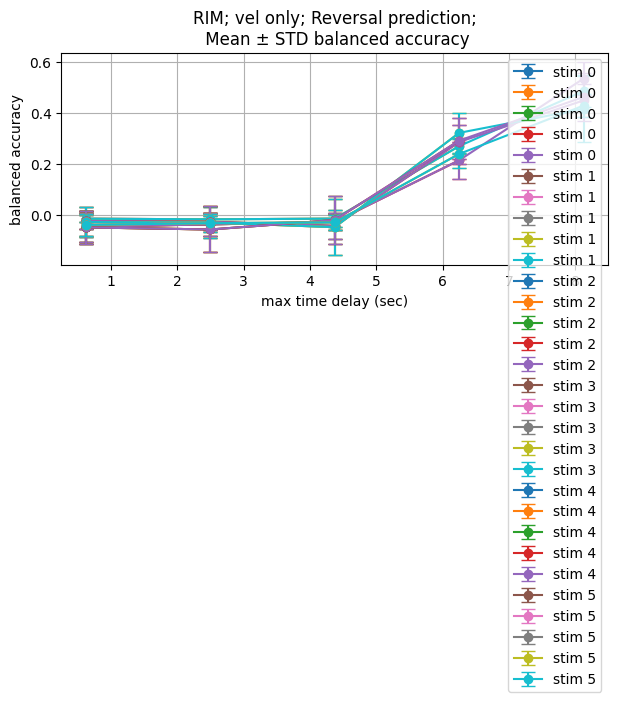

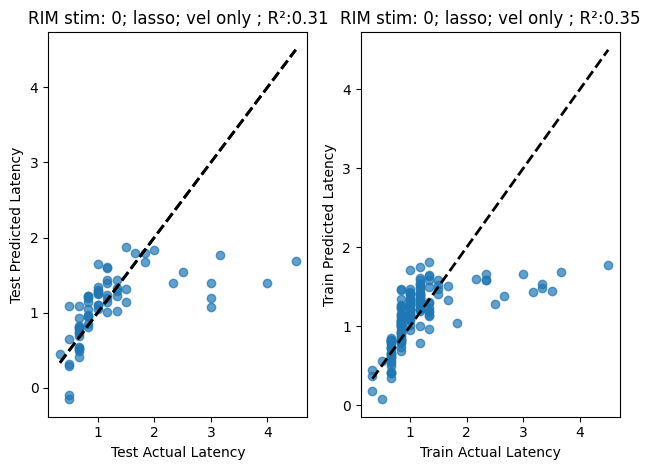

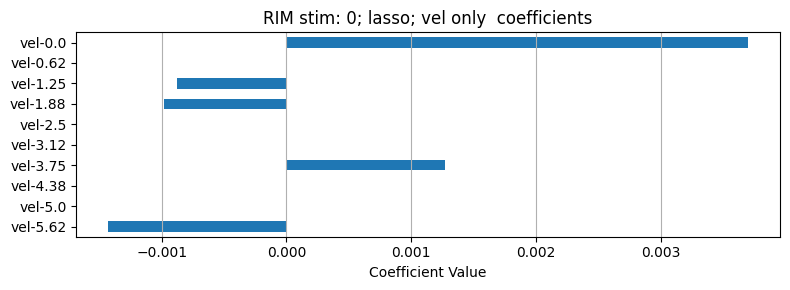

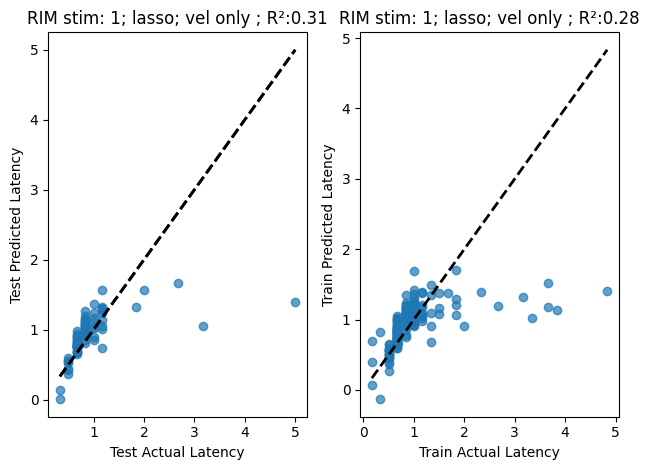

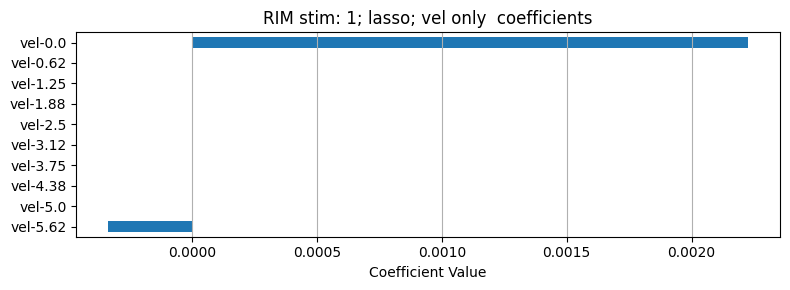

...

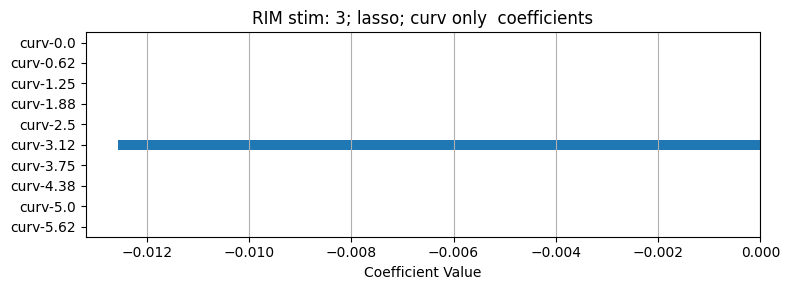

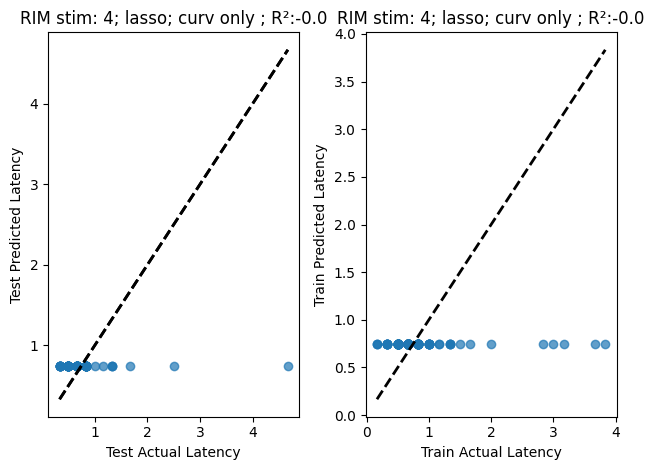

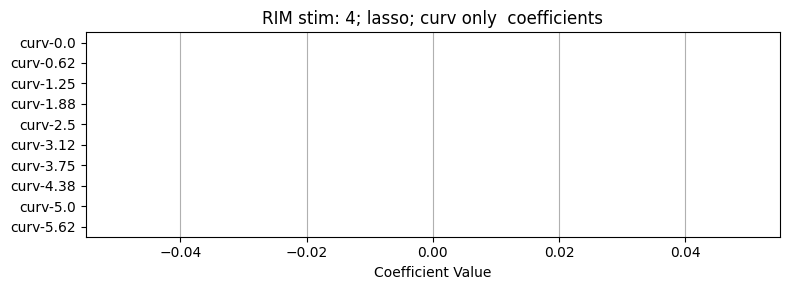

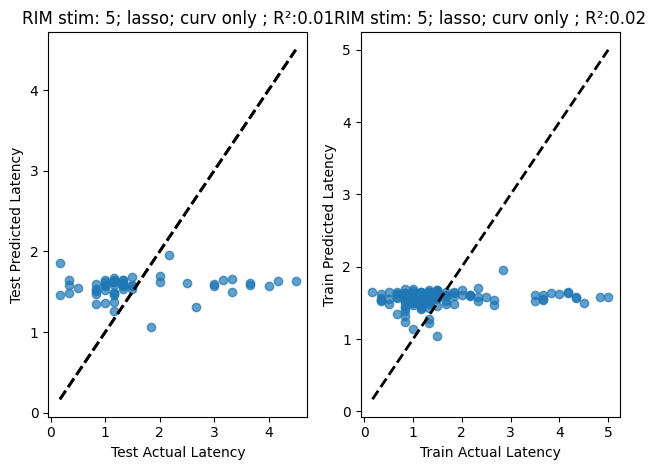

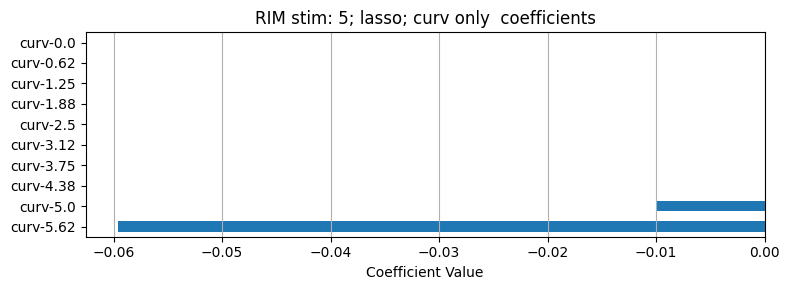

In [ ]:
########compare latnecy prediciton singel feautre resampled fps


warnings.simplefilter("ignore")

for feature, exp_feature, feature_lbl in zip([resampled_vel, resampled_acc, resampled_curve],
                                                [exp_vel, exp_acc, exp_curve], 
                                                ["vel", "accel", "curv"]):
    print("feature_lbl", feature_lbl)
    include_beh = False
    n_tracks = resampled_rev.shape[0]
    n_splits = 10
    results_dict = {}  # Store mean/std r² per i and n_timesteps
    best_models = {}   # Store best model per (i, n_timesteps)
    all_r2s_per_i ={}
    lstm_lag = 5
    

    
    idxs = [[0],[1],[2],[3],[4],[5]]
    fig, ax = plt.subplots()
    for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
        score_means = []
        score_stds = []
        # all_r2_means = []
        all_scores_per_i = {}
        n_timesteps_list = []
        r2_means = []
        r2_stds = []
        # all_r2_means = []
        
        n_timesteps_list = []
        onset = resampled_onset-1
        
        
        
        for n_timesteps in range(1, 15, 3):
            
            # phase_resampled = feature_all_to_resampled(inferred_phases_all, n_tracks)
            # radii_resampled =  feature_all_to_resampled(inferred_rad_all, n_tracks)
            # features_list = [phase_resampled, radii_resampled]
            # feature_labels = ["phase", "radii"]
            # X_stim_all, feature_names_all = prep_FB_inputs_select_features_only(
            #     # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
            #     features_list, feature_labels, onset,  n_timesteps, z, lstm_lag = lstm_lag, 
            
            #                 )
            
            
                    
        
            features_list = [exp_feature]
            feature_labels = [feature_lbl]
            X_stim_all, feature_names_all = prep_FB_inputs_select_features_only(
                # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
                features_list, feature_labels, exp_onset-1,  n_timesteps, z, lstm_lag = lstm_lag, 
            
                            )
            # print(feature_names_all)
            # print(np.all(X_stim_all1==X_stim_all))
            Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
            valid_indices = np.argwhere((~np.isnan(Y_latency)) & (Y_latency != 0)).flatten() #non_nan_non_rev_is = np.argwhere(np.logical_and(np.logical_not(np.isnan(Y_latency)), Y_latency!=0)).flatten()
            X_stim_all_latency = X_stim_all[valid_indices]
            Y_latency_valid = Y_latency[valid_indices]

            r2s = []
            models = []

            for split_idx in range(n_splits):
                X_train, X_test, y_train, y_test = train_test_split(
                    X_stim_all_latency, Y_latency_valid, test_size=test_size, random_state=split_idx)

                alphas = np.logspace(-4, 2, 20)
                lasso = Lasso(max_iter=10000)
                grid_search = GridSearchCV(lasso, {'alpha': alphas}, cv=5, scoring='r2')
                grid_search.fit(X_train, y_train)

                best_model = grid_search.best_estimator_
                y_pred = best_model.predict(X_test)
                r2 = r2_score(y_test, y_pred)

                r2s.append(r2)
                # models.append(best_model)
                models.append((best_model,X_train, X_test, y_train, y_test))

            r2_mean = np.mean(r2s)
            r2_std = np.std(r2s)
            best_model_idx = np.argmax(r2s)
            best_model_overall = models[best_model_idx]

            # Save results
            n_timesteps_list.append(n_timesteps)
            # all_r2_means.append(r2s)
            all_r2s_per_i[(i, n_timesteps)] = r2s
            r2_means.append(r2_mean)
            r2_stds.append(r2_std)
            results_dict[(i, n_timesteps)] = (r2_mean, r2_std)
            best_models[(i, n_timesteps)] = best_model_overall
            

            # cmap1 = cm.get_cmap('tab10', len(resampled_onsets))
            ax.errorbar(np.array(n_timesteps_list)/fps, r2_means, yerr=r2_stds, #color=cmap1(i),
                        fmt='-o', capsize=5, label = f"stim {i}")

            ax.set_title(f"{neuron}; {feature_lbl} only; Reversal prediction;\n Mean ± STD balanced accuracy")
            ax.set_xlabel("max time delay (sec)")
            ax.set_ylabel("balanced accuracy")
        ax.legend()
        plt.grid(True)
        plt.tight_layout()


        n_timesteps = list(range(1, 15, 3))[-2]
        include_beh = False
        


    feature_names = np.array([[f"{feature_lbl}-{np.round((n_timesteps - t - 1)/fps, 2) }"
                    ]
                            for t in range(n_timesteps)]).flatten()
    for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
        model,X_train, X_test, y_train, y_test = best_models[(i, n_timesteps)] 

        model_label= f"{neuron} stim: {i}; lasso; {feature_lbl} only "#; lasso_a{np.round(alpha,2)}"
        visualize_model_regression(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False)#, xlim = [-2,1])
plt.show()


KeyError: (1, 10)

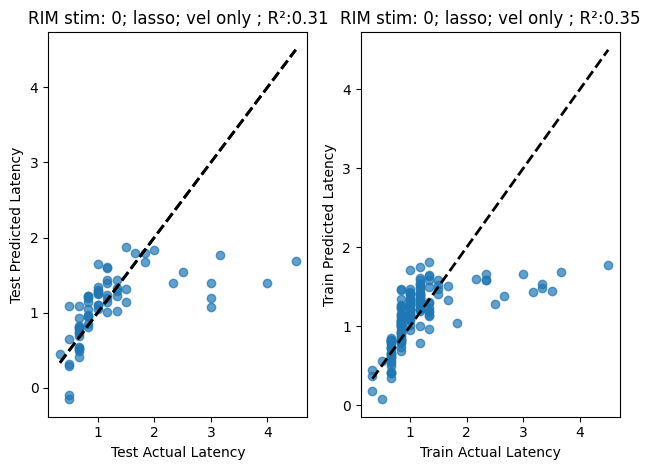

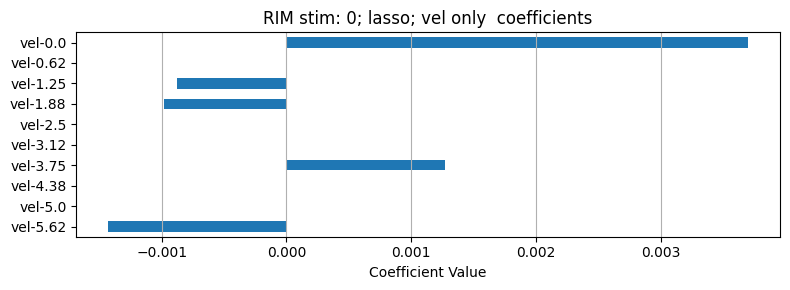

In [ ]:
########compare latnecy prediciton feautres single feature  exp fps

In [ ]:
########compare latnecy prediciton time delayed pahse resampled fps

from predict_latency_prob_from_features_donut_4 import prep_FB_inputs_select_features_only, prep_FB_inputs_features_only, feature_all_to_resampled

with warnings.catch_warnings():
        
    # ##get inputs into lstm 
    # beh_map = [z_norm.min(), z_norm.min()/2 + z_norm.max()/2, z_norm.max()]

    warnings.simplefilter("ignore")
    fps = 1.6

    include_beh = False
    n_tracks = resampled_rev.shape[0]
    n_splits = 10
    results_dict = {}  # Store mean/std r² per i and n_timesteps
    best_models = {}   # Store best model per (i, n_timesteps)
    lstm_lag = 5
    idxs = [[0],[1],[2],[3],[4],[5]]
    fig, ax = plt.subplots()
    for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
        score_means = []
        score_stds = []
        # all_r2_means = []
        all_scores_per_i = {}
        n_timesteps_list = []
        onset = resampled_onset-1

        for n_timesteps in range(1, 15, 3):
            
            phase_resampled = feature_all_to_resampled(inferred_phases_all, n_tracks)
            radii_resampled =  feature_all_to_resampled(inferred_rad_all, n_tracks)
            features_list = [phase_resampled, radii_resampled]
            feature_labels = ["phase", "radii"]
            X_stim_all, feature_names_all = prep_FB_inputs_select_features_only(
                # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
                features_list, feature_labels, onset,  n_timesteps, z, lstm_lag = lstm_lag, 
            
                            )
            # print(np.all(X_stim_all1==X_stim_all))
            Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
            
            
            # print(f"\nProcessing i={i}, n_timesteps={n_timesteps}")
            # feature_names = np.array([[f"vel_t-{n_timesteps - t - 1}", f"accel_t-{n_timesteps - t - 1}",
            #                         f"curv_t-{n_timesteps - t - 1}", f"beh_t-{n_timesteps - t - 1}"]
            #                         for t in range(n_timesteps)]).flatten()


            # # X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps,   lstm_lag = lstm_lag)#shape (n_tracks, n_frames, n_features)
            # X_stim_all, feature_names_all =  prep_FB_inputs_feature_and_donut(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, inferred_phases_all, inferred_rad_all,resampled_onset, n_tracks,   n_timesteps, z, lstm_lag = 5)

            # Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency=6 * durations[i] + 1) / 6
            valid_indices = np.argwhere((~np.isnan(Y_latency)) & (Y_latency != 0)).flatten() #non_nan_non_rev_is = np.argwhere(np.logical_and(np.logical_not(np.isnan(Y_latency)), Y_latency!=0)).flatten()
            X_stim_all_latency = X_stim_all[valid_indices]
            Y_latency_valid = Y_latency[valid_indices]

            r2s = []
            models = []

            for split_idx in range(n_splits):
                X_train, X_test, y_train, y_test = train_test_split(
                    X_stim_all_latency, Y_latency_valid, test_size=test_size, random_state=split_idx)

                alphas = np.logspace(-4, 2, 20)
                lasso = Lasso(max_iter=10000)
                grid_search = GridSearchCV(lasso, {'alpha': alphas}, cv=5, scoring='r2')
                grid_search.fit(X_train, y_train)

                best_model = grid_search.best_estimator_
                y_pred = best_model.predict(X_test)
                r2 = r2_score(y_test, y_pred)

                r2s.append(r2)
                # models.append(best_model)
                models.append((best_model,X_train, X_test, y_train, y_test))

            r2_mean = np.mean(r2s)
            r2_std = np.std(r2s)
            best_model_idx = np.argmax(r2s)
            best_model_overall = models[best_model_idx]

            # Save results
            n_timesteps_list.append(n_timesteps)
            # all_r2_means.append(r2s)
            all_r2s_per_i[(i, n_timesteps)] = r2s
            r2_means.append(r2_mean)
            r2_stds.append(r2_std)
            results_dict[(i, n_timesteps)] = (r2_mean, r2_std)
            best_models[(i, n_timesteps)] = best_model_overall


        # cmap1 = cm.get_cmap('tab10', len(resampled_onsets))
        ax.errorbar(np.array(n_timesteps_list)/fps, r2_means, yerr=r2_stds, #color=cmap1(i),
                    fmt='-o', capsize=5, label = f"stim {i}")

        ax.set_title(f"{neuron}; phase and rad only; Reversal prediction;\n Mean ± STD balanced accuracy")
        ax.set_xlabel("max time delay (frames)")
        ax.set_ylabel("balanced accuracy")
    ax.legend()
    plt.grid(True)
    plt.tight_layout()
    # plt.savefig(f"r2_plot_i{i}.png")
    # plt.close()

    n_timesteps = 10
    include_beh = False

    feature_names = np.array([[f"phase_t-{np.round((n_timesteps - t - 1)/fps, 2) }", f"rad_t-{np.round((n_timesteps - t - 1)/fps, 2) }"
                       ]
                            for t in range(n_timesteps)]).flatten()
    for i in range(len(resampled_onsets)):
        model,X_train, X_test, y_train, y_test, c  = best_models[(i, n_timesteps)] 

        model_label= f"{neuron} stim: {i}; linear SVC; {feature_lbl} only "#; lasso_a{np.round(alpha,2)}"
        visualize_model_classification(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = False, get_coeff = False, coeffs = model.coef_[0])#, xlim = [-1,1])
        
plt.show()

In [ ]:
########compare latnecy prediciton time delayed pahse exp fps


In [ ]:
#####fix so doing all with the same model across stim 

4; 1; logisticAccuracy: 0.9609375
4; 1; logisticPrecision: 0.92340087890625
4; 1; logisticRecall: 0.9609375
4; 1; logisticF1 Score: 0.9417953187250996
4;1; linear svc l1Accuracy: 0.9609375
4;1; linear svc l1Precision: 0.92340087890625
4;1; linear svc l1Recall: 0.9609375
4;1; linear svc l1F1 Score: 0.9417953187250996


/Users/friederikebuck/miniconda3/envs/DLC_YOLO_GUI/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/friederikebuck/miniconda3/envs/DLC_YOLO_GUI/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Best C: 0.001
Best CV accuracy: 0.5
4;1; linear svc l1 c 0.001Accuracy: 0.0390625
4;1; linear svc l1 c 0.001Precision: 0.00152587890625
4;1; linear svc l1 c 0.001Recall: 0.0390625
4;1; linear svc l1 c 0.001F1 Score: 0.0029370300751879698
4; 1; tree no max depthAccuracy: 0.921875
4; 1; tree no max depthPrecision: 0.921875
4; 1; tree no max depthRecall: 0.921875
4; 1; tree no max depthF1 Score: 0.921875


/Users/friederikebuck/miniconda3/envs/DLC_YOLO_GUI/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4; 1; tree max depth = 3Accuracy: 0.953125
4; 1; tree max depth = 3Precision: 0.9231053149606299
4; 1; tree max depth = 3Recall: 0.953125
4; 1; tree max depth = 3F1 Score: 0.937875
4; 1; SVC rbf kernelAccuracy: 0.9609375
4; 1; SVC rbf kernelPrecision: 0.92340087890625
4; 1; SVC rbf kernelRecall: 0.9609375
4; 1; SVC rbf kernelF1 Score: 0.9417953187250996


/Users/friederikebuck/miniconda3/envs/DLC_YOLO_GUI/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Best alpha lasso: 0.06951927961775606
Best CV R²: -0.041714940634256514


/var/folders/8z/xy4sl8b90qnc_x9p_4psrnmh0000gn/T/ipykernel_7228/3247618565.py:153: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(1,2)


4; 3; logisticAccuracy: 0.9609375
4; 3; logisticPrecision: 0.92340087890625
4; 3; logisticRecall: 0.9609375
4; 3; logisticF1 Score: 0.9417953187250996
4;3; linear svc l1Accuracy: 0.9609375
4;3; linear svc l1Precision: 0.92340087890625
4;3; linear svc l1Recall: 0.9609375
4;3; linear svc l1F1 Score: 0.9417953187250996


/Users/friederikebuck/miniconda3/envs/DLC_YOLO_GUI/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/friederikebuck/miniconda3/envs/DLC_YOLO_GUI/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/friederikebuck/miniconda3/envs/DLC_YOLO_GUI/lib/python3.9/site-packages/sklearn/svm/_base.py:1250: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/friederikebuck/miniconda3/envs/DLC_YOLO_GUI/lib/python3.9/site-packages/sklearn/svm/_base.py:1250: Convergenc

Best C: 0.001
Best CV accuracy: 0.5
4;3; linear svc l1 c 0.001Accuracy: 0.0390625
4;3; linear svc l1 c 0.001Precision: 0.00152587890625
4;3; linear svc l1 c 0.001Recall: 0.0390625
4;3; linear svc l1 c 0.001F1 Score: 0.0029370300751879698
4; 3; tree no max depthAccuracy: 0.8984375
4; 3; tree no max depthPrecision: 0.9208984375
4; 3; tree no max depthRecall: 0.8984375
4; 3; tree no max depthF1 Score: 0.9095293209876544
4; 3; tree max depth = 3Accuracy: 0.9453125
4; 3; tree max depth = 3Precision: 0.9228050595238095
4; 3; tree max depth = 3Recall: 0.9453125
4; 3; tree max depth = 3F1 Score: 0.9339231927710844
4; 3; SVC rbf kernelAccuracy: 0.9609375
4; 3; SVC rbf kernelPrecision: 0.92340087890625
4; 3; SVC rbf kernelRecall: 0.9609375
4; 3; SVC rbf kernelF1 Score: 0.9417953187250996


/Users/friederikebuck/miniconda3/envs/DLC_YOLO_GUI/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


KeyboardInterrupt: 

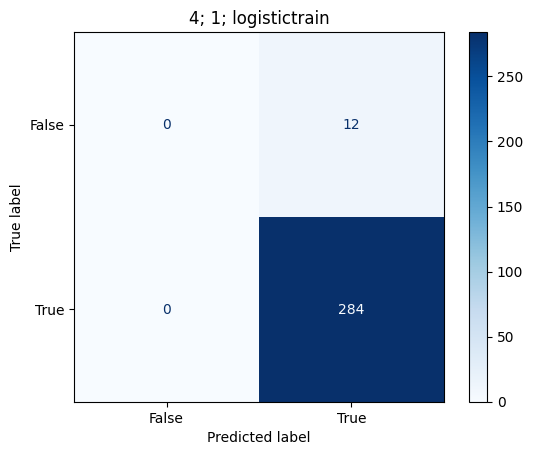

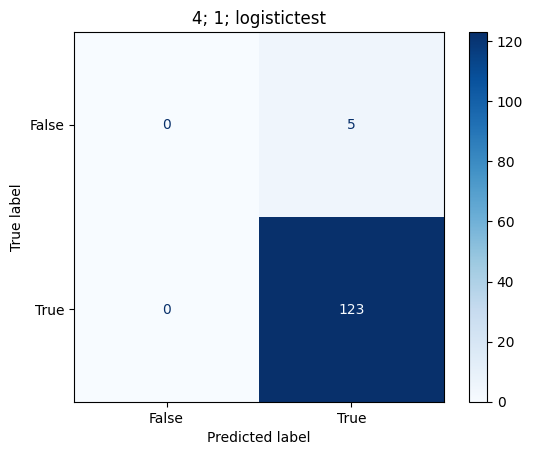

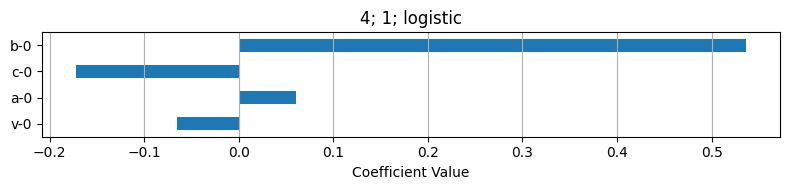

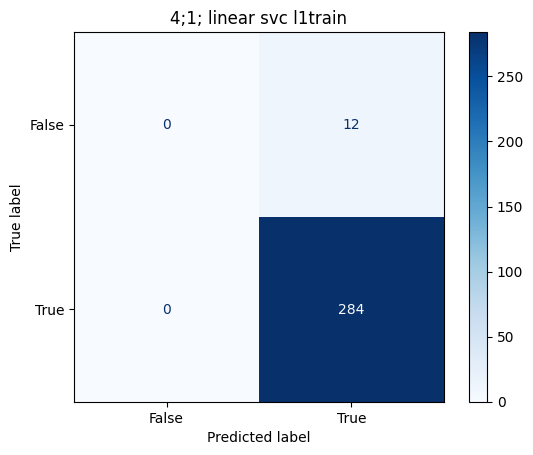

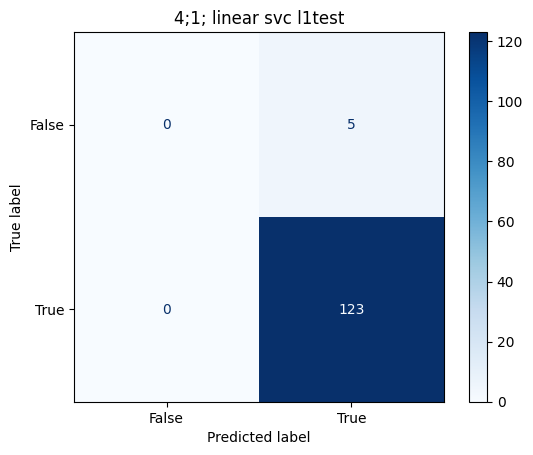

...

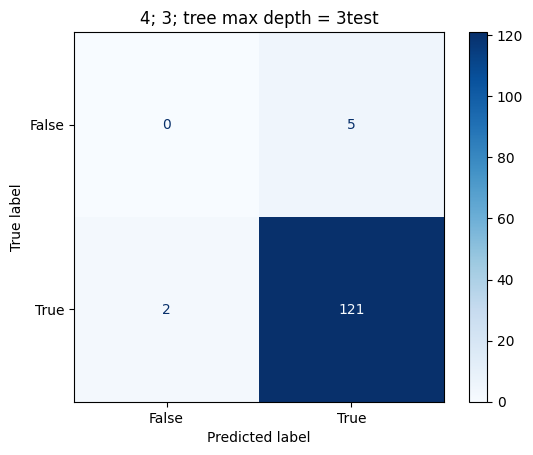

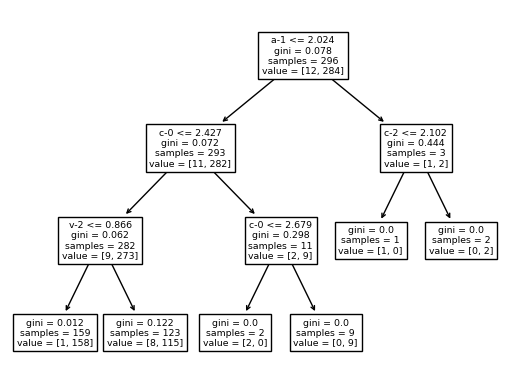

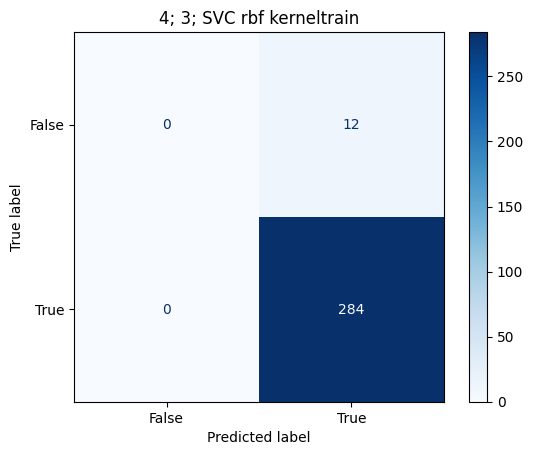

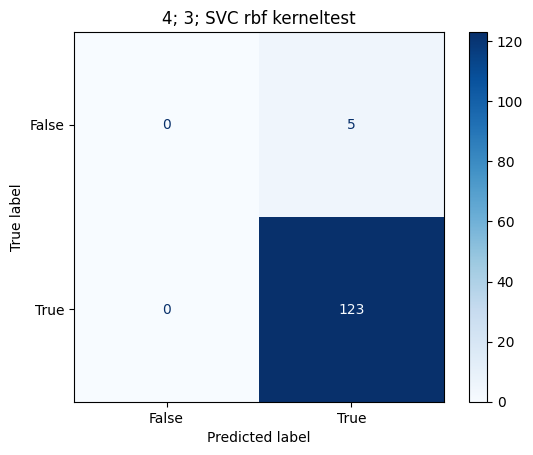

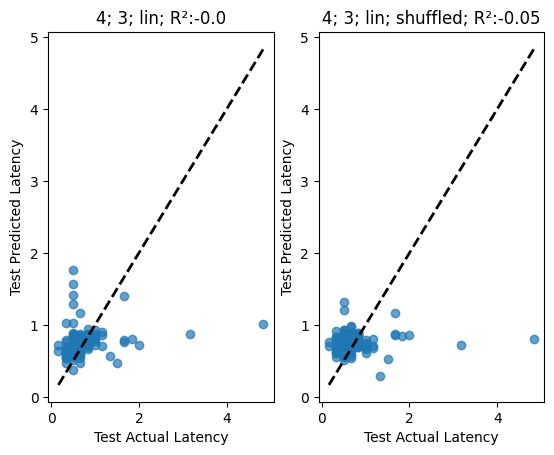

In [ ]:

###get inputs into lstm 
beh_map = [z_norm.min(), z_norm.min()/2 + z_norm.max()/2, z_norm.max()]
if experiment == "time_titration":
    durations = [1,3,5,10]
else:
    durations = [5,5,5,5,5,5]
    if experiment == "hiscl":
        durations = [5,5]
        

    
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression, Lasso, TweedieRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn import tree
##get latency and features for each stim 
# random_state = 42
# test_size = 0.2

random_state = 30
test_size = 0.3

feature_names_ordered = True

resampled_onsets= onsets
for n_timesteps in range(1, 10, 2 ):
    feature_names = np.array([[f"v-{n_timesteps-t-1}", f"a-{n_timesteps-t-1}", f"c-{n_timesteps-t-1}", f"b-{n_timesteps-t-1}"] for t in range(n_timesteps)]).flatten()
    # feature_names_ordered = np.array([[f"v-{T-t-1}", f"a-{T-t-1}", f"c-{T-t-1}", f"b-{T-t-1}"] for t in range(0,n_timesteps)]).reshape((len(feature_names), -1), order='F').flatten()
    X_stim = prep_FB_inputs(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,  n_timesteps= n_timesteps ) #shape (n_tracks, n_frames, n_features)
    # X_stim = [X_all_LSTM[i].numpy() for i in range(len(X_all_LSTM))]
    # rev_bin = exp_behaviors
    for i, (resampled_onset, exp_onset) in [list(enumerate(zip(resampled_onsets, exp_onsets)))[4]]:
        X_stim_all =X_stim[:, resampled_onset-T-1, :]# X_all_LSTM[resampled_onset-T, :]
        # Get rid of already reversing guys###

        Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
        no_rev_at_onset = Y_latency!=0
        
        Y_prob = np.logical_not(np.isnan(Y_latency[no_rev_at_onset]))# classfy y/n did rev happen
        X_prob = copy.deepcopy(X_stim_all[no_rev_at_onset])
        
        ###    
        X_train, X_test, y_train, y_test = train_test_split(X_prob, Y_prob, test_size=test_size, random_state=random_state)
        model = LogisticRegression(max_iter=1000, random_state=random_state)#, class_weight="balanced")
        model_label = f"{i}; {n_timesteps}; logistic"
        fit_visualize_model_classifiction(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps, feature_names_ordered = feature_names_ordered)

        
        
        model = LinearSVC(penalty='l1', dual=False, max_iter=10000)
        model_label = f"{i};{n_timesteps}; linear svc l1"
        fit_visualize_model_classifiction(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps, feature_names_ordered = feature_names_ordered)
        # Grid of C values to search
        param_grid = {
            'C': [0.001, 0.01, 0.1, 1, 10, 100]
        }

        model = LinearSVC(penalty='l1', dual=False, max_iter=10000)
        # Grid search
        grid = GridSearchCV(model, param_grid, cv=5, scoring='balanced_accuracy')
        grid.fit(X_train, y_train)

        # Best parameters and score
        print("Best C:", grid.best_params_['C'])
        print("Best CV accuracy:", grid.best_score_)
        c = grid.best_params_['C']
        model = LinearSVC(penalty='l1', dual=False, max_iter=10000, C = c)
        model_label = f"{i};{n_timesteps}; linear svc l1 c {c}"
        fit_visualize_model_classifiction(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps, feature_names_ordered = feature_names_ordered)
        
        model = tree.DecisionTreeClassifier()
        model_label = f"{i}; {n_timesteps}; tree no max depth"
        model, y_pred = fit_visualize_model_classifiction(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps, get_coeff = False, feature_names_ordered = feature_names_ordered)
        fig, ax = plt.subplots()
        tree.plot_tree(model, feature_names = feature_names)
        
        model = tree.DecisionTreeClassifier(max_depth=3)
        model_label = f"{i}; {n_timesteps}; tree max depth = 3"
        model, y_pred = fit_visualize_model_classifiction(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps,  get_coeff = False, feature_names_ordered = feature_names_ordered)
        fig, ax = plt.subplots()
        tree.plot_tree(model, feature_names = feature_names)
        
        model = svm.SVC()
        model_label = f"{i}; {n_timesteps}; SVC rbf kernel"
        model, y_pred = fit_visualize_model_classifiction(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps, get_coeff = False, feature_names_ordered = feature_names_ordered)

        
        ###########try latency 
        
        non_nan_non_rev_is = np.argwhere(np.logical_and(np.logical_not(np.isnan(Y_latency)), Y_latency!=0)).flatten()
        X_stim_all_latency = X_stim_all[non_nan_non_rev_is]# classfy y/n did stim happen
        Y_latency = Y_latency[non_nan_non_rev_is]
        
        X_train, X_test, y_train, y_test = train_test_split(X_stim_all_latency, Y_latency, test_size=test_size, random_state=random_state)

        model = LinearRegression()
        model_label= f"{i}; {n_timesteps}; lin"
        fit_visualize_model_regression(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps, feature_names_ordered = feature_names_ordered)
        # model_lr.fit(X_train, y_train)
        # print("Linear Regression R²:", model_lr.score(X_test, y_test))
        # print("Coefficients:", model_lr.coef_)
        
        alphas = np.logspace(-4, 2, 20)
        lasso = Lasso(max_iter=10000)
        param_grid = {'alpha': alphas}
        grid_search_lasso = GridSearchCV(lasso, param_grid, cv=5, scoring='r2')
        grid_search_lasso.fit(X_train, y_train)

        best_lasso = grid_search_lasso.best_estimator_

        print("Best alpha lasso:", grid_search_lasso.best_params_['alpha'])
        print("Best CV R²:", grid_search_lasso.best_score_)
        alpha = grid_search_lasso.best_params_['alpha']
        model = Lasso(alpha=alpha)  # You can tune alpha with CV
        model_label= f"{i};{n_timesteps}; lasso_a{np.round(alpha,2)}"
        fit_visualize_model_regression(model, model_label, feature_names, X_train, X_test, y_train, y_test, n_timesteps,  feature_names_ordered = feature_names_ordered)
        
        
        # model_lasso.fit(X_train, y_train)
        
        # print("Lasso R²:", model_lasso.score(X_test, y_test))
        # print("Coefficients:", model_lasso.coef_)# Range of alpha values to try (log scale)
        
        # Gamma regression
        #If your latencies are tightly distributed, or variance is constant → LinearRegression or Lasso
        # If variance grows with latency (heteroscedasticity) → TweedieRegressor(power=2)
        
        # param_grid = {
        #     'alpha': np.logspace(-4, 2, 10),  # Try a wide range
        # }

        # model = TweedieRegressor(power=2, alpha=0.0, link='log')  # log link enforces positivity
        # model_label=f"{i};gamma_a0.0"
        # fit_visualize_model_regression(model, model_label, feature_names, X_train, X_test, y_train, y_test)
        # grid_search_lasso = GridSearchCV(model, param_grid, cv=5, scoring='r2')
        # grid_search_lasso.fit(X_train, y_train)
        # best_lasso = grid_search_lasso.best_estimator_

        # print("Best alpha gamma:", grid_search_lasso.best_params_['alpha'])
        # print("Best CV R²:", grid_search_lasso.best_score_)
        # alpha = grid_search_lasso.best_params_['alpha']
        # model = Lasso(alpha=alpha)  # You can tune alpha with CV
        # model_label= f"{i};gamma_a{np.round(alpha,2)}"
        # fit_visualize_model_regression(model, model_label, feature_names, X_train, X_test, y_train, y_test)
        
        
        # model_gamma.fit(X_train, y_train)
        # print("Gamma GLM R²:", model_gamma.score(X_train, y_test))
        # print("Coefficients:", model_gamma.coef_)
        
        
        
        # ###########
        # ####scaled
        # scaler = StandardScaler()
        # X_train_scaled = scaler.fit_transform(X_train)
        # X_train = X_train_scaled
        # X_test_scaled = scaler.transform(X_test)
        
        
        # model = LinearRegression()
        # model_label= f"{i};lin;scaled"
        # fit_visualize_model_regression(model, model_label, feature_names, X_train_scaled, X_test_scaled, y_train, y_test)
        # # model_lr.fit(X_train, y_train)
        # # print("Linear Regression R²:", model_lr.score(X_test, y_test))
        # # print("Coefficients:", model_lr.coef_)

        
        # alphas = np.logspace(-4, 2, 20)
        # lasso = Lasso(max_iter=10000)
        # param_grid = {'alpha': alphas}
        # grid_search_lasso = GridSearchCV(lasso, param_grid, cv=5, scoring='r2')
        # grid_search_lasso.fit(X_train, y_train)

        # best_lasso = grid_search_lasso.best_estimator_

        # # print("Best alpha:", grid_search_lasso.best_params_['alpha'])
        # # print("Best CV R²:", grid_search_lasso.best_score_)
        # alpha = grid_search_lasso.best_params_['alpha']
        # model = Lasso(alpha=alpha)  # You can tune alpha with CV
        # model_label= f"{i}; scaled;lasso_a{np.round(alpha,2)}"
        # fit_visualize_model_regression(model, model_label, feature_names,X_train_scaled, X_test_scaled, y_train, y_test)
        
        
        # # model_lasso.fit(X_train, y_train)
        
        # # print("Lasso R²:", model_lasso.score(X_test, y_test))
        # # print("Coefficients:", model_lasso.coef_)# Range of alpha values to try (log scale)
        
        # # Gamma regression
        # #If your latencies are tightly distributed, or variance is constant → LinearRegression or Lasso
        # # If variance grows with latency (heteroscedasticity) → TweedieRegressor(power=2)
        # model = TweedieRegressor(power=2, alpha=0.0, link='log')  # log link enforces positivity
        # model_label=f"{i};scaled; gamma"
        # fit_visualize_model_regression(model, model_label, feature_names,X_train_scaled, X_test_scaled, y_train, y_test)
        break
        
        ##try gam 
        
    


# simulate data

In [ ]:
# try: #no need to redo it
#     final_behs
# except:
final_behs = simulate_exp([0,1,3,5], input_durs=[8], neuron=neuron, input_dict = input_dict,new_slds = new_slds, q_x = q_x, pca=pca,  z= z, total_dur=8, thresh=2, remove_rev=False)

NameError: name 'z' is not defined

# plot

(0.0, 40.0)

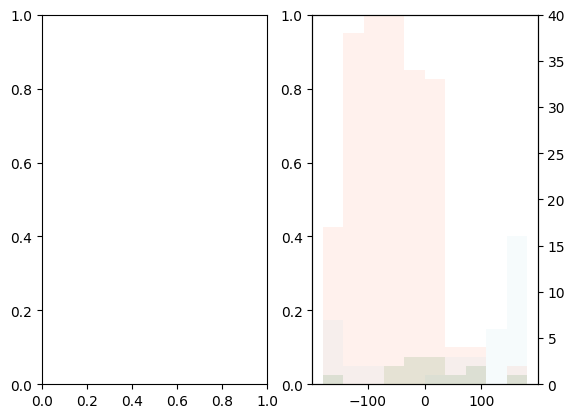

In [ ]:
fig,ax_2 = plt.subplots(1,2)
ax2 = ax_2[1].twinx()
idxs=[0,-1]
transformed_angles = np.degrees(np.concatenate(inferred_phases[[idxs]]))
# transformed_angles = (transformed_angles)%360 - 180
behs = np.concatenate(initial_behaviors[[idxs]])
beh_map = [z_norm.min(), z_norm.min()/2 + z_norm.max()/2, z_norm.max()]
for i in range(3):
    ax2.hist(transformed_angles[np.abs(behs -beh_map[i]) < 0.01], bins=np.linspace(-180,181,11), density=False, alpha=0.1, color=palette[i])
ax2.set_ylim(0,40)

In [ ]:
ax_2[0].set_title(neuron)
colors = [plt.get_cmap("Purples")(i) for i in np.linspace(0, 1, 7)][1:]
colors[0] = (0,0,0,1)



times = onsets
inferred_phases, final_behaviors, final_behaviors_all, inferred_phases_all, inferred_rad_all, behaviors_all, inferred_rad, initial_behaviors, initial_cts_beh, X_all_LSTM = analyze_data(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, times, model_beh_directed, z_norm,input_stats,  z, lag=16, inclusion_thresh = 2, model_type="ff",normalize=False, remove_revs=False)


for i in range(len(final_behs)):
    test_angs = np.concatenate(worm_angles[0:5])
    plot_rev_pro2(np.degrees(test_angs), final_behs[i], np.concatenate(np.array(q_z[0:5])[:,5+T:]), ax=ax_2[0],  label=f"input: {input_str}", color=colors[i], window_size=np.pi/4, plot_type="line", num_bins=10)

if condition == "control":
    plot_rev_pro2(np.degrees(inferred_phases_all[:10000]), final_behaviors_all[:10000], ax=ax_2[1], color="k", window_size=np.pi/4, beh1=False, plot_type="line", num_bins=10)
    ax_2[1].set_title("control")
else:
    plot_results([0,1,2,3], inferred_phases, final_behaviors, combined=False, ax=ax_2[1], colors=colors[:], num_bins=10, window_size=np.pi/4, plot_type="box", noise_level=0)
    ax_2[1].set_title(neuron)


ax_2[0].set_xlabel(r"$\theta$")
ax_2[1].set_xlabel(r"$\theta$")

# ax_2[1].set_xlim(-120,50)
# ax_2[0].set_xlim(-120,50)

fig.tight_layout()


NameError: name 'final_behs' is not defined

# Kernel regression

NameError: name 'final_behs' is not defined

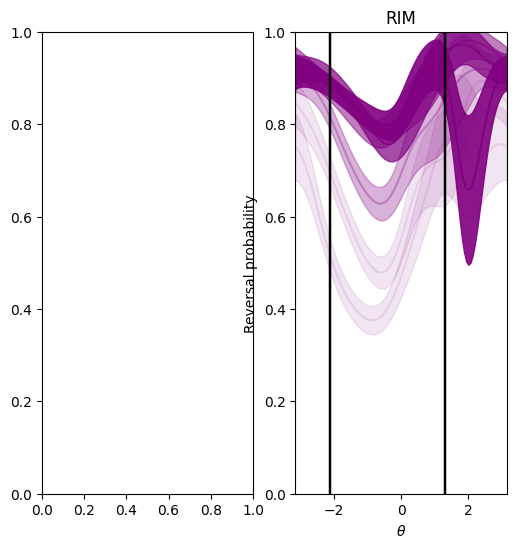

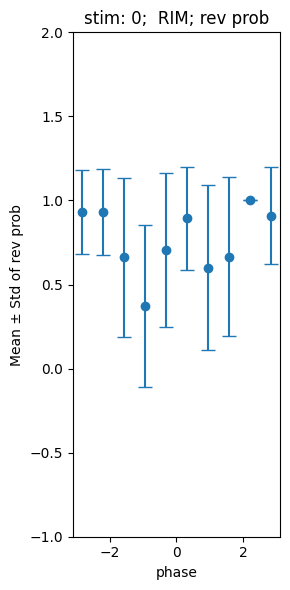

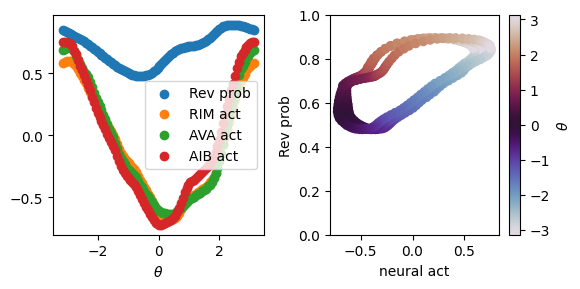

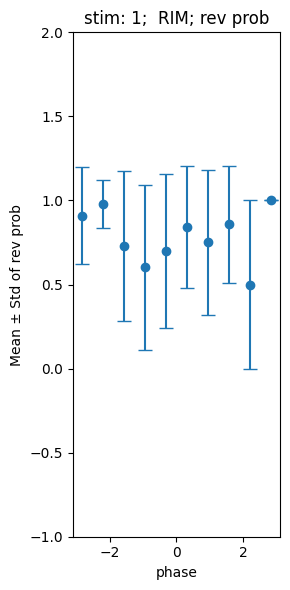

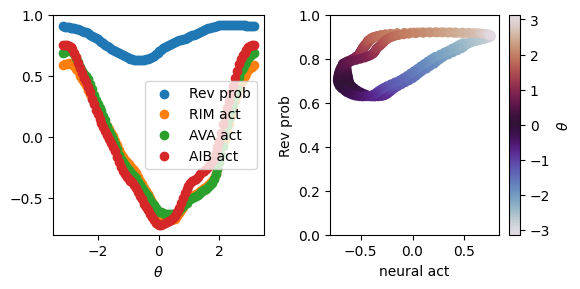

...

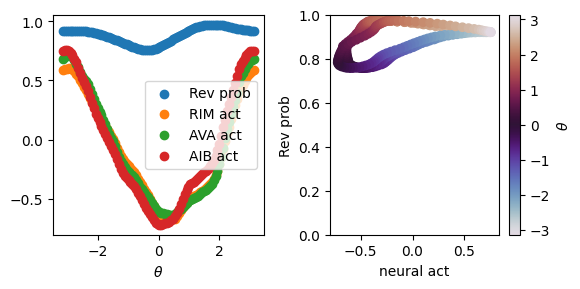

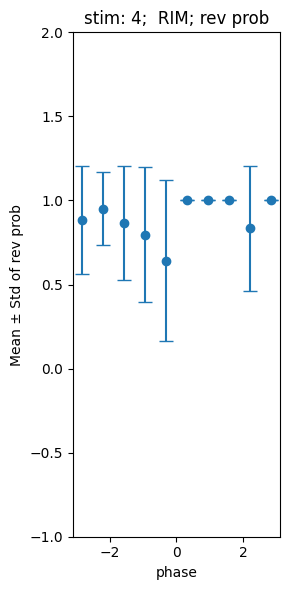

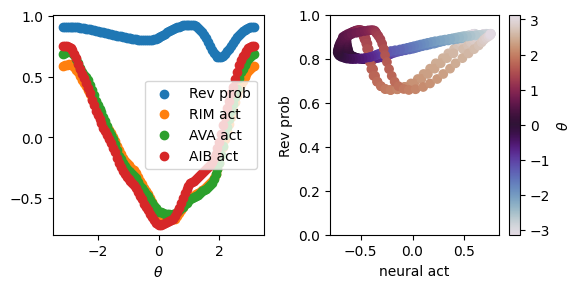

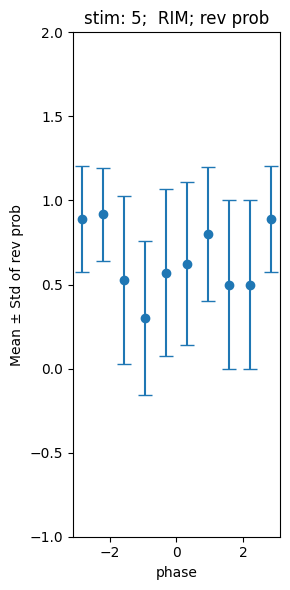

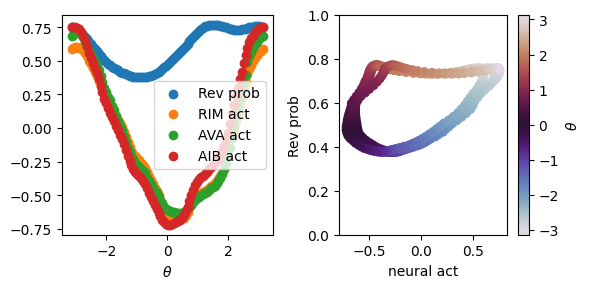

In [ ]:
def plot_binned_counts(x,y,title_supp="",  fig = None, ax = None, n_bins = 10):
    # Define bin edges
    bin_edges = np.linspace(-1*np.pi, np.pi, n_bins + 1)

    # Digitize x values to bin indices
    bin_indices = np.digitize(x, bin_edges) - 1

    # Preallocate arrays
    means = np.zeros(n_bins)
    stds = np.zeros(n_bins)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

    # Compute mean and std per bin
    for i in range(n_bins):
        mask = bin_indices == i
        if np.any(mask):
            means[i] = np.mean(y[mask])
            stds[i] = np.std(y[mask])
        else:
            means[i] = np.nan
            stds[i] = np.nan

    ax.errorbar(bin_centers, means, yerr=stds, fmt='o', capsize=5)
    ax.set_xlabel('phase')
    ax.set_ylabel('Mean ± Std of rev prob')
    ax.set_ylim([-1, 2])
    ax.set_title(f'{title_supp} {neuron}; rev prob')
    # plt.show()


# Plot
fig,ax = plt.subplots(1,2,figsize=(6,6))

if neuron == "AVA":
    idxs = [[0,-1],[1],[2], [3,4]]
    idxs = [[0],[1],[2],[3],[4],[5]]
if neuron == "RIM":
    idxs = [[0,-1],[1], [2,3,4]]
    idxs = [[0],[1],[2],[3],[4],[5]]
if neuron == "AIB":
    idxs = [[0,-1],[1,2], [3,4]]
# if neuron == "AIB":
#     idxs = [[0,-1],[1], [2], [3], [4]]
#     idxs = [[0],[1],[2],[3],[4],[5]]

for i in range(len(idxs)):

    x0,x1 = np.concatenate(inferred_phases[idxs[i]]), np.concatenate(inferred_rad[idxs[i]])
    y = np.concatenate(final_behaviors[idxs[i]])
    x = np.stack((x0, x1)).T
    x = x[~np.isnan(y)]
    y = y[~np.isnan(y)]

    fig1,ax1 = plt.subplots(figsize=(3,6))
    # ax1.scatter(x0[non_nan_ys], y, label = i)
    plot_binned_counts(x0,y,title_supp = f"stim: {i}; ",fig = fig1, ax = ax1, n_bins = 10)
    
    
    
    y_est = fit_and_evaluate_kernel_regression(x, y, method="kernel", bandwidths=(0.3,0.3), plot=True, kernel_type=("vonmises", "gaussian"), ax=ax[1], alpha = 0.1 + 0.2*(i%5), return_est=True)
    ax[1].set_xlabel(r"$\theta$")
    ax[1].set_ylabel("Reversal probability")
    ax[1].set_ylim(0,1)
    ax[1].set_title(neuron)
    ax[1].axvline(-2.1, color='k')
    ax[1].axvline(1.3, color='k')
    ax[1].set_xlim(-np.pi, np.pi)


    if True: # plot rev probability vs mean trace
        fig2,ax2  = plt.subplots(1,2, figsize=(6,3))
        ax2[0].scatter(np.linspace(-np.pi, np.pi, 100), y_est, label="Rev prob")

        neuron_names = ["RIM", "AVA", "AIB"]
        i = 0
        for y_est2 in y_est2s:
            ax2[0].scatter(np.linspace(-np.pi, np.pi, 100), y_est2, label=f"{neuron_names[i]} act")
            im = ax2[1].scatter(y_est2, y_est, c = np.linspace(-np.pi, np.pi, 100), cmap="twilight")
            i+=1


        ax2[0].set_xlabel(r"$\theta$")
        cb = fig.colorbar(im)
        cb.set_label(r"$\theta$")
        ax2[1].set_ylabel("Rev prob")
        ax2[1].set_xlabel(f"neural act")
        ax2[1].set_ylim(0,1)
        ax2[0].legend()
        fig2.tight_layout()


for i in range(1,len(final_behs)):


    x0,x1 = np.concatenate(worm_angles[0:5]), np.concatenate(worm_radii[0:5])
    y = np.array(final_behs[i])
    x = np.stack((x0, x1)).T
    x = x[~np.isnan(y)]
    y = y[~np.isnan(y)]


    
    
    y_est = fit_and_evaluate_kernel_regression(x, y, method="kernel", bandwidths=(0.3,0.3), plot=True, kernel_type=("vonmises", "gaussian"), ax=ax[0], alpha = 0.1 + 0.2*(i%5), return_est=True)


    ax[0].set_xlabel(r"$\theta$")
    ax[0].set_ylabel("Reversal probability")
    ax[0].set_title("Simulations")
    ax[0].axvline(-2.1, color='k')
    ax[0].axvline(1.3, color='k')
    ax[0].set_ylim(0,1)


fig.tight_layout()
